In [1]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from glob import glob
from sklearn.model_selection import train_test_split
from torchvision import transforms
from torch.optim.lr_scheduler import CosineAnnealingLR
import matplotlib.pyplot as plt
from tqdm import tqdm

In [2]:
from google.colab import drive
drive.mount('/content/drive')

print(os.path.exists('/content/drive/MyDrive/Copie de PFA_Final'))
print(os.listdir('/content/drive/MyDrive/Copie de PFA_Final'))
print(os.listdir('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/images'))


Mounted at /content/drive
True
['new_data']
['Blast_PCRM_1202182 D5_0.bmp', 'Blast_PCRM_1202182 D5_1.bmp', 'Blast_PCRM_1202182 D5_2.bmp', 'Blast_PCRM_1202182 D5_3.bmp', 'Blast_PCRM_1202182 D5_4.bmp', 'Blast_PCRM_R16-0204A_0.bmp', 'Blast_PCRM_R16-0204A_1.bmp', 'Blast_PCRM_R16-0204A_2.bmp', 'Blast_PCRM_R16-0204A_3.bmp', 'Blast_PCRM_R16-0204A_4.bmp', 'Blast_PCRM_R12-0326b_0.bmp', 'Blast_PCRM_R12-0326b_1.bmp', 'Blast_PCRM_R12-0326b_2.bmp', 'Blast_PCRM_R12-0326b_3.bmp', 'Blast_PCRM_R12-0326b_4.bmp', 'Blast_PCRM_R13-0027_0.bmp', 'Blast_PCRM_R13-0027_1.bmp', 'Blast_PCRM_R13-0027_2.bmp', 'Blast_PCRM_R13-0027_3.bmp', 'Blast_PCRM_R13-0027_4.bmp', 'Blast_PCRM_R14-0374b_0.bmp', 'Blast_PCRM_R14-0374b_1.bmp', 'Blast_PCRM_R14-0374b_2.bmp', 'Blast_PCRM_R14-0374b_3.bmp', 'Blast_PCRM_R14-0374b_4.bmp', 'Blast_PCRM_R16-0274A_0.bmp', 'Blast_PCRM_R16-0274A_1.bmp', 'Blast_PCRM_R16-0274A_2.bmp', 'Blast_PCRM_R16-0274A_3.bmp', 'Blast_PCRM_R16-0274A_4.bmp', 'Blast_PCRM_R12-0358a_0.bmp', 'Blast_PCRM_R12-0358a_1.b

In [3]:
SIZE = 256
BATCH_SIZE = 8
EPOCHS = 200
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
class SegmentationDataset(Dataset):
    def __init__(self, image_paths, mask_paths):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((SIZE, SIZE)),
        ])

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = cv2.imread(self.image_paths[idx])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (SIZE, SIZE)) / 255.0

        mask = cv2.imread(self.mask_paths[idx], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (SIZE, SIZE)) / 255.0
        mask = np.expand_dims(mask, axis=0)

        image = torch.from_numpy(image).permute(2, 0, 1).float()
        mask = torch.from_numpy(mask).float()

        return image, mask

In [5]:
def get_confusion(y_true, y_pred, threshold=0.5):
    y_pred = (y_pred > threshold).float()
    y_true = y_true.float()

    TP = (y_true * y_pred).sum()
    TN = ((1 - y_true) * (1 - y_pred)).sum()
    FP = ((1 - y_true) * y_pred).sum()
    FN = (y_true * (1 - y_pred)).sum()

    return TP, TN, FP, FN

def dice_score(y_true, y_pred):
    TP, _, FP, FN = get_confusion(y_true, y_pred)
    return (2 * TP + 1e-6) / (2 * TP + FP + FN + 1e-6)

def mean_iou(y_true, y_pred):
    TP, _, FP, FN = get_confusion(y_true, y_pred)
    return (TP + 1e-6) / (TP + FP + FN + 1e-6)

def accuracy(y_true, y_pred):
    TP, TN, FP, FN = get_confusion(y_true, y_pred)
    return (TP + TN + 1e-6) / (TP + TN + FP + FN + 1e-6)

def sensitivity(y_true, y_pred):
    TP, _, _, FN = get_confusion(y_true, y_pred)
    return (TP + 1e-6) / (TP + FN + 1e-6)

def specificity(y_true, y_pred):
    _, TN, FP, _ = get_confusion(y_true, y_pred)
    return (TN + 1e-6) / (TN + FP + 1e-6)

In [6]:
class BCEDiceLoss(nn.Module):
    def __init__(self, lambda1=1, lambda2=1):
        super(BCEDiceLoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
        self.lambda1 = lambda1
        self.lambda2 = lambda2

    def forward(self, outputs, targets):
        bce_loss = self.bce(outputs, targets)
        intersection = (outputs * targets).sum()
        dice_loss = 1 - (2 * intersection + 1) / (outputs.sum() + targets.sum() + 1)
        return self.lambda1 * bce_loss + self.lambda2 * dice_loss

In [7]:
train_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/images/*.bmp'))
train_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/GT_TE/*.bmp'))
valid_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/valid/images/*.bmp'))
valid_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/valid/GT_TE/*.bmp'))
test_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/test/images/*.bmp'))
test_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/test/GT_TE/*.bmp'))

train_dataset = SegmentationDataset(train_x, train_y)
valid_dataset = SegmentationDataset(valid_x, valid_y)
test_dataset  = SegmentationDataset(test_x, test_y)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE)
test_loader  = DataLoader(test_dataset, batch_size=BATCH_SIZE)

print("Training:", len(train_dataset))
print("Validation:", len(valid_dataset))
print("Testing:", len(test_dataset))


Training: 995
Validation: 25
Testing: 25


In [8]:
import torch
from torch import nn
import torch.nn.functional as F

from timm.models.layers import trunc_normal_
import math


class DepthWiseConv2d(nn.Module):
    def __init__(self, dim_in, dim_out, kernel_size=3, padding=1, stride=1, dilation=1):
        super().__init__()

        self.conv1 = nn.Conv2d(dim_in, dim_in, kernel_size=kernel_size, padding=padding,
                      stride=stride, dilation=dilation, groups=dim_in)
        self.norm_layer = nn.GroupNorm(4, dim_in)
        self.conv2 = nn.Conv2d(dim_in, dim_out, kernel_size=1)

    def forward(self, x):
        return self.conv2(self.norm_layer(self.conv1(x)))

class GatedAttentionUnit(nn.Module):
    def __init__(self, in_c, out_c, kernel_size):
        super().__init__()
        self.w1 = nn.Sequential(
            DepthWiseConv2d(in_c, in_c, kernel_size, padding=kernel_size//2),
            nn.Sigmoid()
        )

        self.w2 = nn.Sequential(
            DepthWiseConv2d(in_c, in_c, kernel_size + 2, padding=(kernel_size + 2)//2),
            nn.GELU()
        )
        self.wo = nn.Sequential(
            DepthWiseConv2d(in_c, out_c, kernel_size),
            nn.GELU()
        )

        self.cw = nn.Conv2d(in_c, out_c, 1)

    def forward(self, x):
        x1, x2 = self.w1(x), self.w2(x)
        out = self.wo(x1 * x2) + self.cw(x)
        return out


class DilatedGatedAttention(nn.Module):
    def __init__(self, in_c, out_c, k_size=3, dilated_ratio=[7, 5, 2, 1]):
        super().__init__()

        self.mda0 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[0]-1))//2,
                             dilation=dilated_ratio[0], groups=in_c//4)
        self.mda1 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[1]-1))//2,
                             dilation=dilated_ratio[1], groups=in_c//4)
        self.mda2 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[2]-1))//2,
                             dilation=dilated_ratio[2], groups=in_c//4)
        self.mda3 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[3]-1))//2,
                             dilation=dilated_ratio[3], groups=in_c//4)
        self.norm_layer = nn.GroupNorm(4, in_c)
        self.conv = nn.Conv2d(in_c, in_c, 1)

        self.gau = GatedAttentionUnit(in_c, out_c, 3)

    def forward(self, x):
        x = torch.chunk(x, 4, dim=1)
        x0 = self.mda0(x[0])
        x1 = self.mda1(x[1])
        x2 = self.mda2(x[2])
        x3 = self.mda3(x[3])
        x = F.gelu(self.conv(self.norm_layer(torch.cat((x0, x1, x2, x3), dim=1))))
        x = self.gau(x)
        return x


class EAblock(nn.Module):
    def __init__(self, in_c):
        super().__init__()

        self.conv1 = nn.Conv2d(in_c, in_c, 1)

        self.k = in_c * 4
        self.linear_0 = nn.Conv1d(in_c, self.k, 1, bias=False)

        self.linear_1 = nn.Conv1d(self.k, in_c, 1, bias=False)
        self.linear_1.weight.data = self.linear_0.weight.data.permute(1, 0, 2)

        self.conv2 = nn.Conv2d(in_c, in_c, 1, bias=False)
        self.norm_layer = nn.GroupNorm(4, in_c)

    def forward(self, x):
        idn = x
        x = self.conv1(x)

        b, c, h, w = x.size()
        x = x.view(b, c, h*w)   # b * c * n

        attn = self.linear_0(x) # b, k, n
        attn = F.softmax(attn, dim=-1) # b, k, n

        attn = attn / (1e-9 + attn.sum(dim=1, keepdim=True)) #  # b, k, n
        x = self.linear_1(attn) # b, c, n

        x = x.view(b, c, h, w)
        x = self.norm_layer(self.conv2(x))
        x = x + idn
        x = F.gelu(x)
        return x


class Channel_Att_Bridge(nn.Module):
    def __init__(self, c_list, split_att='fc'):
        super().__init__()
        c_list_sum = sum(c_list) - c_list[-1]
        self.split_att = split_att
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.get_all_att = nn.Conv1d(1, 1, kernel_size=3, padding=1, bias=False)
        self.att1 = nn.Linear(c_list_sum, c_list[0]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[0], 1)
        self.att2 = nn.Linear(c_list_sum, c_list[1]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[1], 1)
        self.att3 = nn.Linear(c_list_sum, c_list[2]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[2], 1)
        self.att4 = nn.Linear(c_list_sum, c_list[3]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[3], 1)
        self.att5 = nn.Linear(c_list_sum, c_list[4]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[4], 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, t1, t2, t3, t4, t5):
        att = torch.cat((self.avgpool(t1),
                         self.avgpool(t2),
                         self.avgpool(t3),
                         self.avgpool(t4),
                         self.avgpool(t5)), dim=1)
        att = self.get_all_att(att.squeeze(-1).transpose(-1, -2))
        if self.split_att != 'fc':
            att = att.transpose(-1, -2)
        att1 = self.sigmoid(self.att1(att))
        att2 = self.sigmoid(self.att2(att))
        att3 = self.sigmoid(self.att3(att))
        att4 = self.sigmoid(self.att4(att))
        att5 = self.sigmoid(self.att5(att))
        if self.split_att == 'fc':
            att1 = att1.transpose(-1, -2).unsqueeze(-1).expand_as(t1)
            att2 = att2.transpose(-1, -2).unsqueeze(-1).expand_as(t2)
            att3 = att3.transpose(-1, -2).unsqueeze(-1).expand_as(t3)
            att4 = att4.transpose(-1, -2).unsqueeze(-1).expand_as(t4)
            att5 = att5.transpose(-1, -2).unsqueeze(-1).expand_as(t5)
        else:
            att1 = att1.unsqueeze(-1).expand_as(t1)
            att2 = att2.unsqueeze(-1).expand_as(t2)
            att3 = att3.unsqueeze(-1).expand_as(t3)
            att4 = att4.unsqueeze(-1).expand_as(t4)
            att5 = att5.unsqueeze(-1).expand_as(t5)

        return att1, att2, att3, att4, att5


class Spatial_Att_Bridge(nn.Module):
    def __init__(self):
        super().__init__()
        self.shared_conv2d = nn.Sequential(nn.Conv2d(2, 1, 7, stride=1, padding=9, dilation=3),
                                          nn.Sigmoid())

    def forward(self, t1, t2, t3, t4, t5):
        t_list = [t1, t2, t3, t4, t5]
        att_list = []
        for t in t_list:
            avg_out = torch.mean(t, dim=1, keepdim=True)
            max_out, _ = torch.max(t, dim=1, keepdim=True)
            att = torch.cat([avg_out, max_out], dim=1)
            att = self.shared_conv2d(att)
            att_list.append(att)
        return att_list[0], att_list[1], att_list[2], att_list[3], att_list[4]


class SC_Att_Bridge(nn.Module):
    def __init__(self, c_list, split_att='fc'):
        super().__init__()

        self.catt = Channel_Att_Bridge(c_list, split_att=split_att)
        self.satt = Spatial_Att_Bridge()

    def forward(self, t1, t2, t3, t4, t5):
        r1, r2, r3, r4, r5 = t1, t2, t3, t4, t5

        satt1, satt2, satt3, satt4, satt5 = self.satt(t1, t2, t3, t4, t5)
        t1, t2, t3, t4, t5 = satt1 * t1, satt2 * t2, satt3 * t3, satt4 * t4, satt5 * t5

        r1_, r2_, r3_, r4_, r5_ = t1, t2, t3, t4, t5
        t1, t2, t3, t4, t5 = t1 + r1, t2 + r2, t3 + r3, t4 + r4, t5 + r5

        catt1, catt2, catt3, catt4, catt5 = self.catt(t1, t2, t3, t4, t5)
        t1, t2, t3, t4, t5 = catt1 * t1, catt2 * t2, catt3 * t3, catt4 * t4, catt5 * t5

        return t1 + r1_, t2 + r2_, t3 + r3_, t4 + r4_, t5 + r5_


class MALUNet(nn.Module):

    def __init__(self, num_classes=1, input_channels=3, c_list=[8,16,24,32,48,64],
                split_att='fc', bridge=True):
        super().__init__()

        self.bridge = bridge

        self.encoder1 = nn.Sequential(
            nn.Conv2d(input_channels, c_list[0], 3, stride=1, padding=1),
        )
        self.encoder2 =nn.Sequential(
            nn.Conv2d(c_list[0], c_list[1], 3, stride=1, padding=1),
        )
        self.encoder3 = nn.Sequential(
            nn.Conv2d(c_list[1], c_list[2], 3, stride=1, padding=1),
        )
        self.encoder4 = nn.Sequential(
            EAblock(c_list[2]),
            DilatedGatedAttention(c_list[2], c_list[3]),
        )
        self.encoder5 = nn.Sequential(
            EAblock(c_list[3]),
            DilatedGatedAttention(c_list[3], c_list[4]),
        )
        self.encoder6 = nn.Sequential(
            EAblock(c_list[4]),
            DilatedGatedAttention(c_list[4], c_list[5]),
        )

        if bridge:
            self.scab = SC_Att_Bridge(c_list, split_att)
            print('SC_Att_Bridge was used')

        self.decoder1 = nn.Sequential(
            DilatedGatedAttention(c_list[5], c_list[4]),
            EAblock(c_list[4]),
        )
        self.decoder2 = nn.Sequential(
            DilatedGatedAttention(c_list[4], c_list[3]),
            EAblock(c_list[3]),
        )
        self.decoder3 = nn.Sequential(
            DilatedGatedAttention(c_list[3], c_list[2]),
            EAblock(c_list[2]),
        )
        self.decoder4 = nn.Sequential(
            nn.Conv2d(c_list[2], c_list[1], 3, stride=1, padding=1),
        )
        self.decoder5 = nn.Sequential(
            nn.Conv2d(c_list[1], c_list[0], 3, stride=1, padding=1),
        )
        self.ebn1 = nn.GroupNorm(4, c_list[0])
        self.ebn2 = nn.GroupNorm(4, c_list[1])
        self.ebn3 = nn.GroupNorm(4, c_list[2])
        self.ebn4 = nn.GroupNorm(4, c_list[3])
        self.ebn5 = nn.GroupNorm(4, c_list[4])
        self.dbn1 = nn.GroupNorm(4, c_list[4])
        self.dbn2 = nn.GroupNorm(4, c_list[3])
        self.dbn3 = nn.GroupNorm(4, c_list[2])
        self.dbn4 = nn.GroupNorm(4, c_list[1])
        self.dbn5 = nn.GroupNorm(4, c_list[0])

        self.final = nn.Conv2d(c_list[0], num_classes, kernel_size=1)

        self.apply(self._init_weights)

    def _init_weights(self, m):
        if isinstance(m, nn.Linear):
            trunc_normal_(m.weight, std=.02)
            if isinstance(m, nn.Linear) and m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Conv1d):
                n = m.kernel_size[0] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
        elif isinstance(m, nn.Conv2d):
            fan_out = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
            fan_out //= m.groups
            m.weight.data.normal_(0, math.sqrt(2.0 / fan_out))
            if m.bias is not None:
                m.bias.data.zero_()

    def forward(self, x):

        out = F.gelu(F.max_pool2d(self.ebn1(self.encoder1(x)),2,2))
        t1 = out # b, c0, H/2, W/2

        out = F.gelu(F.max_pool2d(self.ebn2(self.encoder2(out)),2,2))
        t2 = out # b, c1, H/4, W/4

        out = F.gelu(F.max_pool2d(self.ebn3(self.encoder3(out)),2,2))
        t3 = out # b, c2, H/8, W/8

        out = F.gelu(F.max_pool2d(self.ebn4(self.encoder4(out)),2,2))
        t4 = out # b, c3, H/16, W/16

        out = F.gelu(F.max_pool2d(self.ebn5(self.encoder5(out)),2,2))
        t5 = out # b, c4, H/32, W/32

        if self.bridge: t1, t2, t3, t4, t5 = self.scab(t1, t2, t3, t4, t5)

        out = F.gelu(self.encoder6(out)) # b, c5, H/32, W/32

        out5 = F.gelu(self.dbn1(self.decoder1(out))) # b, c4, H/32, W/32
        out5 = torch.add(out5, t5) # b, c4, H/32, W/32

        out4 = F.gelu(F.interpolate(self.dbn2(self.decoder2(out5)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c3, H/16, W/16
        out4 = torch.add(out4, t4) # b, c3, H/16, W/16

        out3 = F.gelu(F.interpolate(self.dbn3(self.decoder3(out4)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c2, H/8, W/8
        out3 = torch.add(out3, t3) # b, c2, H/8, W/8

        out2 = F.gelu(F.interpolate(self.dbn4(self.decoder4(out3)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c1, H/4, W/4
        out2 = torch.add(out2, t2) # b, c1, H/4, W/4

        out1 = F.gelu(F.interpolate(self.dbn5(self.decoder5(out2)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c0, H/2, W/2
        out1 = torch.add(out1, t1) # b, c0, H/2, W/2

        out0 = F.interpolate(self.final(out1),scale_factor=(2,2),mode ='bilinear',align_corners=True) # b, num_class, H, W

        return torch.sigmoid(out0)

/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


In [9]:
model = MALUNet().to(DEVICE)

optimizer = optim.AdamW(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=50, eta_min=0.00001)


SC_Att_Bridge was used


In [10]:
# Training loop with evaluation metrics
for epoch in range(EPOCHS):
    model.train()
    total_loss = 0
    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
        images, masks = images.to(DEVICE), masks.to(DEVICE)

        optimizer.zero_grad()
        preds = model(images)  # Model already applies sigmoid in the output

        loss = BCEDiceLoss()(preds, masks)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    scheduler.step()

    # Validation phase
    model.eval()
    with torch.no_grad():
        val_dice = []
        val_miou = []
        val_accuracy = []
        val_sensitivity = []
        val_specificity = []

        for images, masks in valid_loader:
            images, masks = images.to(DEVICE), masks.to(DEVICE)
            preds = model(images)  # Model already applies sigmoid in the output

            # Compute confusion matrix for the predictions
            TP, TN, FP, FN = get_confusion(masks, preds)

            # Compute evaluation metrics
            val_dice.append(dice_score(masks, preds).item())
            val_miou.append(mean_iou(masks, preds).item())
            val_accuracy.append(accuracy(masks, preds).item())
            val_sensitivity.append(sensitivity(masks, preds).item())
            val_specificity.append(specificity(masks, preds).item())

        # Print out the evaluation metrics for the current epoch
        print(f"Epoch {epoch+1}: Loss = {total_loss:.4f}, "
              f"Val Dice = {np.mean(val_dice):.4f}, "
              f"Val mIoU = {np.mean(val_miou):.4f}, "
              f"Val Accuracy = {np.mean(val_accuracy):.4f}, "
              f"Val Sensitivity = {np.mean(val_sensitivity):.4f}, "
              f"Val Specificity = {np.mean(val_specificity):.4f}")

Epoch 1/200: 100%|██████████| 125/125 [05:52<00:00,  2.82s/it]


Epoch 1: Loss = 144.3141, Val Dice = 0.7186, Val mIoU = 0.5616, Val Accuracy = 0.9305, Val Sensitivity = 0.8255, Val Specificity = 0.9434


Epoch 2/200: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


Epoch 2: Loss = 121.9037, Val Dice = 0.7403, Val mIoU = 0.5880, Val Accuracy = 0.9356, Val Sensitivity = 0.8532, Val Specificity = 0.9456


Epoch 3/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 3: Loss = 118.5837, Val Dice = 0.7523, Val mIoU = 0.6033, Val Accuracy = 0.9426, Val Sensitivity = 0.8088, Val Specificity = 0.9587


Epoch 4/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 4: Loss = 116.7626, Val Dice = 0.7579, Val mIoU = 0.6104, Val Accuracy = 0.9461, Val Sensitivity = 0.7819, Val Specificity = 0.9659


Epoch 5/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 5: Loss = 115.1330, Val Dice = 0.7646, Val mIoU = 0.6193, Val Accuracy = 0.9454, Val Sensitivity = 0.8245, Val Specificity = 0.9599


Epoch 6/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 6: Loss = 114.1964, Val Dice = 0.7710, Val mIoU = 0.6275, Val Accuracy = 0.9475, Val Sensitivity = 0.8194, Val Specificity = 0.9630


Epoch 7/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 7: Loss = 112.8487, Val Dice = 0.7722, Val mIoU = 0.6290, Val Accuracy = 0.9475, Val Sensitivity = 0.8268, Val Specificity = 0.9619


Epoch 8/200: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


Epoch 8: Loss = 111.5622, Val Dice = 0.7772, Val mIoU = 0.6357, Val Accuracy = 0.9466, Val Sensitivity = 0.8630, Val Specificity = 0.9567


Epoch 9/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 9: Loss = 110.9465, Val Dice = 0.7684, Val mIoU = 0.6241, Val Accuracy = 0.9499, Val Sensitivity = 0.7716, Val Specificity = 0.9712


Epoch 10/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 10: Loss = 110.0133, Val Dice = 0.7820, Val mIoU = 0.6421, Val Accuracy = 0.9484, Val Sensitivity = 0.8575, Val Specificity = 0.9592


Epoch 11/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 11: Loss = 109.2816, Val Dice = 0.7782, Val mIoU = 0.6369, Val Accuracy = 0.9482, Val Sensitivity = 0.8394, Val Specificity = 0.9612


Epoch 12/200: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


Epoch 12: Loss = 108.6384, Val Dice = 0.7785, Val mIoU = 0.6375, Val Accuracy = 0.9495, Val Sensitivity = 0.8201, Val Specificity = 0.9651


Epoch 13/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 13: Loss = 107.8686, Val Dice = 0.7867, Val mIoU = 0.6486, Val Accuracy = 0.9512, Val Sensitivity = 0.8316, Val Specificity = 0.9657


Epoch 14/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 14: Loss = 106.9010, Val Dice = 0.7816, Val mIoU = 0.6418, Val Accuracy = 0.9514, Val Sensitivity = 0.8056, Val Specificity = 0.9689


Epoch 15/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 15: Loss = 105.9366, Val Dice = 0.7799, Val mIoU = 0.6395, Val Accuracy = 0.9492, Val Sensitivity = 0.8290, Val Specificity = 0.9639


Epoch 16/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 16: Loss = 105.5676, Val Dice = 0.7835, Val mIoU = 0.6444, Val Accuracy = 0.9510, Val Sensitivity = 0.8167, Val Specificity = 0.9673


Epoch 17/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 17: Loss = 104.5096, Val Dice = 0.7766, Val mIoU = 0.6350, Val Accuracy = 0.9489, Val Sensitivity = 0.8193, Val Specificity = 0.9645


Epoch 18/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 18: Loss = 104.2228, Val Dice = 0.7854, Val mIoU = 0.6470, Val Accuracy = 0.9518, Val Sensitivity = 0.8133, Val Specificity = 0.9686


Epoch 19/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 19: Loss = 103.3040, Val Dice = 0.7705, Val mIoU = 0.6269, Val Accuracy = 0.9508, Val Sensitivity = 0.7627, Val Specificity = 0.9734


Epoch 20/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 20: Loss = 102.9572, Val Dice = 0.7718, Val mIoU = 0.6286, Val Accuracy = 0.9496, Val Sensitivity = 0.7871, Val Specificity = 0.9692


Epoch 21/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 21: Loss = 102.2609, Val Dice = 0.7780, Val mIoU = 0.6368, Val Accuracy = 0.9499, Val Sensitivity = 0.8107, Val Specificity = 0.9666


Epoch 22/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 22: Loss = 101.4804, Val Dice = 0.7821, Val mIoU = 0.6424, Val Accuracy = 0.9523, Val Sensitivity = 0.7916, Val Specificity = 0.9716


Epoch 23/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 23: Loss = 100.9212, Val Dice = 0.7797, Val mIoU = 0.6390, Val Accuracy = 0.9508, Val Sensitivity = 0.8048, Val Specificity = 0.9682


Epoch 24/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 24: Loss = 100.3392, Val Dice = 0.7852, Val mIoU = 0.6466, Val Accuracy = 0.9524, Val Sensitivity = 0.8022, Val Specificity = 0.9705


Epoch 25/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 25: Loss = 99.8177, Val Dice = 0.7743, Val mIoU = 0.6317, Val Accuracy = 0.9504, Val Sensitivity = 0.7864, Val Specificity = 0.9701


Epoch 26/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 26: Loss = 99.2692, Val Dice = 0.7792, Val mIoU = 0.6386, Val Accuracy = 0.9518, Val Sensitivity = 0.7846, Val Specificity = 0.9719


Epoch 27/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 27: Loss = 98.8059, Val Dice = 0.7760, Val mIoU = 0.6343, Val Accuracy = 0.9512, Val Sensitivity = 0.7777, Val Specificity = 0.9722


Epoch 28/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 28: Loss = 98.3502, Val Dice = 0.7748, Val mIoU = 0.6325, Val Accuracy = 0.9513, Val Sensitivity = 0.7723, Val Specificity = 0.9728


Epoch 29/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 29: Loss = 97.8984, Val Dice = 0.7701, Val mIoU = 0.6264, Val Accuracy = 0.9508, Val Sensitivity = 0.7614, Val Specificity = 0.9737


Epoch 30/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 30: Loss = 97.4455, Val Dice = 0.7747, Val mIoU = 0.6323, Val Accuracy = 0.9505, Val Sensitivity = 0.7851, Val Specificity = 0.9705


Epoch 31/200: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


Epoch 31: Loss = 97.0301, Val Dice = 0.7720, Val mIoU = 0.6288, Val Accuracy = 0.9515, Val Sensitivity = 0.7586, Val Specificity = 0.9747


Epoch 32/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 32: Loss = 96.6944, Val Dice = 0.7747, Val mIoU = 0.6325, Val Accuracy = 0.9518, Val Sensitivity = 0.7640, Val Specificity = 0.9746


Epoch 33/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 33: Loss = 96.3989, Val Dice = 0.7789, Val mIoU = 0.6382, Val Accuracy = 0.9519, Val Sensitivity = 0.7809, Val Specificity = 0.9726


Epoch 34/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 34: Loss = 96.0465, Val Dice = 0.7755, Val mIoU = 0.6334, Val Accuracy = 0.9515, Val Sensitivity = 0.7713, Val Specificity = 0.9733


Epoch 35/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 35: Loss = 95.7563, Val Dice = 0.7761, Val mIoU = 0.6343, Val Accuracy = 0.9516, Val Sensitivity = 0.7742, Val Specificity = 0.9730


Epoch 36/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 36: Loss = 95.4498, Val Dice = 0.7721, Val mIoU = 0.6289, Val Accuracy = 0.9510, Val Sensitivity = 0.7665, Val Specificity = 0.9732


Epoch 37/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 37: Loss = 95.1357, Val Dice = 0.7731, Val mIoU = 0.6303, Val Accuracy = 0.9507, Val Sensitivity = 0.7749, Val Specificity = 0.9719


Epoch 38/200: 100%|██████████| 125/125 [01:44<00:00,  1.19it/s]


Epoch 38: Loss = 94.8900, Val Dice = 0.7703, Val mIoU = 0.6265, Val Accuracy = 0.9509, Val Sensitivity = 0.7608, Val Specificity = 0.9738


Epoch 39/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 39: Loss = 94.6536, Val Dice = 0.7724, Val mIoU = 0.6292, Val Accuracy = 0.9509, Val Sensitivity = 0.7708, Val Specificity = 0.9725


Epoch 40/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 40: Loss = 94.4057, Val Dice = 0.7695, Val mIoU = 0.6255, Val Accuracy = 0.9507, Val Sensitivity = 0.7605, Val Specificity = 0.9736


Epoch 41/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 41: Loss = 94.2707, Val Dice = 0.7706, Val mIoU = 0.6269, Val Accuracy = 0.9510, Val Sensitivity = 0.7618, Val Specificity = 0.9737


Epoch 42/200: 100%|██████████| 125/125 [01:46<00:00,  1.18it/s]


Epoch 42: Loss = 94.1264, Val Dice = 0.7684, Val mIoU = 0.6240, Val Accuracy = 0.9505, Val Sensitivity = 0.7596, Val Specificity = 0.9734


Epoch 43/200: 100%|██████████| 125/125 [01:57<00:00,  1.06it/s]


Epoch 43: Loss = 93.9572, Val Dice = 0.7689, Val mIoU = 0.6247, Val Accuracy = 0.9506, Val Sensitivity = 0.7608, Val Specificity = 0.9733


Epoch 44/200: 100%|██████████| 125/125 [01:59<00:00,  1.04it/s]


Epoch 44: Loss = 93.8374, Val Dice = 0.7664, Val mIoU = 0.6213, Val Accuracy = 0.9503, Val Sensitivity = 0.7543, Val Specificity = 0.9738


Epoch 45/200: 100%|██████████| 125/125 [01:45<00:00,  1.18it/s]


Epoch 45: Loss = 93.7748, Val Dice = 0.7667, Val mIoU = 0.6217, Val Accuracy = 0.9502, Val Sensitivity = 0.7565, Val Specificity = 0.9735


Epoch 46/200: 100%|██████████| 125/125 [01:45<00:00,  1.18it/s]


Epoch 46: Loss = 93.6620, Val Dice = 0.7681, Val mIoU = 0.6236, Val Accuracy = 0.9502, Val Sensitivity = 0.7627, Val Specificity = 0.9727


Epoch 47/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 47: Loss = 93.6376, Val Dice = 0.7664, Val mIoU = 0.6213, Val Accuracy = 0.9501, Val Sensitivity = 0.7568, Val Specificity = 0.9733


Epoch 48/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 48: Loss = 93.5826, Val Dice = 0.7652, Val mIoU = 0.6198, Val Accuracy = 0.9501, Val Sensitivity = 0.7537, Val Specificity = 0.9736


Epoch 49/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 49: Loss = 93.5614, Val Dice = 0.7654, Val mIoU = 0.6200, Val Accuracy = 0.9501, Val Sensitivity = 0.7541, Val Specificity = 0.9736


Epoch 50/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 50: Loss = 93.5611, Val Dice = 0.7649, Val mIoU = 0.6193, Val Accuracy = 0.9500, Val Sensitivity = 0.7531, Val Specificity = 0.9736


Epoch 51/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 51: Loss = 93.6661, Val Dice = 0.7653, Val mIoU = 0.6199, Val Accuracy = 0.9500, Val Sensitivity = 0.7546, Val Specificity = 0.9734


Epoch 52/200: 100%|██████████| 125/125 [01:42<00:00,  1.21it/s]


Epoch 52: Loss = 93.4884, Val Dice = 0.7657, Val mIoU = 0.6204, Val Accuracy = 0.9500, Val Sensitivity = 0.7554, Val Specificity = 0.9734


Epoch 53/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 53: Loss = 93.5192, Val Dice = 0.7661, Val mIoU = 0.6209, Val Accuracy = 0.9500, Val Sensitivity = 0.7577, Val Specificity = 0.9731


Epoch 54/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 54: Loss = 93.5436, Val Dice = 0.7652, Val mIoU = 0.6198, Val Accuracy = 0.9499, Val Sensitivity = 0.7560, Val Specificity = 0.9732


Epoch 55/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 55: Loss = 93.4783, Val Dice = 0.7656, Val mIoU = 0.6202, Val Accuracy = 0.9500, Val Sensitivity = 0.7554, Val Specificity = 0.9734


Epoch 56/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 56: Loss = 93.5152, Val Dice = 0.7646, Val mIoU = 0.6190, Val Accuracy = 0.9498, Val Sensitivity = 0.7551, Val Specificity = 0.9731


Epoch 57/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 57: Loss = 93.4390, Val Dice = 0.7654, Val mIoU = 0.6201, Val Accuracy = 0.9498, Val Sensitivity = 0.7580, Val Specificity = 0.9728


Epoch 58/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 58: Loss = 93.4395, Val Dice = 0.7652, Val mIoU = 0.6198, Val Accuracy = 0.9500, Val Sensitivity = 0.7542, Val Specificity = 0.9735


Epoch 59/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 59: Loss = 93.4237, Val Dice = 0.7663, Val mIoU = 0.6212, Val Accuracy = 0.9502, Val Sensitivity = 0.7561, Val Specificity = 0.9734


Epoch 60/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 60: Loss = 93.5512, Val Dice = 0.7624, Val mIoU = 0.6162, Val Accuracy = 0.9496, Val Sensitivity = 0.7498, Val Specificity = 0.9735


Epoch 61/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 61: Loss = 93.5856, Val Dice = 0.7667, Val mIoU = 0.6217, Val Accuracy = 0.9500, Val Sensitivity = 0.7597, Val Specificity = 0.9729


Epoch 62/200: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


Epoch 62: Loss = 93.6975, Val Dice = 0.7669, Val mIoU = 0.6220, Val Accuracy = 0.9499, Val Sensitivity = 0.7640, Val Specificity = 0.9721


Epoch 63/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 63: Loss = 93.7811, Val Dice = 0.7680, Val mIoU = 0.6236, Val Accuracy = 0.9499, Val Sensitivity = 0.7663, Val Specificity = 0.9721


Epoch 64/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 64: Loss = 93.8959, Val Dice = 0.7664, Val mIoU = 0.6213, Val Accuracy = 0.9502, Val Sensitivity = 0.7553, Val Specificity = 0.9736


Epoch 65/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 65: Loss = 93.9144, Val Dice = 0.7690, Val mIoU = 0.6248, Val Accuracy = 0.9507, Val Sensitivity = 0.7594, Val Specificity = 0.9737


Epoch 66/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 66: Loss = 94.1329, Val Dice = 0.7661, Val mIoU = 0.6210, Val Accuracy = 0.9501, Val Sensitivity = 0.7551, Val Specificity = 0.9736


Epoch 67/200: 100%|██████████| 125/125 [01:38<00:00,  1.26it/s]


Epoch 67: Loss = 94.1752, Val Dice = 0.7653, Val mIoU = 0.6199, Val Accuracy = 0.9498, Val Sensitivity = 0.7564, Val Specificity = 0.9731


Epoch 68/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 68: Loss = 94.2443, Val Dice = 0.7628, Val mIoU = 0.6167, Val Accuracy = 0.9501, Val Sensitivity = 0.7439, Val Specificity = 0.9748


Epoch 69/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 69: Loss = 94.4948, Val Dice = 0.7627, Val mIoU = 0.6165, Val Accuracy = 0.9493, Val Sensitivity = 0.7522, Val Specificity = 0.9731


Epoch 70/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 70: Loss = 94.4472, Val Dice = 0.7662, Val mIoU = 0.6211, Val Accuracy = 0.9504, Val Sensitivity = 0.7513, Val Specificity = 0.9745


Epoch 71/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 71: Loss = 94.5403, Val Dice = 0.7660, Val mIoU = 0.6209, Val Accuracy = 0.9501, Val Sensitivity = 0.7558, Val Specificity = 0.9735


Epoch 72/200: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


Epoch 72: Loss = 94.6256, Val Dice = 0.7705, Val mIoU = 0.6266, Val Accuracy = 0.9507, Val Sensitivity = 0.7669, Val Specificity = 0.9727


Epoch 73/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 73: Loss = 95.0286, Val Dice = 0.7760, Val mIoU = 0.6341, Val Accuracy = 0.9512, Val Sensitivity = 0.7821, Val Specificity = 0.9716


Epoch 74/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 74: Loss = 94.9052, Val Dice = 0.7698, Val mIoU = 0.6260, Val Accuracy = 0.9501, Val Sensitivity = 0.7708, Val Specificity = 0.9718


Epoch 75/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 75: Loss = 94.9755, Val Dice = 0.7680, Val mIoU = 0.6235, Val Accuracy = 0.9504, Val Sensitivity = 0.7598, Val Specificity = 0.9734


Epoch 76/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 76: Loss = 95.2238, Val Dice = 0.7654, Val mIoU = 0.6201, Val Accuracy = 0.9505, Val Sensitivity = 0.7488, Val Specificity = 0.9746


Epoch 77/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 77: Loss = 95.3503, Val Dice = 0.7702, Val mIoU = 0.6263, Val Accuracy = 0.9504, Val Sensitivity = 0.7696, Val Specificity = 0.9721


Epoch 78/200: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


Epoch 78: Loss = 95.2991, Val Dice = 0.7666, Val mIoU = 0.6216, Val Accuracy = 0.9506, Val Sensitivity = 0.7529, Val Specificity = 0.9742


Epoch 79/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 79: Loss = 95.6898, Val Dice = 0.7690, Val mIoU = 0.6249, Val Accuracy = 0.9513, Val Sensitivity = 0.7489, Val Specificity = 0.9758


Epoch 80/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 80: Loss = 95.8958, Val Dice = 0.7681, Val mIoU = 0.6235, Val Accuracy = 0.9512, Val Sensitivity = 0.7482, Val Specificity = 0.9755


Epoch 81/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 81: Loss = 95.7247, Val Dice = 0.7809, Val mIoU = 0.6410, Val Accuracy = 0.9512, Val Sensitivity = 0.8011, Val Specificity = 0.9693


Epoch 82/200: 100%|██████████| 125/125 [01:42<00:00,  1.23it/s]


Epoch 82: Loss = 95.9944, Val Dice = 0.7745, Val mIoU = 0.6322, Val Accuracy = 0.9505, Val Sensitivity = 0.7858, Val Specificity = 0.9701


Epoch 83/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 83: Loss = 96.0972, Val Dice = 0.7719, Val mIoU = 0.6286, Val Accuracy = 0.9503, Val Sensitivity = 0.7781, Val Specificity = 0.9710


Epoch 84/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 84: Loss = 96.2286, Val Dice = 0.7648, Val mIoU = 0.6193, Val Accuracy = 0.9502, Val Sensitivity = 0.7507, Val Specificity = 0.9741


Epoch 85/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 85: Loss = 95.8352, Val Dice = 0.7756, Val mIoU = 0.6336, Val Accuracy = 0.9502, Val Sensitivity = 0.7969, Val Specificity = 0.9686


Epoch 86/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 86: Loss = 96.1906, Val Dice = 0.7734, Val mIoU = 0.6307, Val Accuracy = 0.9505, Val Sensitivity = 0.7812, Val Specificity = 0.9708


Epoch 87/200: 100%|██████████| 125/125 [01:38<00:00,  1.26it/s]


Epoch 87: Loss = 96.3932, Val Dice = 0.7758, Val mIoU = 0.6338, Val Accuracy = 0.9512, Val Sensitivity = 0.7802, Val Specificity = 0.9717


Epoch 88/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 88: Loss = 96.4578, Val Dice = 0.7808, Val mIoU = 0.6405, Val Accuracy = 0.9518, Val Sensitivity = 0.7938, Val Specificity = 0.9708


Epoch 89/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 89: Loss = 96.6166, Val Dice = 0.7765, Val mIoU = 0.6350, Val Accuracy = 0.9512, Val Sensitivity = 0.7848, Val Specificity = 0.9713


Epoch 90/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 90: Loss = 96.6583, Val Dice = 0.7807, Val mIoU = 0.6404, Val Accuracy = 0.9530, Val Sensitivity = 0.7728, Val Specificity = 0.9748


Epoch 91/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 91: Loss = 96.2086, Val Dice = 0.7797, Val mIoU = 0.6393, Val Accuracy = 0.9522, Val Sensitivity = 0.7789, Val Specificity = 0.9731


Epoch 92/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 92: Loss = 96.4437, Val Dice = 0.7735, Val mIoU = 0.6309, Val Accuracy = 0.9514, Val Sensitivity = 0.7655, Val Specificity = 0.9738


Epoch 93/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 93: Loss = 96.1808, Val Dice = 0.7728, Val mIoU = 0.6300, Val Accuracy = 0.9520, Val Sensitivity = 0.7541, Val Specificity = 0.9757


Epoch 94/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 94: Loss = 96.1556, Val Dice = 0.7851, Val mIoU = 0.6465, Val Accuracy = 0.9539, Val Sensitivity = 0.7762, Val Specificity = 0.9753


Epoch 95/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 95: Loss = 96.4828, Val Dice = 0.7765, Val mIoU = 0.6350, Val Accuracy = 0.9499, Val Sensitivity = 0.8057, Val Specificity = 0.9674


Epoch 96/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 96: Loss = 96.3673, Val Dice = 0.7732, Val mIoU = 0.6303, Val Accuracy = 0.9524, Val Sensitivity = 0.7537, Val Specificity = 0.9761


Epoch 97/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 97: Loss = 96.5325, Val Dice = 0.7781, Val mIoU = 0.6368, Val Accuracy = 0.9533, Val Sensitivity = 0.7585, Val Specificity = 0.9766


Epoch 98/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 98: Loss = 96.1876, Val Dice = 0.7812, Val mIoU = 0.6414, Val Accuracy = 0.9543, Val Sensitivity = 0.7638, Val Specificity = 0.9768


Epoch 99/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 99: Loss = 95.7813, Val Dice = 0.7797, Val mIoU = 0.6392, Val Accuracy = 0.9519, Val Sensitivity = 0.7860, Val Specificity = 0.9719


Epoch 100/200: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


Epoch 100: Loss = 95.7820, Val Dice = 0.7821, Val mIoU = 0.6424, Val Accuracy = 0.9528, Val Sensitivity = 0.7824, Val Specificity = 0.9733


Epoch 101/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 101: Loss = 96.0400, Val Dice = 0.7729, Val mIoU = 0.6301, Val Accuracy = 0.9506, Val Sensitivity = 0.7765, Val Specificity = 0.9714


Epoch 102/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 102: Loss = 95.9543, Val Dice = 0.7824, Val mIoU = 0.6426, Val Accuracy = 0.9509, Val Sensitivity = 0.8166, Val Specificity = 0.9669


Epoch 103/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 103: Loss = 95.8580, Val Dice = 0.7842, Val mIoU = 0.6452, Val Accuracy = 0.9524, Val Sensitivity = 0.7985, Val Specificity = 0.9709


Epoch 104/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 104: Loss = 95.4811, Val Dice = 0.7913, Val mIoU = 0.6556, Val Accuracy = 0.9550, Val Sensitivity = 0.7841, Val Specificity = 0.9760


Epoch 105/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 105: Loss = 95.2547, Val Dice = 0.7968, Val mIoU = 0.6625, Val Accuracy = 0.9547, Val Sensitivity = 0.8183, Val Specificity = 0.9714


Epoch 106/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 106: Loss = 95.0428, Val Dice = 0.7841, Val mIoU = 0.6450, Val Accuracy = 0.9542, Val Sensitivity = 0.7702, Val Specificity = 0.9764


Epoch 107/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 107: Loss = 94.8638, Val Dice = 0.7727, Val mIoU = 0.6298, Val Accuracy = 0.9528, Val Sensitivity = 0.7425, Val Specificity = 0.9780


Epoch 108/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 108: Loss = 94.8315, Val Dice = 0.7783, Val mIoU = 0.6373, Val Accuracy = 0.9527, Val Sensitivity = 0.7673, Val Specificity = 0.9751


Epoch 109/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 109: Loss = 94.9096, Val Dice = 0.7866, Val mIoU = 0.6486, Val Accuracy = 0.9537, Val Sensitivity = 0.7876, Val Specificity = 0.9739


Epoch 110/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 110: Loss = 94.9111, Val Dice = 0.7834, Val mIoU = 0.6443, Val Accuracy = 0.9542, Val Sensitivity = 0.7620, Val Specificity = 0.9776


Epoch 111/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 111: Loss = 94.5164, Val Dice = 0.7918, Val mIoU = 0.6559, Val Accuracy = 0.9548, Val Sensitivity = 0.7896, Val Specificity = 0.9750


Epoch 112/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 112: Loss = 94.2388, Val Dice = 0.7896, Val mIoU = 0.6525, Val Accuracy = 0.9550, Val Sensitivity = 0.7799, Val Specificity = 0.9761


Epoch 113/200: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


Epoch 113: Loss = 93.9086, Val Dice = 0.7846, Val mIoU = 0.6458, Val Accuracy = 0.9540, Val Sensitivity = 0.7739, Val Specificity = 0.9756


Epoch 114/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 114: Loss = 93.5206, Val Dice = 0.7831, Val mIoU = 0.6438, Val Accuracy = 0.9533, Val Sensitivity = 0.7784, Val Specificity = 0.9745


Epoch 115/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 115: Loss = 93.3215, Val Dice = 0.7868, Val mIoU = 0.6491, Val Accuracy = 0.9543, Val Sensitivity = 0.7764, Val Specificity = 0.9759


Epoch 116/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 116: Loss = 93.2619, Val Dice = 0.7869, Val mIoU = 0.6489, Val Accuracy = 0.9546, Val Sensitivity = 0.7754, Val Specificity = 0.9763


Epoch 117/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 117: Loss = 93.1451, Val Dice = 0.7734, Val mIoU = 0.6307, Val Accuracy = 0.9534, Val Sensitivity = 0.7367, Val Specificity = 0.9796


Epoch 118/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 118: Loss = 93.1196, Val Dice = 0.7806, Val mIoU = 0.6402, Val Accuracy = 0.9519, Val Sensitivity = 0.7928, Val Specificity = 0.9711


Epoch 119/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 119: Loss = 93.0577, Val Dice = 0.7738, Val mIoU = 0.6310, Val Accuracy = 0.9531, Val Sensitivity = 0.7432, Val Specificity = 0.9784


Epoch 120/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 120: Loss = 92.8349, Val Dice = 0.7791, Val mIoU = 0.6384, Val Accuracy = 0.9532, Val Sensitivity = 0.7616, Val Specificity = 0.9763


Epoch 121/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 121: Loss = 92.5511, Val Dice = 0.7846, Val mIoU = 0.6456, Val Accuracy = 0.9536, Val Sensitivity = 0.7816, Val Specificity = 0.9744


Epoch 122/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 122: Loss = 92.2317, Val Dice = 0.7877, Val mIoU = 0.6498, Val Accuracy = 0.9539, Val Sensitivity = 0.7901, Val Specificity = 0.9738


Epoch 123/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 123: Loss = 92.0600, Val Dice = 0.7885, Val mIoU = 0.6512, Val Accuracy = 0.9536, Val Sensitivity = 0.7967, Val Specificity = 0.9727


Epoch 124/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 124: Loss = 91.8596, Val Dice = 0.7855, Val mIoU = 0.6472, Val Accuracy = 0.9535, Val Sensitivity = 0.7833, Val Specificity = 0.9744


Epoch 125/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 125: Loss = 91.6867, Val Dice = 0.7894, Val mIoU = 0.6525, Val Accuracy = 0.9542, Val Sensitivity = 0.7913, Val Specificity = 0.9742


Epoch 126/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 126: Loss = 91.4780, Val Dice = 0.7800, Val mIoU = 0.6395, Val Accuracy = 0.9530, Val Sensitivity = 0.7700, Val Specificity = 0.9753


Epoch 127/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 127: Loss = 91.2901, Val Dice = 0.7816, Val mIoU = 0.6419, Val Accuracy = 0.9532, Val Sensitivity = 0.7716, Val Specificity = 0.9754


Epoch 128/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 128: Loss = 91.0724, Val Dice = 0.7858, Val mIoU = 0.6475, Val Accuracy = 0.9536, Val Sensitivity = 0.7840, Val Specificity = 0.9743


Epoch 129/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 129: Loss = 91.0261, Val Dice = 0.7837, Val mIoU = 0.6445, Val Accuracy = 0.9533, Val Sensitivity = 0.7798, Val Specificity = 0.9745


Epoch 130/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 130: Loss = 90.8211, Val Dice = 0.7813, Val mIoU = 0.6413, Val Accuracy = 0.9536, Val Sensitivity = 0.7661, Val Specificity = 0.9764


Epoch 131/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 131: Loss = 90.6357, Val Dice = 0.7859, Val mIoU = 0.6476, Val Accuracy = 0.9538, Val Sensitivity = 0.7820, Val Specificity = 0.9748


Epoch 132/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 132: Loss = 90.5371, Val Dice = 0.7819, Val mIoU = 0.6421, Val Accuracy = 0.9532, Val Sensitivity = 0.7752, Val Specificity = 0.9748


Epoch 133/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 133: Loss = 90.3702, Val Dice = 0.7821, Val mIoU = 0.6423, Val Accuracy = 0.9534, Val Sensitivity = 0.7725, Val Specificity = 0.9753


Epoch 134/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 134: Loss = 90.1752, Val Dice = 0.7805, Val mIoU = 0.6403, Val Accuracy = 0.9530, Val Sensitivity = 0.7715, Val Specificity = 0.9751


Epoch 135/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 135: Loss = 90.0108, Val Dice = 0.7807, Val mIoU = 0.6404, Val Accuracy = 0.9529, Val Sensitivity = 0.7752, Val Specificity = 0.9745


Epoch 136/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 136: Loss = 89.9680, Val Dice = 0.7833, Val mIoU = 0.6441, Val Accuracy = 0.9532, Val Sensitivity = 0.7800, Val Specificity = 0.9743


Epoch 137/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 137: Loss = 89.8399, Val Dice = 0.7802, Val mIoU = 0.6399, Val Accuracy = 0.9529, Val Sensitivity = 0.7716, Val Specificity = 0.9750


Epoch 138/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 138: Loss = 89.6860, Val Dice = 0.7818, Val mIoU = 0.6420, Val Accuracy = 0.9532, Val Sensitivity = 0.7739, Val Specificity = 0.9751


Epoch 139/200: 100%|██████████| 125/125 [01:46<00:00,  1.17it/s]


Epoch 139: Loss = 89.6064, Val Dice = 0.7801, Val mIoU = 0.6397, Val Accuracy = 0.9528, Val Sensitivity = 0.7716, Val Specificity = 0.9749


Epoch 140/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 140: Loss = 89.5159, Val Dice = 0.7801, Val mIoU = 0.6397, Val Accuracy = 0.9528, Val Sensitivity = 0.7722, Val Specificity = 0.9749


Epoch 141/200: 100%|██████████| 125/125 [01:45<00:00,  1.18it/s]


Epoch 141: Loss = 89.4366, Val Dice = 0.7797, Val mIoU = 0.6392, Val Accuracy = 0.9526, Val Sensitivity = 0.7735, Val Specificity = 0.9745


Epoch 142/200: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


Epoch 142: Loss = 89.3418, Val Dice = 0.7804, Val mIoU = 0.6402, Val Accuracy = 0.9528, Val Sensitivity = 0.7742, Val Specificity = 0.9746


Epoch 143/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 143: Loss = 89.3085, Val Dice = 0.7798, Val mIoU = 0.6393, Val Accuracy = 0.9526, Val Sensitivity = 0.7741, Val Specificity = 0.9744


Epoch 144/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 144: Loss = 89.3019, Val Dice = 0.7794, Val mIoU = 0.6389, Val Accuracy = 0.9527, Val Sensitivity = 0.7712, Val Specificity = 0.9748


Epoch 145/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 145: Loss = 89.2457, Val Dice = 0.7799, Val mIoU = 0.6394, Val Accuracy = 0.9527, Val Sensitivity = 0.7729, Val Specificity = 0.9747


Epoch 146/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 146: Loss = 89.2622, Val Dice = 0.7795, Val mIoU = 0.6389, Val Accuracy = 0.9526, Val Sensitivity = 0.7732, Val Specificity = 0.9745


Epoch 147/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 147: Loss = 89.1816, Val Dice = 0.7793, Val mIoU = 0.6387, Val Accuracy = 0.9525, Val Sensitivity = 0.7732, Val Specificity = 0.9744


Epoch 148/200: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


Epoch 148: Loss = 89.1511, Val Dice = 0.7795, Val mIoU = 0.6390, Val Accuracy = 0.9526, Val Sensitivity = 0.7733, Val Specificity = 0.9745


Epoch 149/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 149: Loss = 89.1556, Val Dice = 0.7790, Val mIoU = 0.6383, Val Accuracy = 0.9525, Val Sensitivity = 0.7722, Val Specificity = 0.9745


Epoch 150/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 150: Loss = 89.1736, Val Dice = 0.7788, Val mIoU = 0.6381, Val Accuracy = 0.9525, Val Sensitivity = 0.7720, Val Specificity = 0.9745


Epoch 151/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 151: Loss = 89.1413, Val Dice = 0.7790, Val mIoU = 0.6383, Val Accuracy = 0.9525, Val Sensitivity = 0.7719, Val Specificity = 0.9746


Epoch 152/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 152: Loss = 89.1539, Val Dice = 0.7788, Val mIoU = 0.6381, Val Accuracy = 0.9525, Val Sensitivity = 0.7711, Val Specificity = 0.9747


Epoch 153/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 153: Loss = 89.1272, Val Dice = 0.7787, Val mIoU = 0.6378, Val Accuracy = 0.9525, Val Sensitivity = 0.7712, Val Specificity = 0.9746


Epoch 154/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 154: Loss = 89.1211, Val Dice = 0.7787, Val mIoU = 0.6380, Val Accuracy = 0.9525, Val Sensitivity = 0.7706, Val Specificity = 0.9747


Epoch 155/200: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


Epoch 155: Loss = 89.1450, Val Dice = 0.7784, Val mIoU = 0.6375, Val Accuracy = 0.9524, Val Sensitivity = 0.7708, Val Specificity = 0.9746


Epoch 156/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 156: Loss = 89.1874, Val Dice = 0.7794, Val mIoU = 0.6388, Val Accuracy = 0.9525, Val Sensitivity = 0.7734, Val Specificity = 0.9744


Epoch 157/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 157: Loss = 89.1265, Val Dice = 0.7779, Val mIoU = 0.6368, Val Accuracy = 0.9524, Val Sensitivity = 0.7682, Val Specificity = 0.9749


Epoch 158/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 158: Loss = 89.1505, Val Dice = 0.7784, Val mIoU = 0.6375, Val Accuracy = 0.9524, Val Sensitivity = 0.7710, Val Specificity = 0.9745


Epoch 159/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 159: Loss = 89.1769, Val Dice = 0.7794, Val mIoU = 0.6388, Val Accuracy = 0.9526, Val Sensitivity = 0.7728, Val Specificity = 0.9745


Epoch 160/200: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


Epoch 160: Loss = 89.2472, Val Dice = 0.7771, Val mIoU = 0.6358, Val Accuracy = 0.9523, Val Sensitivity = 0.7661, Val Specificity = 0.9751


Epoch 161/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 161: Loss = 89.4031, Val Dice = 0.7792, Val mIoU = 0.6387, Val Accuracy = 0.9523, Val Sensitivity = 0.7754, Val Specificity = 0.9739


Epoch 162/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 162: Loss = 89.4907, Val Dice = 0.7754, Val mIoU = 0.6334, Val Accuracy = 0.9520, Val Sensitivity = 0.7648, Val Specificity = 0.9748


Epoch 163/200: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


Epoch 163: Loss = 89.5752, Val Dice = 0.7760, Val mIoU = 0.6343, Val Accuracy = 0.9519, Val Sensitivity = 0.7688, Val Specificity = 0.9743


Epoch 164/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 164: Loss = 89.6539, Val Dice = 0.7795, Val mIoU = 0.6390, Val Accuracy = 0.9521, Val Sensitivity = 0.7812, Val Specificity = 0.9729


Epoch 165/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 165: Loss = 89.8546, Val Dice = 0.7819, Val mIoU = 0.6423, Val Accuracy = 0.9529, Val Sensitivity = 0.7790, Val Specificity = 0.9741


Epoch 166/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 166: Loss = 89.8945, Val Dice = 0.7859, Val mIoU = 0.6478, Val Accuracy = 0.9536, Val Sensitivity = 0.7833, Val Specificity = 0.9745


Epoch 167/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 167: Loss = 89.9618, Val Dice = 0.7798, Val mIoU = 0.6393, Val Accuracy = 0.9529, Val Sensitivity = 0.7698, Val Specificity = 0.9752


Epoch 168/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 168: Loss = 90.1561, Val Dice = 0.7807, Val mIoU = 0.6407, Val Accuracy = 0.9529, Val Sensitivity = 0.7738, Val Specificity = 0.9747


Epoch 169/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 169: Loss = 90.2238, Val Dice = 0.7810, Val mIoU = 0.6410, Val Accuracy = 0.9529, Val Sensitivity = 0.7754, Val Specificity = 0.9745


Epoch 170/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 170: Loss = 90.3838, Val Dice = 0.7805, Val mIoU = 0.6404, Val Accuracy = 0.9529, Val Sensitivity = 0.7727, Val Specificity = 0.9748


Epoch 171/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 171: Loss = 90.6651, Val Dice = 0.7800, Val mIoU = 0.6396, Val Accuracy = 0.9524, Val Sensitivity = 0.7798, Val Specificity = 0.9734


Epoch 172/200: 100%|██████████| 125/125 [01:42<00:00,  1.23it/s]


Epoch 172: Loss = 90.6168, Val Dice = 0.7715, Val mIoU = 0.6281, Val Accuracy = 0.9521, Val Sensitivity = 0.7481, Val Specificity = 0.9769


Epoch 173/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 173: Loss = 90.7813, Val Dice = 0.7651, Val mIoU = 0.6196, Val Accuracy = 0.9510, Val Sensitivity = 0.7394, Val Specificity = 0.9766


Epoch 174/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 174: Loss = 90.8782, Val Dice = 0.7877, Val mIoU = 0.6502, Val Accuracy = 0.9543, Val Sensitivity = 0.7802, Val Specificity = 0.9757


Epoch 175/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 175: Loss = 91.2362, Val Dice = 0.7864, Val mIoU = 0.6488, Val Accuracy = 0.9535, Val Sensitivity = 0.7872, Val Specificity = 0.9739


Epoch 176/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 176: Loss = 91.1992, Val Dice = 0.7827, Val mIoU = 0.6438, Val Accuracy = 0.9538, Val Sensitivity = 0.7649, Val Specificity = 0.9770


Epoch 177/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 177: Loss = 91.3439, Val Dice = 0.7877, Val mIoU = 0.6503, Val Accuracy = 0.9538, Val Sensitivity = 0.7883, Val Specificity = 0.9741


Epoch 178/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 178: Loss = 91.4073, Val Dice = 0.7841, Val mIoU = 0.6452, Val Accuracy = 0.9537, Val Sensitivity = 0.7754, Val Specificity = 0.9755


Epoch 179/200: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


Epoch 179: Loss = 91.8291, Val Dice = 0.7842, Val mIoU = 0.6455, Val Accuracy = 0.9543, Val Sensitivity = 0.7658, Val Specificity = 0.9773


Epoch 180/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 180: Loss = 91.9055, Val Dice = 0.7814, Val mIoU = 0.6414, Val Accuracy = 0.9528, Val Sensitivity = 0.7790, Val Specificity = 0.9740


Epoch 181/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 181: Loss = 91.9588, Val Dice = 0.7827, Val mIoU = 0.6436, Val Accuracy = 0.9536, Val Sensitivity = 0.7714, Val Specificity = 0.9759


Epoch 182/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 182: Loss = 92.2675, Val Dice = 0.7840, Val mIoU = 0.6452, Val Accuracy = 0.9533, Val Sensitivity = 0.7831, Val Specificity = 0.9742


Epoch 183/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 183: Loss = 92.4646, Val Dice = 0.7846, Val mIoU = 0.6459, Val Accuracy = 0.9535, Val Sensitivity = 0.7802, Val Specificity = 0.9746


Epoch 184/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 184: Loss = 92.5793, Val Dice = 0.7842, Val mIoU = 0.6452, Val Accuracy = 0.9539, Val Sensitivity = 0.7747, Val Specificity = 0.9756


Epoch 185/200: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


Epoch 185: Loss = 92.6490, Val Dice = 0.7888, Val mIoU = 0.6517, Val Accuracy = 0.9546, Val Sensitivity = 0.7794, Val Specificity = 0.9761


Epoch 186/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 186: Loss = 92.9539, Val Dice = 0.7805, Val mIoU = 0.6402, Val Accuracy = 0.9528, Val Sensitivity = 0.7779, Val Specificity = 0.9738


Epoch 187/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 187: Loss = 92.8431, Val Dice = 0.7923, Val mIoU = 0.6565, Val Accuracy = 0.9544, Val Sensitivity = 0.8010, Val Specificity = 0.9731


Epoch 188/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 188: Loss = 92.8472, Val Dice = 0.7760, Val mIoU = 0.6341, Val Accuracy = 0.9529, Val Sensitivity = 0.7540, Val Specificity = 0.9769


Epoch 189/200: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


Epoch 189: Loss = 92.9803, Val Dice = 0.7879, Val mIoU = 0.6505, Val Accuracy = 0.9539, Val Sensitivity = 0.7908, Val Specificity = 0.9739


Epoch 190/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 190: Loss = 93.2601, Val Dice = 0.7768, Val mIoU = 0.6352, Val Accuracy = 0.9528, Val Sensitivity = 0.7621, Val Specificity = 0.9758


Epoch 191/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 191: Loss = 92.9031, Val Dice = 0.7715, Val mIoU = 0.6282, Val Accuracy = 0.9522, Val Sensitivity = 0.7499, Val Specificity = 0.9764


Epoch 192/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 192: Loss = 92.8331, Val Dice = 0.7847, Val mIoU = 0.6457, Val Accuracy = 0.9527, Val Sensitivity = 0.7964, Val Specificity = 0.9716


Epoch 193/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 193: Loss = 92.9702, Val Dice = 0.7823, Val mIoU = 0.6427, Val Accuracy = 0.9535, Val Sensitivity = 0.7738, Val Specificity = 0.9754


Epoch 194/200: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


Epoch 194: Loss = 93.4149, Val Dice = 0.7812, Val mIoU = 0.6410, Val Accuracy = 0.9532, Val Sensitivity = 0.7711, Val Specificity = 0.9750


Epoch 195/200: 100%|██████████| 125/125 [01:41<00:00,  1.24it/s]


Epoch 195: Loss = 93.5902, Val Dice = 0.7773, Val mIoU = 0.6361, Val Accuracy = 0.9537, Val Sensitivity = 0.7479, Val Specificity = 0.9786


Epoch 196/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 196: Loss = 93.5658, Val Dice = 0.7818, Val mIoU = 0.6421, Val Accuracy = 0.9521, Val Sensitivity = 0.7940, Val Specificity = 0.9712


Epoch 197/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 197: Loss = 93.4833, Val Dice = 0.7891, Val mIoU = 0.6518, Val Accuracy = 0.9549, Val Sensitivity = 0.7781, Val Specificity = 0.9764


Epoch 198/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 198: Loss = 93.4813, Val Dice = 0.7863, Val mIoU = 0.6480, Val Accuracy = 0.9539, Val Sensitivity = 0.7843, Val Specificity = 0.9744


Epoch 199/200: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


Epoch 199: Loss = 93.3679, Val Dice = 0.7810, Val mIoU = 0.6408, Val Accuracy = 0.9535, Val Sensitivity = 0.7687, Val Specificity = 0.9758


Epoch 200/200: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


Epoch 200: Loss = 92.9678, Val Dice = 0.7943, Val mIoU = 0.6589, Val Accuracy = 0.9550, Val Sensitivity = 0.8053, Val Specificity = 0.9731


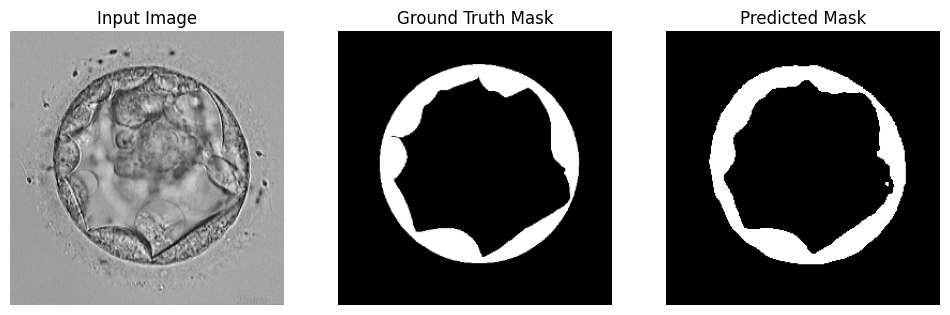

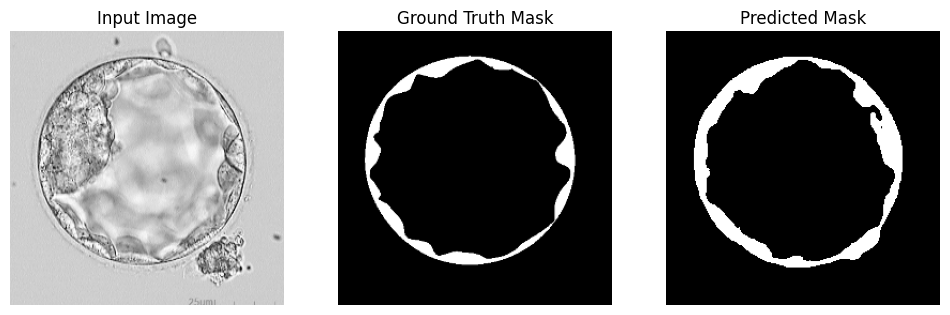

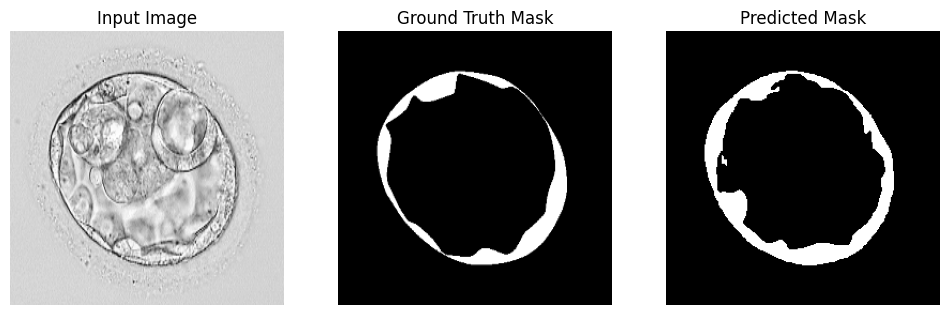

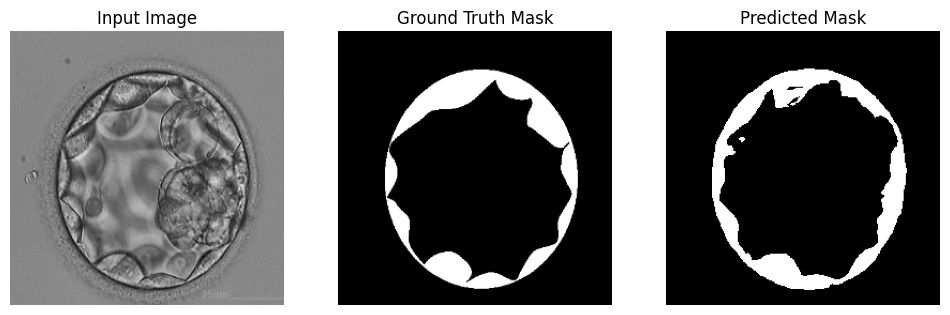

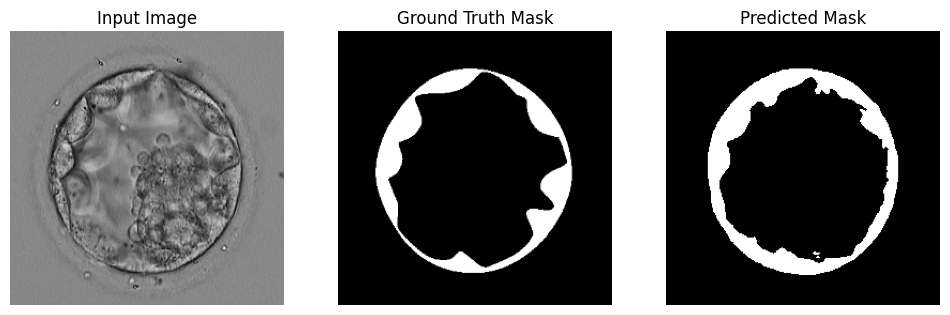

In [11]:
import matplotlib.pyplot as plt

def visualize_predictions(model, dataloader, device, num_samples=5, threshold=0.5):
    model.eval()
    images_shown = 0

    with torch.no_grad():
        for images, masks in dataloader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            for i in range(images.size(0)):
                if images_shown >= num_samples:
                    return

                image = images[i].cpu().numpy()
                image = image.transpose(1, 2, 0)
                gt_mask = masks[i].cpu().squeeze().numpy()
                pred_mask = preds[i].cpu().squeeze().numpy()

                # Threshold the predicted mask
                pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

                # Plot
                plt.figure(figsize=(12, 4))

                plt.subplot(1, 3, 1)
                plt.imshow(image, cmap='gray')
                plt.title('Input Image')
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.imshow(gt_mask, cmap='gray')
                plt.title('Ground Truth Mask')
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.imshow(pred_mask_bin, cmap='gray')
                plt.title('Predicted Mask')
                plt.axis('off')

                plt.show()

                images_shown += 1

visualize_predictions(model, valid_loader, DEVICE, num_samples=5)


In [12]:
def evaluate_on_test(model, test_loader, device):
    model.eval()
    dice_scores = []
    miou_scores = []
    accuracy_scores = []
    sensitivity_scores = []
    specificity_scores = []

    with torch.no_grad():
        for images, masks in test_loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            dice_scores.append(dice_score(masks, preds).item())
            miou_scores.append(mean_iou(masks, preds).item())
            accuracy_scores.append(accuracy(masks, preds).item())
            sensitivity_scores.append(sensitivity(masks, preds).item())
            specificity_scores.append(specificity(masks, preds).item())

    print(f"\n🔍 Test Results:")
    print(f"Dice Score     = {np.mean(dice_scores):.4f}")
    print(f"mIoU           = {np.mean(miou_scores):.4f}")
    print(f"Accuracy       = {np.mean(accuracy_scores):.4f}")
    print(f"Sensitivity    = {np.mean(sensitivity_scores):.4f}")
    print(f"Specificity    = {np.mean(specificity_scores):.4f}")

evaluate_on_test(model, test_loader, DEVICE)



🔍 Test Results:
Dice Score     = 0.8209
mIoU           = 0.6963
Accuracy       = 0.9544
Sensitivity    = 0.8422
Specificity    = 0.9700


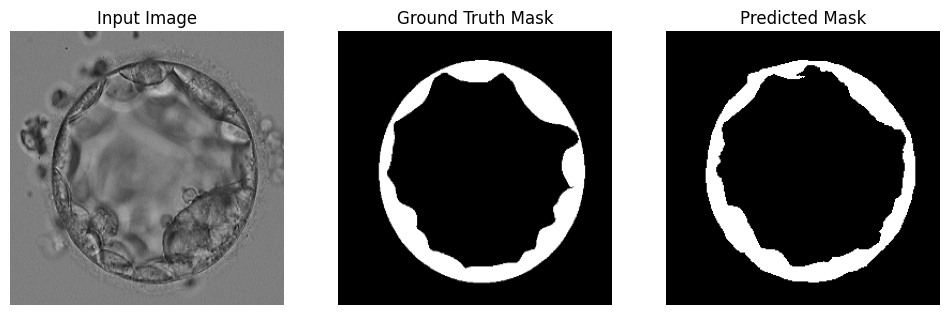

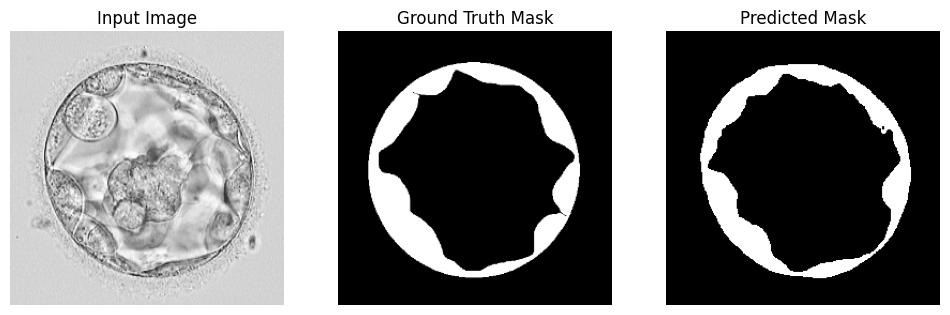

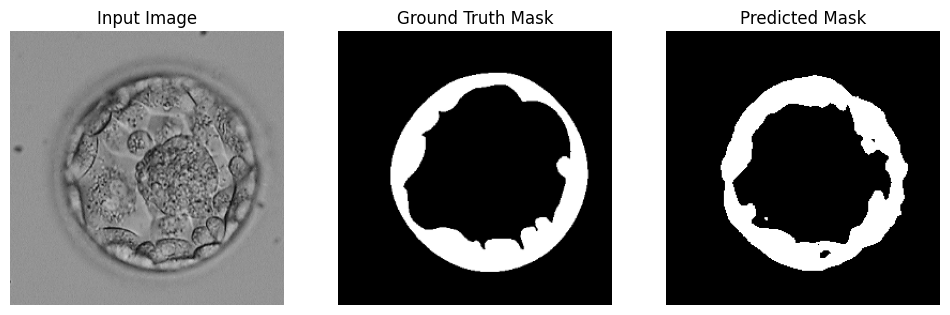

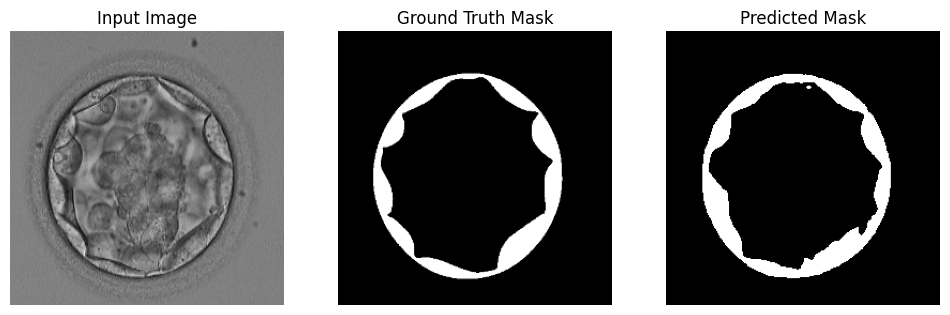

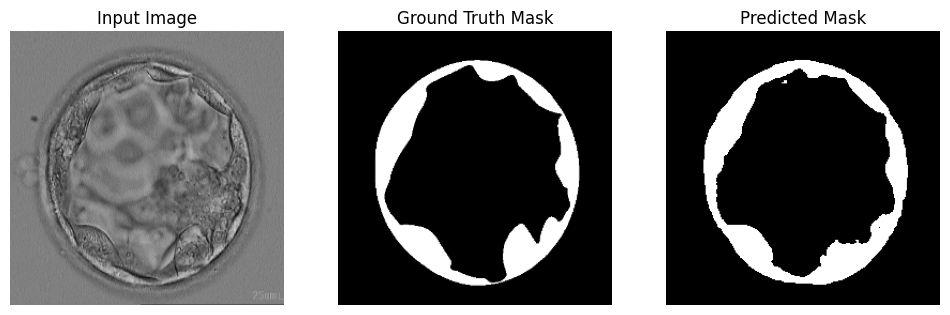

In [13]:
visualize_predictions(model, test_loader, DEVICE, num_samples=5)


In [14]:
pip install ptflops


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 16.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 28.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 676.4 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 39.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [15]:
from ptflops import get_model_complexity_info

# Add this right after model initialization
model = MALUNet().to(DEVICE)

# Calculate parameters and FLOPs
with torch.no_grad():
    macs, params = get_model_complexity_info(model, (3, 256, 256), as_strings=False,
                                           print_per_layer_stat=False, verbose=False)

# Convert to same units as paper (Millions and GFLOPs)
total_params = params / 1e6
total_flops = macs / 1e9

print(f"\nModel Statistics:")
print(f"Parameters: {total_params:.3f}M")
print(f"GFLOPs: {total_flops:.3f}\n")

# Add this to your training output
print(f"Model Params ↓ GFLOPs↓ mIoU↑ DSC↑ Acc↑ Spe↑ Sen↑")
print(f"{total_params:.3f} {total_flops:.3f} {np.mean(val_miou)*100:.2f} {np.mean(val_dice)*100:.2f} "
      f"{np.mean(val_accuracy)*100:.2f} {np.mean(val_specificity)*100:.2f} {np.mean(val_sensitivity)*100:.2f}")

SC_Att_Bridge was used

Model Statistics:
Parameters: 0.178M
GFLOPs: 0.090

Model Params ↓ GFLOPs↓ mIoU↑ DSC↑ Acc↑ Spe↑ Sen↑
0.178 0.090 65.89 79.43 95.50 97.31 80.53


SC_Att_Bridge was used


Epoch 1/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 1] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


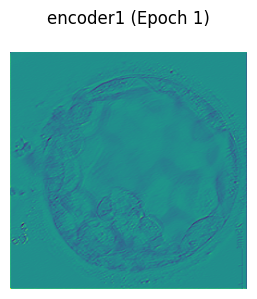

encoder2: torch.Size([3, 16, 128, 128])


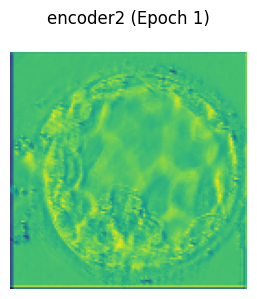

encoder3: torch.Size([3, 24, 64, 64])


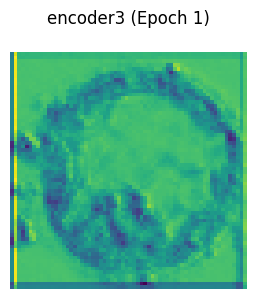

encoder4: torch.Size([3, 32, 32, 32])


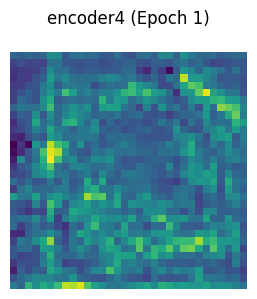

encoder5: torch.Size([3, 48, 16, 16])


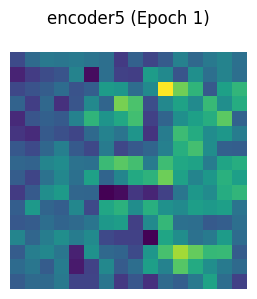

encoder6: torch.Size([3, 64, 8, 8])


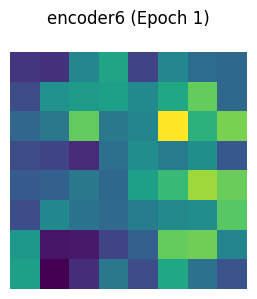

decoder1: torch.Size([3, 48, 8, 8])


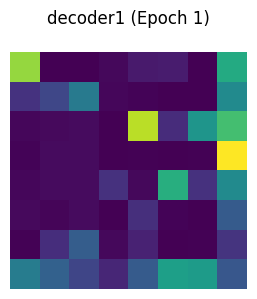

decoder2: torch.Size([3, 32, 8, 8])


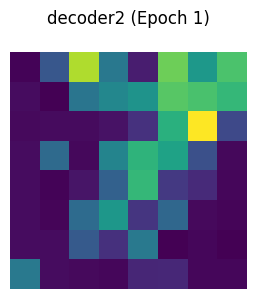

decoder3: torch.Size([3, 24, 16, 16])


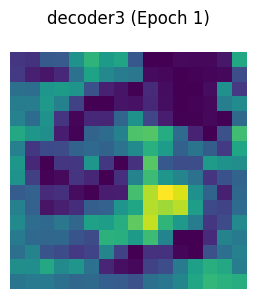

decoder4: torch.Size([3, 16, 32, 32])


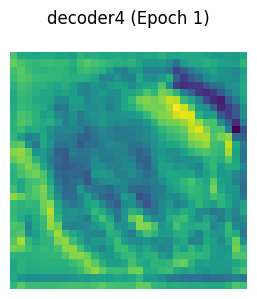

decoder5: torch.Size([3, 8, 64, 64])


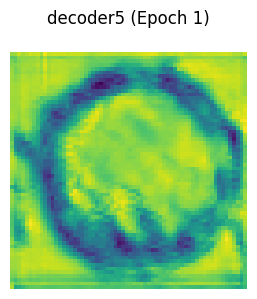

Epoch 1: Loss = 148.0445, Val Dice = 0.7389, Val mIoU = 0.5865, Val Accuracy = 0.9362, Val Sensitivity = 0.8393, Val Specificity = 0.9484


Epoch 2/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 2] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


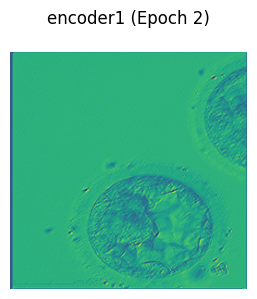

encoder2: torch.Size([3, 16, 128, 128])


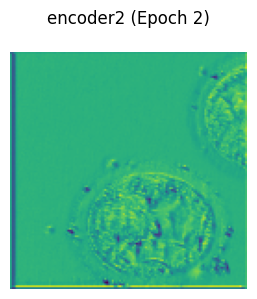

encoder3: torch.Size([3, 24, 64, 64])


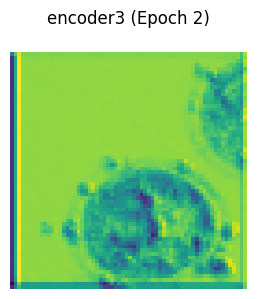

encoder4: torch.Size([3, 32, 32, 32])


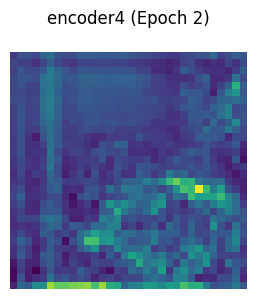

encoder5: torch.Size([3, 48, 16, 16])


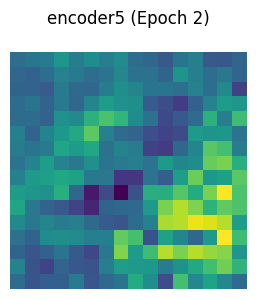

encoder6: torch.Size([3, 64, 8, 8])


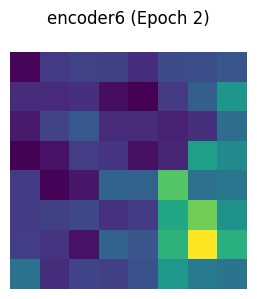

decoder1: torch.Size([3, 48, 8, 8])


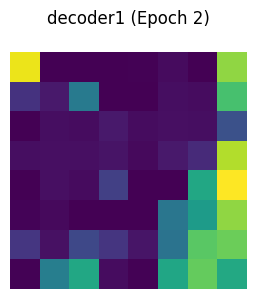

decoder2: torch.Size([3, 32, 8, 8])


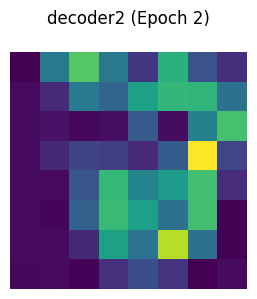

decoder3: torch.Size([3, 24, 16, 16])


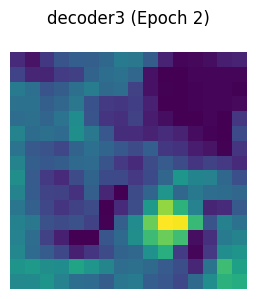

decoder4: torch.Size([3, 16, 32, 32])


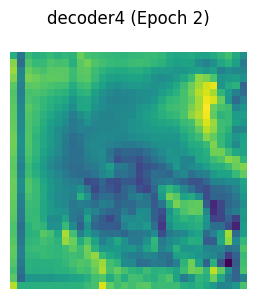

decoder5: torch.Size([3, 8, 64, 64])


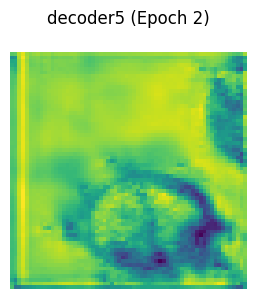

Epoch 2: Loss = 119.6837, Val Dice = 0.7618, Val mIoU = 0.6154, Val Accuracy = 0.9466, Val Sensitivity = 0.7939, Val Specificity = 0.9653


Epoch 3/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 3] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


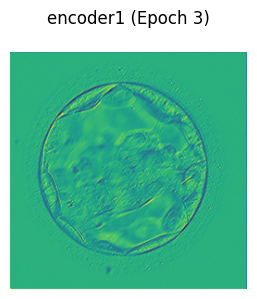

encoder2: torch.Size([3, 16, 128, 128])


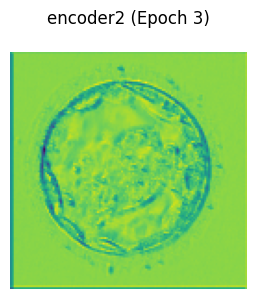

encoder3: torch.Size([3, 24, 64, 64])


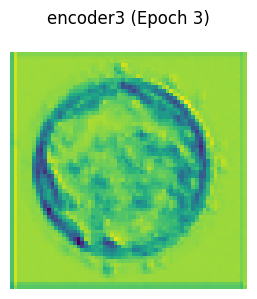

encoder4: torch.Size([3, 32, 32, 32])


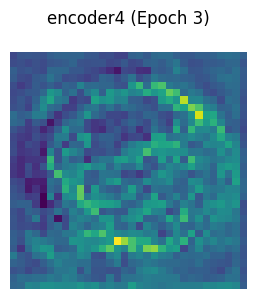

encoder5: torch.Size([3, 48, 16, 16])


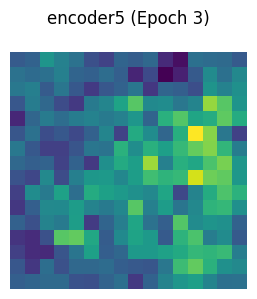

encoder6: torch.Size([3, 64, 8, 8])


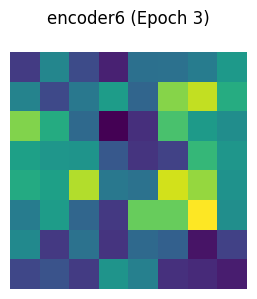

decoder1: torch.Size([3, 48, 8, 8])


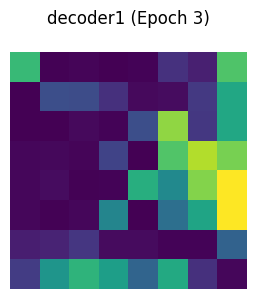

decoder2: torch.Size([3, 32, 8, 8])


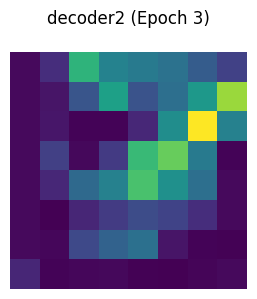

decoder3: torch.Size([3, 24, 16, 16])


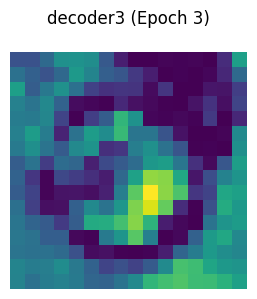

decoder4: torch.Size([3, 16, 32, 32])


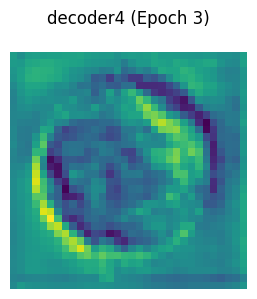

decoder5: torch.Size([3, 8, 64, 64])


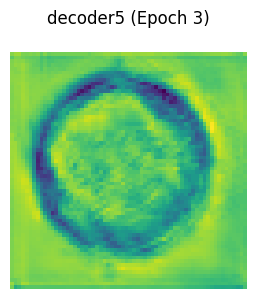

Epoch 3: Loss = 116.4741, Val Dice = 0.7618, Val mIoU = 0.6155, Val Accuracy = 0.9471, Val Sensitivity = 0.7881, Val Specificity = 0.9663


Epoch 4/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 4] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


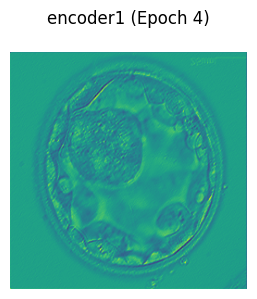

encoder2: torch.Size([3, 16, 128, 128])


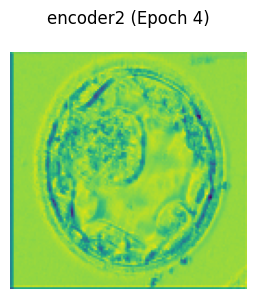

encoder3: torch.Size([3, 24, 64, 64])


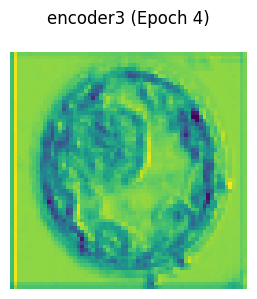

encoder4: torch.Size([3, 32, 32, 32])


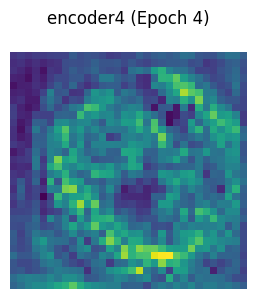

encoder5: torch.Size([3, 48, 16, 16])


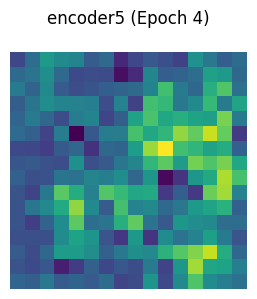

encoder6: torch.Size([3, 64, 8, 8])


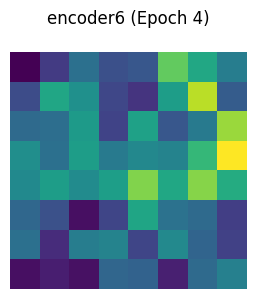

decoder1: torch.Size([3, 48, 8, 8])


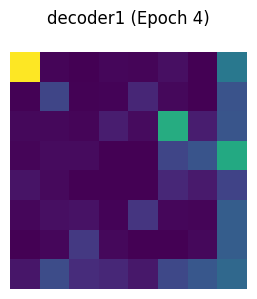

decoder2: torch.Size([3, 32, 8, 8])


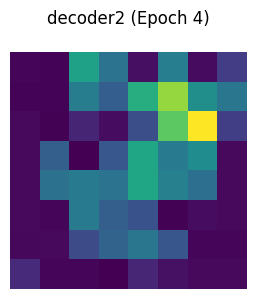

decoder3: torch.Size([3, 24, 16, 16])


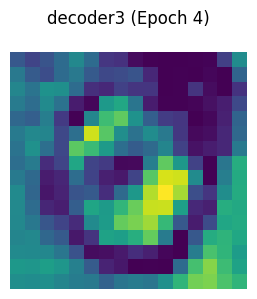

decoder4: torch.Size([3, 16, 32, 32])


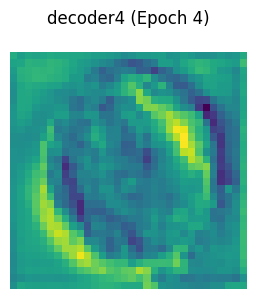

decoder5: torch.Size([3, 8, 64, 64])


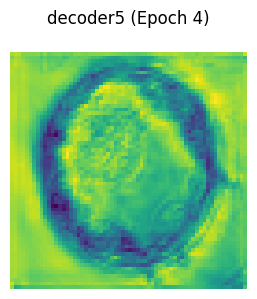

Epoch 4: Loss = 114.8024, Val Dice = 0.7693, Val mIoU = 0.6253, Val Accuracy = 0.9480, Val Sensitivity = 0.8055, Val Specificity = 0.9654


Epoch 5/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 5] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


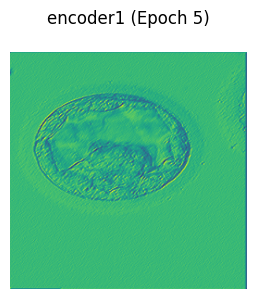

encoder2: torch.Size([3, 16, 128, 128])


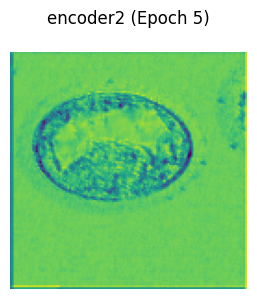

encoder3: torch.Size([3, 24, 64, 64])


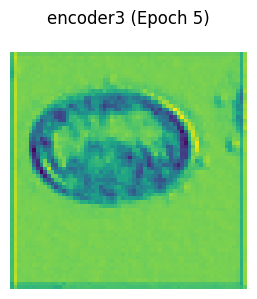

encoder4: torch.Size([3, 32, 32, 32])


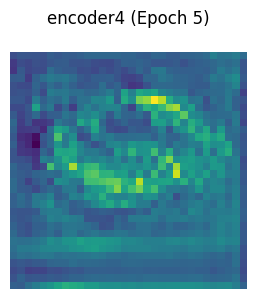

encoder5: torch.Size([3, 48, 16, 16])


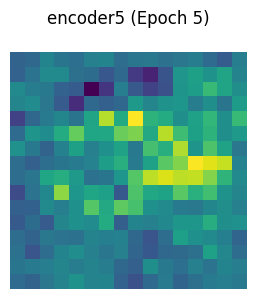

encoder6: torch.Size([3, 64, 8, 8])


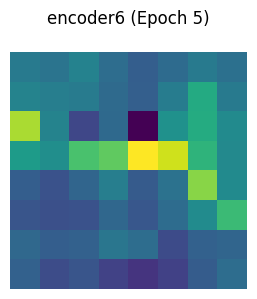

decoder1: torch.Size([3, 48, 8, 8])


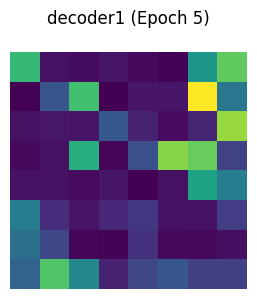

decoder2: torch.Size([3, 32, 8, 8])


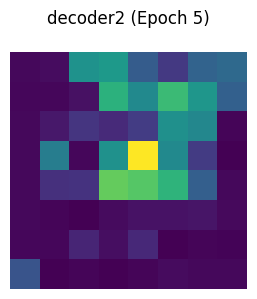

decoder3: torch.Size([3, 24, 16, 16])


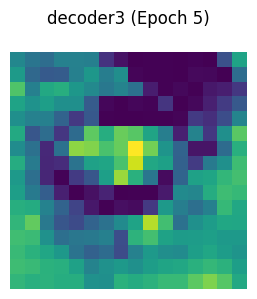

decoder4: torch.Size([3, 16, 32, 32])


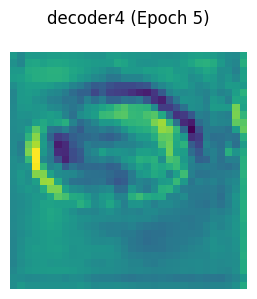

decoder5: torch.Size([3, 8, 64, 64])


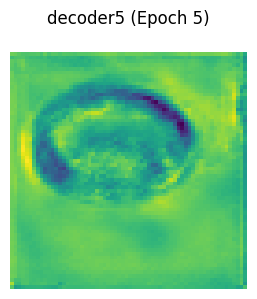

Epoch 5: Loss = 113.5705, Val Dice = 0.7588, Val mIoU = 0.6115, Val Accuracy = 0.9466, Val Sensitivity = 0.7838, Val Specificity = 0.9663


Epoch 6/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 6] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


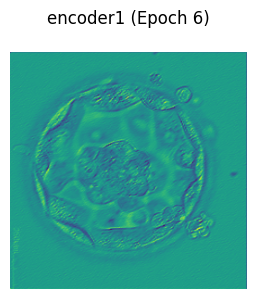

encoder2: torch.Size([3, 16, 128, 128])


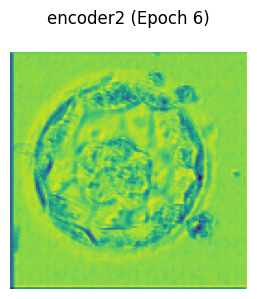

encoder3: torch.Size([3, 24, 64, 64])


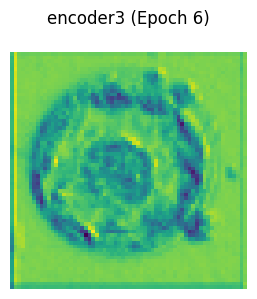

encoder4: torch.Size([3, 32, 32, 32])


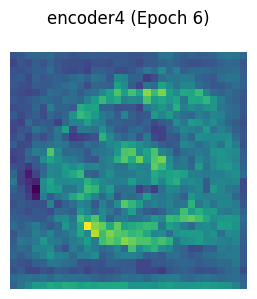

encoder5: torch.Size([3, 48, 16, 16])


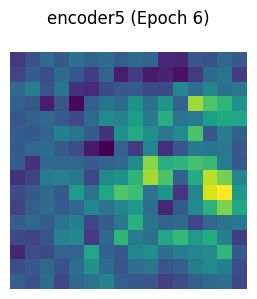

encoder6: torch.Size([3, 64, 8, 8])


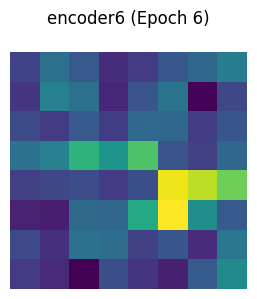

decoder1: torch.Size([3, 48, 8, 8])


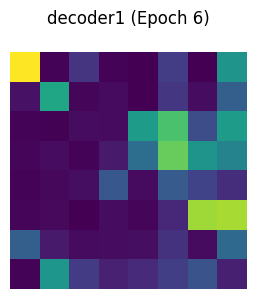

decoder2: torch.Size([3, 32, 8, 8])


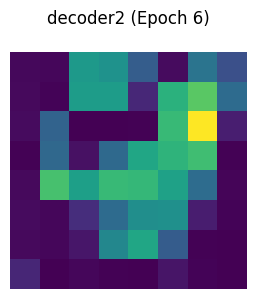

decoder3: torch.Size([3, 24, 16, 16])


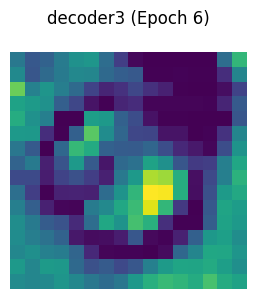

decoder4: torch.Size([3, 16, 32, 32])


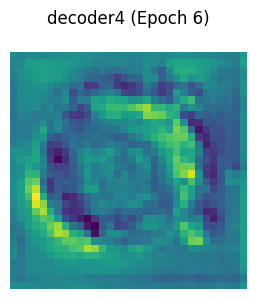

decoder5: torch.Size([3, 8, 64, 64])


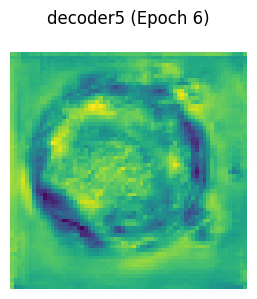

Epoch 6: Loss = 112.4308, Val Dice = 0.7798, Val mIoU = 0.6392, Val Accuracy = 0.9498, Val Sensitivity = 0.8254, Val Specificity = 0.9649


Epoch 7/100: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


[Epoch 7] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


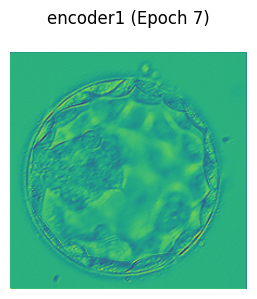

encoder2: torch.Size([3, 16, 128, 128])


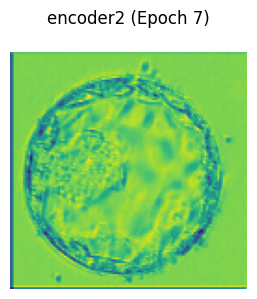

encoder3: torch.Size([3, 24, 64, 64])


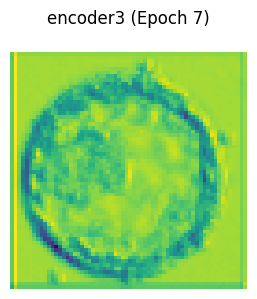

encoder4: torch.Size([3, 32, 32, 32])


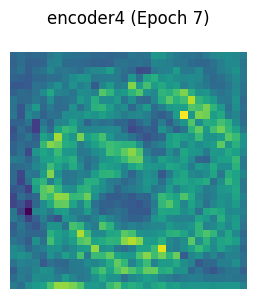

encoder5: torch.Size([3, 48, 16, 16])


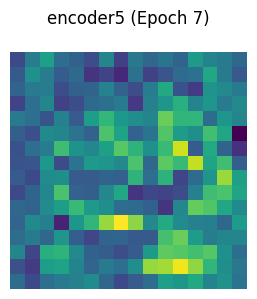

encoder6: torch.Size([3, 64, 8, 8])


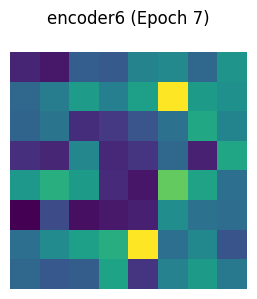

decoder1: torch.Size([3, 48, 8, 8])


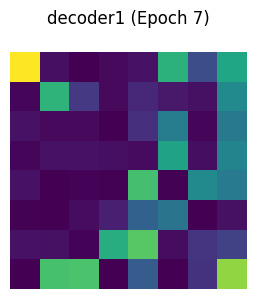

decoder2: torch.Size([3, 32, 8, 8])


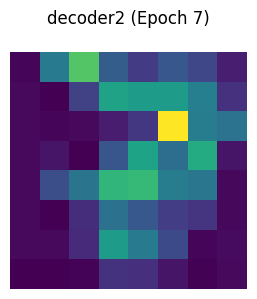

decoder3: torch.Size([3, 24, 16, 16])


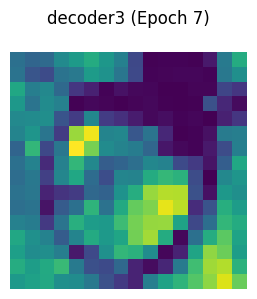

decoder4: torch.Size([3, 16, 32, 32])


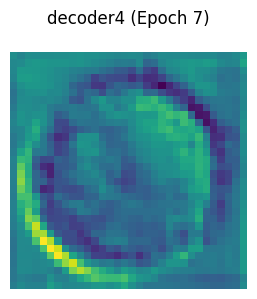

decoder5: torch.Size([3, 8, 64, 64])


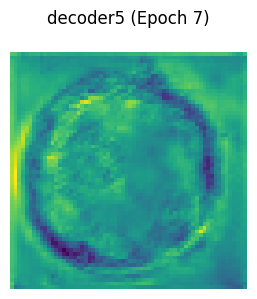

Epoch 7: Loss = 111.6953, Val Dice = 0.7670, Val mIoU = 0.6224, Val Accuracy = 0.9497, Val Sensitivity = 0.7706, Val Specificity = 0.9714


Epoch 8/100: 100%|██████████| 125/125 [01:41<00:00,  1.23it/s]


[Epoch 8] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


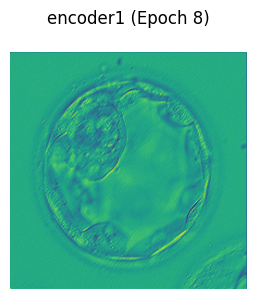

encoder2: torch.Size([3, 16, 128, 128])


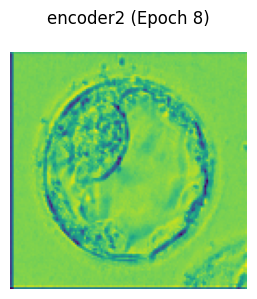

encoder3: torch.Size([3, 24, 64, 64])


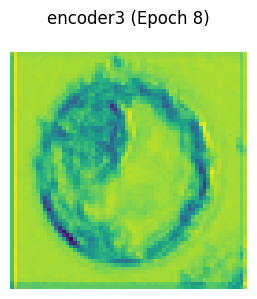

encoder4: torch.Size([3, 32, 32, 32])


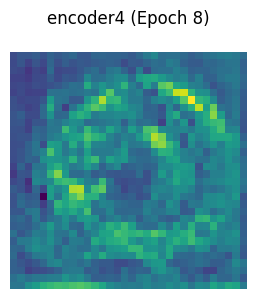

encoder5: torch.Size([3, 48, 16, 16])


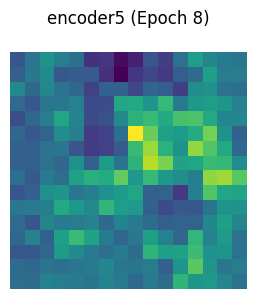

encoder6: torch.Size([3, 64, 8, 8])


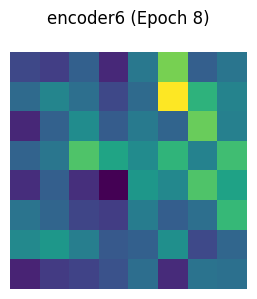

decoder1: torch.Size([3, 48, 8, 8])


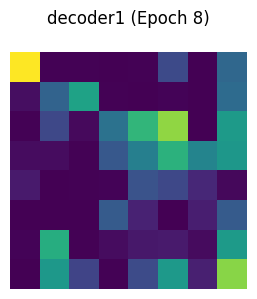

decoder2: torch.Size([3, 32, 8, 8])


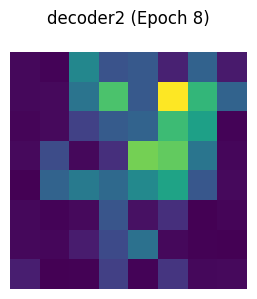

decoder3: torch.Size([3, 24, 16, 16])


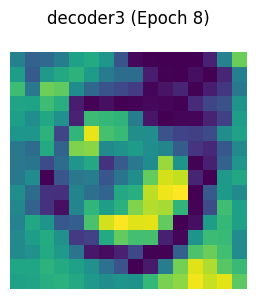

decoder4: torch.Size([3, 16, 32, 32])


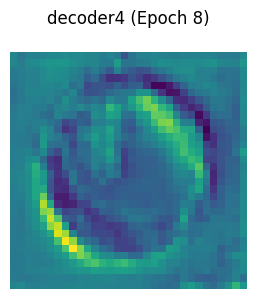

decoder5: torch.Size([3, 8, 64, 64])


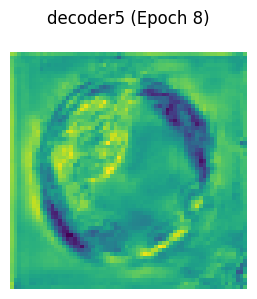

Epoch 8: Loss = 110.9169, Val Dice = 0.7810, Val mIoU = 0.6407, Val Accuracy = 0.9497, Val Sensitivity = 0.8337, Val Specificity = 0.9637


Epoch 9/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 9] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


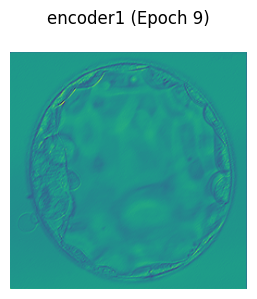

encoder2: torch.Size([3, 16, 128, 128])


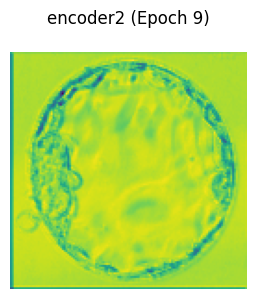

encoder3: torch.Size([3, 24, 64, 64])


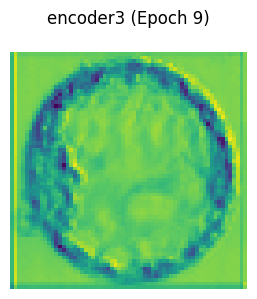

encoder4: torch.Size([3, 32, 32, 32])


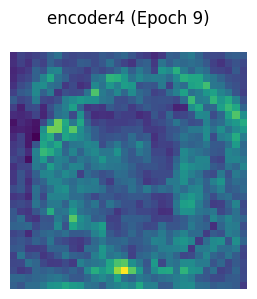

encoder5: torch.Size([3, 48, 16, 16])


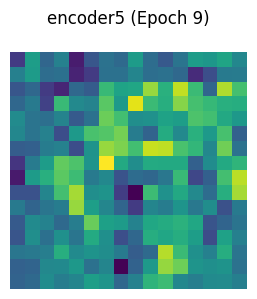

encoder6: torch.Size([3, 64, 8, 8])


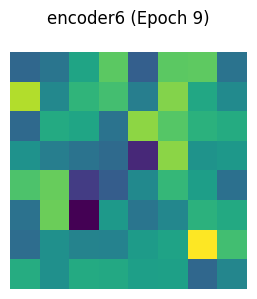

decoder1: torch.Size([3, 48, 8, 8])


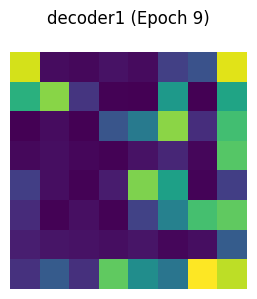

decoder2: torch.Size([3, 32, 8, 8])


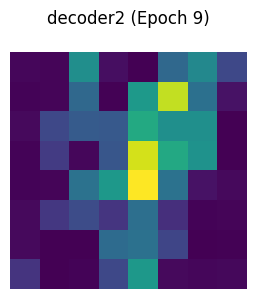

decoder3: torch.Size([3, 24, 16, 16])


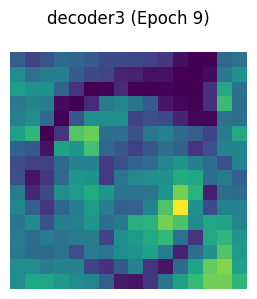

decoder4: torch.Size([3, 16, 32, 32])


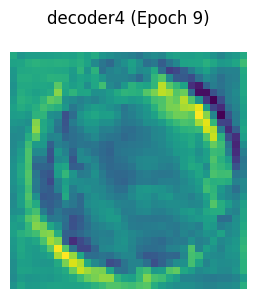

decoder5: torch.Size([3, 8, 64, 64])


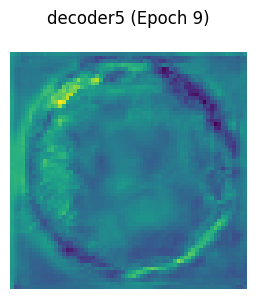

Epoch 9: Loss = 110.0063, Val Dice = 0.7786, Val mIoU = 0.6376, Val Accuracy = 0.9497, Val Sensitivity = 0.8243, Val Specificity = 0.9648


Epoch 10/100: 100%|██████████| 125/125 [01:48<00:00,  1.15it/s]


[Epoch 10] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


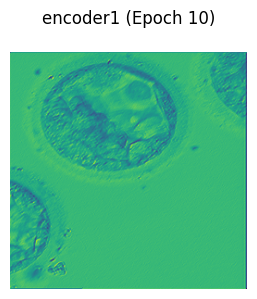

encoder2: torch.Size([3, 16, 128, 128])


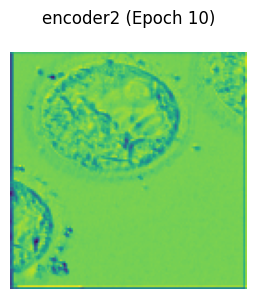

encoder3: torch.Size([3, 24, 64, 64])


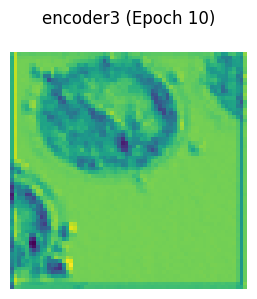

encoder4: torch.Size([3, 32, 32, 32])


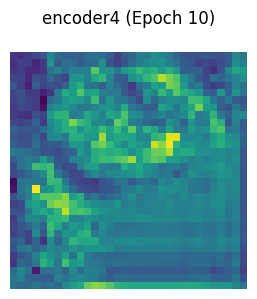

encoder5: torch.Size([3, 48, 16, 16])


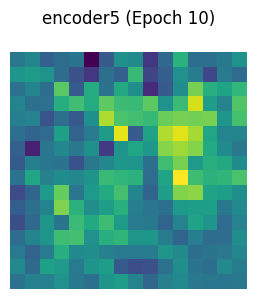

encoder6: torch.Size([3, 64, 8, 8])


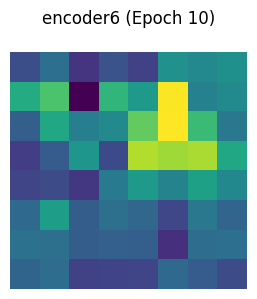

decoder1: torch.Size([3, 48, 8, 8])


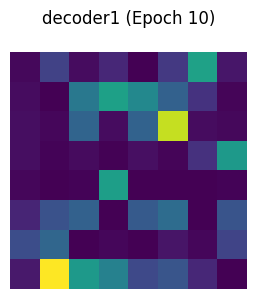

decoder2: torch.Size([3, 32, 8, 8])


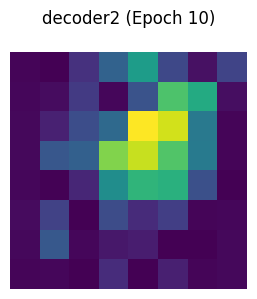

decoder3: torch.Size([3, 24, 16, 16])


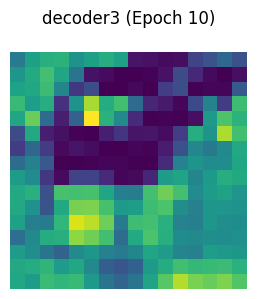

decoder4: torch.Size([3, 16, 32, 32])


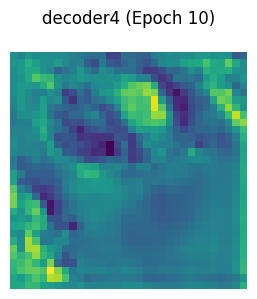

decoder5: torch.Size([3, 8, 64, 64])


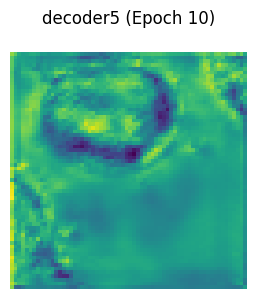

Epoch 10: Loss = 109.2014, Val Dice = 0.7759, Val mIoU = 0.6340, Val Accuracy = 0.9461, Val Sensitivity = 0.8683, Val Specificity = 0.9554


Epoch 11/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 11] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


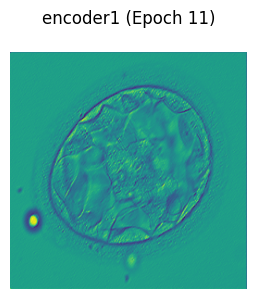

encoder2: torch.Size([3, 16, 128, 128])


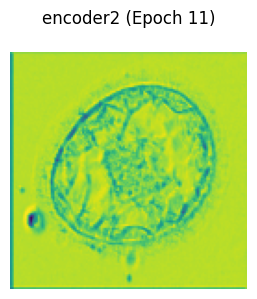

encoder3: torch.Size([3, 24, 64, 64])


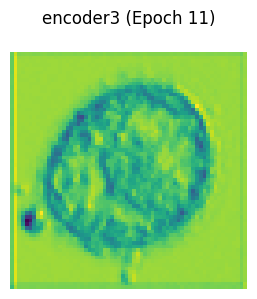

encoder4: torch.Size([3, 32, 32, 32])


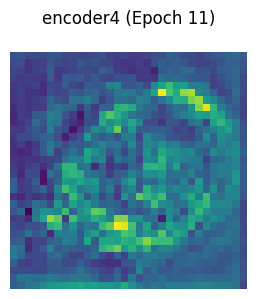

encoder5: torch.Size([3, 48, 16, 16])


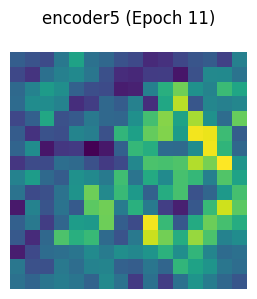

encoder6: torch.Size([3, 64, 8, 8])


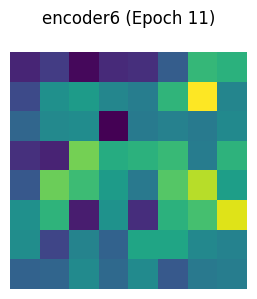

decoder1: torch.Size([3, 48, 8, 8])


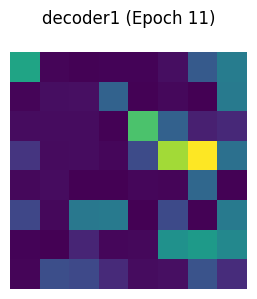

decoder2: torch.Size([3, 32, 8, 8])


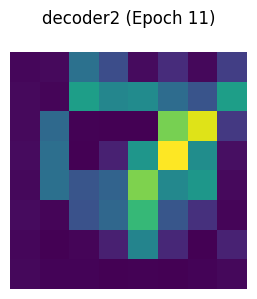

decoder3: torch.Size([3, 24, 16, 16])


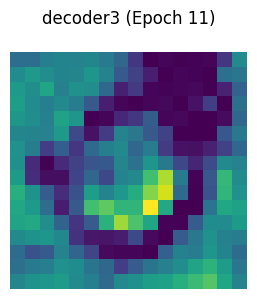

decoder4: torch.Size([3, 16, 32, 32])


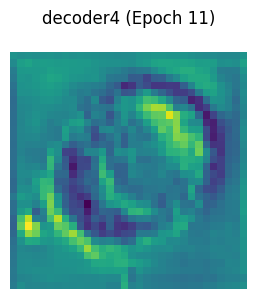

decoder5: torch.Size([3, 8, 64, 64])


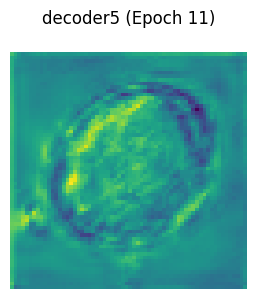

Epoch 11: Loss = 108.6288, Val Dice = 0.7770, Val mIoU = 0.6355, Val Accuracy = 0.9504, Val Sensitivity = 0.8037, Val Specificity = 0.9680


Epoch 12/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 12] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


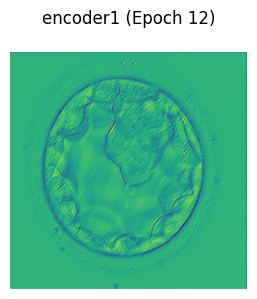

encoder2: torch.Size([3, 16, 128, 128])


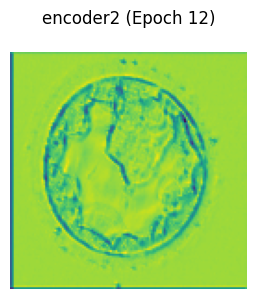

encoder3: torch.Size([3, 24, 64, 64])


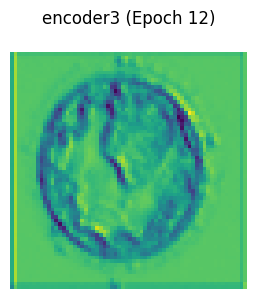

encoder4: torch.Size([3, 32, 32, 32])


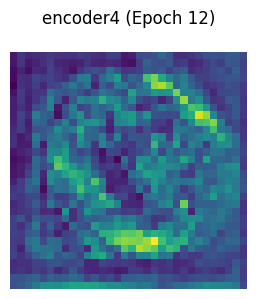

encoder5: torch.Size([3, 48, 16, 16])


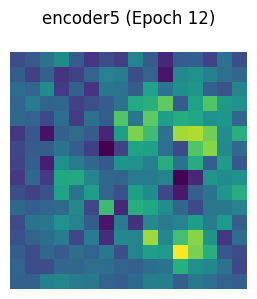

encoder6: torch.Size([3, 64, 8, 8])


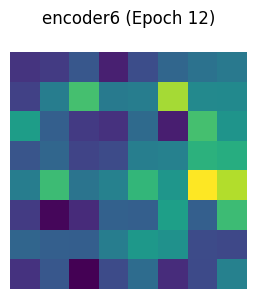

decoder1: torch.Size([3, 48, 8, 8])


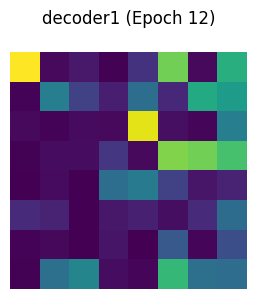

decoder2: torch.Size([3, 32, 8, 8])


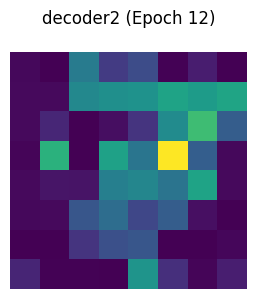

decoder3: torch.Size([3, 24, 16, 16])


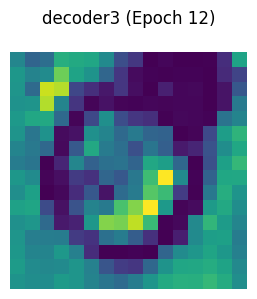

decoder4: torch.Size([3, 16, 32, 32])


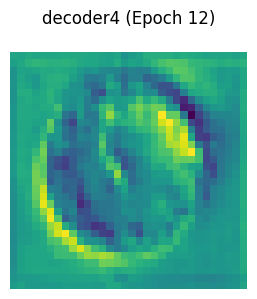

decoder5: torch.Size([3, 8, 64, 64])


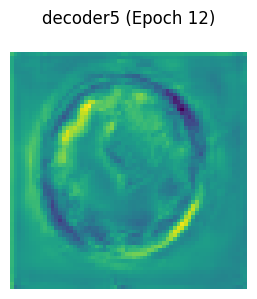

Epoch 12: Loss = 107.7673, Val Dice = 0.7837, Val mIoU = 0.6445, Val Accuracy = 0.9497, Val Sensitivity = 0.8456, Val Specificity = 0.9622


Epoch 13/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 13] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


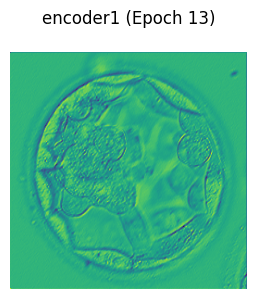

encoder2: torch.Size([3, 16, 128, 128])


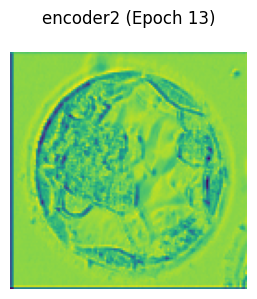

encoder3: torch.Size([3, 24, 64, 64])


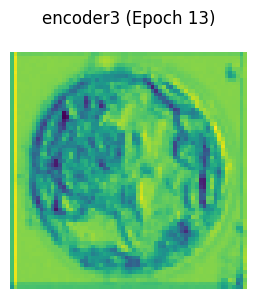

encoder4: torch.Size([3, 32, 32, 32])


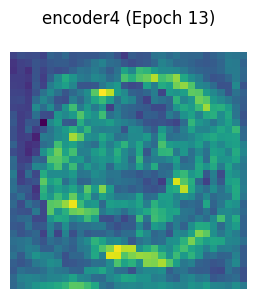

encoder5: torch.Size([3, 48, 16, 16])


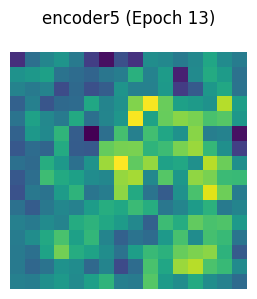

encoder6: torch.Size([3, 64, 8, 8])


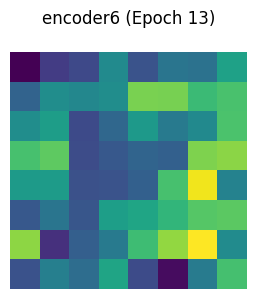

decoder1: torch.Size([3, 48, 8, 8])


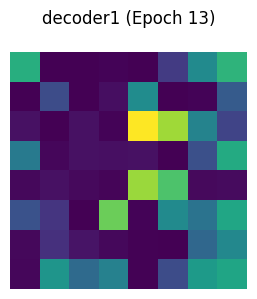

decoder2: torch.Size([3, 32, 8, 8])


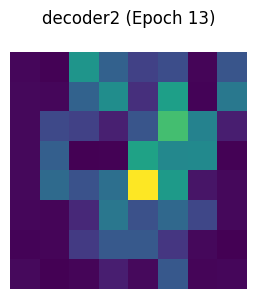

decoder3: torch.Size([3, 24, 16, 16])


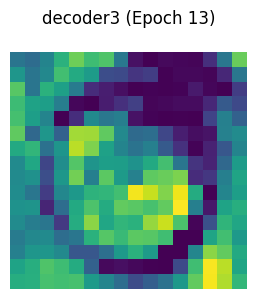

decoder4: torch.Size([3, 16, 32, 32])


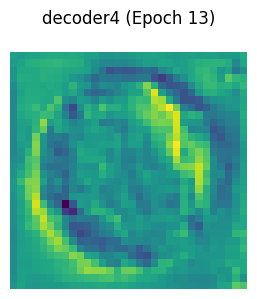

decoder5: torch.Size([3, 8, 64, 64])


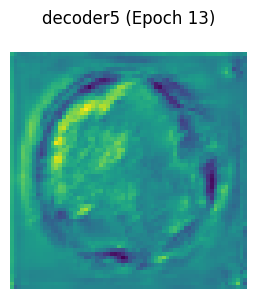

Epoch 13: Loss = 107.0280, Val Dice = 0.7826, Val mIoU = 0.6430, Val Accuracy = 0.9524, Val Sensitivity = 0.7961, Val Specificity = 0.9713


Epoch 14/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 14] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


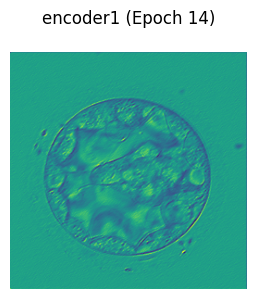

encoder2: torch.Size([3, 16, 128, 128])


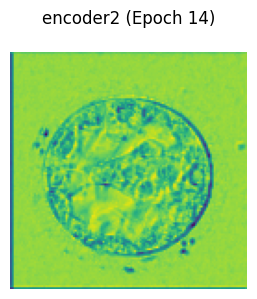

encoder3: torch.Size([3, 24, 64, 64])


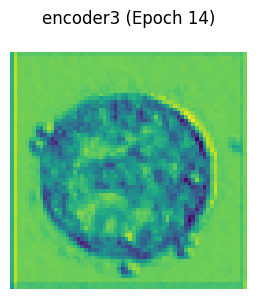

encoder4: torch.Size([3, 32, 32, 32])


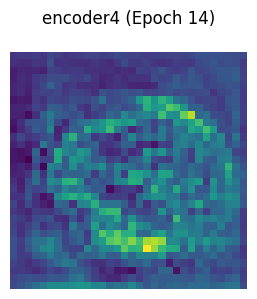

encoder5: torch.Size([3, 48, 16, 16])


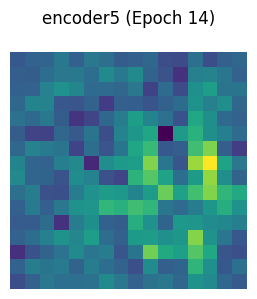

encoder6: torch.Size([3, 64, 8, 8])


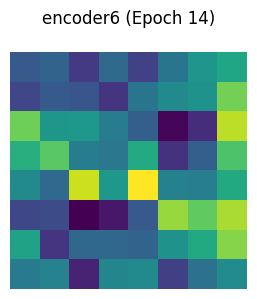

decoder1: torch.Size([3, 48, 8, 8])


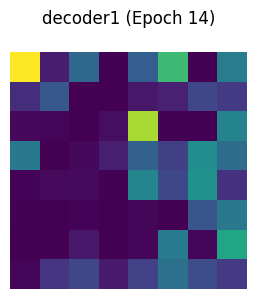

decoder2: torch.Size([3, 32, 8, 8])


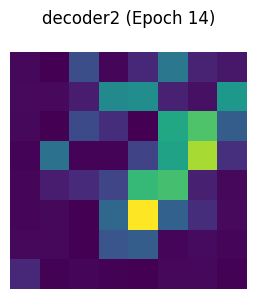

decoder3: torch.Size([3, 24, 16, 16])


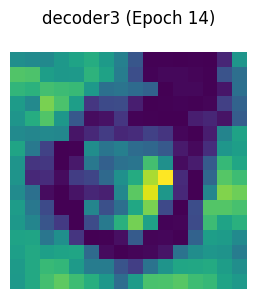

decoder4: torch.Size([3, 16, 32, 32])


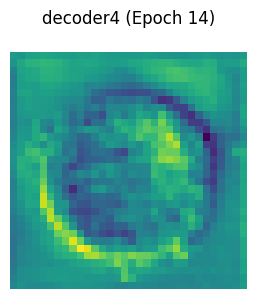

decoder5: torch.Size([3, 8, 64, 64])


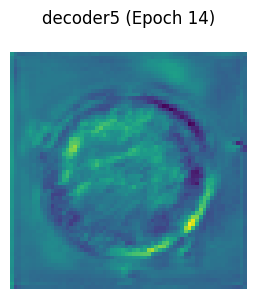

Epoch 14: Loss = 106.3988, Val Dice = 0.7849, Val mIoU = 0.6461, Val Accuracy = 0.9517, Val Sensitivity = 0.8223, Val Specificity = 0.9671


Epoch 15/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 15] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


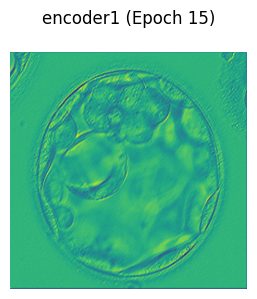

encoder2: torch.Size([3, 16, 128, 128])


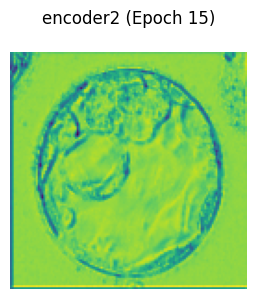

encoder3: torch.Size([3, 24, 64, 64])


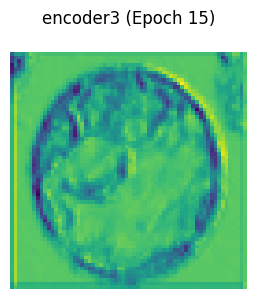

encoder4: torch.Size([3, 32, 32, 32])


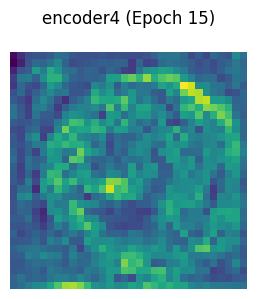

encoder5: torch.Size([3, 48, 16, 16])


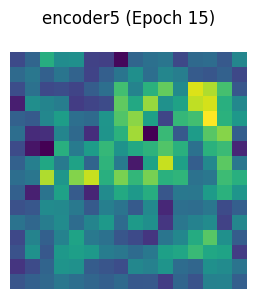

encoder6: torch.Size([3, 64, 8, 8])


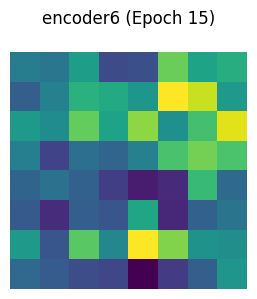

decoder1: torch.Size([3, 48, 8, 8])


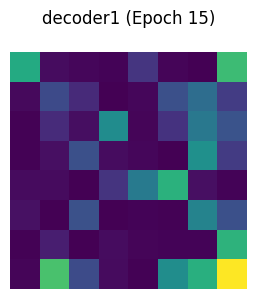

decoder2: torch.Size([3, 32, 8, 8])


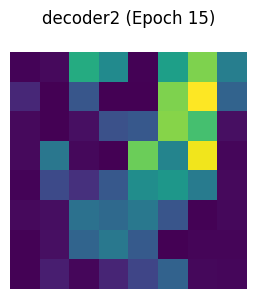

decoder3: torch.Size([3, 24, 16, 16])


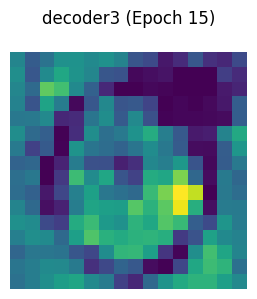

decoder4: torch.Size([3, 16, 32, 32])


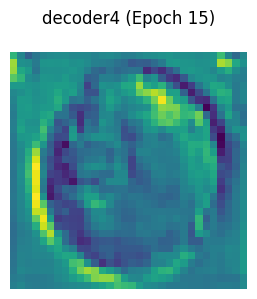

decoder5: torch.Size([3, 8, 64, 64])


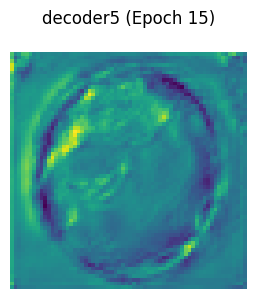

Epoch 15: Loss = 105.9092, Val Dice = 0.7911, Val mIoU = 0.6545, Val Accuracy = 0.9539, Val Sensitivity = 0.8082, Val Specificity = 0.9716


Epoch 16/100: 100%|██████████| 125/125 [01:50<00:00,  1.13it/s]


[Epoch 16] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


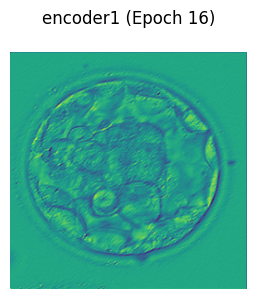

encoder2: torch.Size([3, 16, 128, 128])


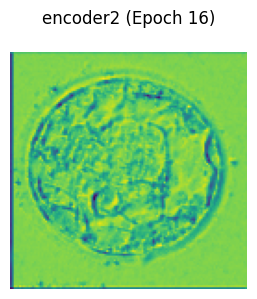

encoder3: torch.Size([3, 24, 64, 64])


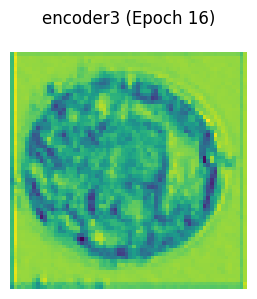

encoder4: torch.Size([3, 32, 32, 32])


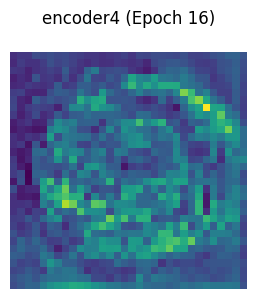

encoder5: torch.Size([3, 48, 16, 16])


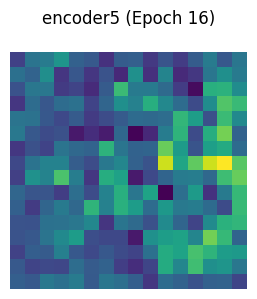

encoder6: torch.Size([3, 64, 8, 8])


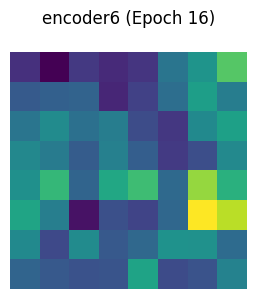

decoder1: torch.Size([3, 48, 8, 8])


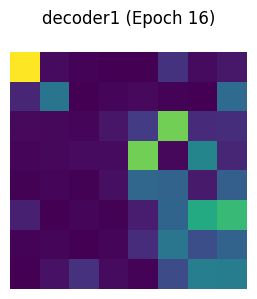

decoder2: torch.Size([3, 32, 8, 8])


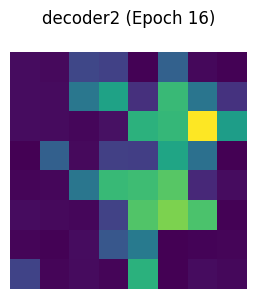

decoder3: torch.Size([3, 24, 16, 16])


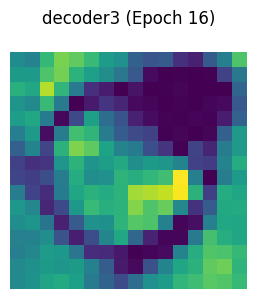

decoder4: torch.Size([3, 16, 32, 32])


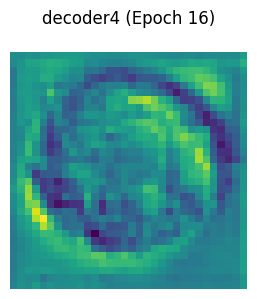

decoder5: torch.Size([3, 8, 64, 64])


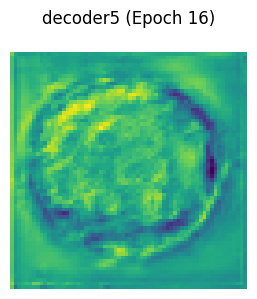

Epoch 16: Loss = 105.3245, Val Dice = 0.7751, Val mIoU = 0.6328, Val Accuracy = 0.9516, Val Sensitivity = 0.7741, Val Specificity = 0.9732


Epoch 17/100: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


[Epoch 17] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


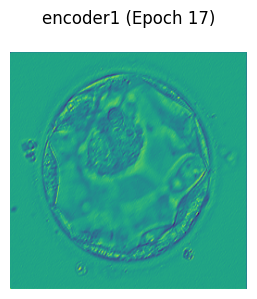

encoder2: torch.Size([3, 16, 128, 128])


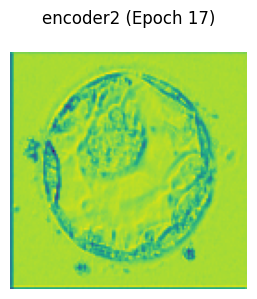

encoder3: torch.Size([3, 24, 64, 64])


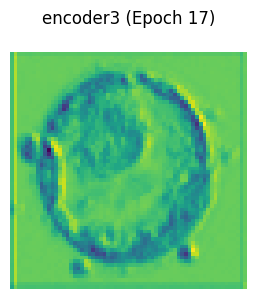

encoder4: torch.Size([3, 32, 32, 32])


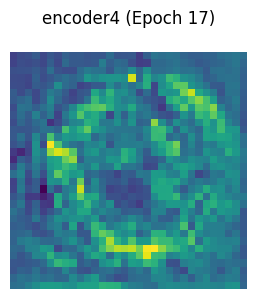

encoder5: torch.Size([3, 48, 16, 16])


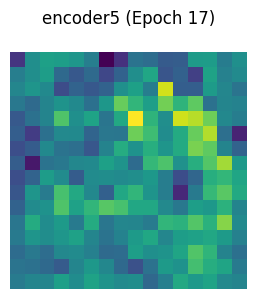

encoder6: torch.Size([3, 64, 8, 8])


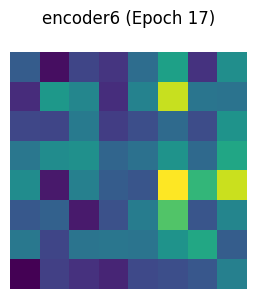

decoder1: torch.Size([3, 48, 8, 8])


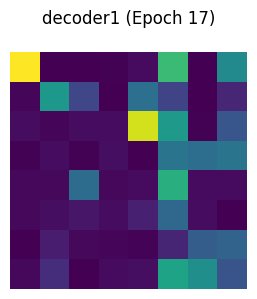

decoder2: torch.Size([3, 32, 8, 8])


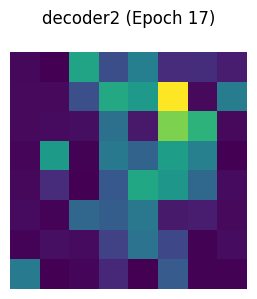

decoder3: torch.Size([3, 24, 16, 16])


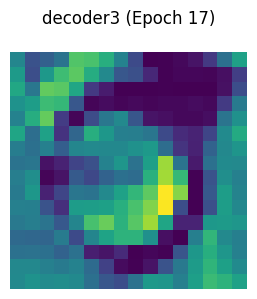

decoder4: torch.Size([3, 16, 32, 32])


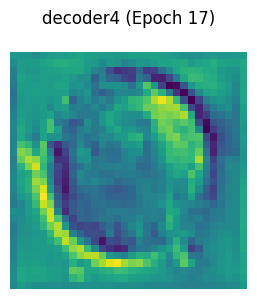

decoder5: torch.Size([3, 8, 64, 64])


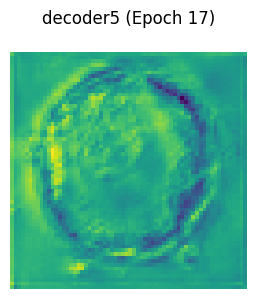

Epoch 17: Loss = 104.5229, Val Dice = 0.7860, Val mIoU = 0.6476, Val Accuracy = 0.9527, Val Sensitivity = 0.8067, Val Specificity = 0.9706


Epoch 18/100: 100%|██████████| 125/125 [01:44<00:00,  1.19it/s]


[Epoch 18] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


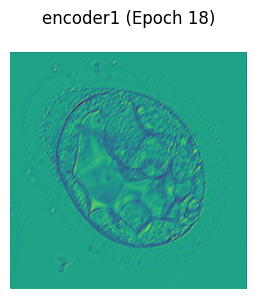

encoder2: torch.Size([3, 16, 128, 128])


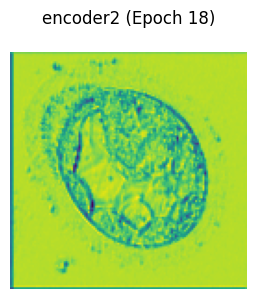

encoder3: torch.Size([3, 24, 64, 64])


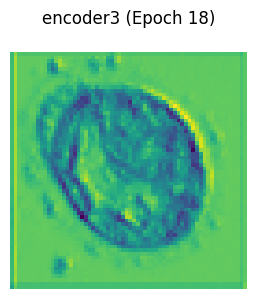

encoder4: torch.Size([3, 32, 32, 32])


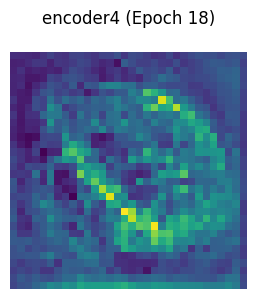

encoder5: torch.Size([3, 48, 16, 16])


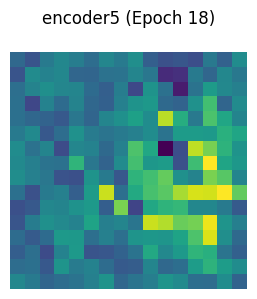

encoder6: torch.Size([3, 64, 8, 8])


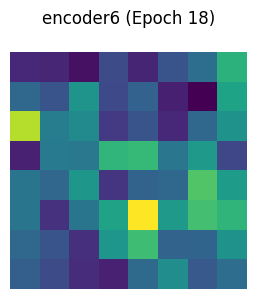

decoder1: torch.Size([3, 48, 8, 8])


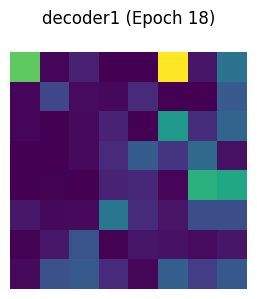

decoder2: torch.Size([3, 32, 8, 8])


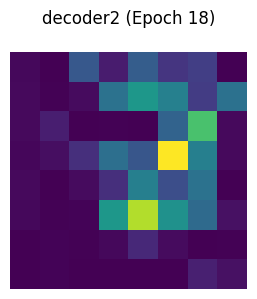

decoder3: torch.Size([3, 24, 16, 16])


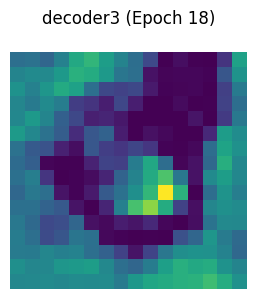

decoder4: torch.Size([3, 16, 32, 32])


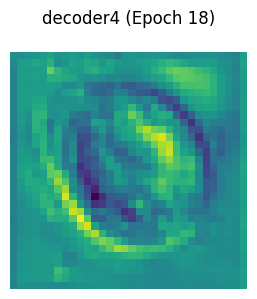

decoder5: torch.Size([3, 8, 64, 64])


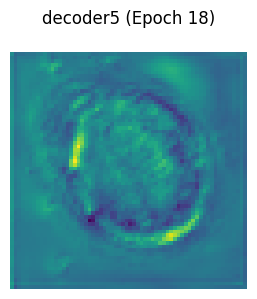

Epoch 18: Loss = 103.6665, Val Dice = 0.7806, Val mIoU = 0.6402, Val Accuracy = 0.9510, Val Sensitivity = 0.8085, Val Specificity = 0.9683


Epoch 19/100: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


[Epoch 19] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


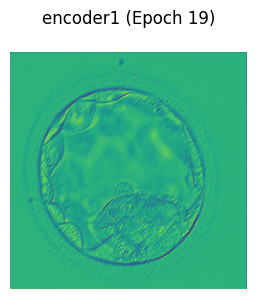

encoder2: torch.Size([3, 16, 128, 128])


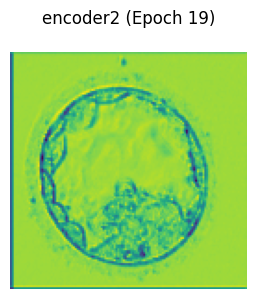

encoder3: torch.Size([3, 24, 64, 64])


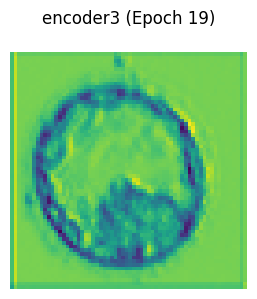

encoder4: torch.Size([3, 32, 32, 32])


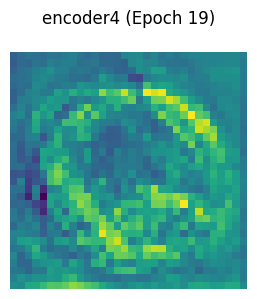

encoder5: torch.Size([3, 48, 16, 16])


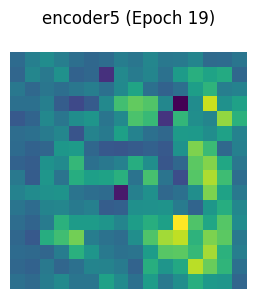

encoder6: torch.Size([3, 64, 8, 8])


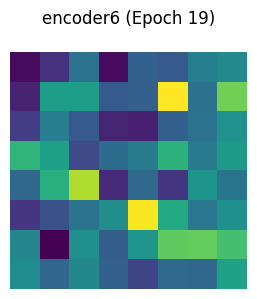

decoder1: torch.Size([3, 48, 8, 8])


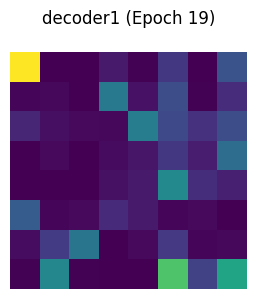

decoder2: torch.Size([3, 32, 8, 8])


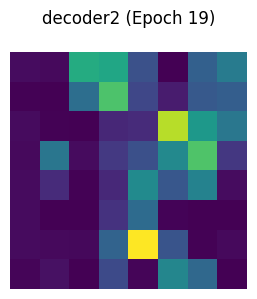

decoder3: torch.Size([3, 24, 16, 16])


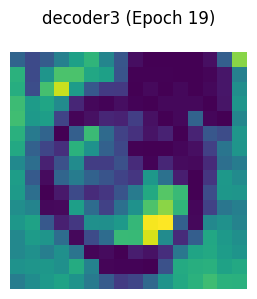

decoder4: torch.Size([3, 16, 32, 32])


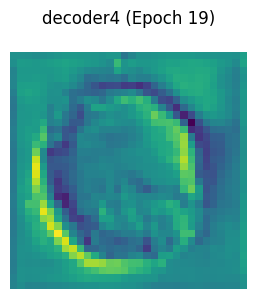

decoder5: torch.Size([3, 8, 64, 64])


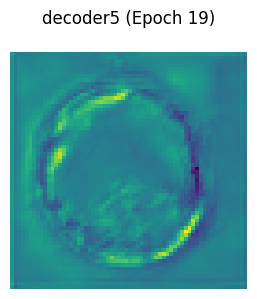

Epoch 19: Loss = 102.9454, Val Dice = 0.7802, Val mIoU = 0.6397, Val Accuracy = 0.9515, Val Sensitivity = 0.7987, Val Specificity = 0.9701


Epoch 20/100: 100%|██████████| 125/125 [01:46<00:00,  1.18it/s]


[Epoch 20] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


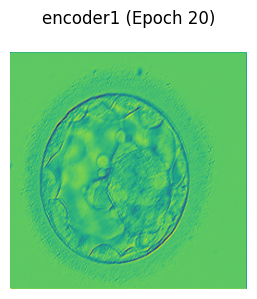

encoder2: torch.Size([3, 16, 128, 128])


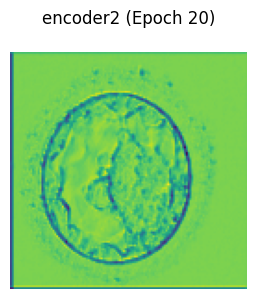

encoder3: torch.Size([3, 24, 64, 64])


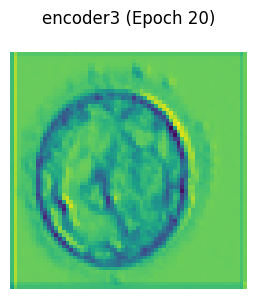

encoder4: torch.Size([3, 32, 32, 32])


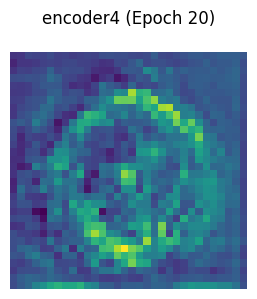

encoder5: torch.Size([3, 48, 16, 16])


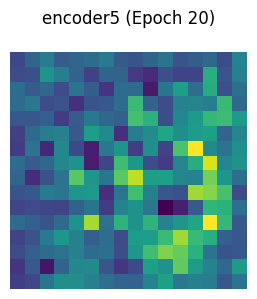

encoder6: torch.Size([3, 64, 8, 8])


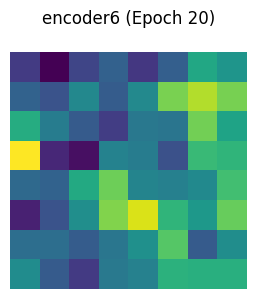

decoder1: torch.Size([3, 48, 8, 8])


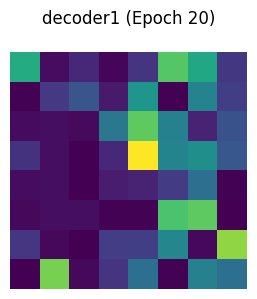

decoder2: torch.Size([3, 32, 8, 8])


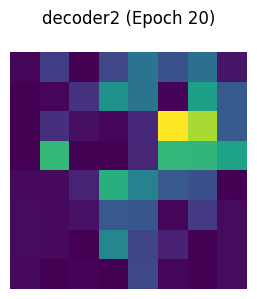

decoder3: torch.Size([3, 24, 16, 16])


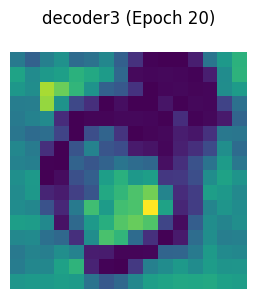

decoder4: torch.Size([3, 16, 32, 32])


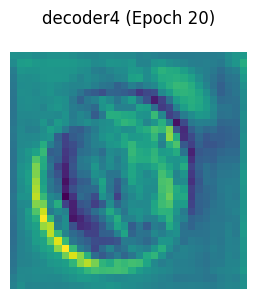

decoder5: torch.Size([3, 8, 64, 64])


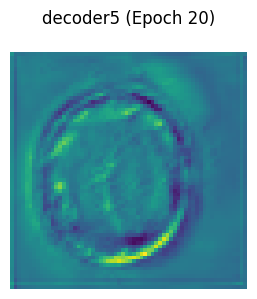

Epoch 20: Loss = 102.3430, Val Dice = 0.7832, Val mIoU = 0.6439, Val Accuracy = 0.9515, Val Sensitivity = 0.8137, Val Specificity = 0.9683


Epoch 21/100: 100%|██████████| 125/125 [01:45<00:00,  1.18it/s]


[Epoch 21] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


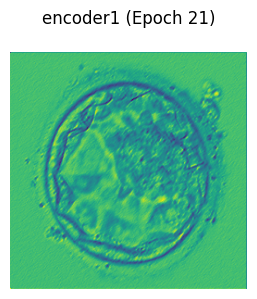

encoder2: torch.Size([3, 16, 128, 128])


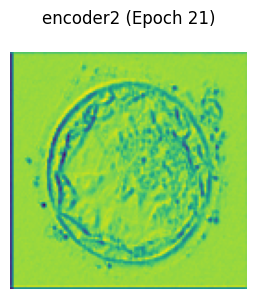

encoder3: torch.Size([3, 24, 64, 64])


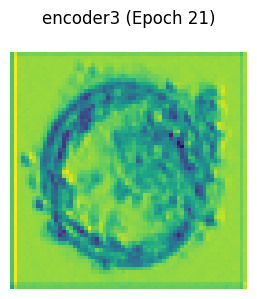

encoder4: torch.Size([3, 32, 32, 32])


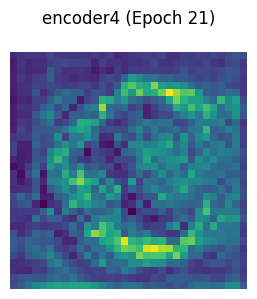

encoder5: torch.Size([3, 48, 16, 16])


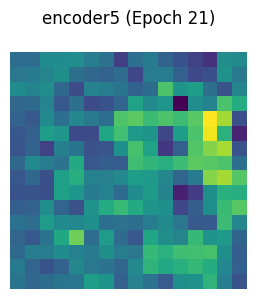

encoder6: torch.Size([3, 64, 8, 8])


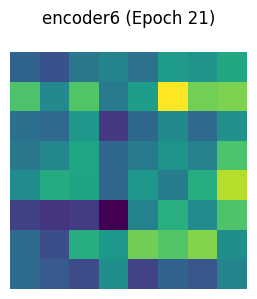

decoder1: torch.Size([3, 48, 8, 8])


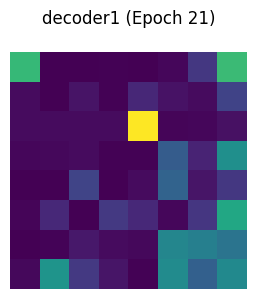

decoder2: torch.Size([3, 32, 8, 8])


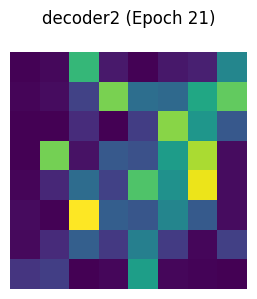

decoder3: torch.Size([3, 24, 16, 16])


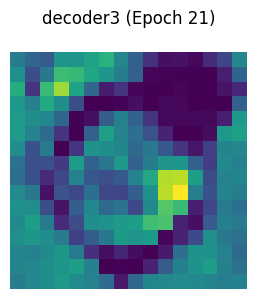

decoder4: torch.Size([3, 16, 32, 32])


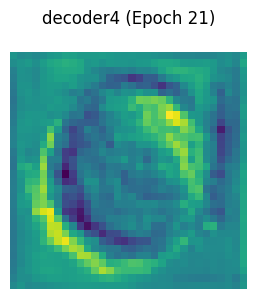

decoder5: torch.Size([3, 8, 64, 64])


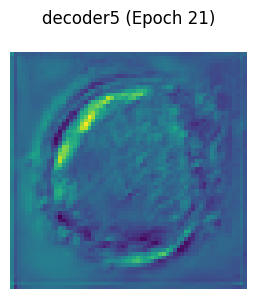

Epoch 21: Loss = 102.1032, Val Dice = 0.7792, Val mIoU = 0.6384, Val Accuracy = 0.9526, Val Sensitivity = 0.7777, Val Specificity = 0.9739


Epoch 22/100: 100%|██████████| 125/125 [01:46<00:00,  1.17it/s]


[Epoch 22] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


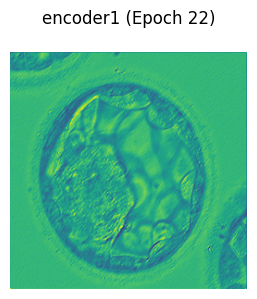

encoder2: torch.Size([3, 16, 128, 128])


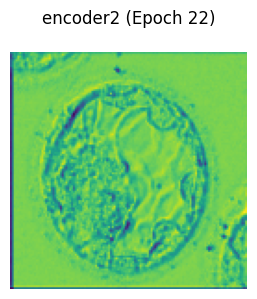

encoder3: torch.Size([3, 24, 64, 64])


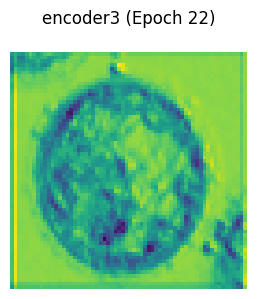

encoder4: torch.Size([3, 32, 32, 32])


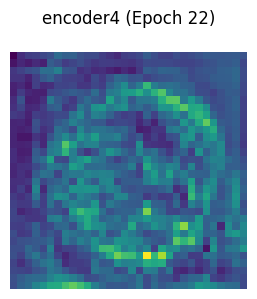

encoder5: torch.Size([3, 48, 16, 16])


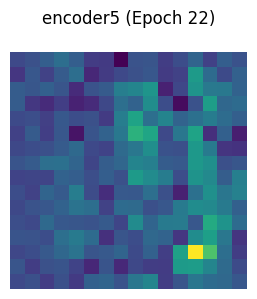

encoder6: torch.Size([3, 64, 8, 8])


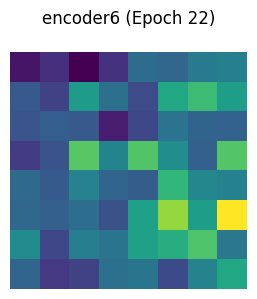

decoder1: torch.Size([3, 48, 8, 8])


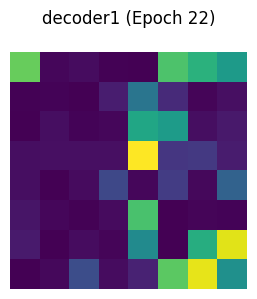

decoder2: torch.Size([3, 32, 8, 8])


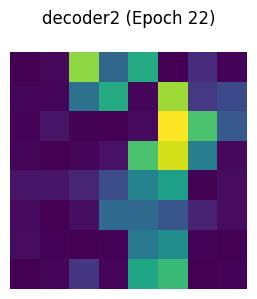

decoder3: torch.Size([3, 24, 16, 16])


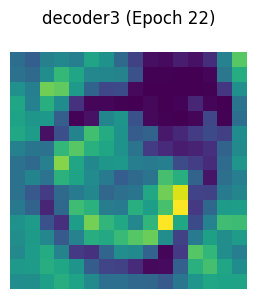

decoder4: torch.Size([3, 16, 32, 32])


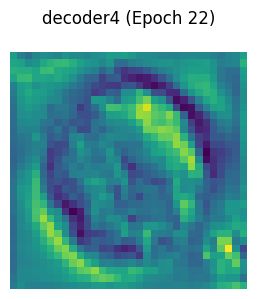

decoder5: torch.Size([3, 8, 64, 64])


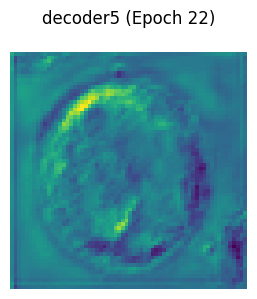

Epoch 22: Loss = 101.4155, Val Dice = 0.7770, Val mIoU = 0.6356, Val Accuracy = 0.9500, Val Sensitivity = 0.8093, Val Specificity = 0.9673


Epoch 23/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 23] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


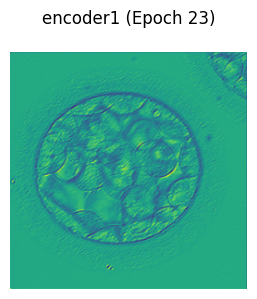

encoder2: torch.Size([3, 16, 128, 128])


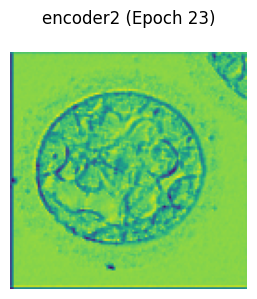

encoder3: torch.Size([3, 24, 64, 64])


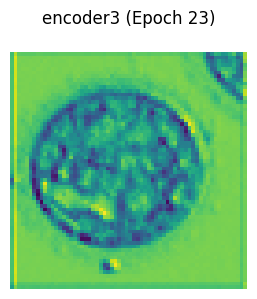

encoder4: torch.Size([3, 32, 32, 32])


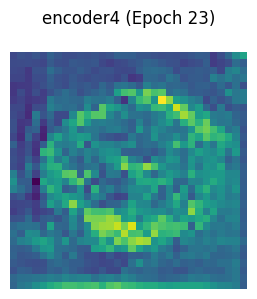

encoder5: torch.Size([3, 48, 16, 16])


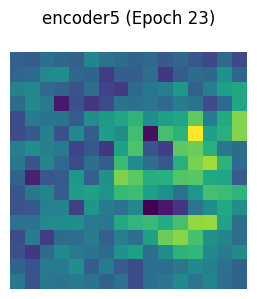

encoder6: torch.Size([3, 64, 8, 8])


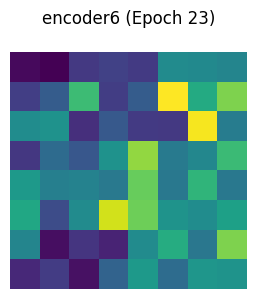

decoder1: torch.Size([3, 48, 8, 8])


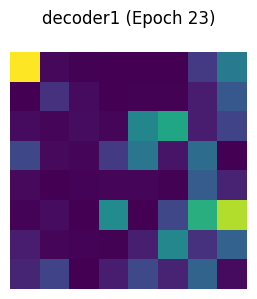

decoder2: torch.Size([3, 32, 8, 8])


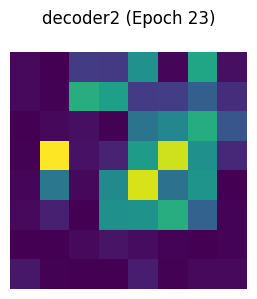

decoder3: torch.Size([3, 24, 16, 16])


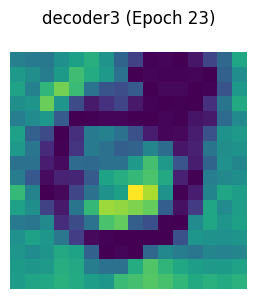

decoder4: torch.Size([3, 16, 32, 32])


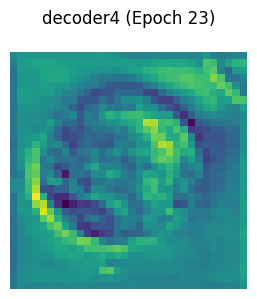

decoder5: torch.Size([3, 8, 64, 64])


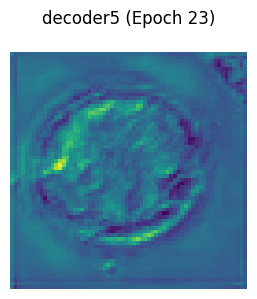

Epoch 23: Loss = 100.6462, Val Dice = 0.7835, Val mIoU = 0.6444, Val Accuracy = 0.9526, Val Sensitivity = 0.7932, Val Specificity = 0.9720


Epoch 24/100: 100%|██████████| 125/125 [01:45<00:00,  1.18it/s]


[Epoch 24] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


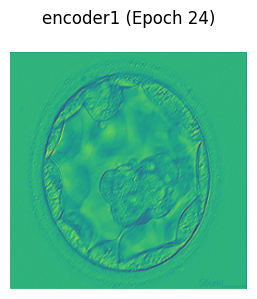

encoder2: torch.Size([3, 16, 128, 128])


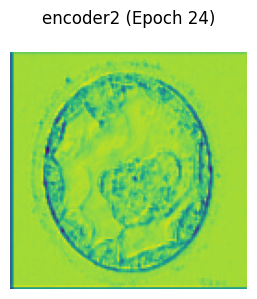

encoder3: torch.Size([3, 24, 64, 64])


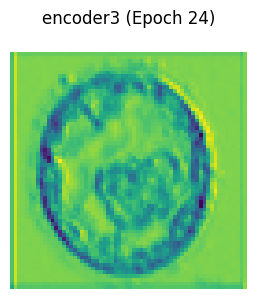

encoder4: torch.Size([3, 32, 32, 32])


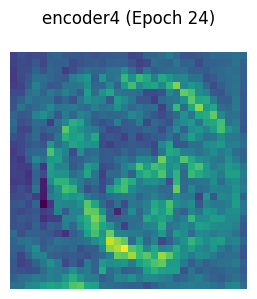

encoder5: torch.Size([3, 48, 16, 16])


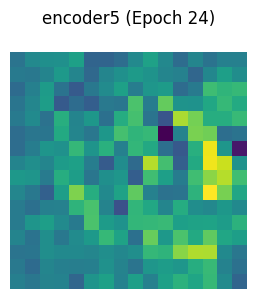

encoder6: torch.Size([3, 64, 8, 8])


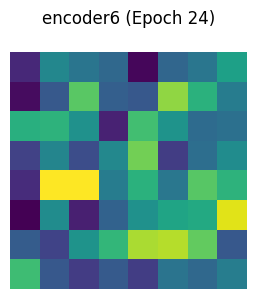

decoder1: torch.Size([3, 48, 8, 8])


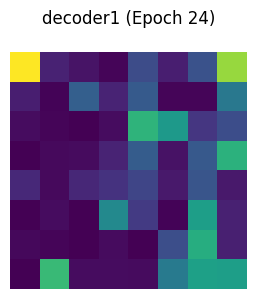

decoder2: torch.Size([3, 32, 8, 8])


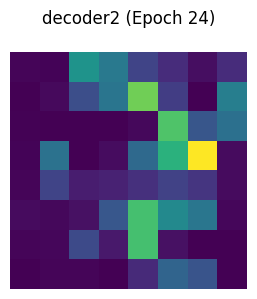

decoder3: torch.Size([3, 24, 16, 16])


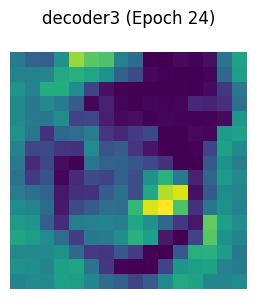

decoder4: torch.Size([3, 16, 32, 32])


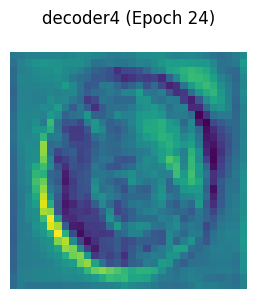

decoder5: torch.Size([3, 8, 64, 64])


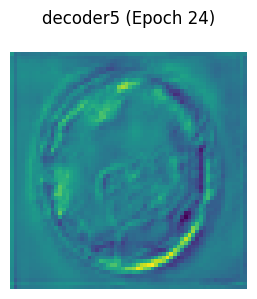

Epoch 24: Loss = 100.3019, Val Dice = 0.7756, Val mIoU = 0.6339, Val Accuracy = 0.9512, Val Sensitivity = 0.7789, Val Specificity = 0.9723


Epoch 25/100: 100%|██████████| 125/125 [01:46<00:00,  1.18it/s]


[Epoch 25] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


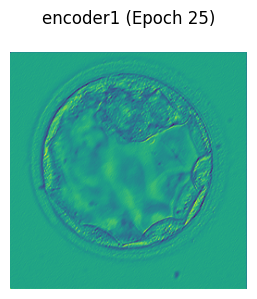

encoder2: torch.Size([3, 16, 128, 128])


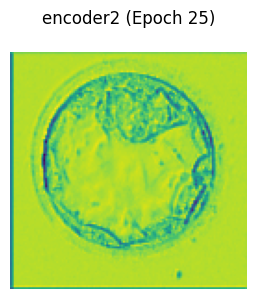

encoder3: torch.Size([3, 24, 64, 64])


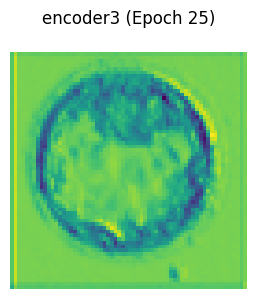

encoder4: torch.Size([3, 32, 32, 32])


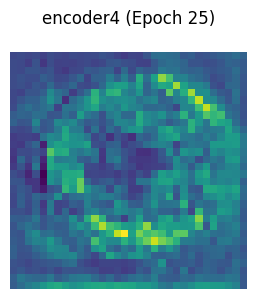

encoder5: torch.Size([3, 48, 16, 16])


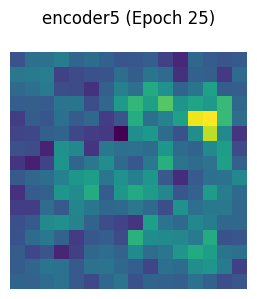

encoder6: torch.Size([3, 64, 8, 8])


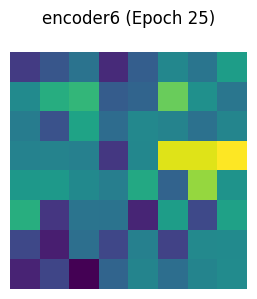

decoder1: torch.Size([3, 48, 8, 8])


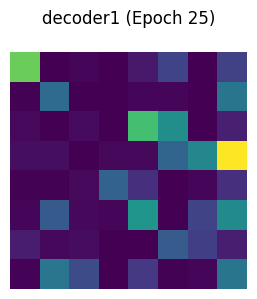

decoder2: torch.Size([3, 32, 8, 8])


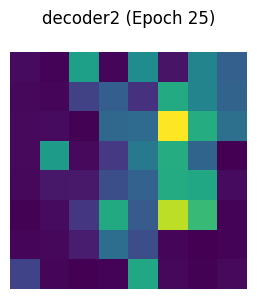

decoder3: torch.Size([3, 24, 16, 16])


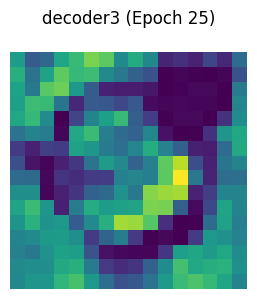

decoder4: torch.Size([3, 16, 32, 32])


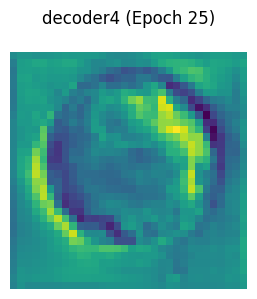

decoder5: torch.Size([3, 8, 64, 64])


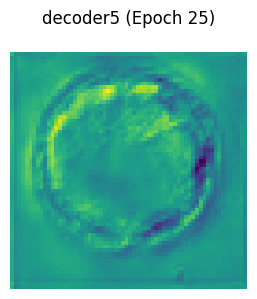

Epoch 25: Loss = 99.7150, Val Dice = 0.7844, Val mIoU = 0.6457, Val Accuracy = 0.9536, Val Sensitivity = 0.7818, Val Specificity = 0.9747


Epoch 26/100: 100%|██████████| 125/125 [01:47<00:00,  1.17it/s]


[Epoch 26] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


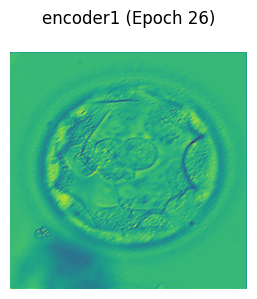

encoder2: torch.Size([3, 16, 128, 128])


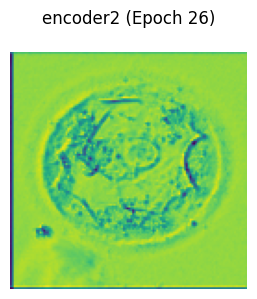

encoder3: torch.Size([3, 24, 64, 64])


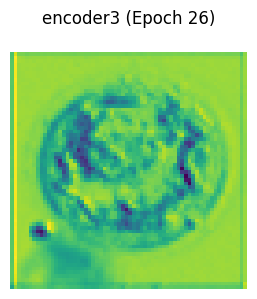

encoder4: torch.Size([3, 32, 32, 32])


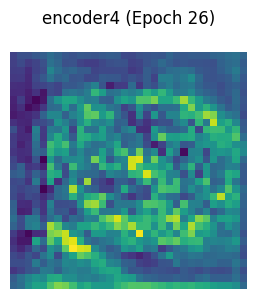

encoder5: torch.Size([3, 48, 16, 16])


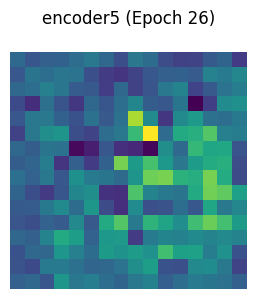

encoder6: torch.Size([3, 64, 8, 8])


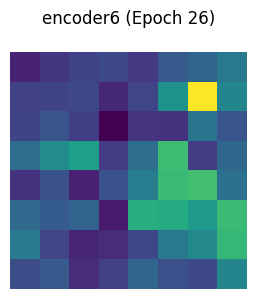

decoder1: torch.Size([3, 48, 8, 8])


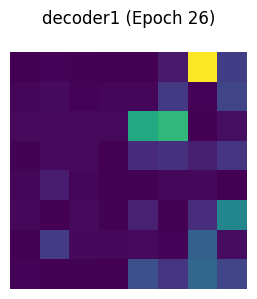

decoder2: torch.Size([3, 32, 8, 8])


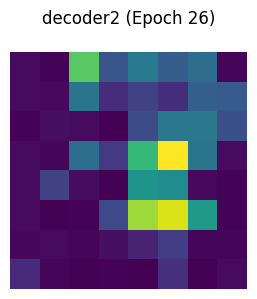

decoder3: torch.Size([3, 24, 16, 16])


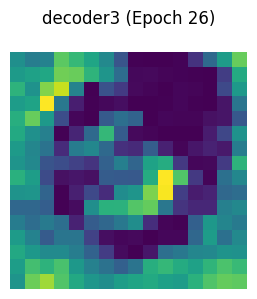

decoder4: torch.Size([3, 16, 32, 32])


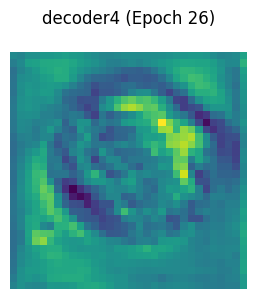

decoder5: torch.Size([3, 8, 64, 64])


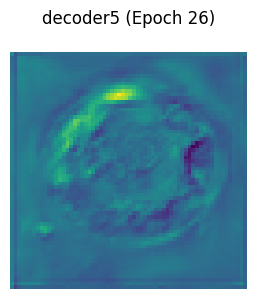

Epoch 26: Loss = 99.1416, Val Dice = 0.7832, Val mIoU = 0.6441, Val Accuracy = 0.9535, Val Sensitivity = 0.7770, Val Specificity = 0.9748


Epoch 27/100: 100%|██████████| 125/125 [01:47<00:00,  1.16it/s]


[Epoch 27] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


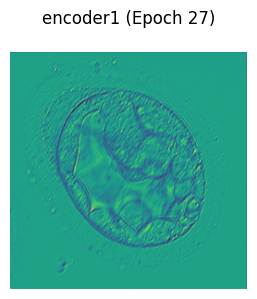

encoder2: torch.Size([3, 16, 128, 128])


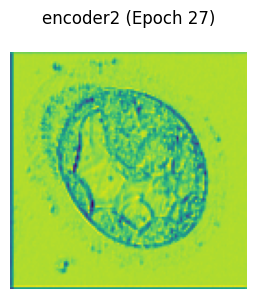

encoder3: torch.Size([3, 24, 64, 64])


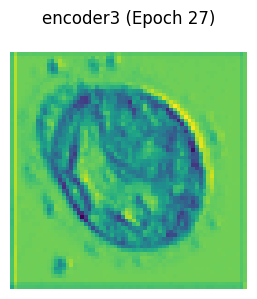

encoder4: torch.Size([3, 32, 32, 32])


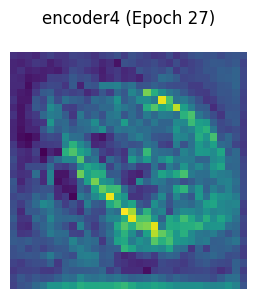

encoder5: torch.Size([3, 48, 16, 16])


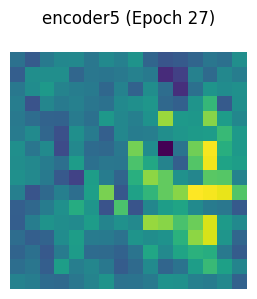

encoder6: torch.Size([3, 64, 8, 8])


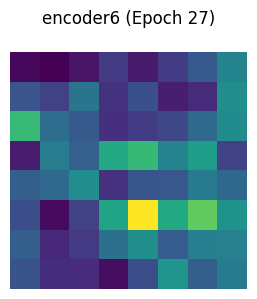

decoder1: torch.Size([3, 48, 8, 8])


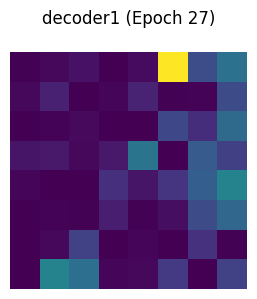

decoder2: torch.Size([3, 32, 8, 8])


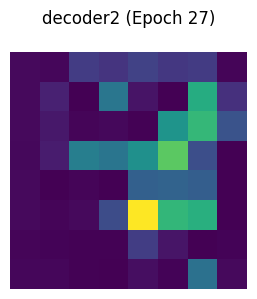

decoder3: torch.Size([3, 24, 16, 16])


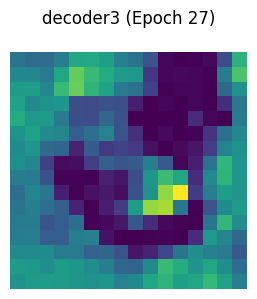

decoder4: torch.Size([3, 16, 32, 32])


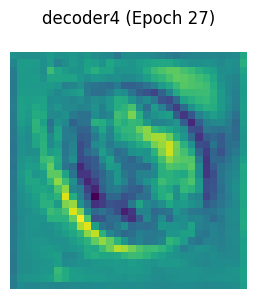

decoder5: torch.Size([3, 8, 64, 64])


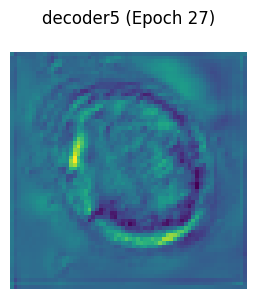

Epoch 27: Loss = 98.6076, Val Dice = 0.7732, Val mIoU = 0.6306, Val Accuracy = 0.9511, Val Sensitivity = 0.7714, Val Specificity = 0.9731


Epoch 28/100: 100%|██████████| 125/125 [01:48<00:00,  1.15it/s]


[Epoch 28] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


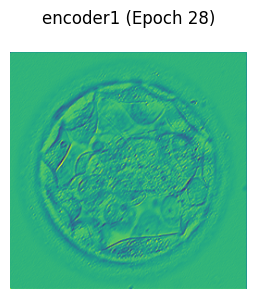

encoder2: torch.Size([3, 16, 128, 128])


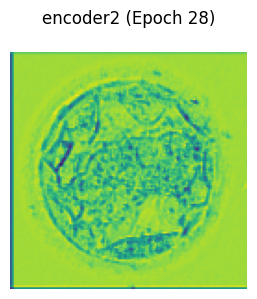

encoder3: torch.Size([3, 24, 64, 64])


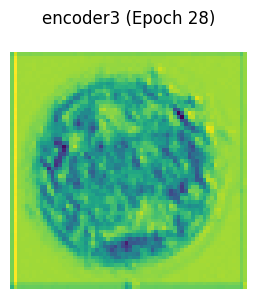

encoder4: torch.Size([3, 32, 32, 32])


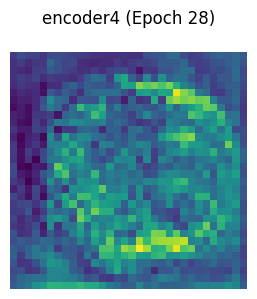

encoder5: torch.Size([3, 48, 16, 16])


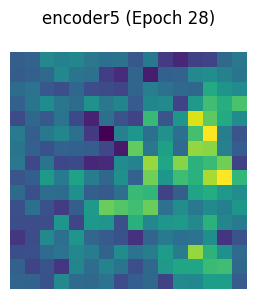

encoder6: torch.Size([3, 64, 8, 8])


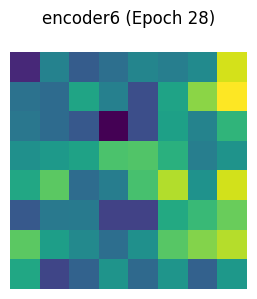

decoder1: torch.Size([3, 48, 8, 8])


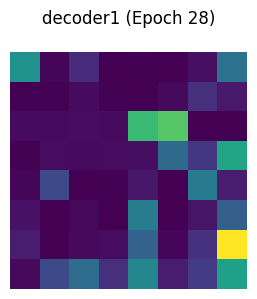

decoder2: torch.Size([3, 32, 8, 8])


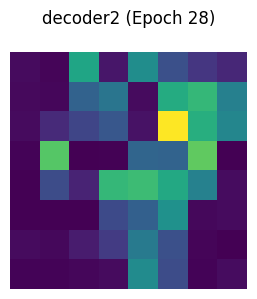

decoder3: torch.Size([3, 24, 16, 16])


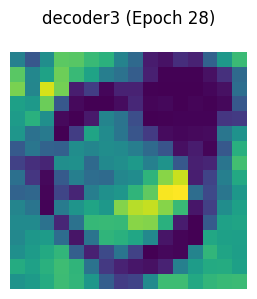

decoder4: torch.Size([3, 16, 32, 32])


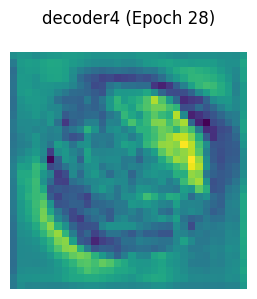

decoder5: torch.Size([3, 8, 64, 64])


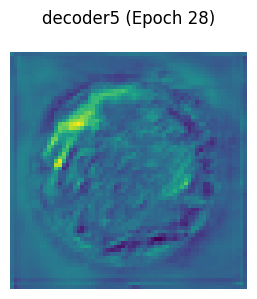

Epoch 28: Loss = 98.1956, Val Dice = 0.7738, Val mIoU = 0.6314, Val Accuracy = 0.9518, Val Sensitivity = 0.7619, Val Specificity = 0.9749


Epoch 29/100: 100%|██████████| 125/125 [01:48<00:00,  1.15it/s]


[Epoch 29] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


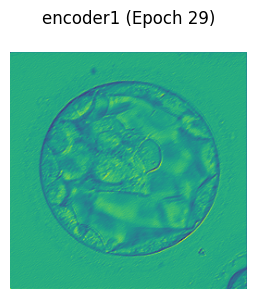

encoder2: torch.Size([3, 16, 128, 128])


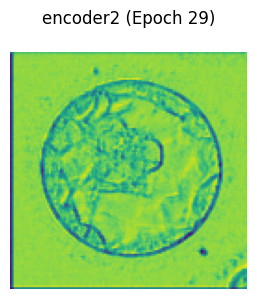

encoder3: torch.Size([3, 24, 64, 64])


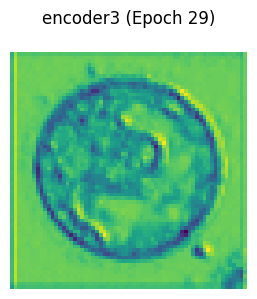

encoder4: torch.Size([3, 32, 32, 32])


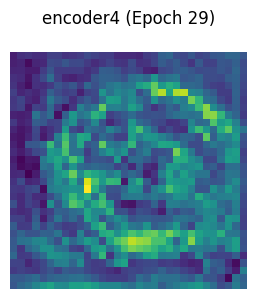

encoder5: torch.Size([3, 48, 16, 16])


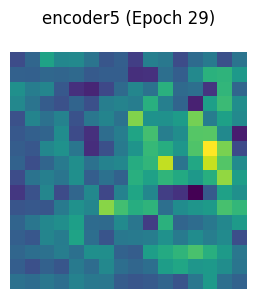

encoder6: torch.Size([3, 64, 8, 8])


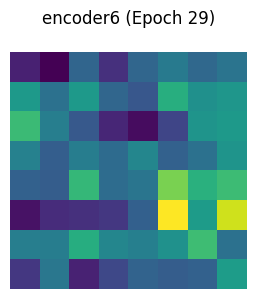

decoder1: torch.Size([3, 48, 8, 8])


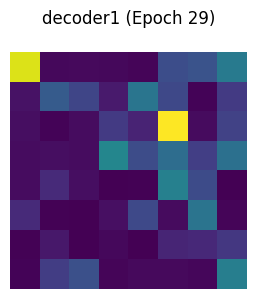

decoder2: torch.Size([3, 32, 8, 8])


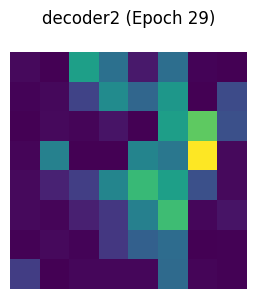

decoder3: torch.Size([3, 24, 16, 16])


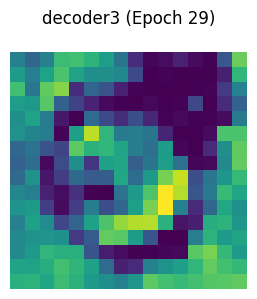

decoder4: torch.Size([3, 16, 32, 32])


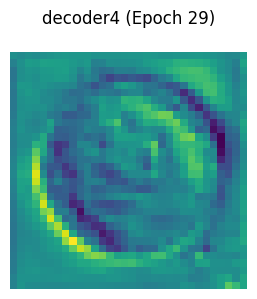

decoder5: torch.Size([3, 8, 64, 64])


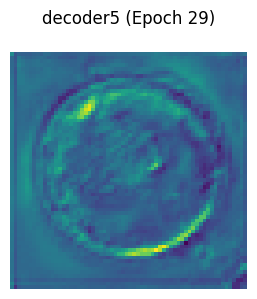

Epoch 29: Loss = 97.8546, Val Dice = 0.7725, Val mIoU = 0.6298, Val Accuracy = 0.9520, Val Sensitivity = 0.7553, Val Specificity = 0.9758


Epoch 30/100: 100%|██████████| 125/125 [01:49<00:00,  1.14it/s]


[Epoch 30] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


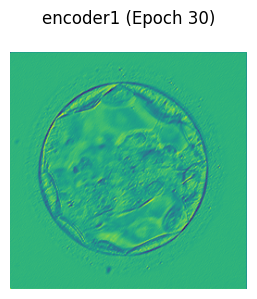

encoder2: torch.Size([3, 16, 128, 128])


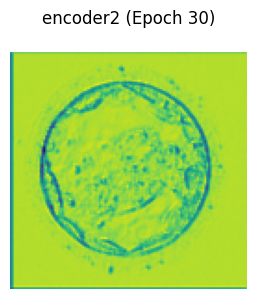

encoder3: torch.Size([3, 24, 64, 64])


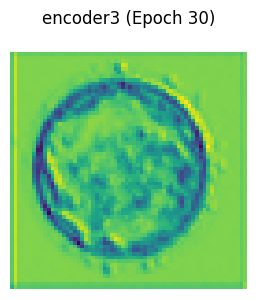

encoder4: torch.Size([3, 32, 32, 32])


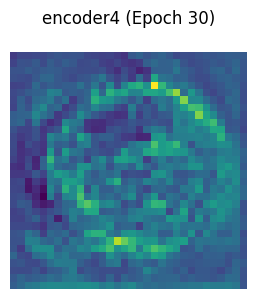

encoder5: torch.Size([3, 48, 16, 16])


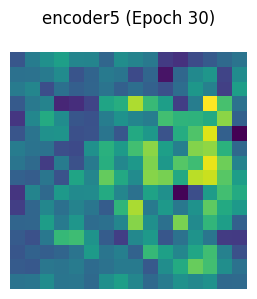

encoder6: torch.Size([3, 64, 8, 8])


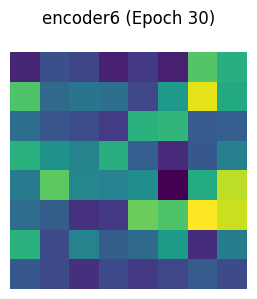

decoder1: torch.Size([3, 48, 8, 8])


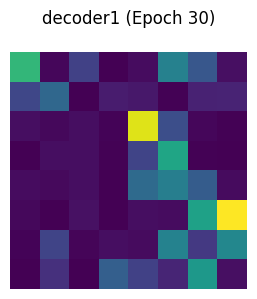

decoder2: torch.Size([3, 32, 8, 8])


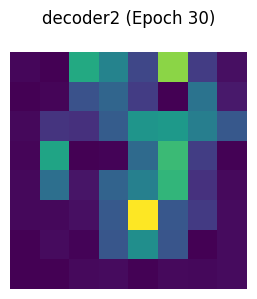

decoder3: torch.Size([3, 24, 16, 16])


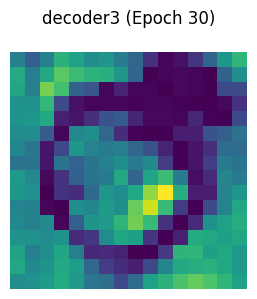

decoder4: torch.Size([3, 16, 32, 32])


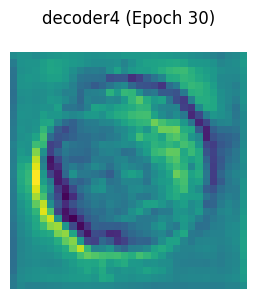

decoder5: torch.Size([3, 8, 64, 64])


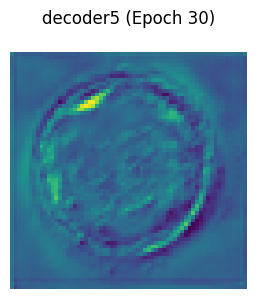

Epoch 30: Loss = 97.4096, Val Dice = 0.7779, Val mIoU = 0.6370, Val Accuracy = 0.9514, Val Sensitivity = 0.7880, Val Specificity = 0.9714


Epoch 31/100: 100%|██████████| 125/125 [01:49<00:00,  1.14it/s]


[Epoch 31] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


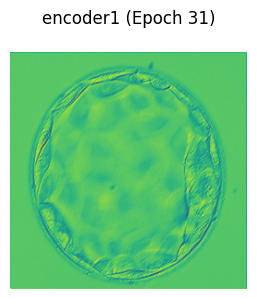

encoder2: torch.Size([3, 16, 128, 128])


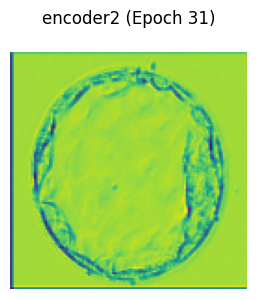

encoder3: torch.Size([3, 24, 64, 64])


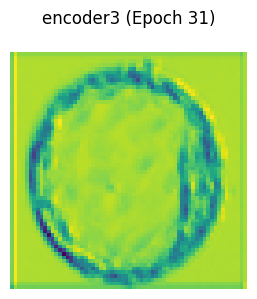

encoder4: torch.Size([3, 32, 32, 32])


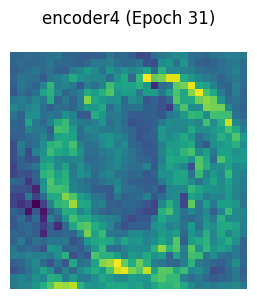

encoder5: torch.Size([3, 48, 16, 16])


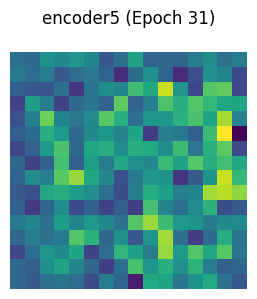

encoder6: torch.Size([3, 64, 8, 8])


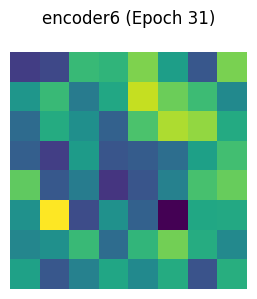

decoder1: torch.Size([3, 48, 8, 8])


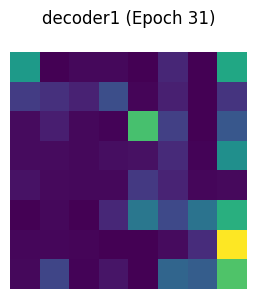

decoder2: torch.Size([3, 32, 8, 8])


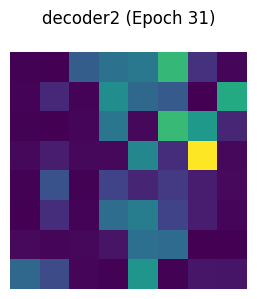

decoder3: torch.Size([3, 24, 16, 16])


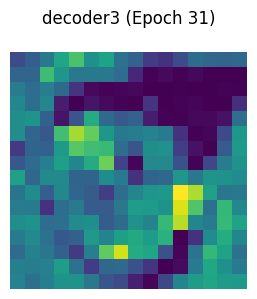

decoder4: torch.Size([3, 16, 32, 32])


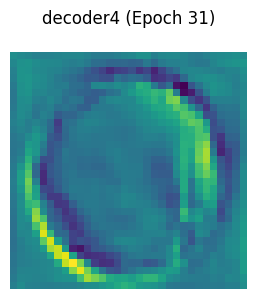

decoder5: torch.Size([3, 8, 64, 64])


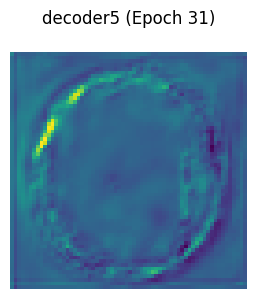

Epoch 31: Loss = 97.0578, Val Dice = 0.7762, Val mIoU = 0.6346, Val Accuracy = 0.9520, Val Sensitivity = 0.7698, Val Specificity = 0.9741


Epoch 32/100: 100%|██████████| 125/125 [01:52<00:00,  1.12it/s]


[Epoch 32] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


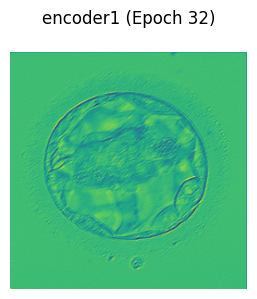

encoder2: torch.Size([3, 16, 128, 128])


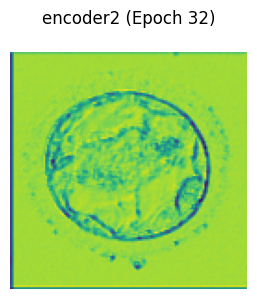

encoder3: torch.Size([3, 24, 64, 64])


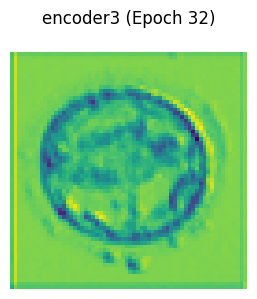

encoder4: torch.Size([3, 32, 32, 32])


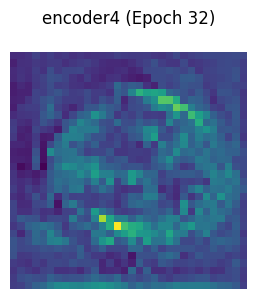

encoder5: torch.Size([3, 48, 16, 16])


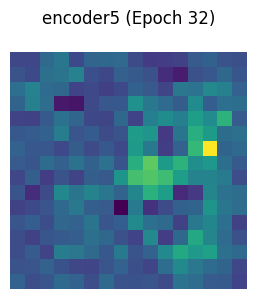

encoder6: torch.Size([3, 64, 8, 8])


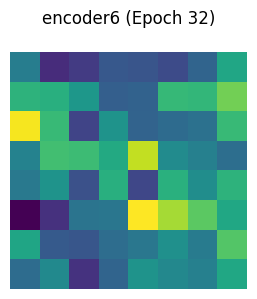

decoder1: torch.Size([3, 48, 8, 8])


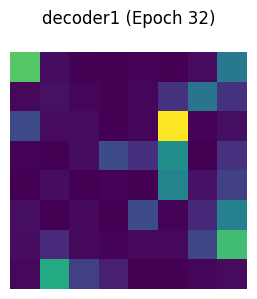

decoder2: torch.Size([3, 32, 8, 8])


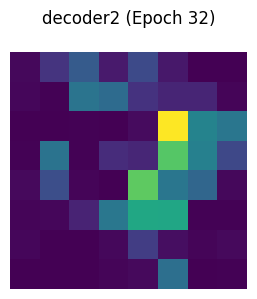

decoder3: torch.Size([3, 24, 16, 16])


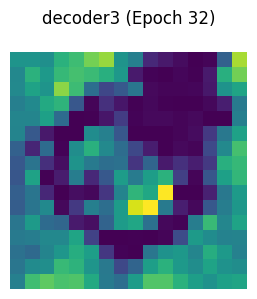

decoder4: torch.Size([3, 16, 32, 32])


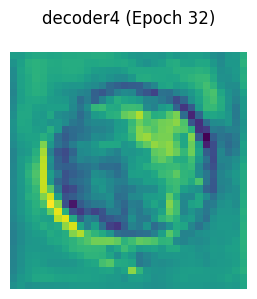

decoder5: torch.Size([3, 8, 64, 64])


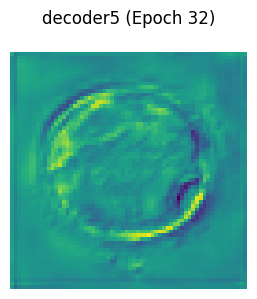

Epoch 32: Loss = 96.5629, Val Dice = 0.7707, Val mIoU = 0.6271, Val Accuracy = 0.9511, Val Sensitivity = 0.7611, Val Specificity = 0.9742


Epoch 33/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 33] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


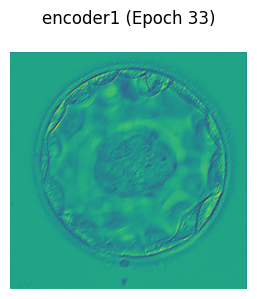

encoder2: torch.Size([3, 16, 128, 128])


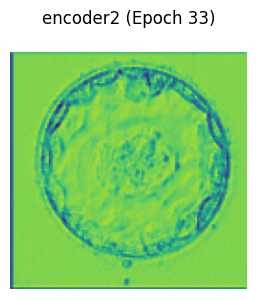

encoder3: torch.Size([3, 24, 64, 64])


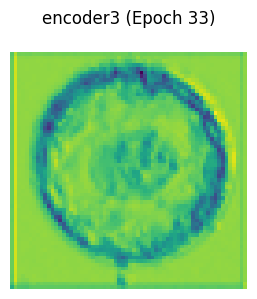

encoder4: torch.Size([3, 32, 32, 32])


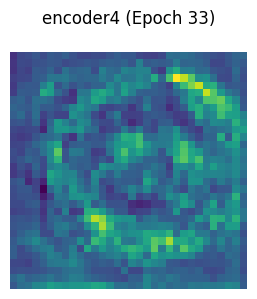

encoder5: torch.Size([3, 48, 16, 16])


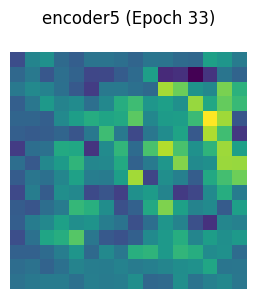

encoder6: torch.Size([3, 64, 8, 8])


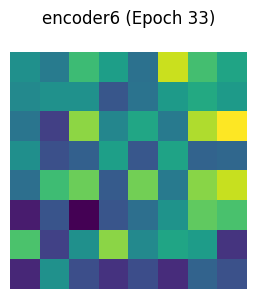

decoder1: torch.Size([3, 48, 8, 8])


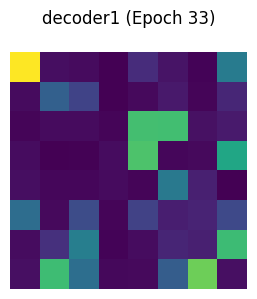

decoder2: torch.Size([3, 32, 8, 8])


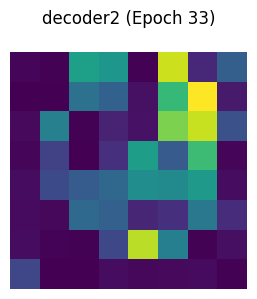

decoder3: torch.Size([3, 24, 16, 16])


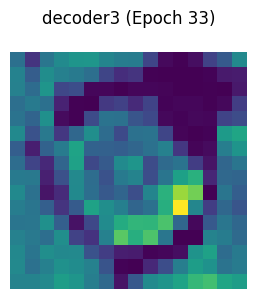

decoder4: torch.Size([3, 16, 32, 32])


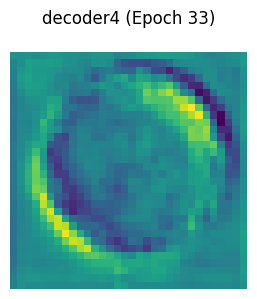

decoder5: torch.Size([3, 8, 64, 64])


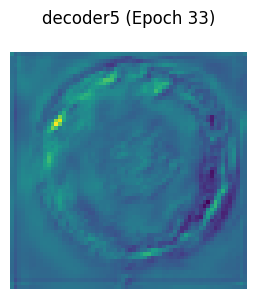

Epoch 33: Loss = 96.1486, Val Dice = 0.7681, Val mIoU = 0.6238, Val Accuracy = 0.9506, Val Sensitivity = 0.7584, Val Specificity = 0.9739


Epoch 34/100: 100%|██████████| 125/125 [01:52<00:00,  1.12it/s]


[Epoch 34] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


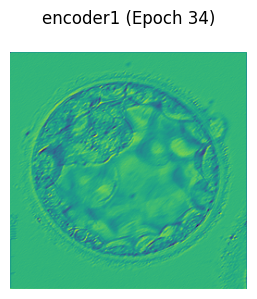

encoder2: torch.Size([3, 16, 128, 128])


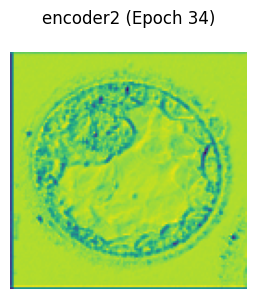

encoder3: torch.Size([3, 24, 64, 64])


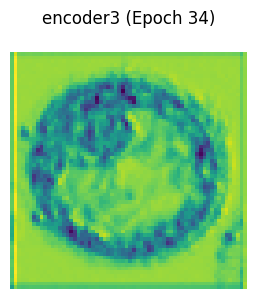

encoder4: torch.Size([3, 32, 32, 32])


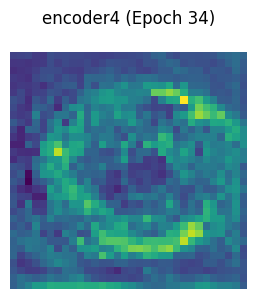

encoder5: torch.Size([3, 48, 16, 16])


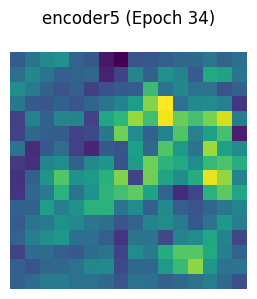

encoder6: torch.Size([3, 64, 8, 8])


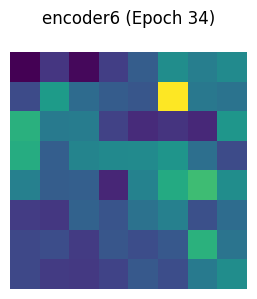

decoder1: torch.Size([3, 48, 8, 8])


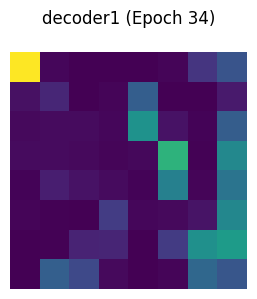

decoder2: torch.Size([3, 32, 8, 8])


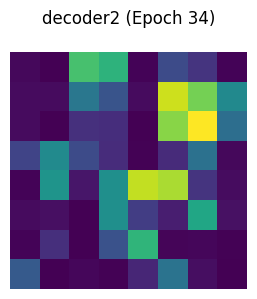

decoder3: torch.Size([3, 24, 16, 16])


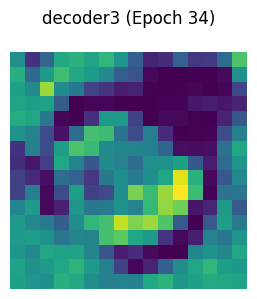

decoder4: torch.Size([3, 16, 32, 32])


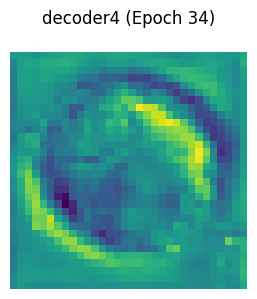

decoder5: torch.Size([3, 8, 64, 64])


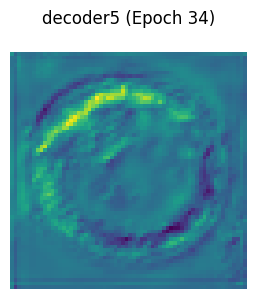

Epoch 34: Loss = 95.8116, Val Dice = 0.7801, Val mIoU = 0.6398, Val Accuracy = 0.9519, Val Sensitivity = 0.7891, Val Specificity = 0.9717


Epoch 35/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 35] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


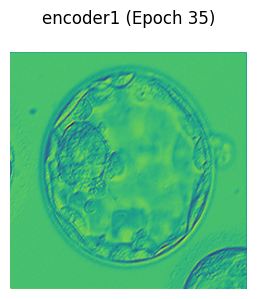

encoder2: torch.Size([3, 16, 128, 128])


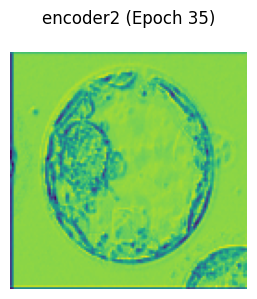

encoder3: torch.Size([3, 24, 64, 64])


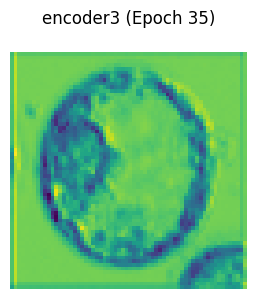

encoder4: torch.Size([3, 32, 32, 32])


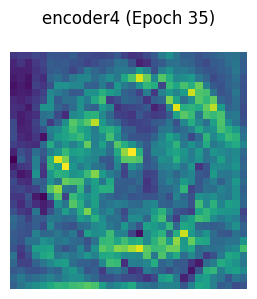

encoder5: torch.Size([3, 48, 16, 16])


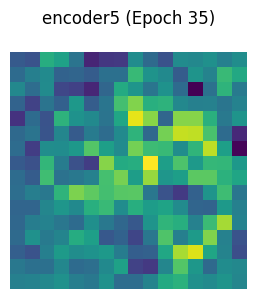

encoder6: torch.Size([3, 64, 8, 8])


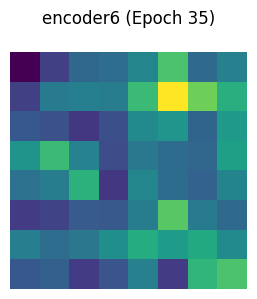

decoder1: torch.Size([3, 48, 8, 8])


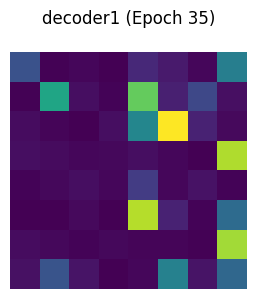

decoder2: torch.Size([3, 32, 8, 8])


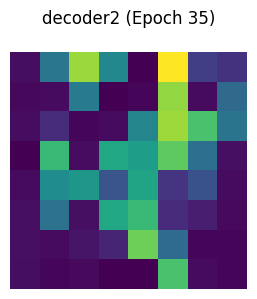

decoder3: torch.Size([3, 24, 16, 16])


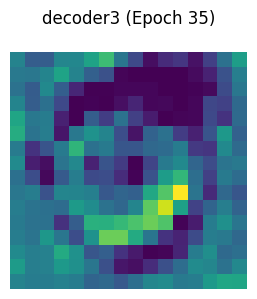

decoder4: torch.Size([3, 16, 32, 32])


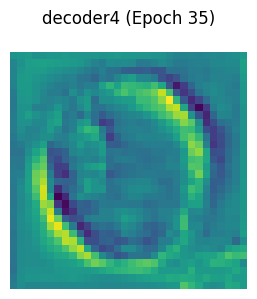

decoder5: torch.Size([3, 8, 64, 64])


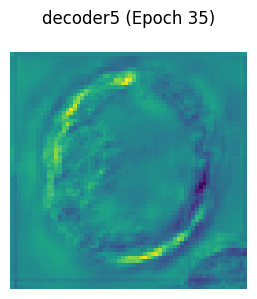

Epoch 35: Loss = 95.5550, Val Dice = 0.7719, Val mIoU = 0.6289, Val Accuracy = 0.9511, Val Sensitivity = 0.7660, Val Specificity = 0.9736


Epoch 36/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 36] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


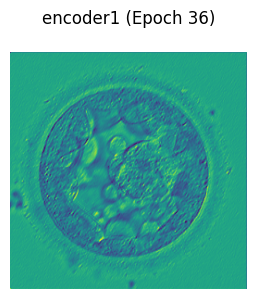

encoder2: torch.Size([3, 16, 128, 128])


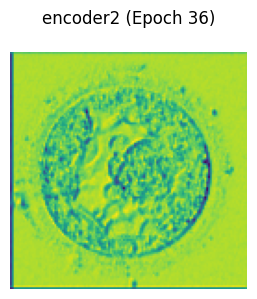

encoder3: torch.Size([3, 24, 64, 64])


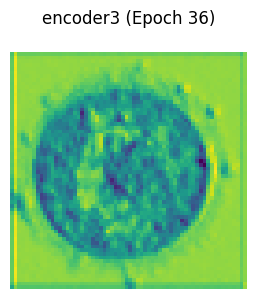

encoder4: torch.Size([3, 32, 32, 32])


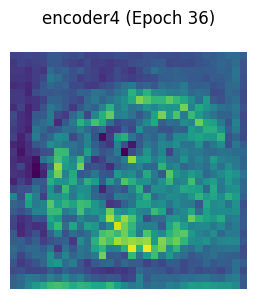

encoder5: torch.Size([3, 48, 16, 16])


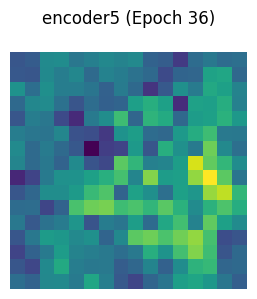

encoder6: torch.Size([3, 64, 8, 8])


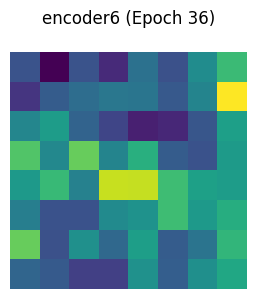

decoder1: torch.Size([3, 48, 8, 8])


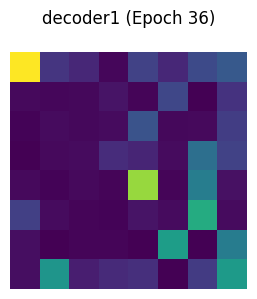

decoder2: torch.Size([3, 32, 8, 8])


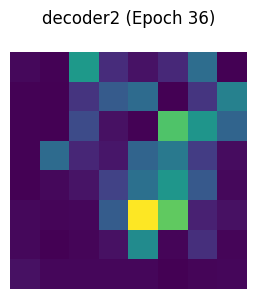

decoder3: torch.Size([3, 24, 16, 16])


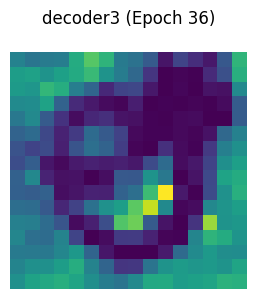

decoder4: torch.Size([3, 16, 32, 32])


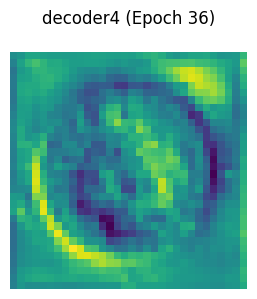

decoder5: torch.Size([3, 8, 64, 64])


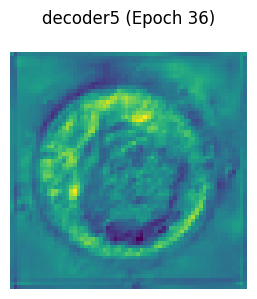

Epoch 36: Loss = 95.2208, Val Dice = 0.7722, Val mIoU = 0.6294, Val Accuracy = 0.9513, Val Sensitivity = 0.7643, Val Specificity = 0.9741


Epoch 37/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 37] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


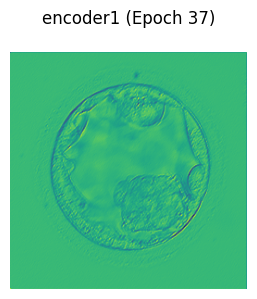

encoder2: torch.Size([3, 16, 128, 128])


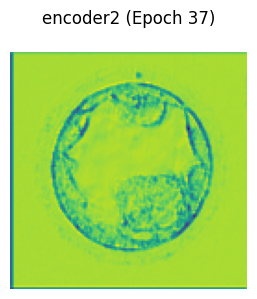

encoder3: torch.Size([3, 24, 64, 64])


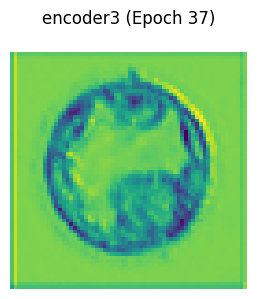

encoder4: torch.Size([3, 32, 32, 32])


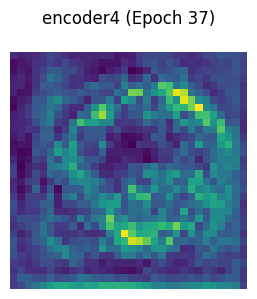

encoder5: torch.Size([3, 48, 16, 16])


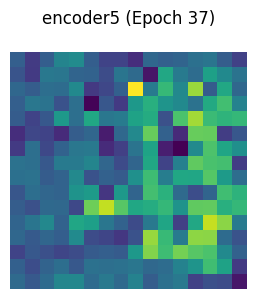

encoder6: torch.Size([3, 64, 8, 8])


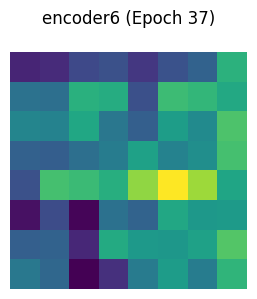

decoder1: torch.Size([3, 48, 8, 8])


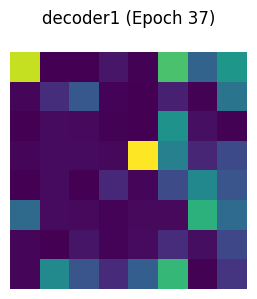

decoder2: torch.Size([3, 32, 8, 8])


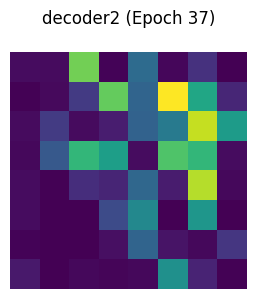

decoder3: torch.Size([3, 24, 16, 16])


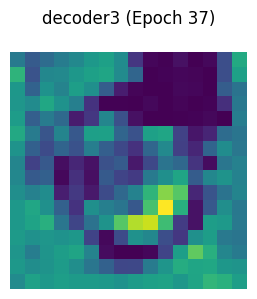

decoder4: torch.Size([3, 16, 32, 32])


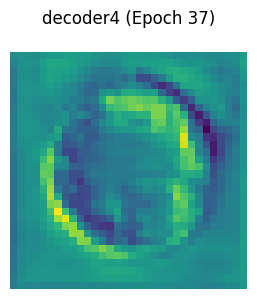

decoder5: torch.Size([3, 8, 64, 64])


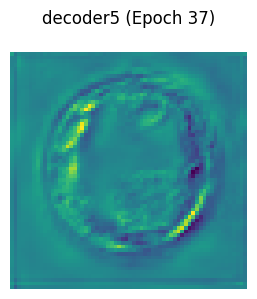

Epoch 37: Loss = 94.9688, Val Dice = 0.7728, Val mIoU = 0.6302, Val Accuracy = 0.9511, Val Sensitivity = 0.7692, Val Specificity = 0.9732


Epoch 38/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 38] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


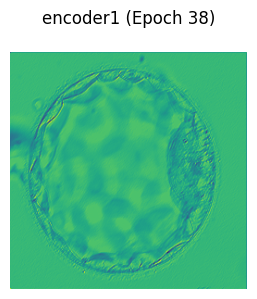

encoder2: torch.Size([3, 16, 128, 128])


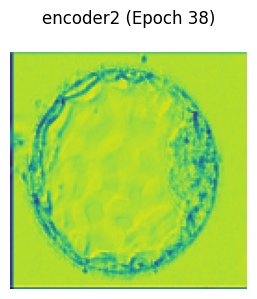

encoder3: torch.Size([3, 24, 64, 64])


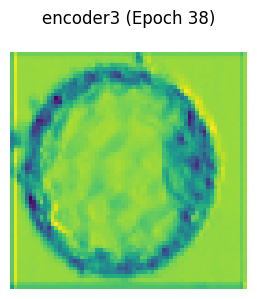

encoder4: torch.Size([3, 32, 32, 32])


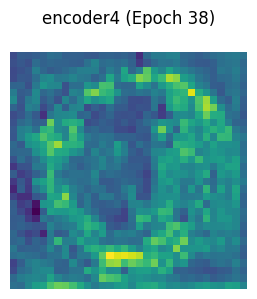

encoder5: torch.Size([3, 48, 16, 16])


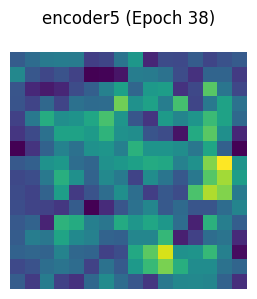

encoder6: torch.Size([3, 64, 8, 8])


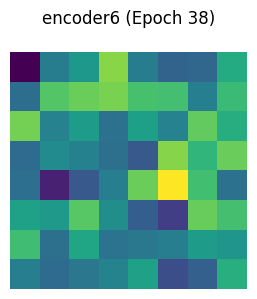

decoder1: torch.Size([3, 48, 8, 8])


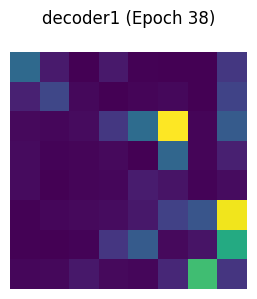

decoder2: torch.Size([3, 32, 8, 8])


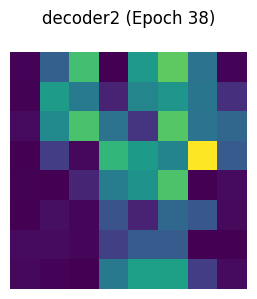

decoder3: torch.Size([3, 24, 16, 16])


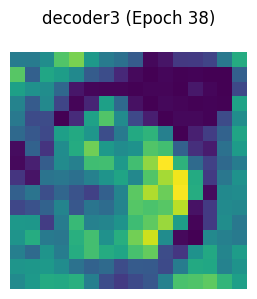

decoder4: torch.Size([3, 16, 32, 32])


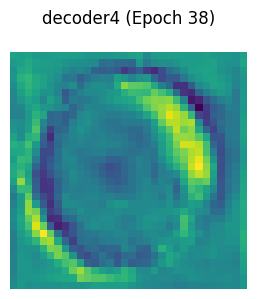

decoder5: torch.Size([3, 8, 64, 64])


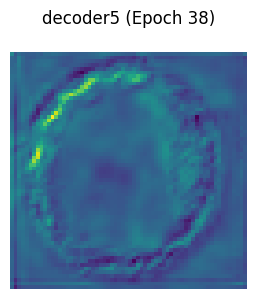

Epoch 38: Loss = 94.6971, Val Dice = 0.7722, Val mIoU = 0.6295, Val Accuracy = 0.9508, Val Sensitivity = 0.7712, Val Specificity = 0.9728


Epoch 39/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 39] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


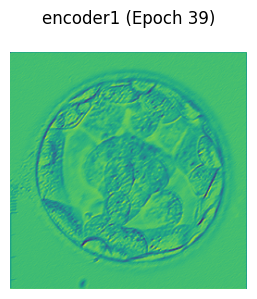

encoder2: torch.Size([3, 16, 128, 128])


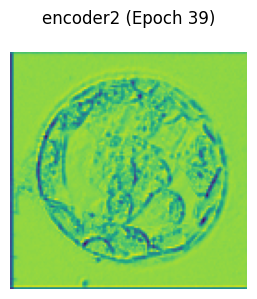

encoder3: torch.Size([3, 24, 64, 64])


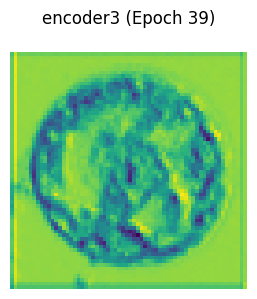

encoder4: torch.Size([3, 32, 32, 32])


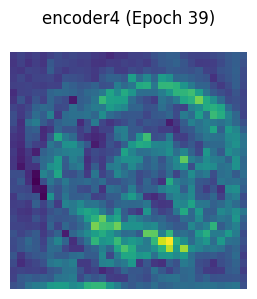

encoder5: torch.Size([3, 48, 16, 16])


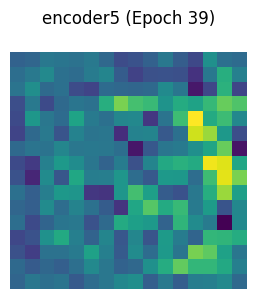

encoder6: torch.Size([3, 64, 8, 8])


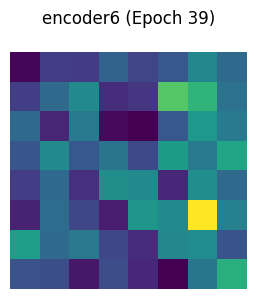

decoder1: torch.Size([3, 48, 8, 8])


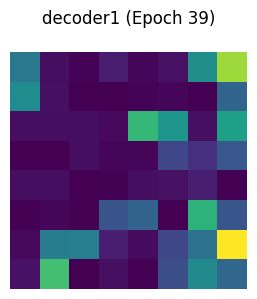

decoder2: torch.Size([3, 32, 8, 8])


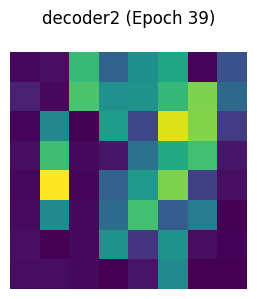

decoder3: torch.Size([3, 24, 16, 16])


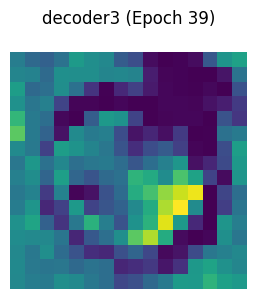

decoder4: torch.Size([3, 16, 32, 32])


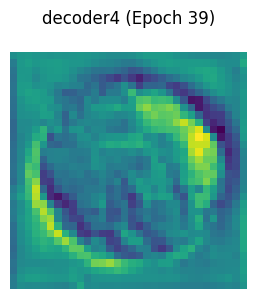

decoder5: torch.Size([3, 8, 64, 64])


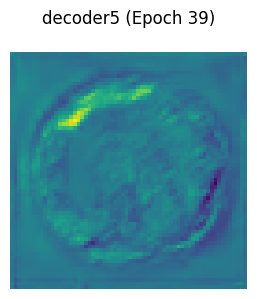

Epoch 39: Loss = 94.4155, Val Dice = 0.7705, Val mIoU = 0.6273, Val Accuracy = 0.9507, Val Sensitivity = 0.7665, Val Specificity = 0.9731


Epoch 40/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 40] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


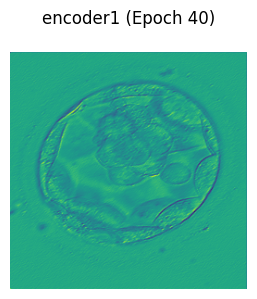

encoder2: torch.Size([3, 16, 128, 128])


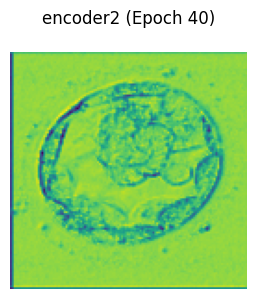

encoder3: torch.Size([3, 24, 64, 64])


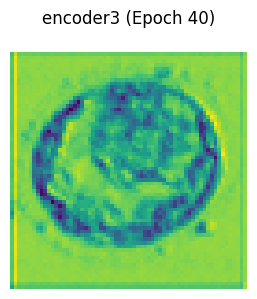

encoder4: torch.Size([3, 32, 32, 32])


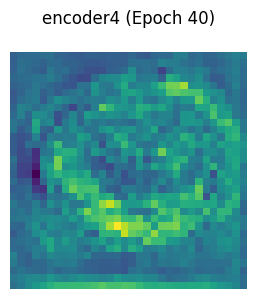

encoder5: torch.Size([3, 48, 16, 16])


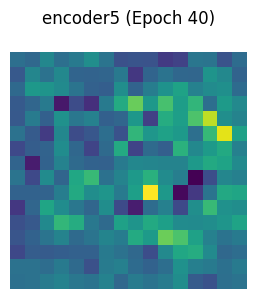

encoder6: torch.Size([3, 64, 8, 8])


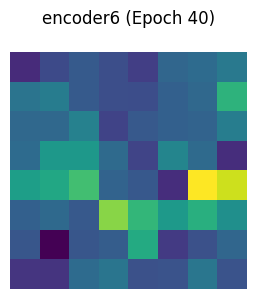

decoder1: torch.Size([3, 48, 8, 8])


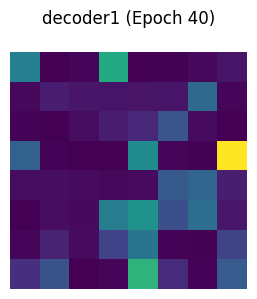

decoder2: torch.Size([3, 32, 8, 8])


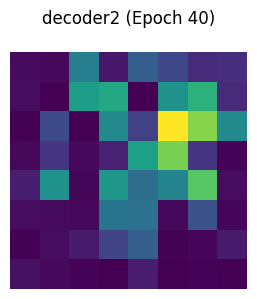

decoder3: torch.Size([3, 24, 16, 16])


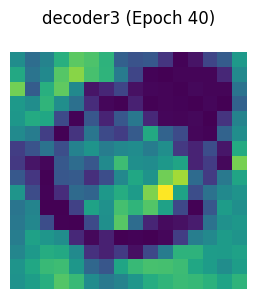

decoder4: torch.Size([3, 16, 32, 32])


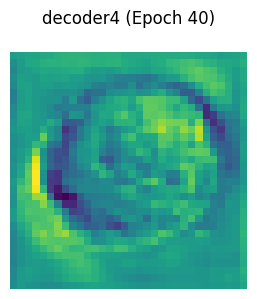

decoder5: torch.Size([3, 8, 64, 64])


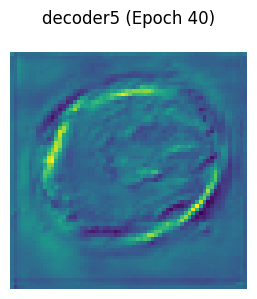

Epoch 40: Loss = 94.1618, Val Dice = 0.7739, Val mIoU = 0.6318, Val Accuracy = 0.9510, Val Sensitivity = 0.7751, Val Specificity = 0.9725


Epoch 41/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 41] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


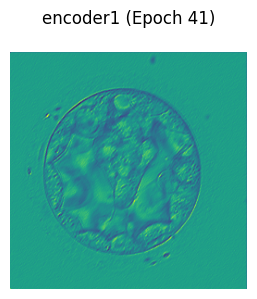

encoder2: torch.Size([3, 16, 128, 128])


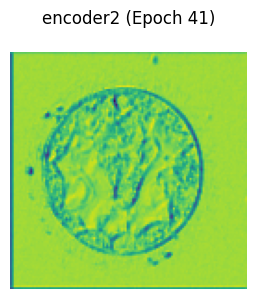

encoder3: torch.Size([3, 24, 64, 64])


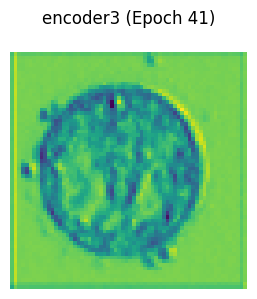

encoder4: torch.Size([3, 32, 32, 32])


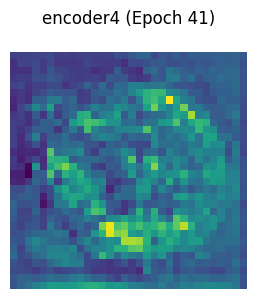

encoder5: torch.Size([3, 48, 16, 16])


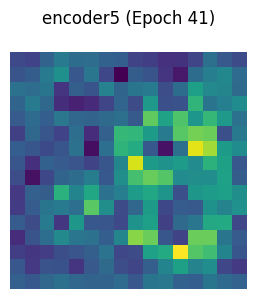

encoder6: torch.Size([3, 64, 8, 8])


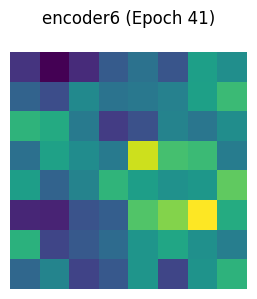

decoder1: torch.Size([3, 48, 8, 8])


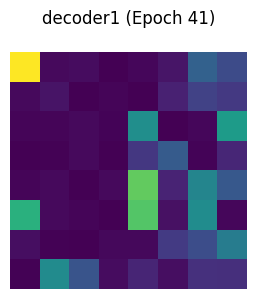

decoder2: torch.Size([3, 32, 8, 8])


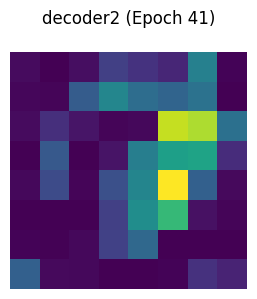

decoder3: torch.Size([3, 24, 16, 16])


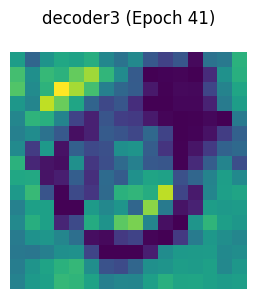

decoder4: torch.Size([3, 16, 32, 32])


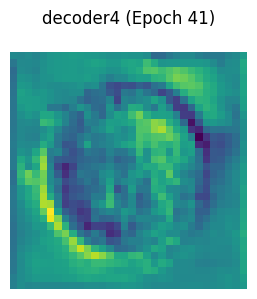

decoder5: torch.Size([3, 8, 64, 64])


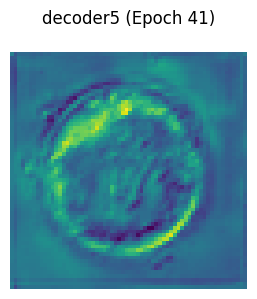

Epoch 41: Loss = 93.9794, Val Dice = 0.7712, Val mIoU = 0.6282, Val Accuracy = 0.9508, Val Sensitivity = 0.7671, Val Specificity = 0.9732


Epoch 42/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 42] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


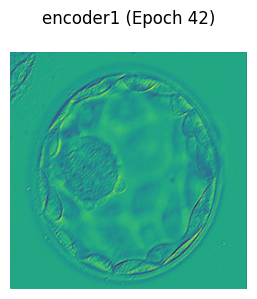

encoder2: torch.Size([3, 16, 128, 128])


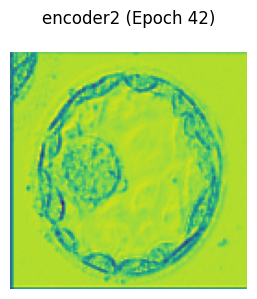

encoder3: torch.Size([3, 24, 64, 64])


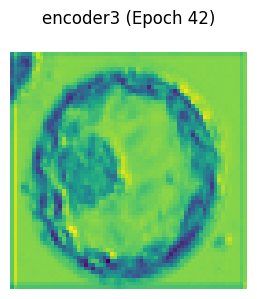

encoder4: torch.Size([3, 32, 32, 32])


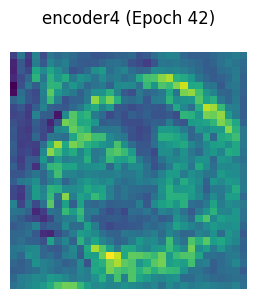

encoder5: torch.Size([3, 48, 16, 16])


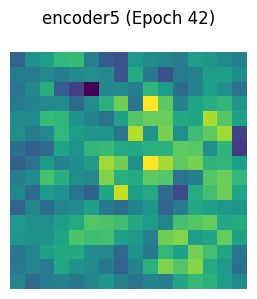

encoder6: torch.Size([3, 64, 8, 8])


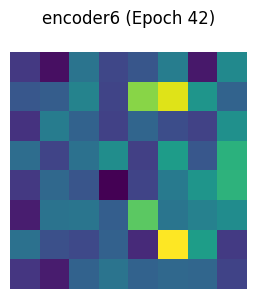

decoder1: torch.Size([3, 48, 8, 8])


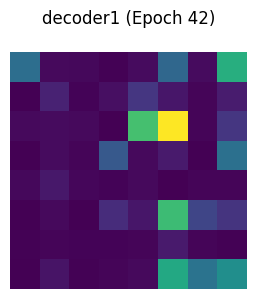

decoder2: torch.Size([3, 32, 8, 8])


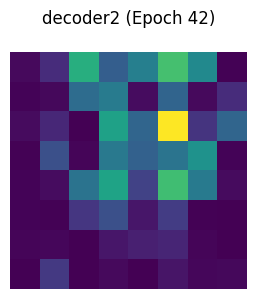

decoder3: torch.Size([3, 24, 16, 16])


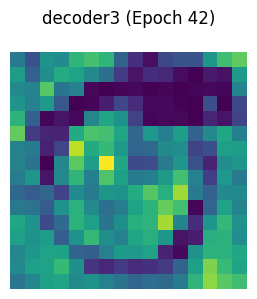

decoder4: torch.Size([3, 16, 32, 32])


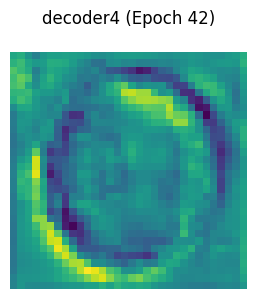

decoder5: torch.Size([3, 8, 64, 64])


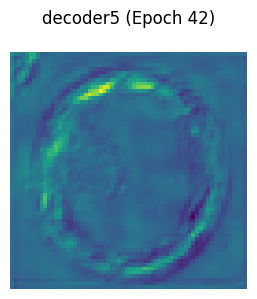

Epoch 42: Loss = 93.7952, Val Dice = 0.7705, Val mIoU = 0.6272, Val Accuracy = 0.9506, Val Sensitivity = 0.7685, Val Specificity = 0.9728


Epoch 43/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 43] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


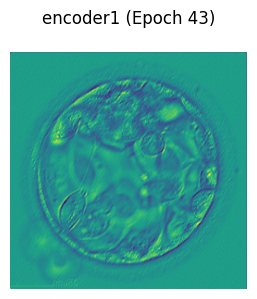

encoder2: torch.Size([3, 16, 128, 128])


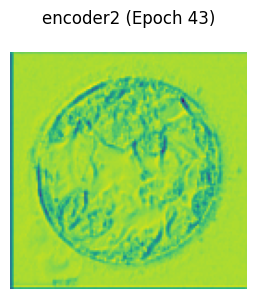

encoder3: torch.Size([3, 24, 64, 64])


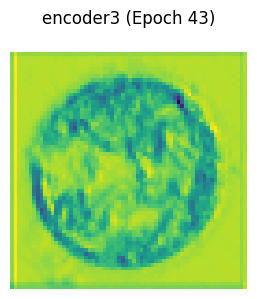

encoder4: torch.Size([3, 32, 32, 32])


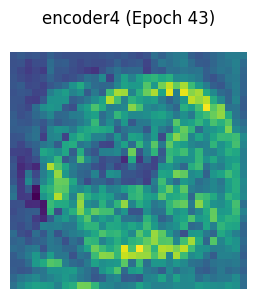

encoder5: torch.Size([3, 48, 16, 16])


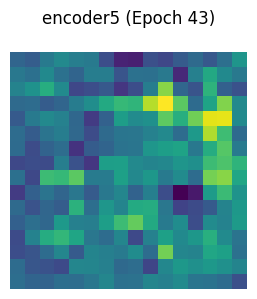

encoder6: torch.Size([3, 64, 8, 8])


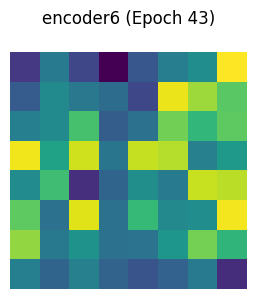

decoder1: torch.Size([3, 48, 8, 8])


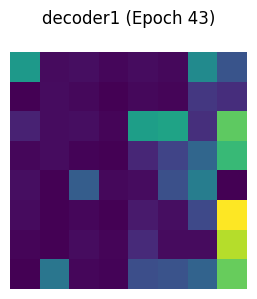

decoder2: torch.Size([3, 32, 8, 8])


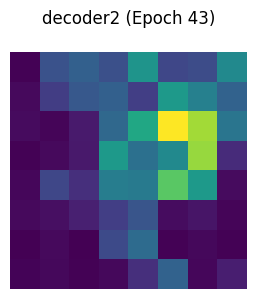

decoder3: torch.Size([3, 24, 16, 16])


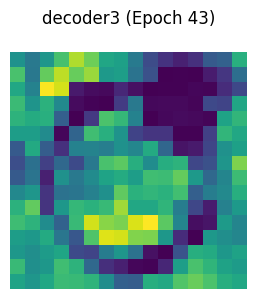

decoder4: torch.Size([3, 16, 32, 32])


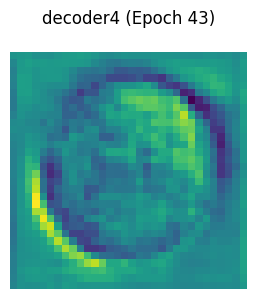

decoder5: torch.Size([3, 8, 64, 64])


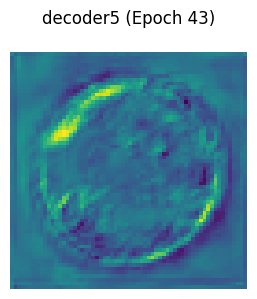

Epoch 43: Loss = 93.7160, Val Dice = 0.7696, Val mIoU = 0.6262, Val Accuracy = 0.9503, Val Sensitivity = 0.7692, Val Specificity = 0.9724


Epoch 44/100: 100%|██████████| 125/125 [01:55<00:00,  1.08it/s]


[Epoch 44] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


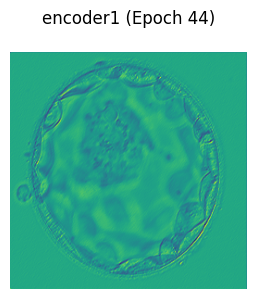

encoder2: torch.Size([3, 16, 128, 128])


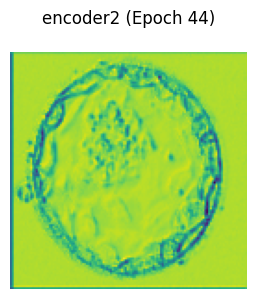

encoder3: torch.Size([3, 24, 64, 64])


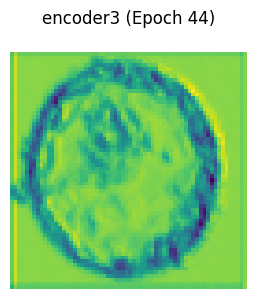

encoder4: torch.Size([3, 32, 32, 32])


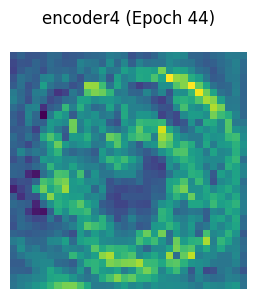

encoder5: torch.Size([3, 48, 16, 16])


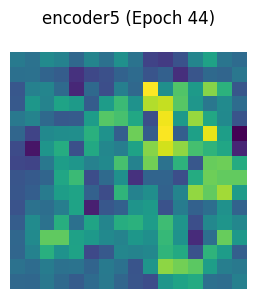

encoder6: torch.Size([3, 64, 8, 8])


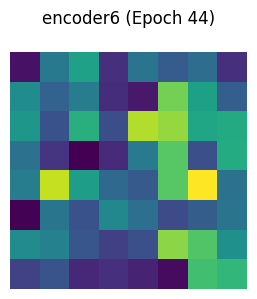

decoder1: torch.Size([3, 48, 8, 8])


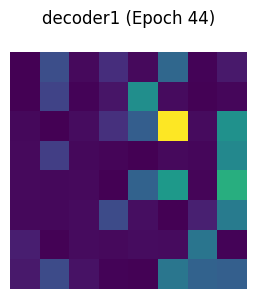

decoder2: torch.Size([3, 32, 8, 8])


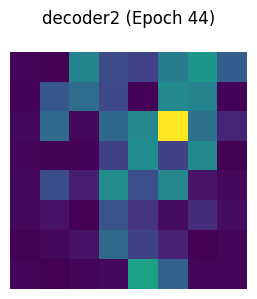

decoder3: torch.Size([3, 24, 16, 16])


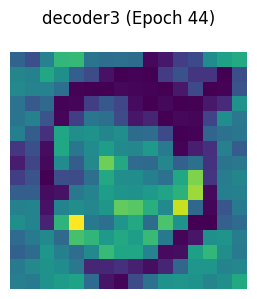

decoder4: torch.Size([3, 16, 32, 32])


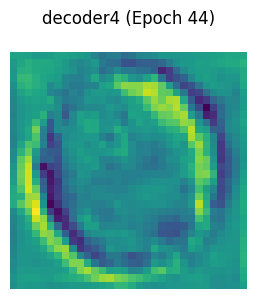

decoder5: torch.Size([3, 8, 64, 64])


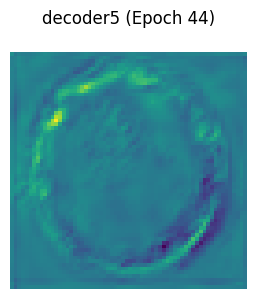

Epoch 44: Loss = 93.5722, Val Dice = 0.7695, Val mIoU = 0.6260, Val Accuracy = 0.9503, Val Sensitivity = 0.7676, Val Specificity = 0.9726


Epoch 45/100: 100%|██████████| 125/125 [01:57<00:00,  1.07it/s]


[Epoch 45] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


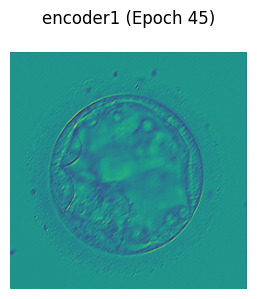

encoder2: torch.Size([3, 16, 128, 128])


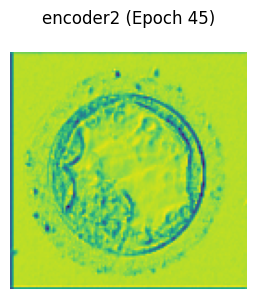

encoder3: torch.Size([3, 24, 64, 64])


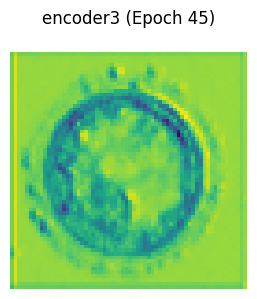

encoder4: torch.Size([3, 32, 32, 32])


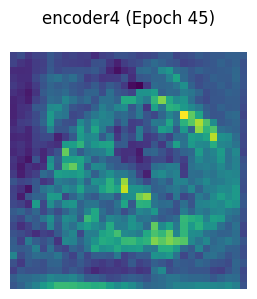

encoder5: torch.Size([3, 48, 16, 16])


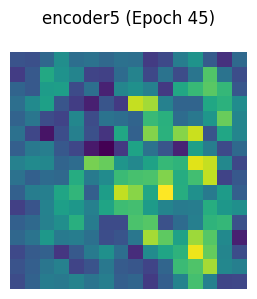

encoder6: torch.Size([3, 64, 8, 8])


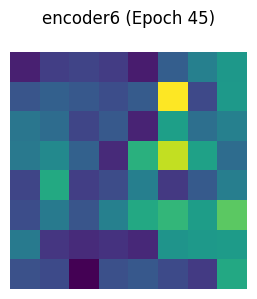

decoder1: torch.Size([3, 48, 8, 8])


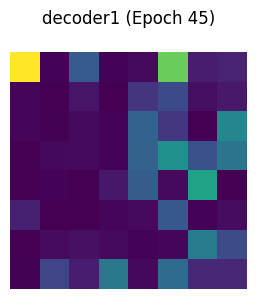

decoder2: torch.Size([3, 32, 8, 8])


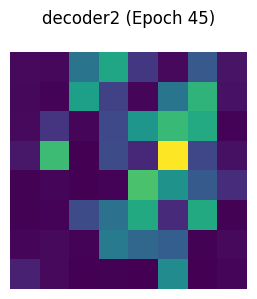

decoder3: torch.Size([3, 24, 16, 16])


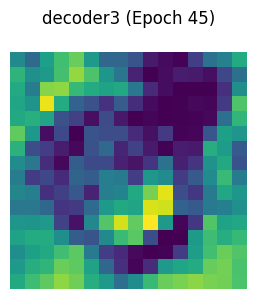

decoder4: torch.Size([3, 16, 32, 32])


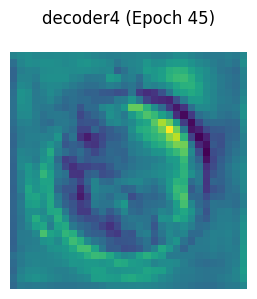

decoder5: torch.Size([3, 8, 64, 64])


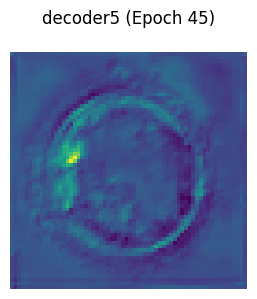

Epoch 45: Loss = 93.4782, Val Dice = 0.7679, Val mIoU = 0.6239, Val Accuracy = 0.9501, Val Sensitivity = 0.7639, Val Specificity = 0.9728


Epoch 46/100: 100%|██████████| 125/125 [01:56<00:00,  1.08it/s]


[Epoch 46] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


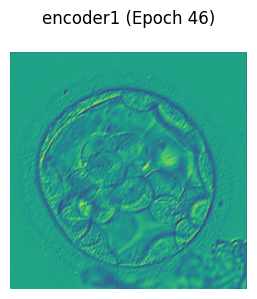

encoder2: torch.Size([3, 16, 128, 128])


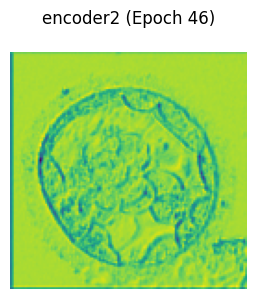

encoder3: torch.Size([3, 24, 64, 64])


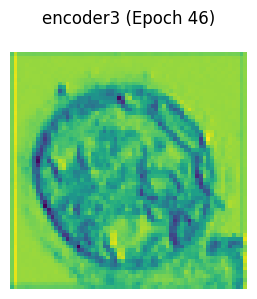

encoder4: torch.Size([3, 32, 32, 32])


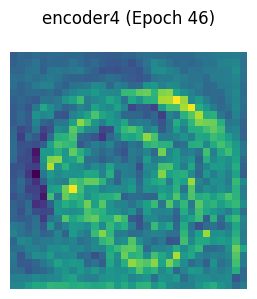

encoder5: torch.Size([3, 48, 16, 16])


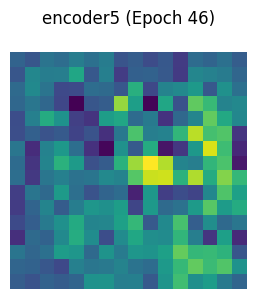

encoder6: torch.Size([3, 64, 8, 8])


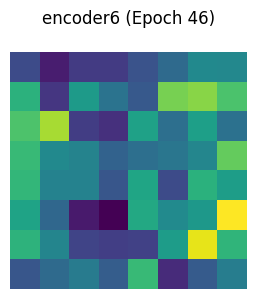

decoder1: torch.Size([3, 48, 8, 8])


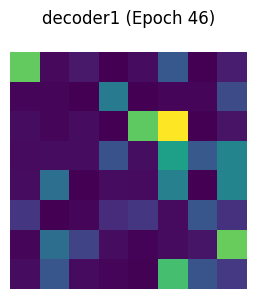

decoder2: torch.Size([3, 32, 8, 8])


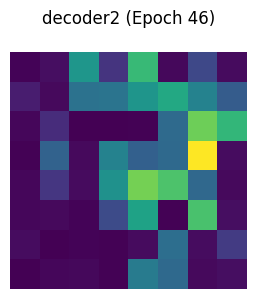

decoder3: torch.Size([3, 24, 16, 16])


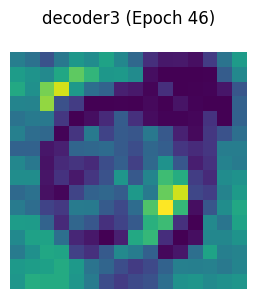

decoder4: torch.Size([3, 16, 32, 32])


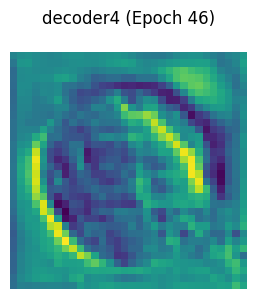

decoder5: torch.Size([3, 8, 64, 64])


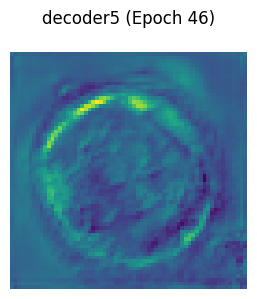

Epoch 46: Loss = 93.3976, Val Dice = 0.7693, Val mIoU = 0.6259, Val Accuracy = 0.9502, Val Sensitivity = 0.7682, Val Specificity = 0.9725


Epoch 47/100: 100%|██████████| 125/125 [01:56<00:00,  1.07it/s]


[Epoch 47] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


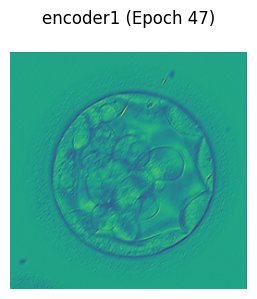

encoder2: torch.Size([3, 16, 128, 128])


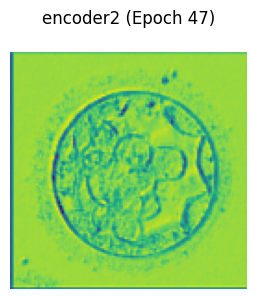

encoder3: torch.Size([3, 24, 64, 64])


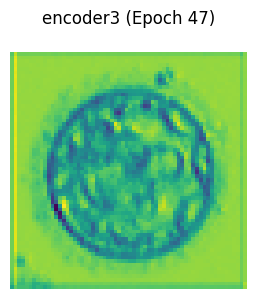

encoder4: torch.Size([3, 32, 32, 32])


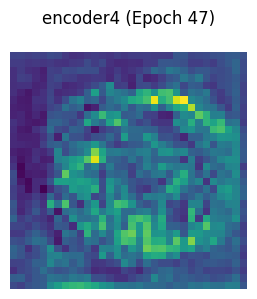

encoder5: torch.Size([3, 48, 16, 16])


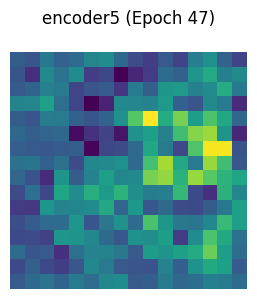

encoder6: torch.Size([3, 64, 8, 8])


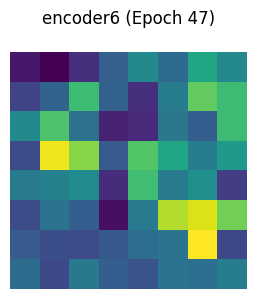

decoder1: torch.Size([3, 48, 8, 8])


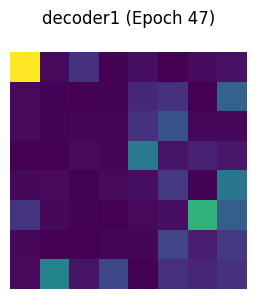

decoder2: torch.Size([3, 32, 8, 8])


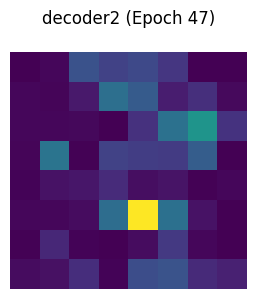

decoder3: torch.Size([3, 24, 16, 16])


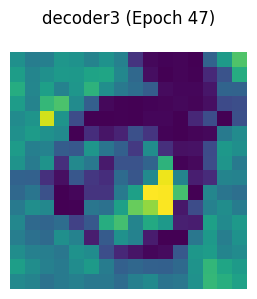

decoder4: torch.Size([3, 16, 32, 32])


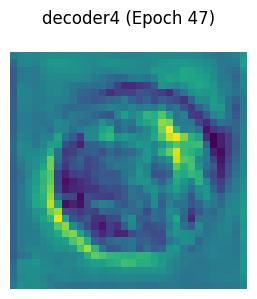

decoder5: torch.Size([3, 8, 64, 64])


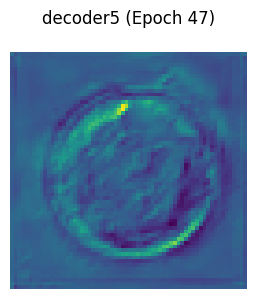

Epoch 47: Loss = 93.3150, Val Dice = 0.7662, Val mIoU = 0.6217, Val Accuracy = 0.9498, Val Sensitivity = 0.7611, Val Specificity = 0.9729


Epoch 48/100: 100%|██████████| 125/125 [01:57<00:00,  1.06it/s]


[Epoch 48] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


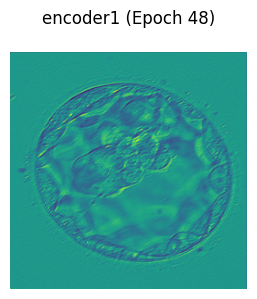

encoder2: torch.Size([3, 16, 128, 128])


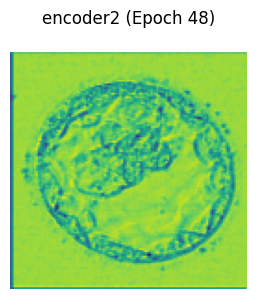

encoder3: torch.Size([3, 24, 64, 64])


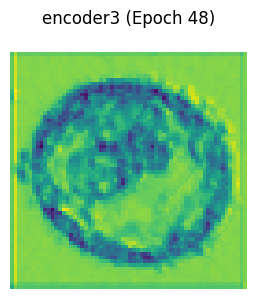

encoder4: torch.Size([3, 32, 32, 32])


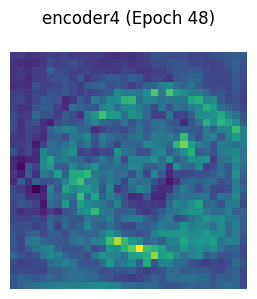

encoder5: torch.Size([3, 48, 16, 16])


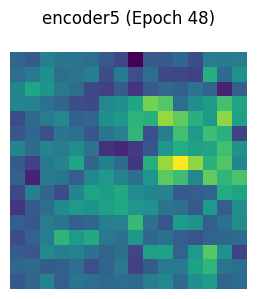

encoder6: torch.Size([3, 64, 8, 8])


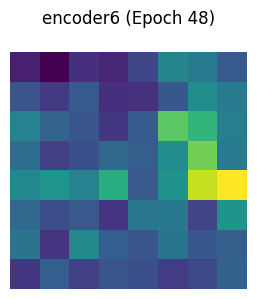

decoder1: torch.Size([3, 48, 8, 8])


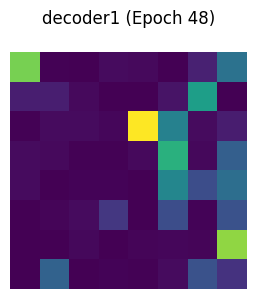

decoder2: torch.Size([3, 32, 8, 8])


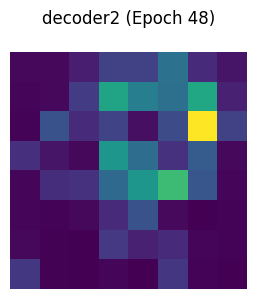

decoder3: torch.Size([3, 24, 16, 16])


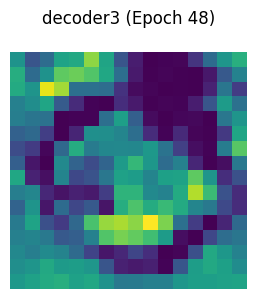

decoder4: torch.Size([3, 16, 32, 32])


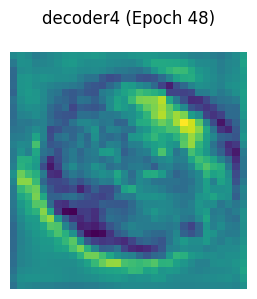

decoder5: torch.Size([3, 8, 64, 64])


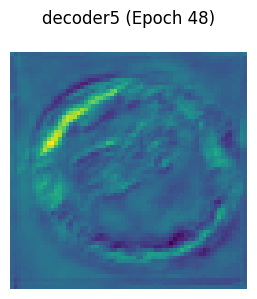

Epoch 48: Loss = 93.2594, Val Dice = 0.7667, Val mIoU = 0.6224, Val Accuracy = 0.9498, Val Sensitivity = 0.7633, Val Specificity = 0.9726


Epoch 49/100: 100%|██████████| 125/125 [01:57<00:00,  1.06it/s]


[Epoch 49] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


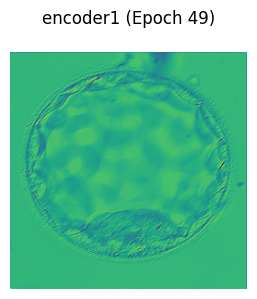

encoder2: torch.Size([3, 16, 128, 128])


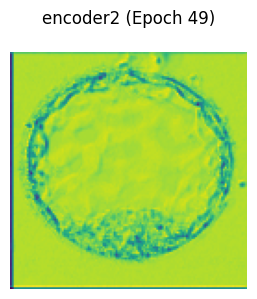

encoder3: torch.Size([3, 24, 64, 64])


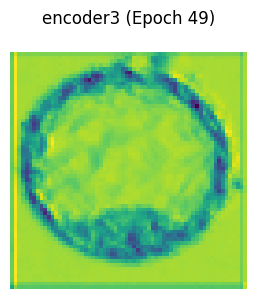

encoder4: torch.Size([3, 32, 32, 32])


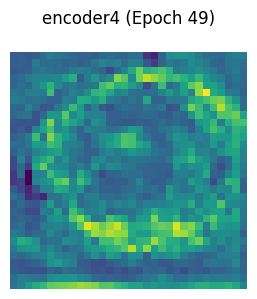

encoder5: torch.Size([3, 48, 16, 16])


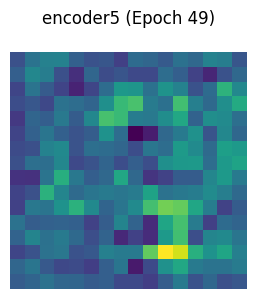

encoder6: torch.Size([3, 64, 8, 8])


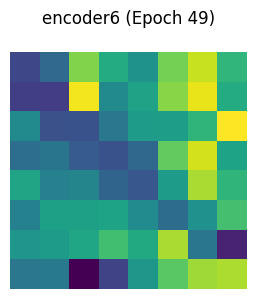

decoder1: torch.Size([3, 48, 8, 8])


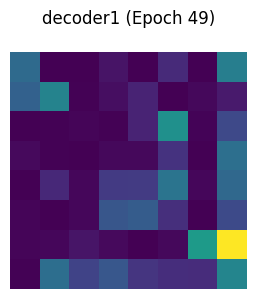

decoder2: torch.Size([3, 32, 8, 8])


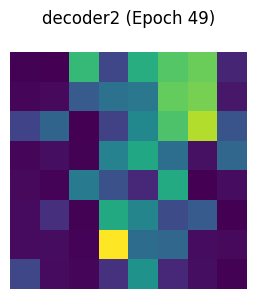

decoder3: torch.Size([3, 24, 16, 16])


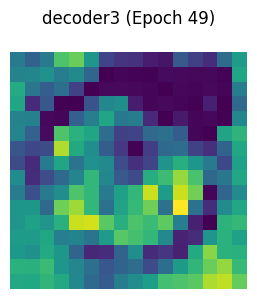

decoder4: torch.Size([3, 16, 32, 32])


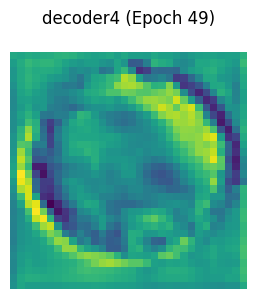

decoder5: torch.Size([3, 8, 64, 64])


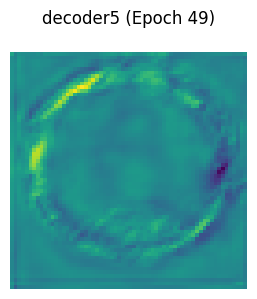

Epoch 49: Loss = 93.2741, Val Dice = 0.7674, Val mIoU = 0.6233, Val Accuracy = 0.9499, Val Sensitivity = 0.7647, Val Specificity = 0.9725


Epoch 50/100: 100%|██████████| 125/125 [01:58<00:00,  1.06it/s]


[Epoch 50] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


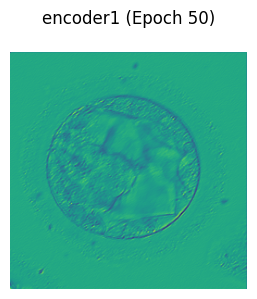

encoder2: torch.Size([3, 16, 128, 128])


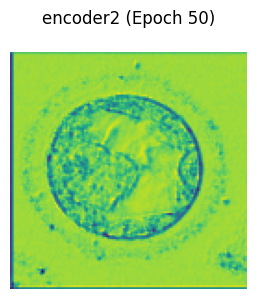

encoder3: torch.Size([3, 24, 64, 64])


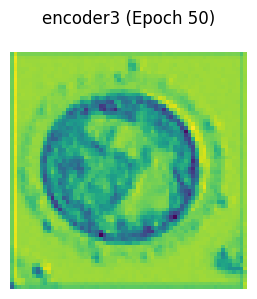

encoder4: torch.Size([3, 32, 32, 32])


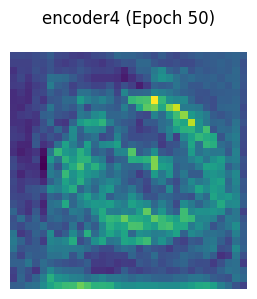

encoder5: torch.Size([3, 48, 16, 16])


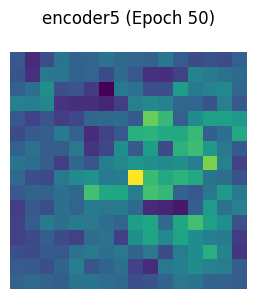

encoder6: torch.Size([3, 64, 8, 8])


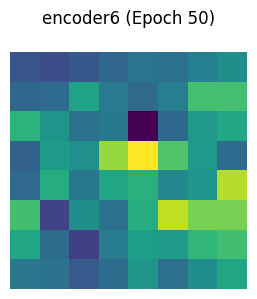

decoder1: torch.Size([3, 48, 8, 8])


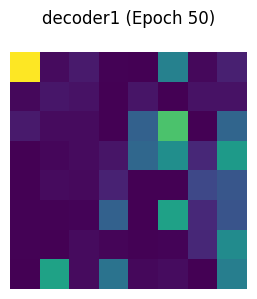

decoder2: torch.Size([3, 32, 8, 8])


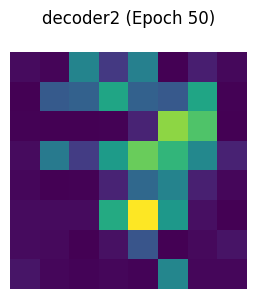

decoder3: torch.Size([3, 24, 16, 16])


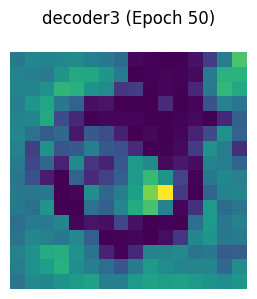

decoder4: torch.Size([3, 16, 32, 32])


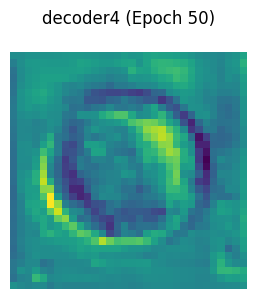

decoder5: torch.Size([3, 8, 64, 64])


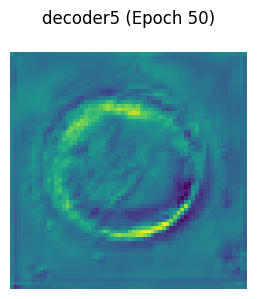

Epoch 50: Loss = 93.2684, Val Dice = 0.7673, Val mIoU = 0.6231, Val Accuracy = 0.9499, Val Sensitivity = 0.7642, Val Specificity = 0.9726


Epoch 51/100: 100%|██████████| 125/125 [01:59<00:00,  1.05it/s]


[Epoch 51] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


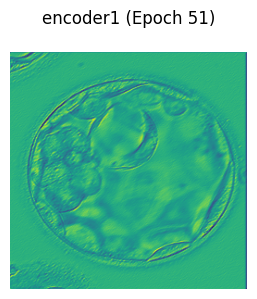

encoder2: torch.Size([3, 16, 128, 128])


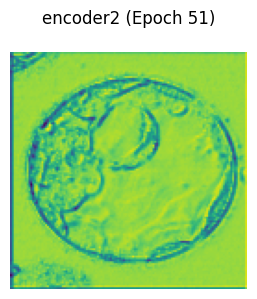

encoder3: torch.Size([3, 24, 64, 64])


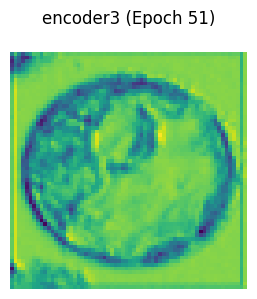

encoder4: torch.Size([3, 32, 32, 32])


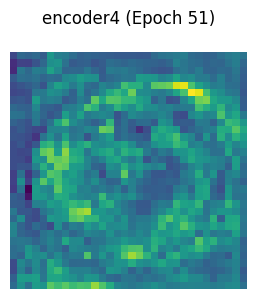

encoder5: torch.Size([3, 48, 16, 16])


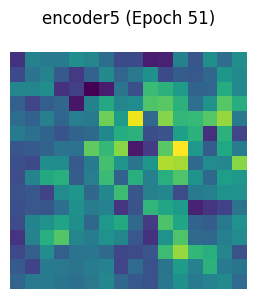

encoder6: torch.Size([3, 64, 8, 8])


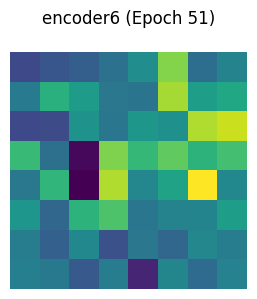

decoder1: torch.Size([3, 48, 8, 8])


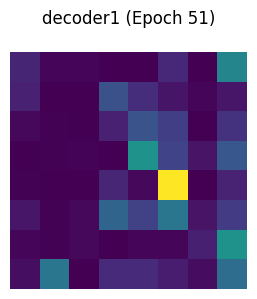

decoder2: torch.Size([3, 32, 8, 8])


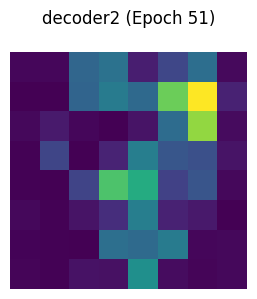

decoder3: torch.Size([3, 24, 16, 16])


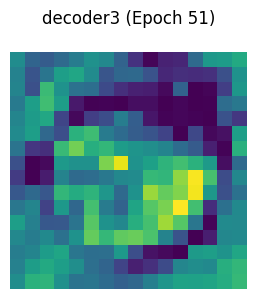

decoder4: torch.Size([3, 16, 32, 32])


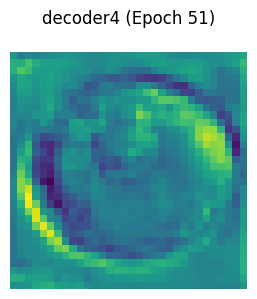

decoder5: torch.Size([3, 8, 64, 64])


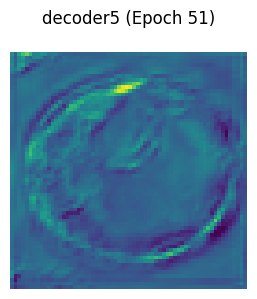

Epoch 51: Loss = 93.2479, Val Dice = 0.7672, Val mIoU = 0.6231, Val Accuracy = 0.9499, Val Sensitivity = 0.7647, Val Specificity = 0.9725


Epoch 52/100: 100%|██████████| 125/125 [01:59<00:00,  1.04it/s]


[Epoch 52] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


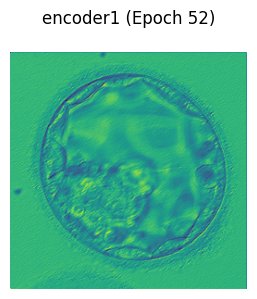

encoder2: torch.Size([3, 16, 128, 128])


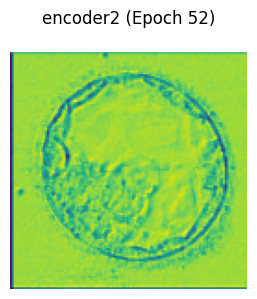

encoder3: torch.Size([3, 24, 64, 64])


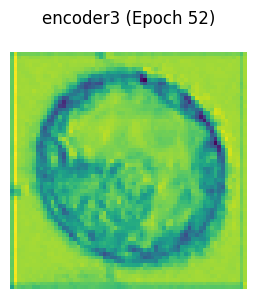

encoder4: torch.Size([3, 32, 32, 32])


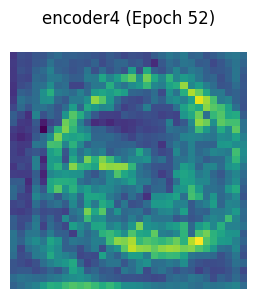

encoder5: torch.Size([3, 48, 16, 16])


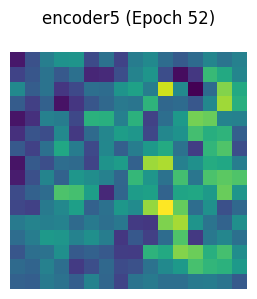

encoder6: torch.Size([3, 64, 8, 8])


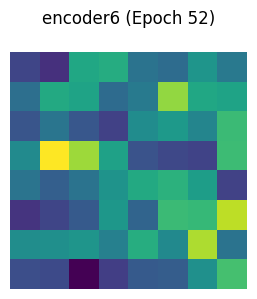

decoder1: torch.Size([3, 48, 8, 8])


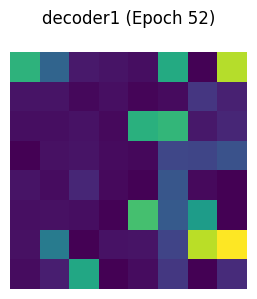

decoder2: torch.Size([3, 32, 8, 8])


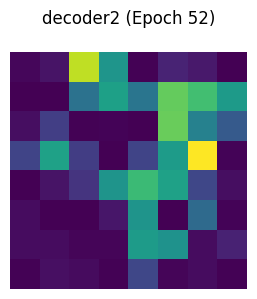

decoder3: torch.Size([3, 24, 16, 16])


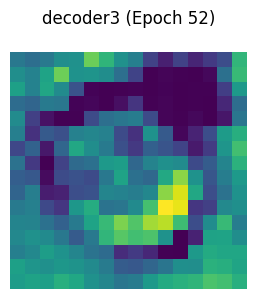

decoder4: torch.Size([3, 16, 32, 32])


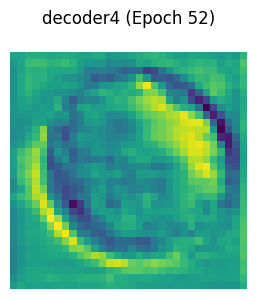

decoder5: torch.Size([3, 8, 64, 64])


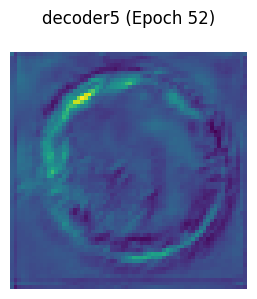

Epoch 52: Loss = 93.2336, Val Dice = 0.7667, Val mIoU = 0.6223, Val Accuracy = 0.9498, Val Sensitivity = 0.7630, Val Specificity = 0.9726


Epoch 53/100: 100%|██████████| 125/125 [02:00<00:00,  1.04it/s]


[Epoch 53] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


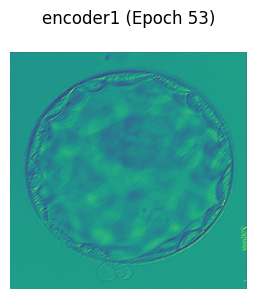

encoder2: torch.Size([3, 16, 128, 128])


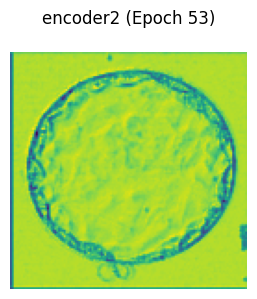

encoder3: torch.Size([3, 24, 64, 64])


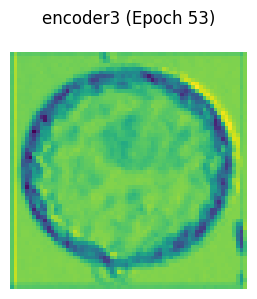

encoder4: torch.Size([3, 32, 32, 32])


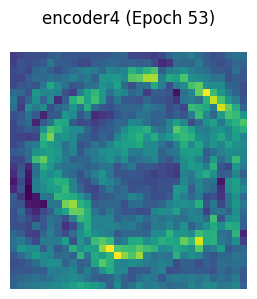

encoder5: torch.Size([3, 48, 16, 16])


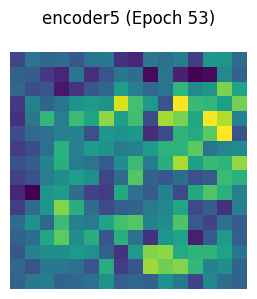

encoder6: torch.Size([3, 64, 8, 8])


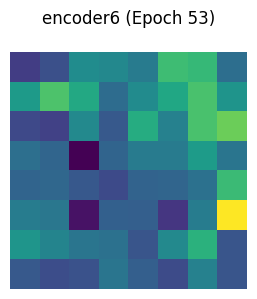

decoder1: torch.Size([3, 48, 8, 8])


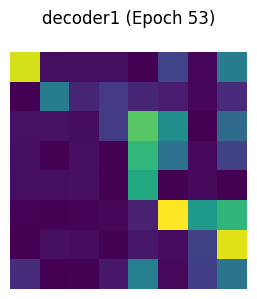

decoder2: torch.Size([3, 32, 8, 8])


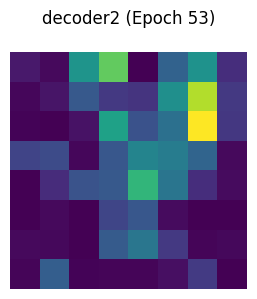

decoder3: torch.Size([3, 24, 16, 16])


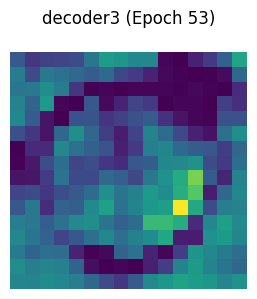

decoder4: torch.Size([3, 16, 32, 32])


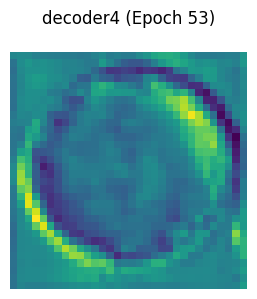

decoder5: torch.Size([3, 8, 64, 64])


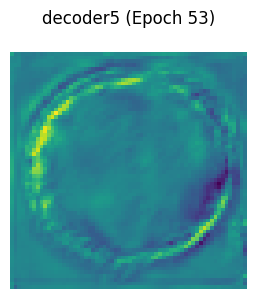

Epoch 53: Loss = 93.1981, Val Dice = 0.7662, Val mIoU = 0.6218, Val Accuracy = 0.9498, Val Sensitivity = 0.7618, Val Specificity = 0.9727


Epoch 54/100: 100%|██████████| 125/125 [02:00<00:00,  1.04it/s]


[Epoch 54] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


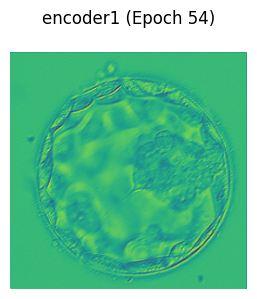

encoder2: torch.Size([3, 16, 128, 128])


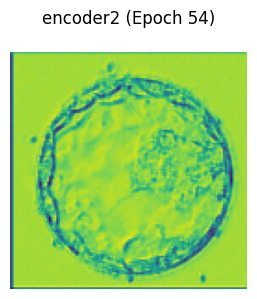

encoder3: torch.Size([3, 24, 64, 64])


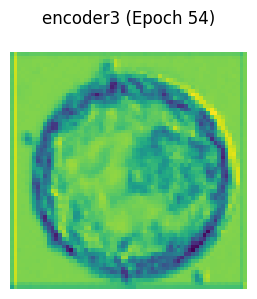

encoder4: torch.Size([3, 32, 32, 32])


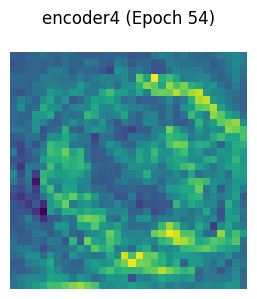

encoder5: torch.Size([3, 48, 16, 16])


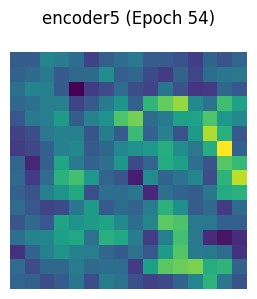

encoder6: torch.Size([3, 64, 8, 8])


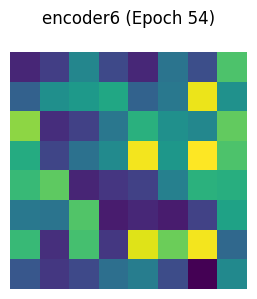

decoder1: torch.Size([3, 48, 8, 8])


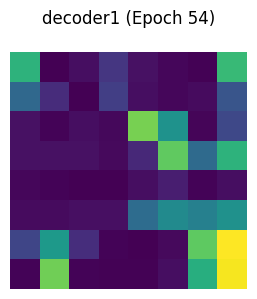

decoder2: torch.Size([3, 32, 8, 8])


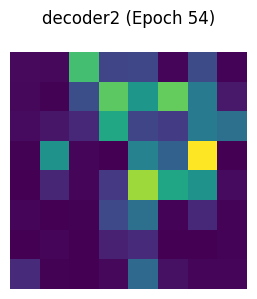

decoder3: torch.Size([3, 24, 16, 16])


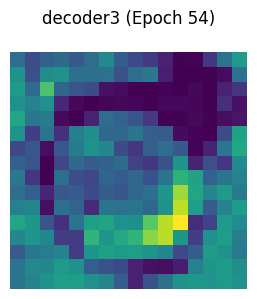

decoder4: torch.Size([3, 16, 32, 32])


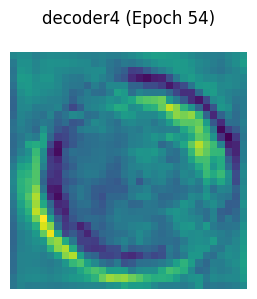

decoder5: torch.Size([3, 8, 64, 64])


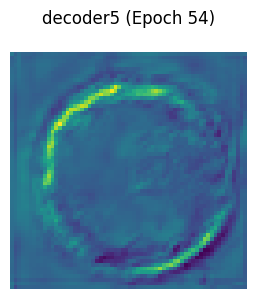

Epoch 54: Loss = 93.1907, Val Dice = 0.7672, Val mIoU = 0.6230, Val Accuracy = 0.9498, Val Sensitivity = 0.7656, Val Specificity = 0.9723


Epoch 55/100: 100%|██████████| 125/125 [02:02<00:00,  1.02it/s]


[Epoch 55] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


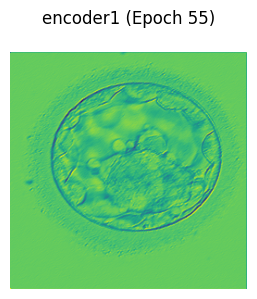

encoder2: torch.Size([3, 16, 128, 128])


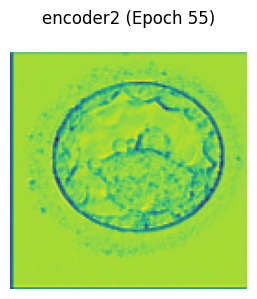

encoder3: torch.Size([3, 24, 64, 64])


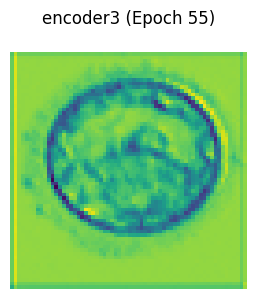

encoder4: torch.Size([3, 32, 32, 32])


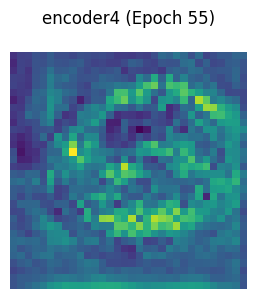

encoder5: torch.Size([3, 48, 16, 16])


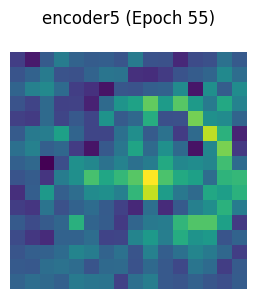

encoder6: torch.Size([3, 64, 8, 8])


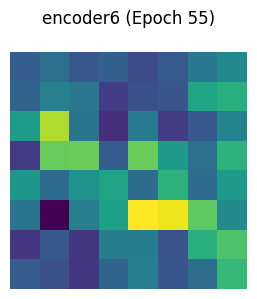

decoder1: torch.Size([3, 48, 8, 8])


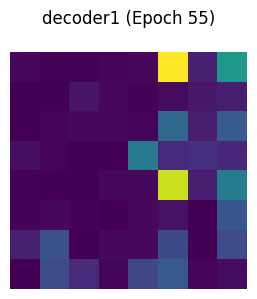

decoder2: torch.Size([3, 32, 8, 8])


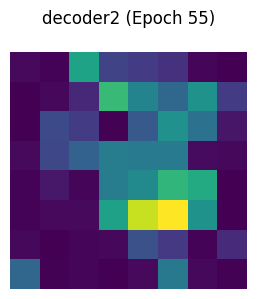

decoder3: torch.Size([3, 24, 16, 16])


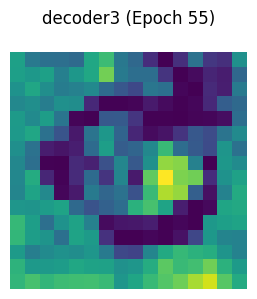

decoder4: torch.Size([3, 16, 32, 32])


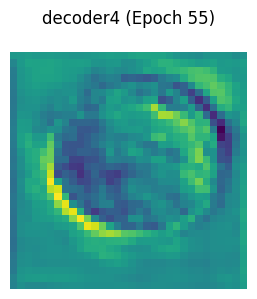

decoder5: torch.Size([3, 8, 64, 64])


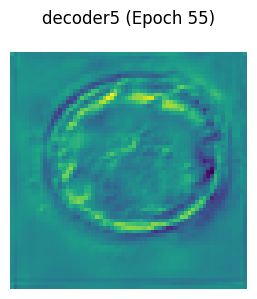

Epoch 55: Loss = 93.2110, Val Dice = 0.7671, Val mIoU = 0.6229, Val Accuracy = 0.9498, Val Sensitivity = 0.7650, Val Specificity = 0.9724


Epoch 56/100: 100%|██████████| 125/125 [02:01<00:00,  1.03it/s]


[Epoch 56] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


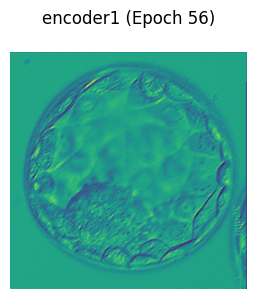

encoder2: torch.Size([3, 16, 128, 128])


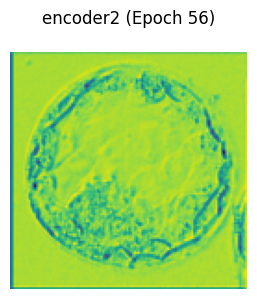

encoder3: torch.Size([3, 24, 64, 64])


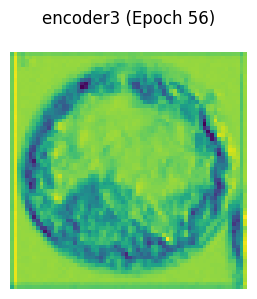

encoder4: torch.Size([3, 32, 32, 32])


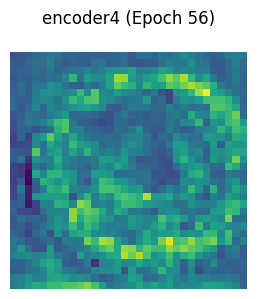

encoder5: torch.Size([3, 48, 16, 16])


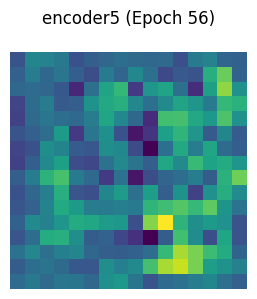

encoder6: torch.Size([3, 64, 8, 8])


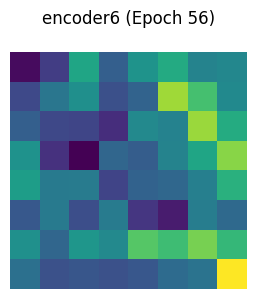

decoder1: torch.Size([3, 48, 8, 8])


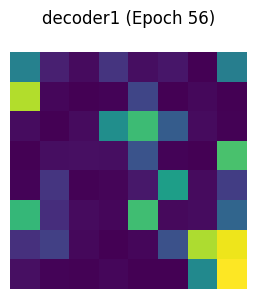

decoder2: torch.Size([3, 32, 8, 8])


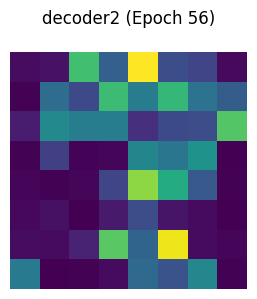

decoder3: torch.Size([3, 24, 16, 16])


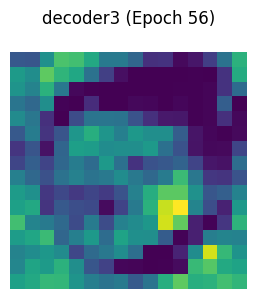

decoder4: torch.Size([3, 16, 32, 32])


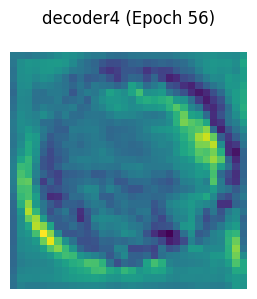

decoder5: torch.Size([3, 8, 64, 64])


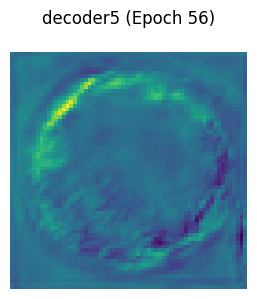

Epoch 56: Loss = 93.1518, Val Dice = 0.7669, Val mIoU = 0.6227, Val Accuracy = 0.9497, Val Sensitivity = 0.7654, Val Specificity = 0.9723


Epoch 57/100: 100%|██████████| 125/125 [02:01<00:00,  1.03it/s]


[Epoch 57] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


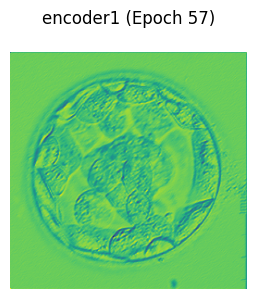

encoder2: torch.Size([3, 16, 128, 128])


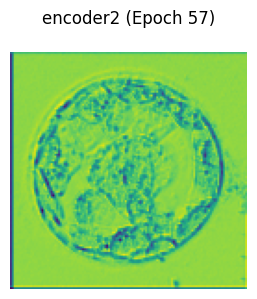

encoder3: torch.Size([3, 24, 64, 64])


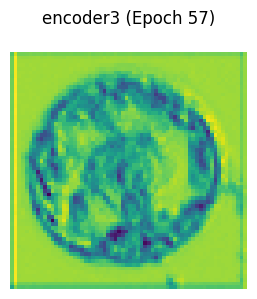

encoder4: torch.Size([3, 32, 32, 32])


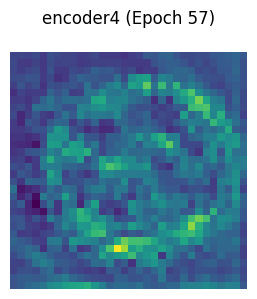

encoder5: torch.Size([3, 48, 16, 16])


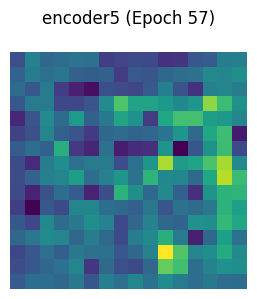

encoder6: torch.Size([3, 64, 8, 8])


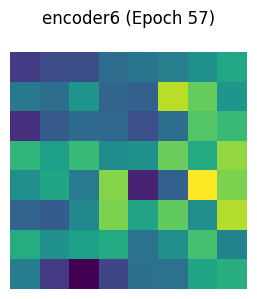

decoder1: torch.Size([3, 48, 8, 8])


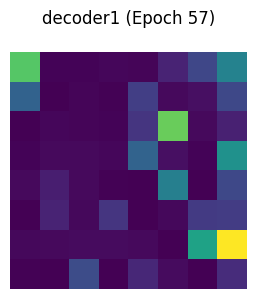

decoder2: torch.Size([3, 32, 8, 8])


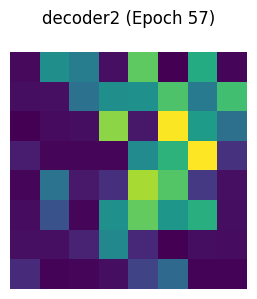

decoder3: torch.Size([3, 24, 16, 16])


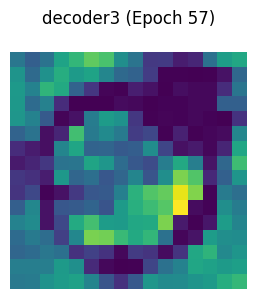

decoder4: torch.Size([3, 16, 32, 32])


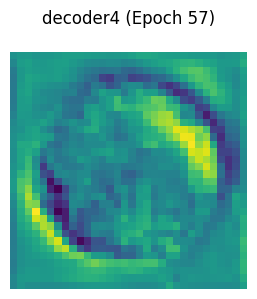

decoder5: torch.Size([3, 8, 64, 64])


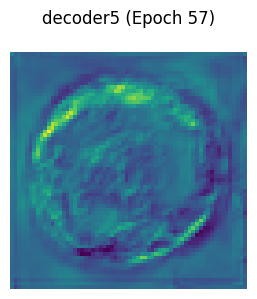

Epoch 57: Loss = 93.1820, Val Dice = 0.7649, Val mIoU = 0.6200, Val Accuracy = 0.9496, Val Sensitivity = 0.7597, Val Specificity = 0.9727


Epoch 58/100: 100%|██████████| 125/125 [02:02<00:00,  1.02it/s]


[Epoch 58] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


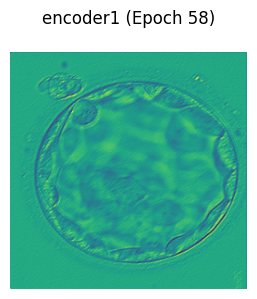

encoder2: torch.Size([3, 16, 128, 128])


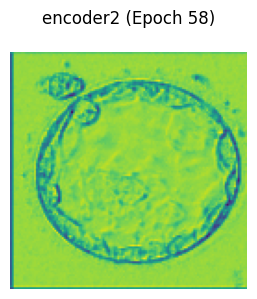

encoder3: torch.Size([3, 24, 64, 64])


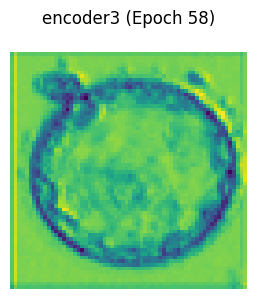

encoder4: torch.Size([3, 32, 32, 32])


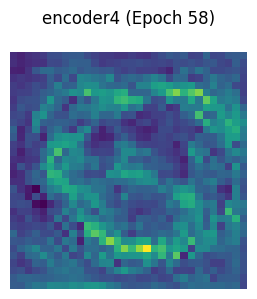

encoder5: torch.Size([3, 48, 16, 16])


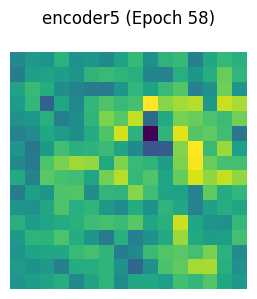

encoder6: torch.Size([3, 64, 8, 8])


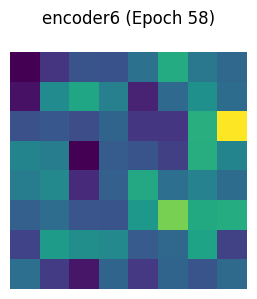

decoder1: torch.Size([3, 48, 8, 8])


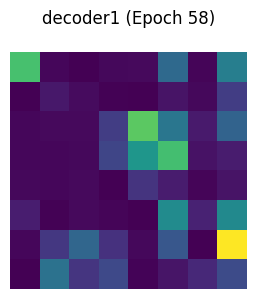

decoder2: torch.Size([3, 32, 8, 8])


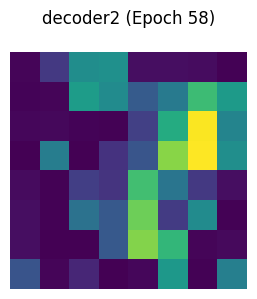

decoder3: torch.Size([3, 24, 16, 16])


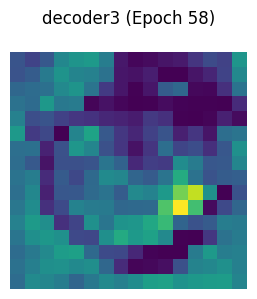

decoder4: torch.Size([3, 16, 32, 32])


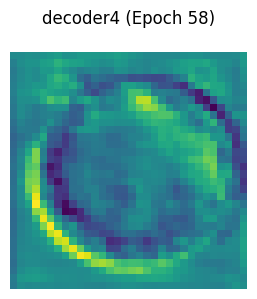

decoder5: torch.Size([3, 8, 64, 64])


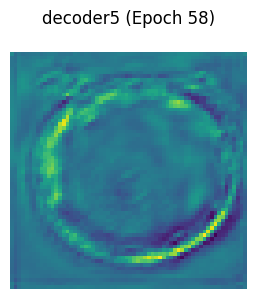

Epoch 58: Loss = 93.1259, Val Dice = 0.7662, Val mIoU = 0.6217, Val Accuracy = 0.9495, Val Sensitivity = 0.7651, Val Specificity = 0.9721


Epoch 59/100: 100%|██████████| 125/125 [02:02<00:00,  1.02it/s]


[Epoch 59] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


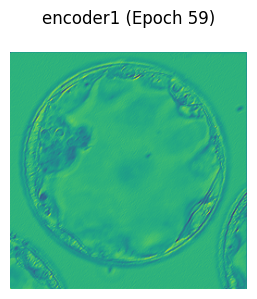

encoder2: torch.Size([3, 16, 128, 128])


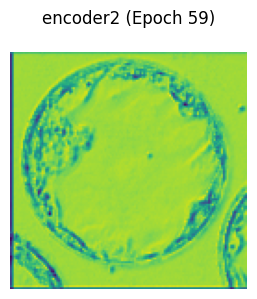

encoder3: torch.Size([3, 24, 64, 64])


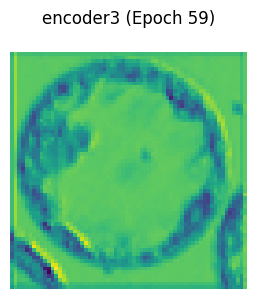

encoder4: torch.Size([3, 32, 32, 32])


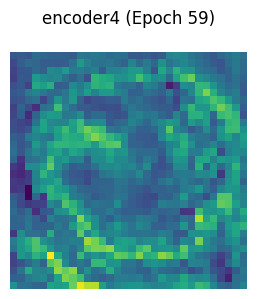

encoder5: torch.Size([3, 48, 16, 16])


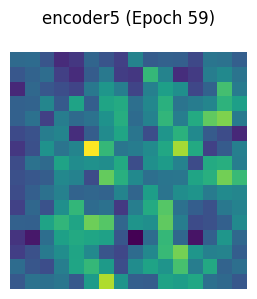

encoder6: torch.Size([3, 64, 8, 8])


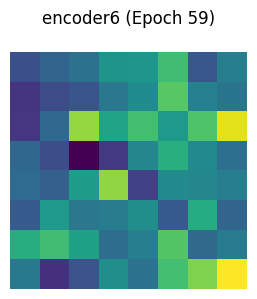

decoder1: torch.Size([3, 48, 8, 8])


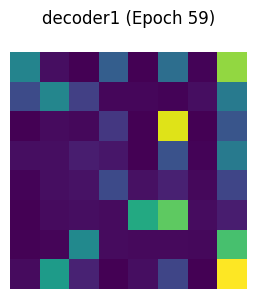

decoder2: torch.Size([3, 32, 8, 8])


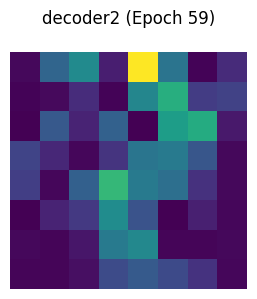

decoder3: torch.Size([3, 24, 16, 16])


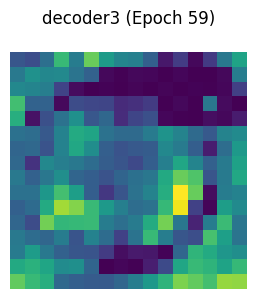

decoder4: torch.Size([3, 16, 32, 32])


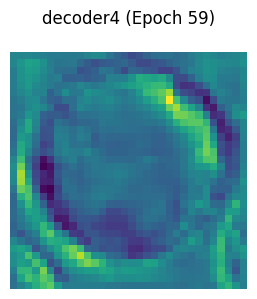

decoder5: torch.Size([3, 8, 64, 64])


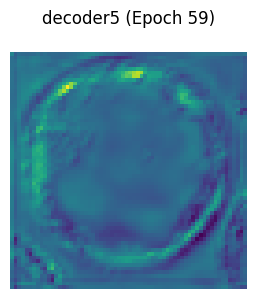

Epoch 59: Loss = 93.2112, Val Dice = 0.7678, Val mIoU = 0.6238, Val Accuracy = 0.9497, Val Sensitivity = 0.7692, Val Specificity = 0.9718


Epoch 60/100: 100%|██████████| 125/125 [02:02<00:00,  1.02it/s]


[Epoch 60] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


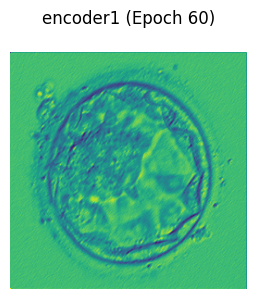

encoder2: torch.Size([3, 16, 128, 128])


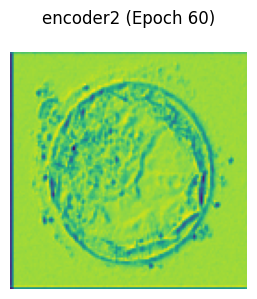

encoder3: torch.Size([3, 24, 64, 64])


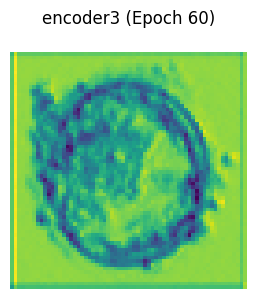

encoder4: torch.Size([3, 32, 32, 32])


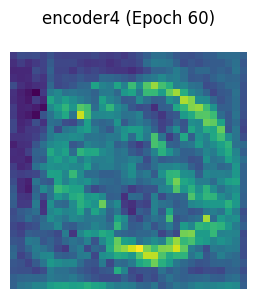

encoder5: torch.Size([3, 48, 16, 16])


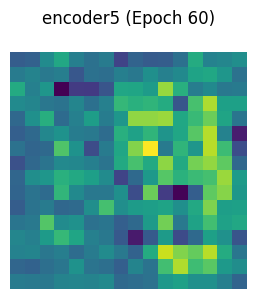

encoder6: torch.Size([3, 64, 8, 8])


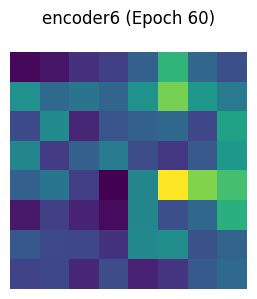

decoder1: torch.Size([3, 48, 8, 8])


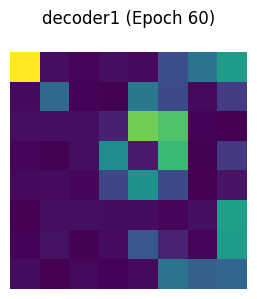

decoder2: torch.Size([3, 32, 8, 8])


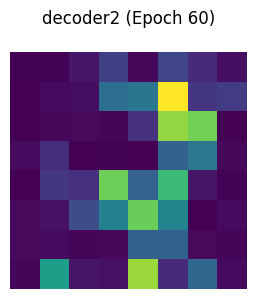

decoder3: torch.Size([3, 24, 16, 16])


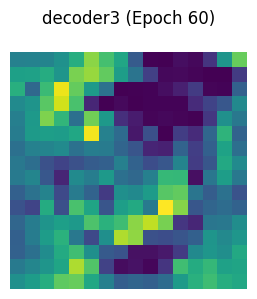

decoder4: torch.Size([3, 16, 32, 32])


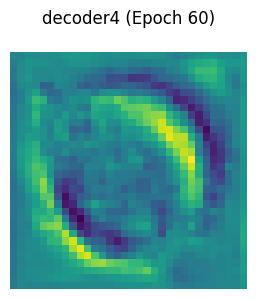

decoder5: torch.Size([3, 8, 64, 64])


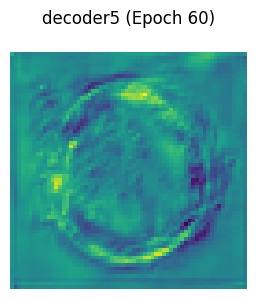

Epoch 60: Loss = 93.2788, Val Dice = 0.7655, Val mIoU = 0.6209, Val Accuracy = 0.9496, Val Sensitivity = 0.7626, Val Specificity = 0.9724


Epoch 61/100: 100%|██████████| 125/125 [02:03<00:00,  1.01it/s]


[Epoch 61] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


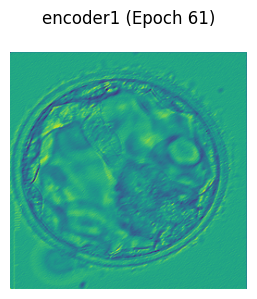

encoder2: torch.Size([3, 16, 128, 128])


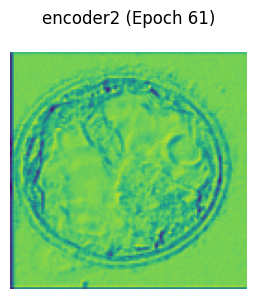

encoder3: torch.Size([3, 24, 64, 64])


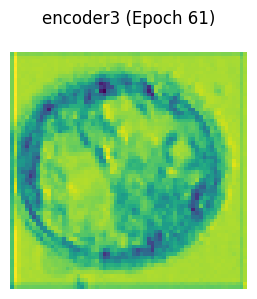

encoder4: torch.Size([3, 32, 32, 32])


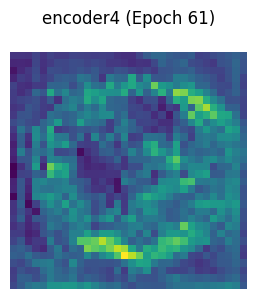

encoder5: torch.Size([3, 48, 16, 16])


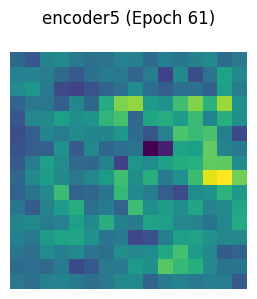

encoder6: torch.Size([3, 64, 8, 8])


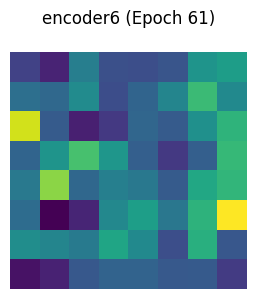

decoder1: torch.Size([3, 48, 8, 8])


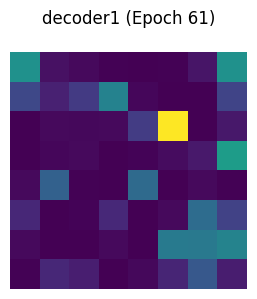

decoder2: torch.Size([3, 32, 8, 8])


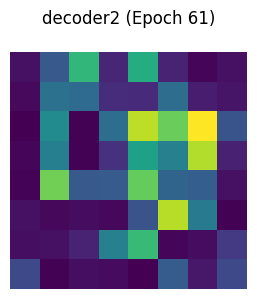

decoder3: torch.Size([3, 24, 16, 16])


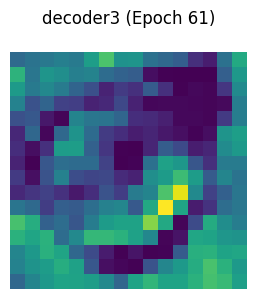

decoder4: torch.Size([3, 16, 32, 32])


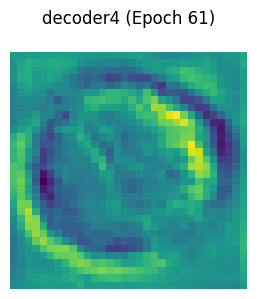

decoder5: torch.Size([3, 8, 64, 64])


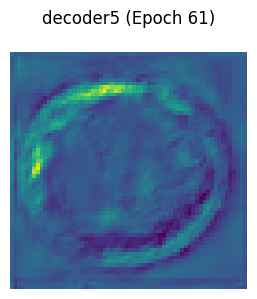

Epoch 61: Loss = 93.3470, Val Dice = 0.7659, Val mIoU = 0.6215, Val Accuracy = 0.9496, Val Sensitivity = 0.7635, Val Specificity = 0.9724


Epoch 62/100: 100%|██████████| 125/125 [02:06<00:00,  1.01s/it]


[Epoch 62] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


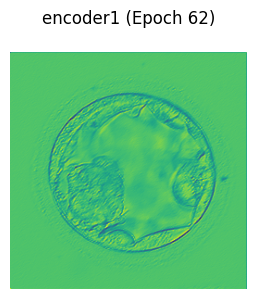

encoder2: torch.Size([3, 16, 128, 128])


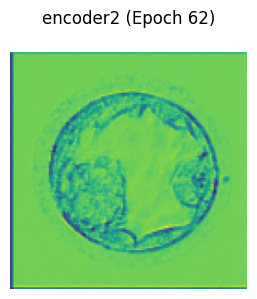

encoder3: torch.Size([3, 24, 64, 64])


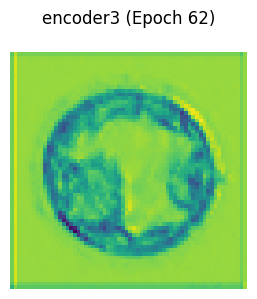

encoder4: torch.Size([3, 32, 32, 32])


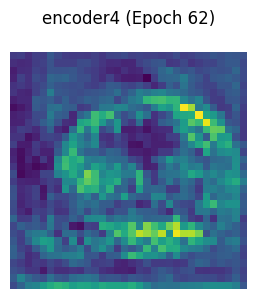

encoder5: torch.Size([3, 48, 16, 16])


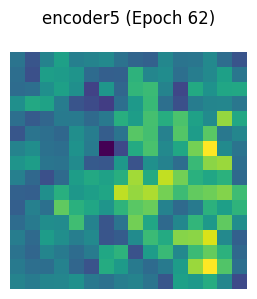

encoder6: torch.Size([3, 64, 8, 8])


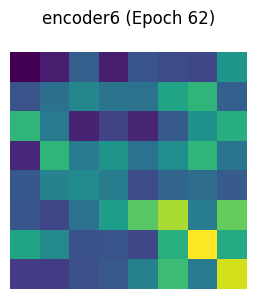

decoder1: torch.Size([3, 48, 8, 8])


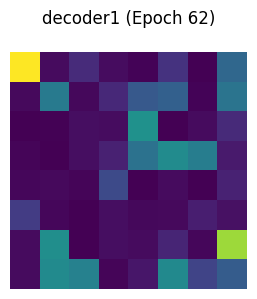

decoder2: torch.Size([3, 32, 8, 8])


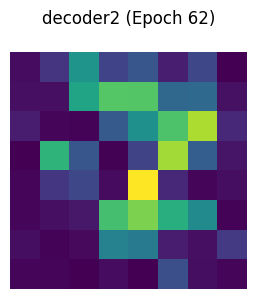

decoder3: torch.Size([3, 24, 16, 16])


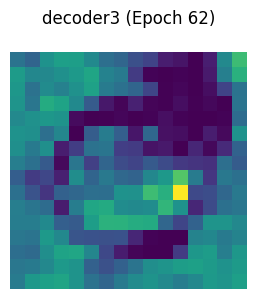

decoder4: torch.Size([3, 16, 32, 32])


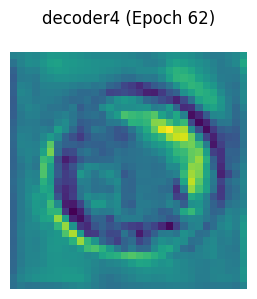

decoder5: torch.Size([3, 8, 64, 64])


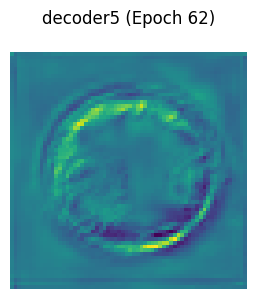

Epoch 62: Loss = 93.4646, Val Dice = 0.7634, Val mIoU = 0.6181, Val Accuracy = 0.9490, Val Sensitivity = 0.7623, Val Specificity = 0.9717


Epoch 63/100: 100%|██████████| 125/125 [02:06<00:00,  1.01s/it]


[Epoch 63] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


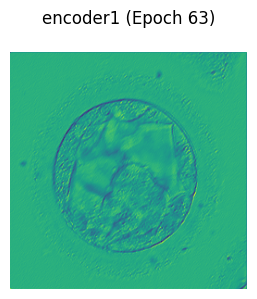

encoder2: torch.Size([3, 16, 128, 128])


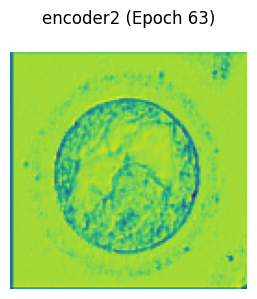

encoder3: torch.Size([3, 24, 64, 64])


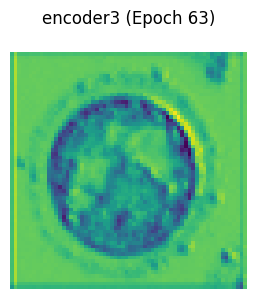

encoder4: torch.Size([3, 32, 32, 32])


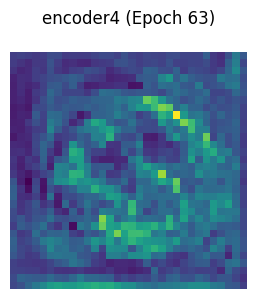

encoder5: torch.Size([3, 48, 16, 16])


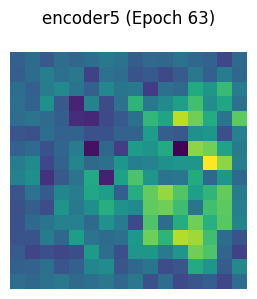

encoder6: torch.Size([3, 64, 8, 8])


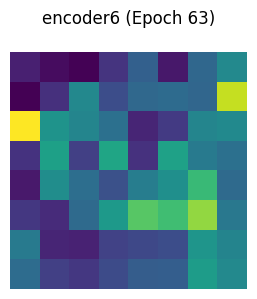

decoder1: torch.Size([3, 48, 8, 8])


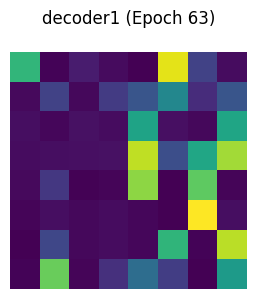

decoder2: torch.Size([3, 32, 8, 8])


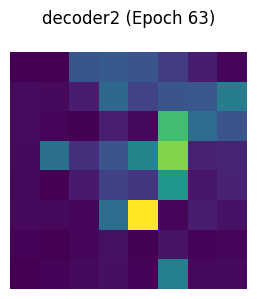

decoder3: torch.Size([3, 24, 16, 16])


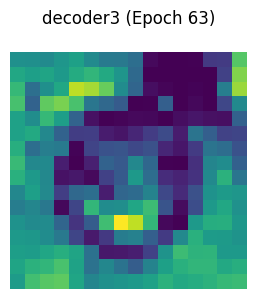

decoder4: torch.Size([3, 16, 32, 32])


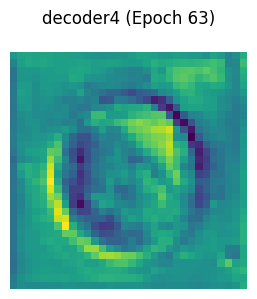

decoder5: torch.Size([3, 8, 64, 64])


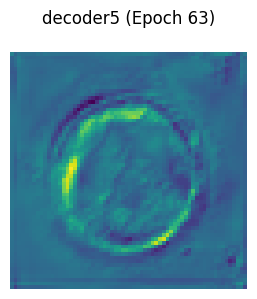

Epoch 63: Loss = 93.5970, Val Dice = 0.7662, Val mIoU = 0.6218, Val Accuracy = 0.9497, Val Sensitivity = 0.7630, Val Specificity = 0.9726


Epoch 64/100: 100%|██████████| 125/125 [02:06<00:00,  1.01s/it]


[Epoch 64] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


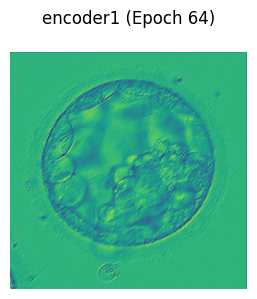

encoder2: torch.Size([3, 16, 128, 128])


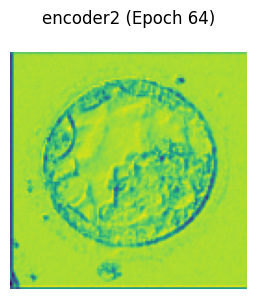

encoder3: torch.Size([3, 24, 64, 64])


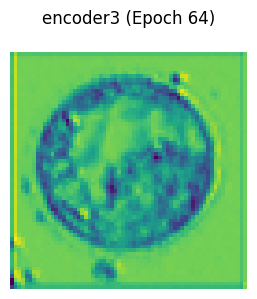

encoder4: torch.Size([3, 32, 32, 32])


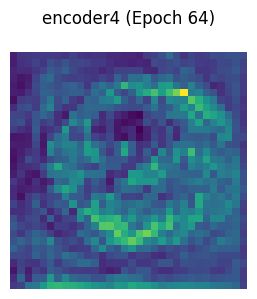

encoder5: torch.Size([3, 48, 16, 16])


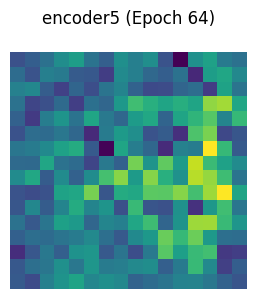

encoder6: torch.Size([3, 64, 8, 8])


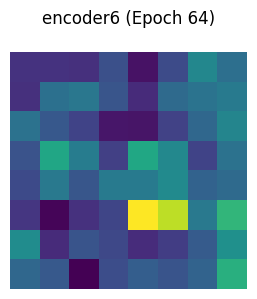

decoder1: torch.Size([3, 48, 8, 8])


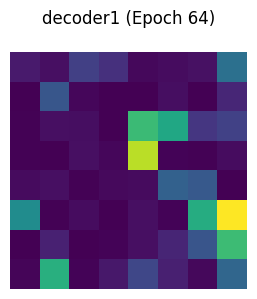

decoder2: torch.Size([3, 32, 8, 8])


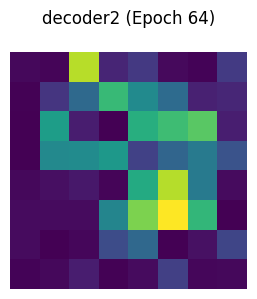

decoder3: torch.Size([3, 24, 16, 16])


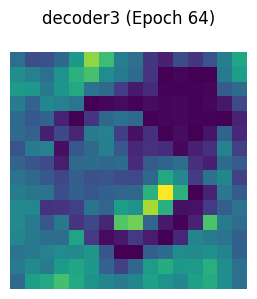

decoder4: torch.Size([3, 16, 32, 32])


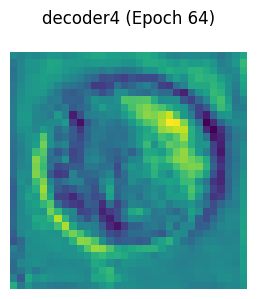

decoder5: torch.Size([3, 8, 64, 64])


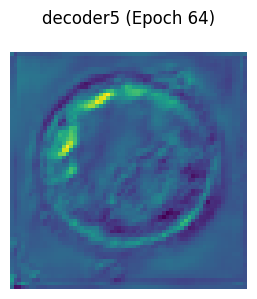

Epoch 64: Loss = 93.7169, Val Dice = 0.7680, Val mIoU = 0.6241, Val Accuracy = 0.9497, Val Sensitivity = 0.7707, Val Specificity = 0.9716


Epoch 65/100: 100%|██████████| 125/125 [02:05<00:00,  1.01s/it]


[Epoch 65] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


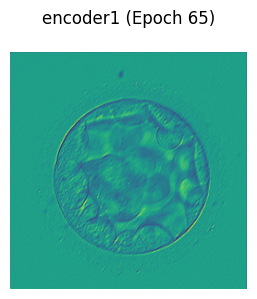

encoder2: torch.Size([3, 16, 128, 128])


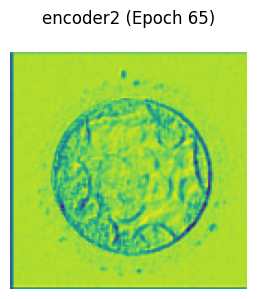

encoder3: torch.Size([3, 24, 64, 64])


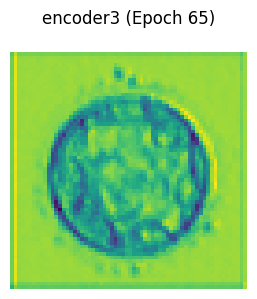

encoder4: torch.Size([3, 32, 32, 32])


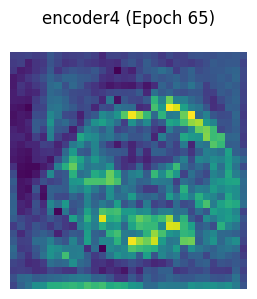

encoder5: torch.Size([3, 48, 16, 16])


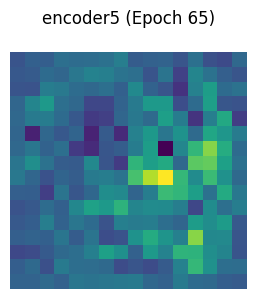

encoder6: torch.Size([3, 64, 8, 8])


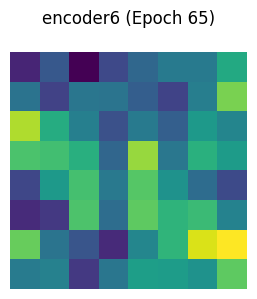

decoder1: torch.Size([3, 48, 8, 8])


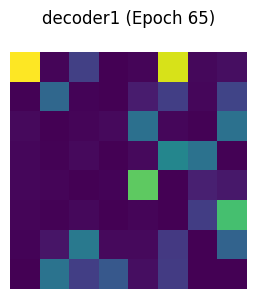

decoder2: torch.Size([3, 32, 8, 8])


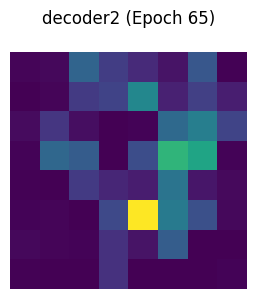

decoder3: torch.Size([3, 24, 16, 16])


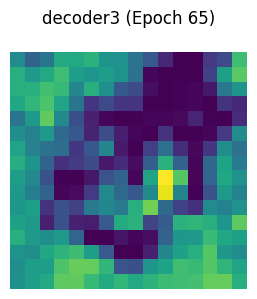

decoder4: torch.Size([3, 16, 32, 32])


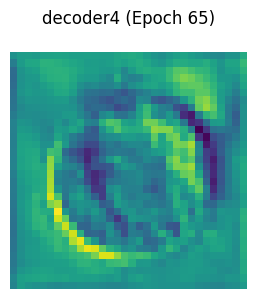

decoder5: torch.Size([3, 8, 64, 64])


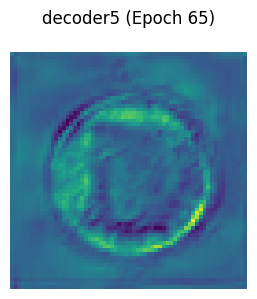

Epoch 65: Loss = 93.7651, Val Dice = 0.7644, Val mIoU = 0.6193, Val Accuracy = 0.9493, Val Sensitivity = 0.7631, Val Specificity = 0.9720


Epoch 66/100: 100%|██████████| 125/125 [02:05<00:00,  1.00s/it]


[Epoch 66] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


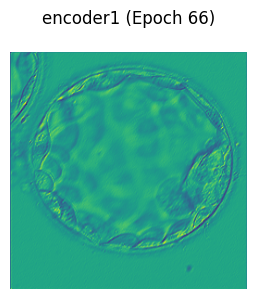

encoder2: torch.Size([3, 16, 128, 128])


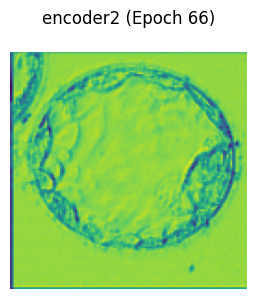

encoder3: torch.Size([3, 24, 64, 64])


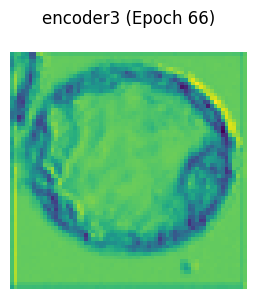

encoder4: torch.Size([3, 32, 32, 32])


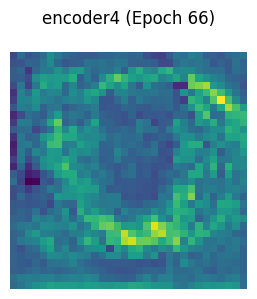

encoder5: torch.Size([3, 48, 16, 16])


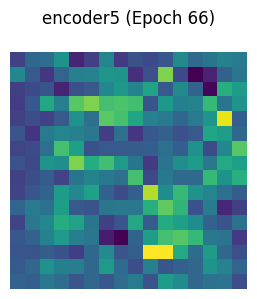

encoder6: torch.Size([3, 64, 8, 8])


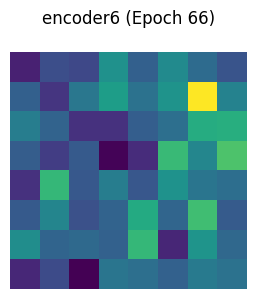

decoder1: torch.Size([3, 48, 8, 8])


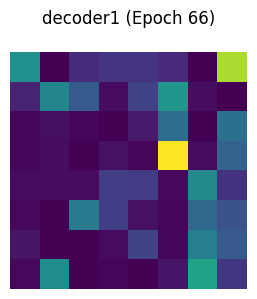

decoder2: torch.Size([3, 32, 8, 8])


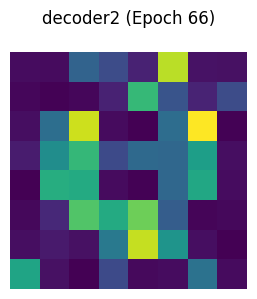

decoder3: torch.Size([3, 24, 16, 16])


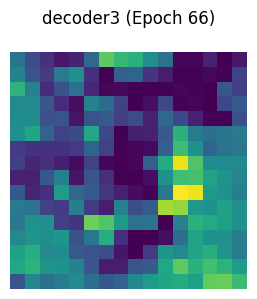

decoder4: torch.Size([3, 16, 32, 32])


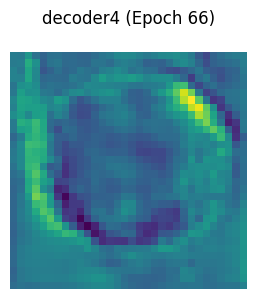

decoder5: torch.Size([3, 8, 64, 64])


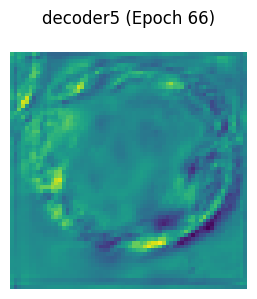

Epoch 66: Loss = 93.8840, Val Dice = 0.7663, Val mIoU = 0.6217, Val Accuracy = 0.9492, Val Sensitivity = 0.7709, Val Specificity = 0.9711


Epoch 67/100: 100%|██████████| 125/125 [02:06<00:00,  1.01s/it]


[Epoch 67] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


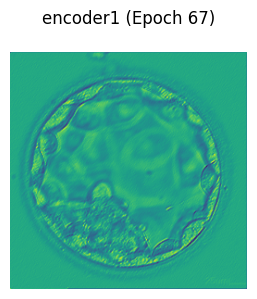

encoder2: torch.Size([3, 16, 128, 128])


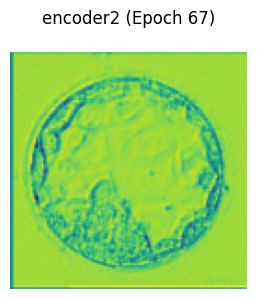

encoder3: torch.Size([3, 24, 64, 64])


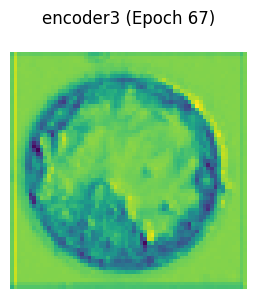

encoder4: torch.Size([3, 32, 32, 32])


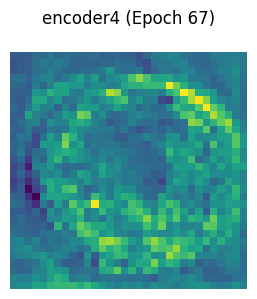

encoder5: torch.Size([3, 48, 16, 16])


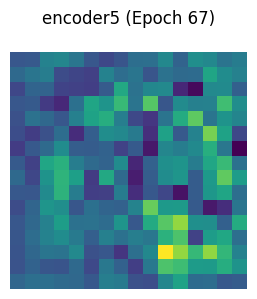

encoder6: torch.Size([3, 64, 8, 8])


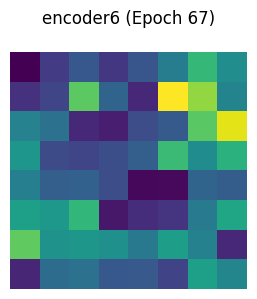

decoder1: torch.Size([3, 48, 8, 8])


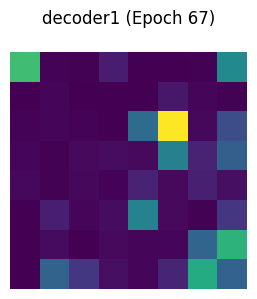

decoder2: torch.Size([3, 32, 8, 8])


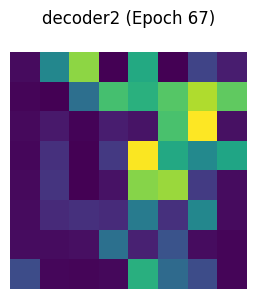

decoder3: torch.Size([3, 24, 16, 16])


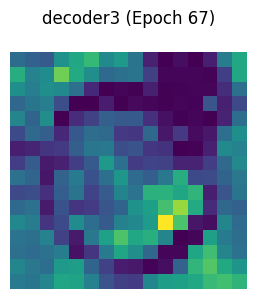

decoder4: torch.Size([3, 16, 32, 32])


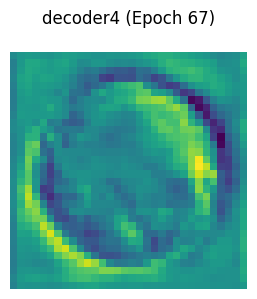

decoder5: torch.Size([3, 8, 64, 64])


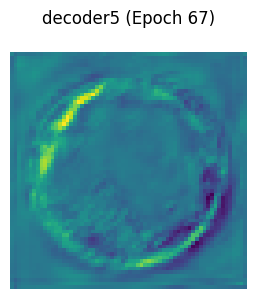

Epoch 67: Loss = 93.9451, Val Dice = 0.7689, Val mIoU = 0.6255, Val Accuracy = 0.9495, Val Sensitivity = 0.7755, Val Specificity = 0.9709


Epoch 68/100: 100%|██████████| 125/125 [02:06<00:00,  1.01s/it]


[Epoch 68] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


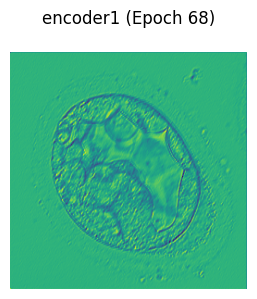

encoder2: torch.Size([3, 16, 128, 128])


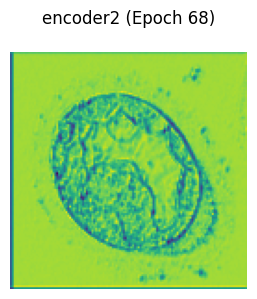

encoder3: torch.Size([3, 24, 64, 64])


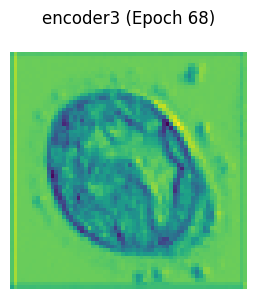

encoder4: torch.Size([3, 32, 32, 32])


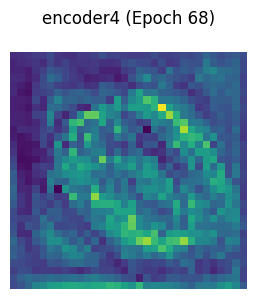

encoder5: torch.Size([3, 48, 16, 16])


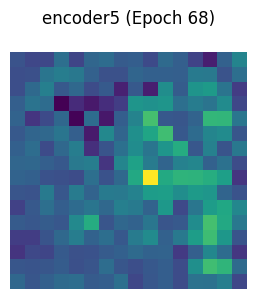

encoder6: torch.Size([3, 64, 8, 8])


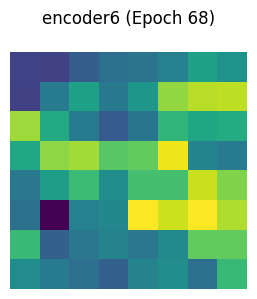

decoder1: torch.Size([3, 48, 8, 8])


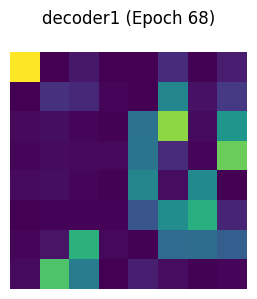

decoder2: torch.Size([3, 32, 8, 8])


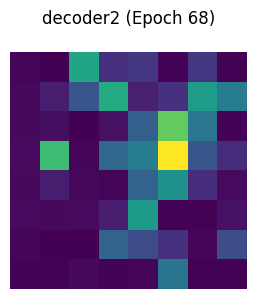

decoder3: torch.Size([3, 24, 16, 16])


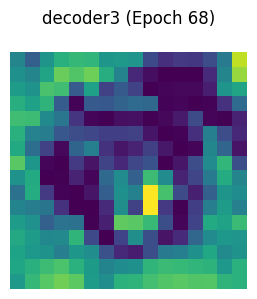

decoder4: torch.Size([3, 16, 32, 32])


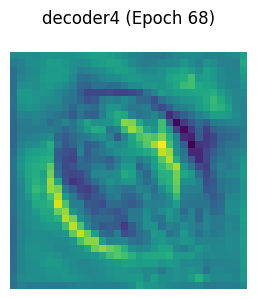

decoder5: torch.Size([3, 8, 64, 64])


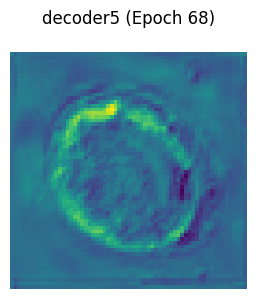

Epoch 68: Loss = 94.1747, Val Dice = 0.7682, Val mIoU = 0.6245, Val Accuracy = 0.9499, Val Sensitivity = 0.7663, Val Specificity = 0.9723


Epoch 69/100: 100%|██████████| 125/125 [02:07<00:00,  1.02s/it]


[Epoch 69] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


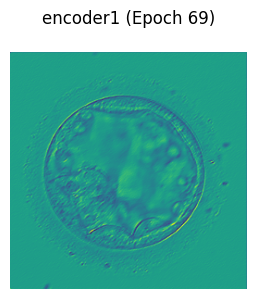

encoder2: torch.Size([3, 16, 128, 128])


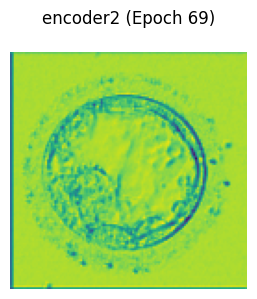

encoder3: torch.Size([3, 24, 64, 64])


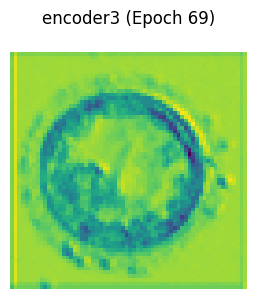

encoder4: torch.Size([3, 32, 32, 32])


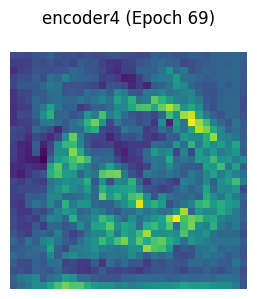

encoder5: torch.Size([3, 48, 16, 16])


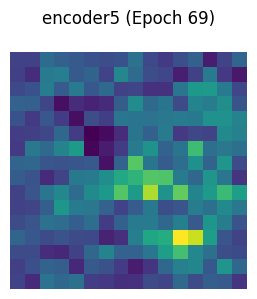

encoder6: torch.Size([3, 64, 8, 8])


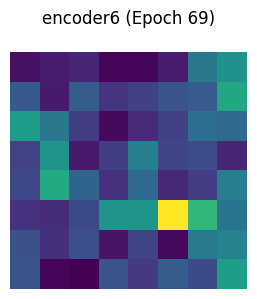

decoder1: torch.Size([3, 48, 8, 8])


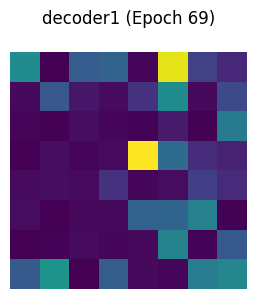

decoder2: torch.Size([3, 32, 8, 8])


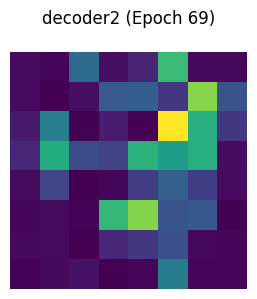

decoder3: torch.Size([3, 24, 16, 16])


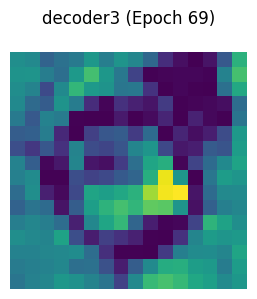

decoder4: torch.Size([3, 16, 32, 32])


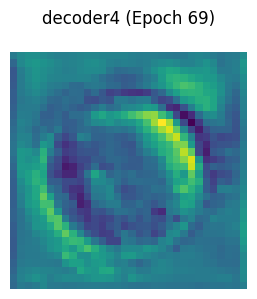

decoder5: torch.Size([3, 8, 64, 64])


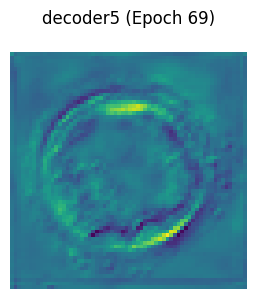

Epoch 69: Loss = 94.1510, Val Dice = 0.7708, Val mIoU = 0.6283, Val Accuracy = 0.9505, Val Sensitivity = 0.7688, Val Specificity = 0.9729


Epoch 70/100: 100%|██████████| 125/125 [02:08<00:00,  1.03s/it]


[Epoch 70] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


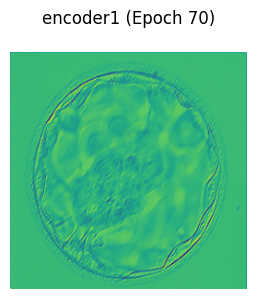

encoder2: torch.Size([3, 16, 128, 128])


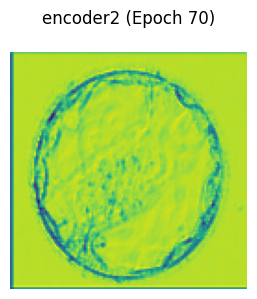

encoder3: torch.Size([3, 24, 64, 64])


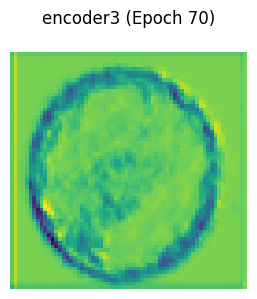

encoder4: torch.Size([3, 32, 32, 32])


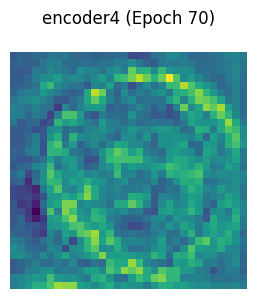

encoder5: torch.Size([3, 48, 16, 16])


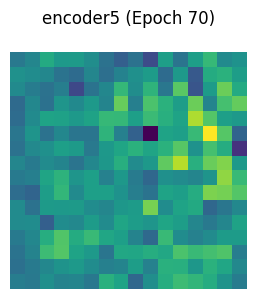

encoder6: torch.Size([3, 64, 8, 8])


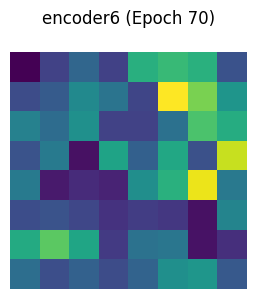

decoder1: torch.Size([3, 48, 8, 8])


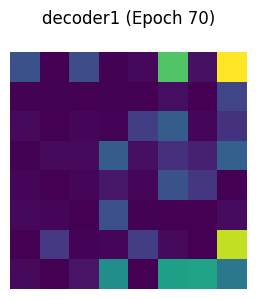

decoder2: torch.Size([3, 32, 8, 8])


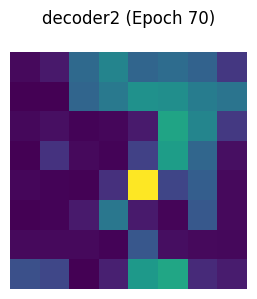

decoder3: torch.Size([3, 24, 16, 16])


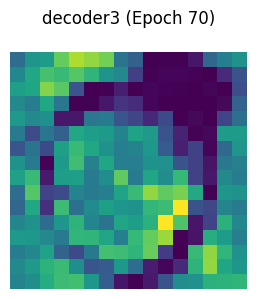

decoder4: torch.Size([3, 16, 32, 32])


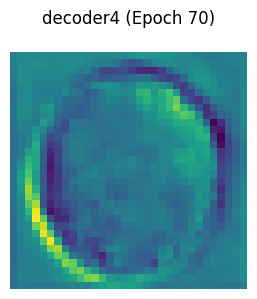

decoder5: torch.Size([3, 8, 64, 64])


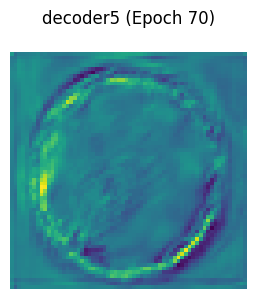

Epoch 70: Loss = 94.3331, Val Dice = 0.7691, Val mIoU = 0.6260, Val Accuracy = 0.9504, Val Sensitivity = 0.7630, Val Specificity = 0.9735


Epoch 71/100: 100%|██████████| 125/125 [02:07<00:00,  1.02s/it]


[Epoch 71] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


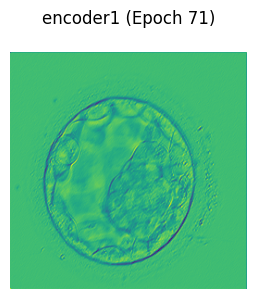

encoder2: torch.Size([3, 16, 128, 128])


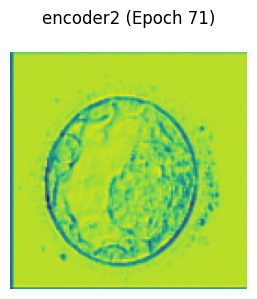

encoder3: torch.Size([3, 24, 64, 64])


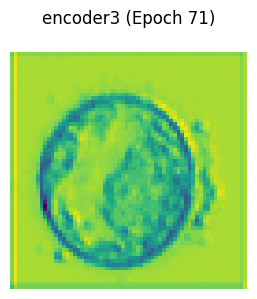

encoder4: torch.Size([3, 32, 32, 32])


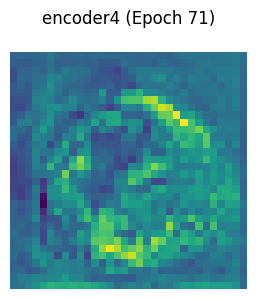

encoder5: torch.Size([3, 48, 16, 16])


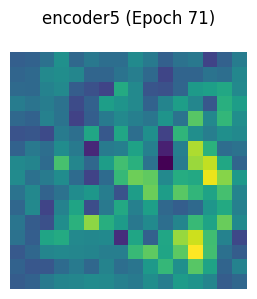

encoder6: torch.Size([3, 64, 8, 8])


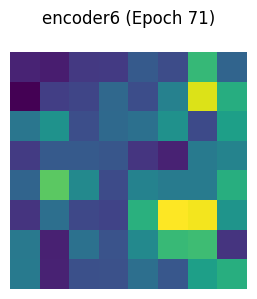

decoder1: torch.Size([3, 48, 8, 8])


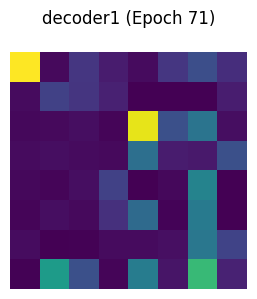

decoder2: torch.Size([3, 32, 8, 8])


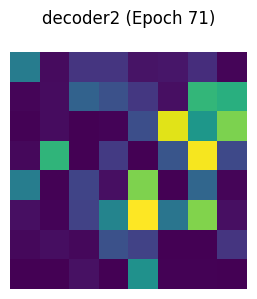

decoder3: torch.Size([3, 24, 16, 16])


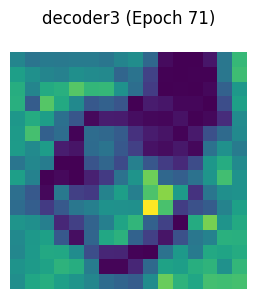

decoder4: torch.Size([3, 16, 32, 32])


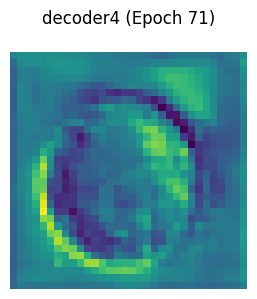

decoder5: torch.Size([3, 8, 64, 64])


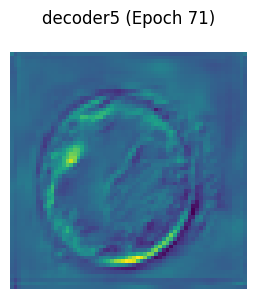

Epoch 71: Loss = 94.5794, Val Dice = 0.7694, Val mIoU = 0.6262, Val Accuracy = 0.9495, Val Sensitivity = 0.7793, Val Specificity = 0.9705


Epoch 72/100: 100%|██████████| 125/125 [02:08<00:00,  1.02s/it]


[Epoch 72] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


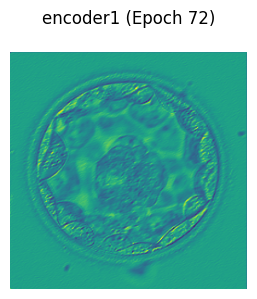

encoder2: torch.Size([3, 16, 128, 128])


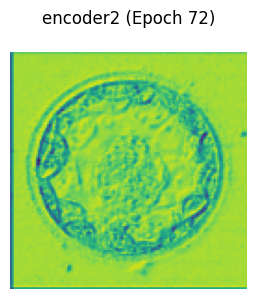

encoder3: torch.Size([3, 24, 64, 64])


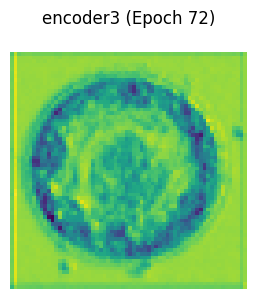

encoder4: torch.Size([3, 32, 32, 32])


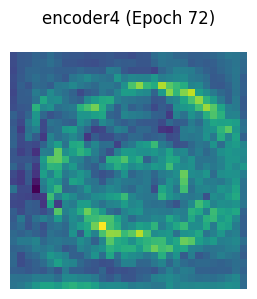

encoder5: torch.Size([3, 48, 16, 16])


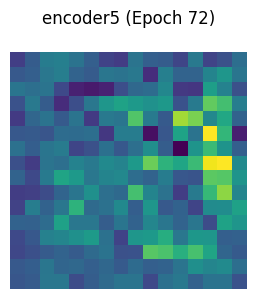

encoder6: torch.Size([3, 64, 8, 8])


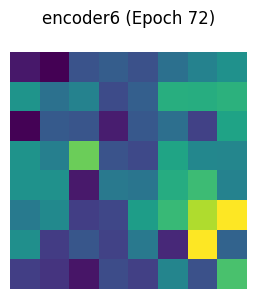

decoder1: torch.Size([3, 48, 8, 8])


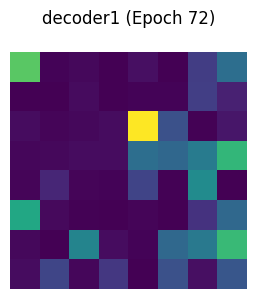

decoder2: torch.Size([3, 32, 8, 8])


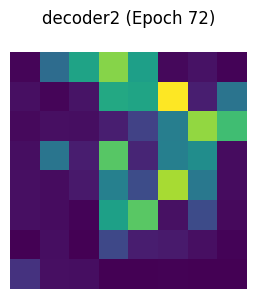

decoder3: torch.Size([3, 24, 16, 16])


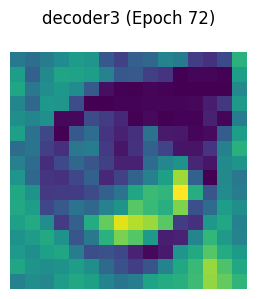

decoder4: torch.Size([3, 16, 32, 32])


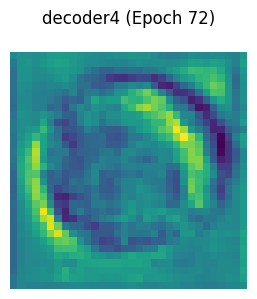

decoder5: torch.Size([3, 8, 64, 64])


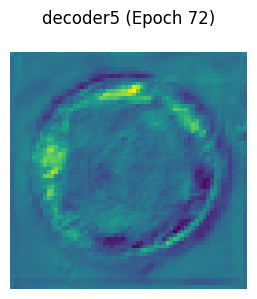

Epoch 72: Loss = 94.6708, Val Dice = 0.7690, Val mIoU = 0.6257, Val Accuracy = 0.9502, Val Sensitivity = 0.7679, Val Specificity = 0.9726


Epoch 73/100: 100%|██████████| 125/125 [02:08<00:00,  1.03s/it]


[Epoch 73] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


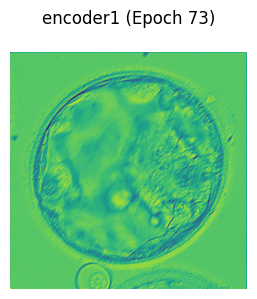

encoder2: torch.Size([3, 16, 128, 128])


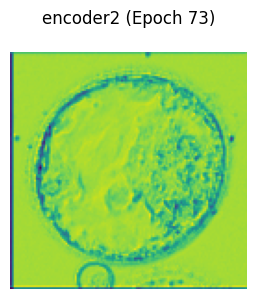

encoder3: torch.Size([3, 24, 64, 64])


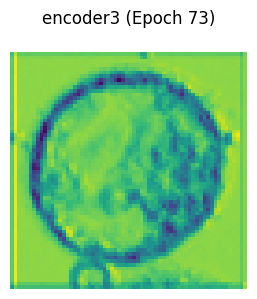

encoder4: torch.Size([3, 32, 32, 32])


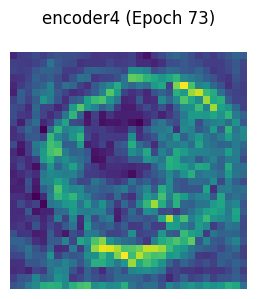

encoder5: torch.Size([3, 48, 16, 16])


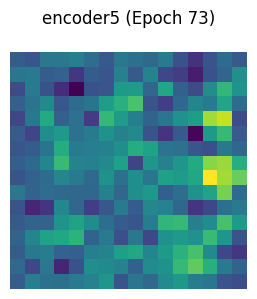

encoder6: torch.Size([3, 64, 8, 8])


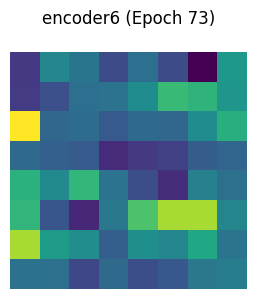

decoder1: torch.Size([3, 48, 8, 8])


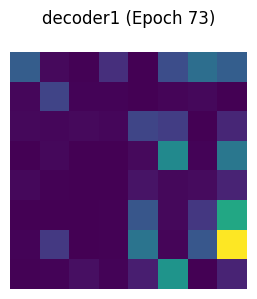

decoder2: torch.Size([3, 32, 8, 8])


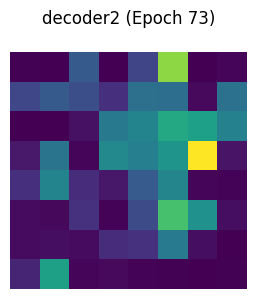

decoder3: torch.Size([3, 24, 16, 16])


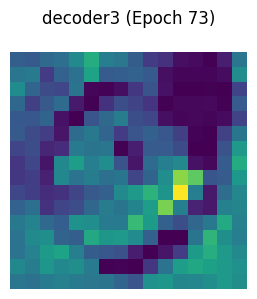

decoder4: torch.Size([3, 16, 32, 32])


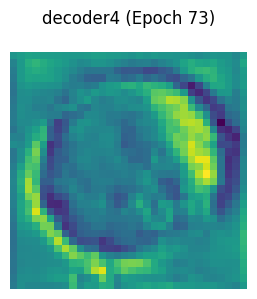

decoder5: torch.Size([3, 8, 64, 64])


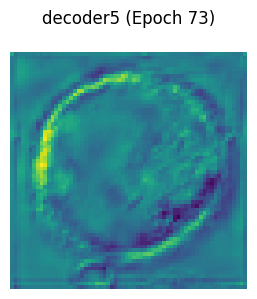

Epoch 73: Loss = 94.7671, Val Dice = 0.7744, Val mIoU = 0.6333, Val Accuracy = 0.9510, Val Sensitivity = 0.7784, Val Specificity = 0.9724


Epoch 74/100: 100%|██████████| 125/125 [02:08<00:00,  1.03s/it]


[Epoch 74] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


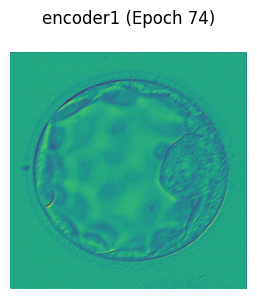

encoder2: torch.Size([3, 16, 128, 128])


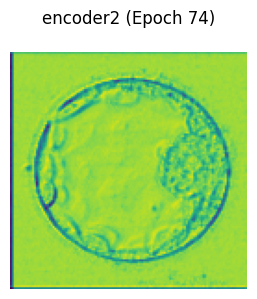

encoder3: torch.Size([3, 24, 64, 64])


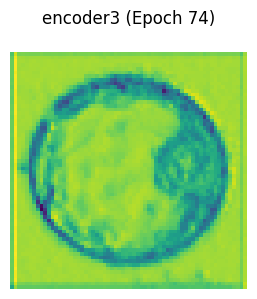

encoder4: torch.Size([3, 32, 32, 32])


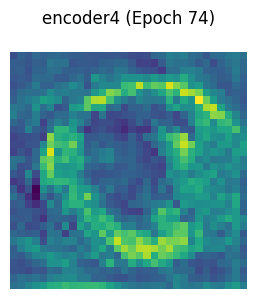

encoder5: torch.Size([3, 48, 16, 16])


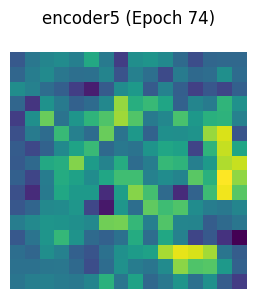

encoder6: torch.Size([3, 64, 8, 8])


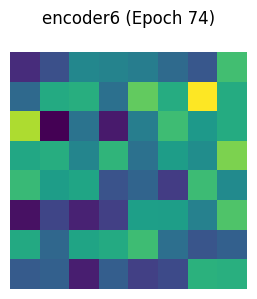

decoder1: torch.Size([3, 48, 8, 8])


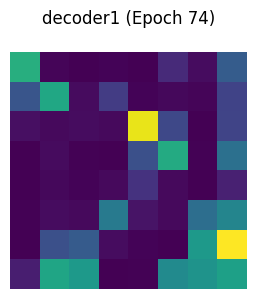

decoder2: torch.Size([3, 32, 8, 8])


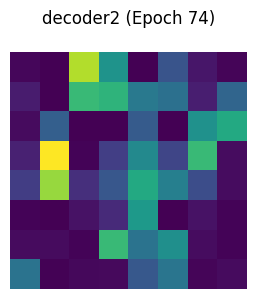

decoder3: torch.Size([3, 24, 16, 16])


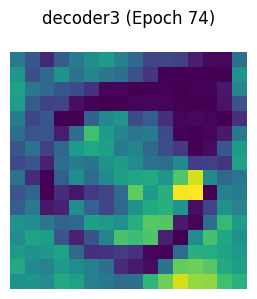

decoder4: torch.Size([3, 16, 32, 32])


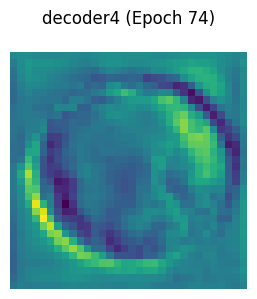

decoder5: torch.Size([3, 8, 64, 64])


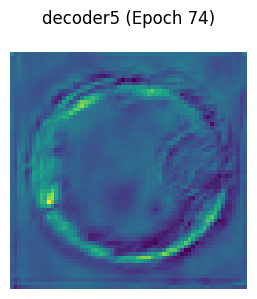

Epoch 74: Loss = 94.7197, Val Dice = 0.7740, Val mIoU = 0.6323, Val Accuracy = 0.9510, Val Sensitivity = 0.7765, Val Specificity = 0.9724


Epoch 75/100: 100%|██████████| 125/125 [02:08<00:00,  1.03s/it]


[Epoch 75] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


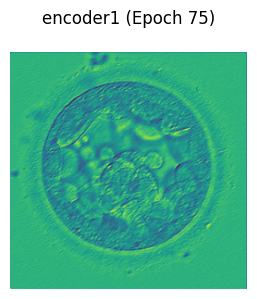

encoder2: torch.Size([3, 16, 128, 128])


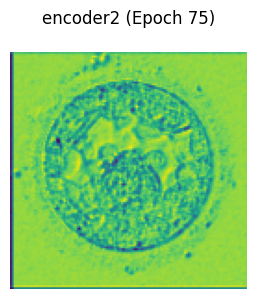

encoder3: torch.Size([3, 24, 64, 64])


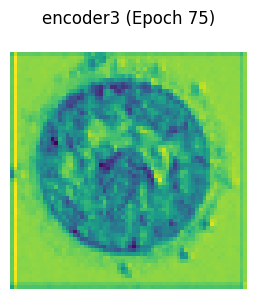

encoder4: torch.Size([3, 32, 32, 32])


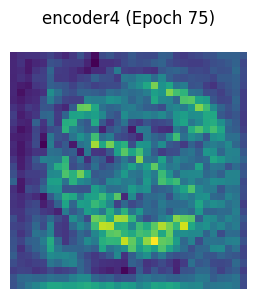

encoder5: torch.Size([3, 48, 16, 16])


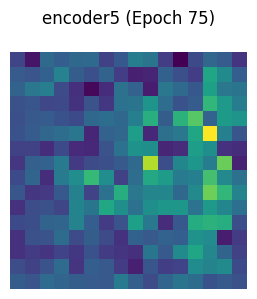

encoder6: torch.Size([3, 64, 8, 8])


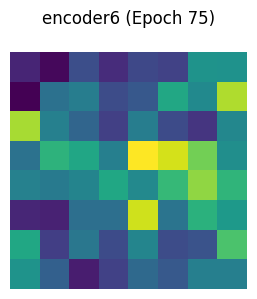

decoder1: torch.Size([3, 48, 8, 8])


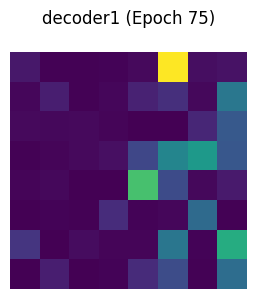

decoder2: torch.Size([3, 32, 8, 8])


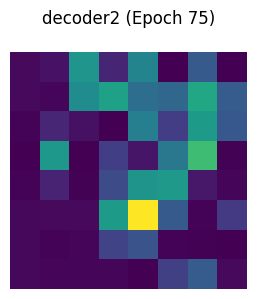

decoder3: torch.Size([3, 24, 16, 16])


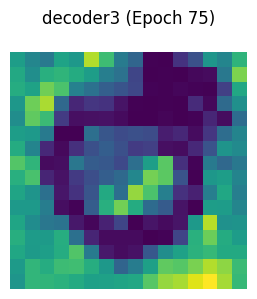

decoder4: torch.Size([3, 16, 32, 32])


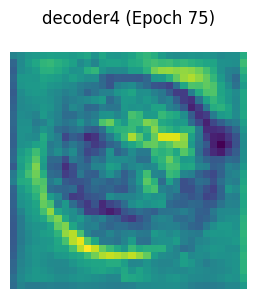

decoder5: torch.Size([3, 8, 64, 64])


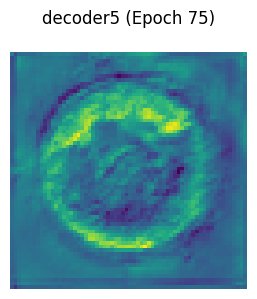

Epoch 75: Loss = 94.8093, Val Dice = 0.7726, Val mIoU = 0.6307, Val Accuracy = 0.9511, Val Sensitivity = 0.7669, Val Specificity = 0.9739


Epoch 76/100: 100%|██████████| 125/125 [02:09<00:00,  1.04s/it]


[Epoch 76] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


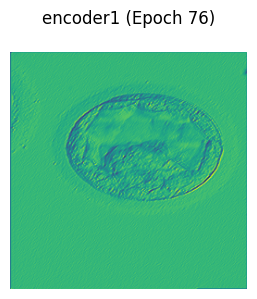

encoder2: torch.Size([3, 16, 128, 128])


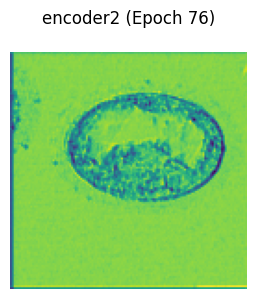

encoder3: torch.Size([3, 24, 64, 64])


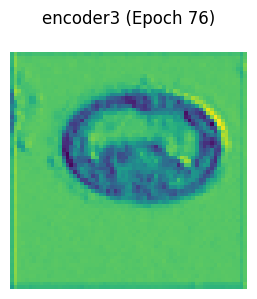

encoder4: torch.Size([3, 32, 32, 32])


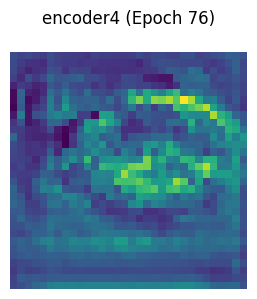

encoder5: torch.Size([3, 48, 16, 16])


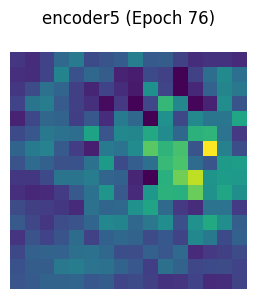

encoder6: torch.Size([3, 64, 8, 8])


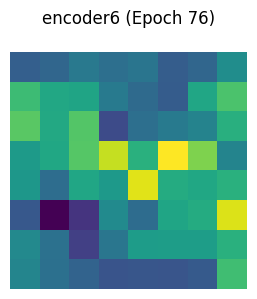

decoder1: torch.Size([3, 48, 8, 8])


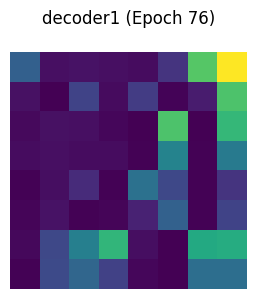

decoder2: torch.Size([3, 32, 8, 8])


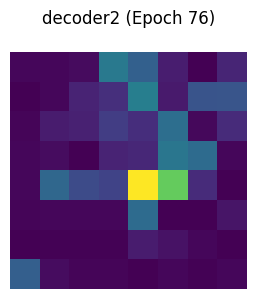

decoder3: torch.Size([3, 24, 16, 16])


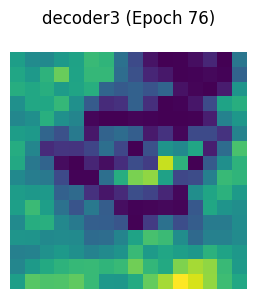

decoder4: torch.Size([3, 16, 32, 32])


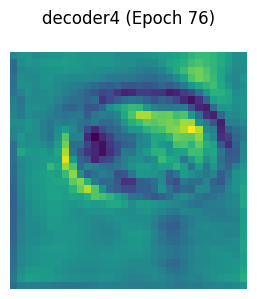

decoder5: torch.Size([3, 8, 64, 64])


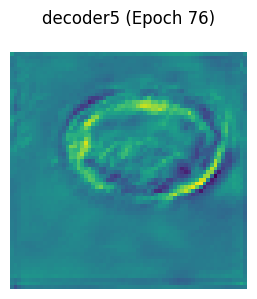

Epoch 76: Loss = 95.1340, Val Dice = 0.7681, Val mIoU = 0.6243, Val Accuracy = 0.9502, Val Sensitivity = 0.7650, Val Specificity = 0.9728


Epoch 77/100: 100%|██████████| 125/125 [02:11<00:00,  1.05s/it]


[Epoch 77] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


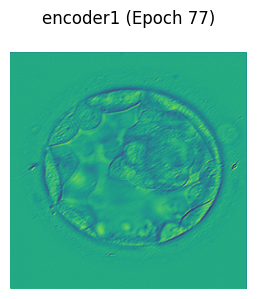

encoder2: torch.Size([3, 16, 128, 128])


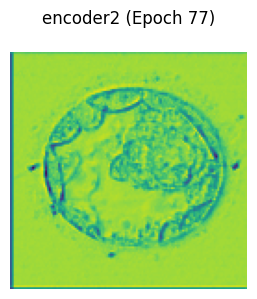

encoder3: torch.Size([3, 24, 64, 64])


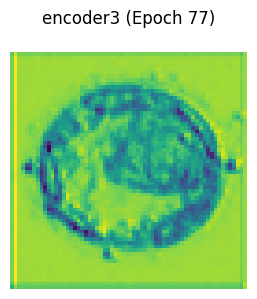

encoder4: torch.Size([3, 32, 32, 32])


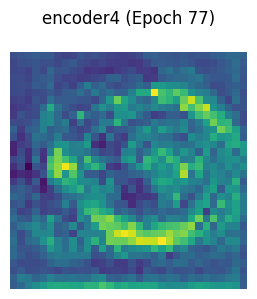

encoder5: torch.Size([3, 48, 16, 16])


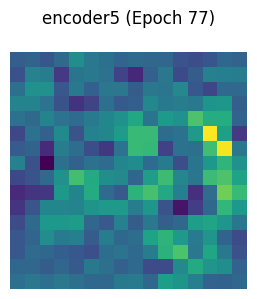

encoder6: torch.Size([3, 64, 8, 8])


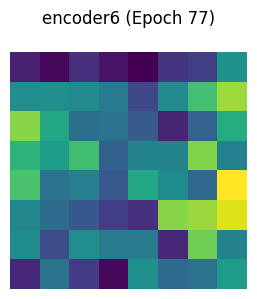

decoder1: torch.Size([3, 48, 8, 8])


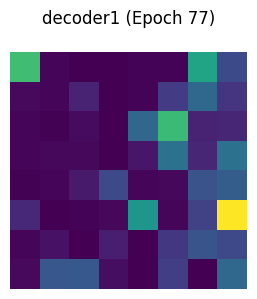

decoder2: torch.Size([3, 32, 8, 8])


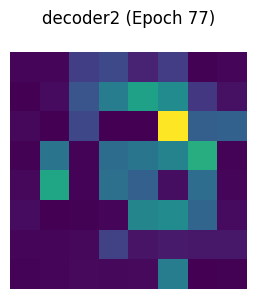

decoder3: torch.Size([3, 24, 16, 16])


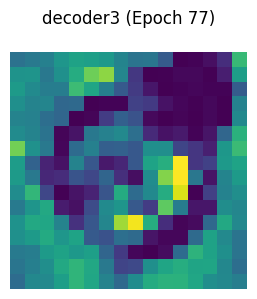

decoder4: torch.Size([3, 16, 32, 32])


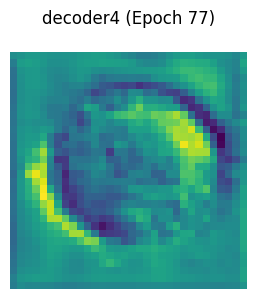

decoder5: torch.Size([3, 8, 64, 64])


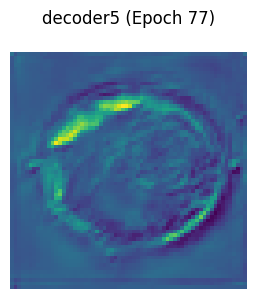

Epoch 77: Loss = 95.1602, Val Dice = 0.7723, Val mIoU = 0.6303, Val Accuracy = 0.9518, Val Sensitivity = 0.7548, Val Specificity = 0.9760


Epoch 78/100: 100%|██████████| 125/125 [02:12<00:00,  1.06s/it]


[Epoch 78] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


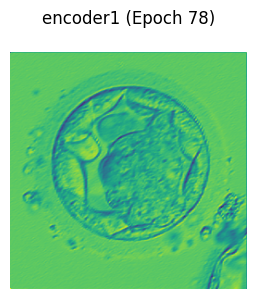

encoder2: torch.Size([3, 16, 128, 128])


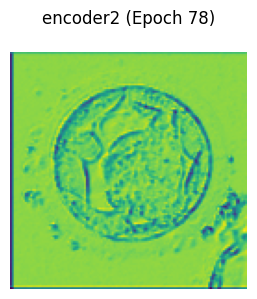

encoder3: torch.Size([3, 24, 64, 64])


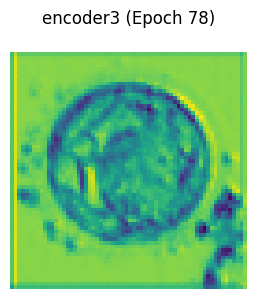

encoder4: torch.Size([3, 32, 32, 32])


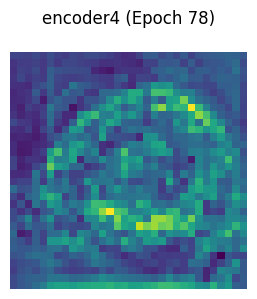

encoder5: torch.Size([3, 48, 16, 16])


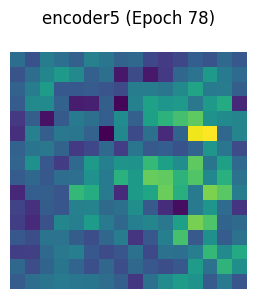

encoder6: torch.Size([3, 64, 8, 8])


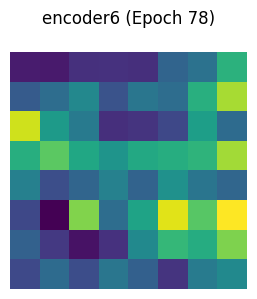

decoder1: torch.Size([3, 48, 8, 8])


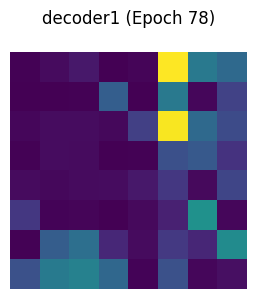

decoder2: torch.Size([3, 32, 8, 8])


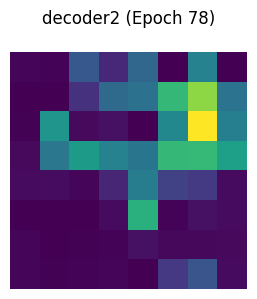

decoder3: torch.Size([3, 24, 16, 16])


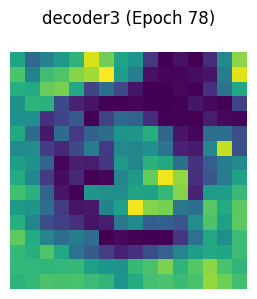

decoder4: torch.Size([3, 16, 32, 32])


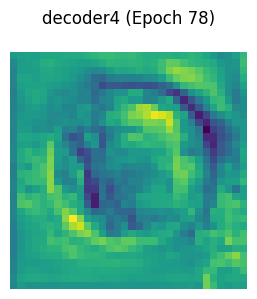

decoder5: torch.Size([3, 8, 64, 64])


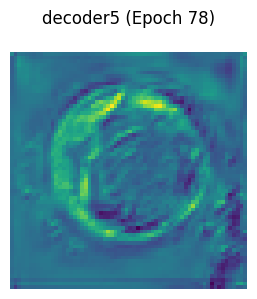

Epoch 78: Loss = 95.0053, Val Dice = 0.7876, Val mIoU = 0.6511, Val Accuracy = 0.9520, Val Sensitivity = 0.8193, Val Specificity = 0.9684


Epoch 79/100: 100%|██████████| 125/125 [02:12<00:00,  1.06s/it]


[Epoch 79] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


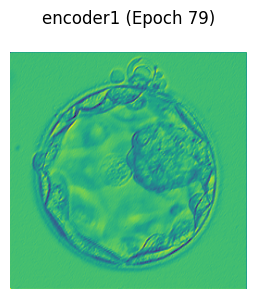

encoder2: torch.Size([3, 16, 128, 128])


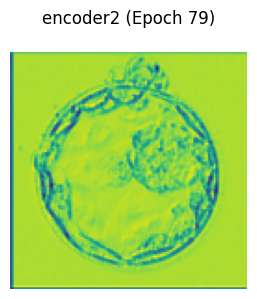

encoder3: torch.Size([3, 24, 64, 64])


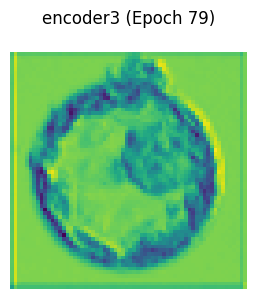

encoder4: torch.Size([3, 32, 32, 32])


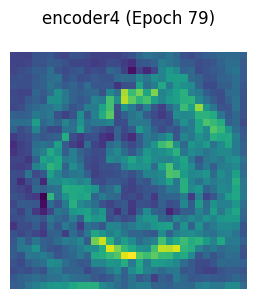

encoder5: torch.Size([3, 48, 16, 16])


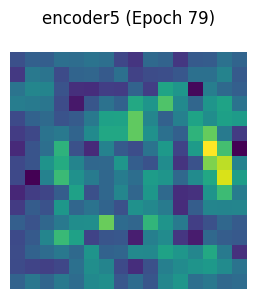

encoder6: torch.Size([3, 64, 8, 8])


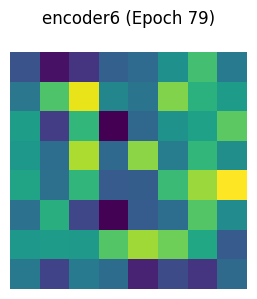

decoder1: torch.Size([3, 48, 8, 8])


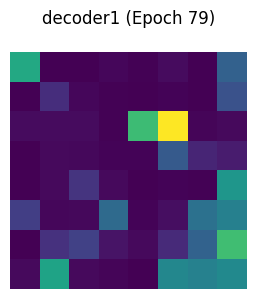

decoder2: torch.Size([3, 32, 8, 8])


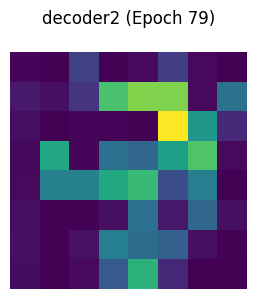

decoder3: torch.Size([3, 24, 16, 16])


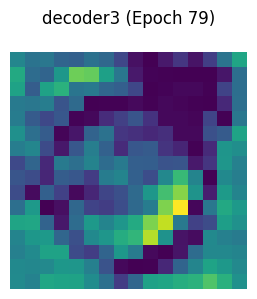

decoder4: torch.Size([3, 16, 32, 32])


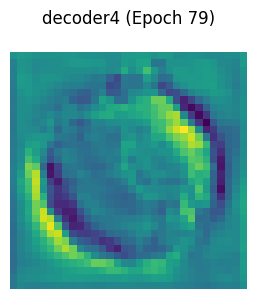

decoder5: torch.Size([3, 8, 64, 64])


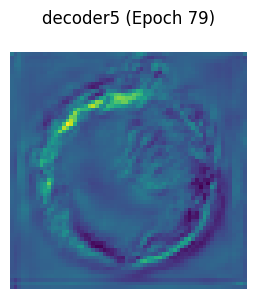

Epoch 79: Loss = 95.3687, Val Dice = 0.7777, Val mIoU = 0.6373, Val Accuracy = 0.9513, Val Sensitivity = 0.7867, Val Specificity = 0.9716


Epoch 80/100: 100%|██████████| 125/125 [02:12<00:00,  1.06s/it]


[Epoch 80] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


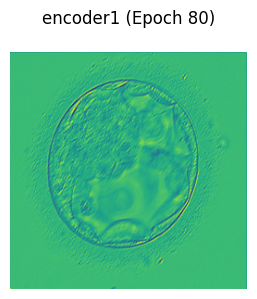

encoder2: torch.Size([3, 16, 128, 128])


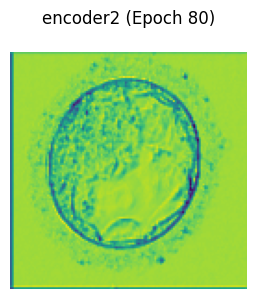

encoder3: torch.Size([3, 24, 64, 64])


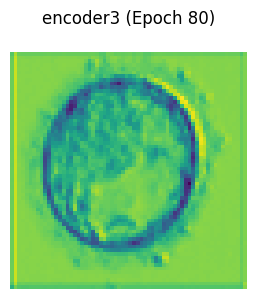

encoder4: torch.Size([3, 32, 32, 32])


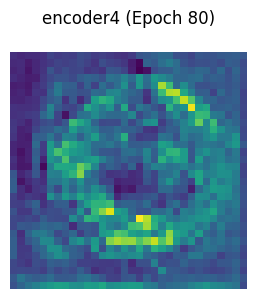

encoder5: torch.Size([3, 48, 16, 16])


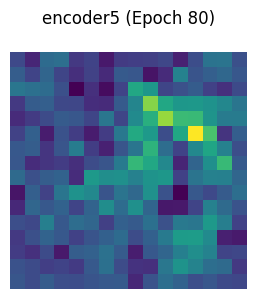

encoder6: torch.Size([3, 64, 8, 8])


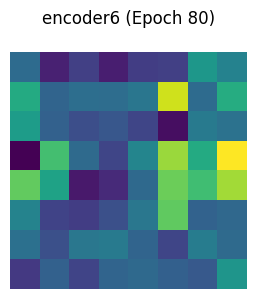

decoder1: torch.Size([3, 48, 8, 8])


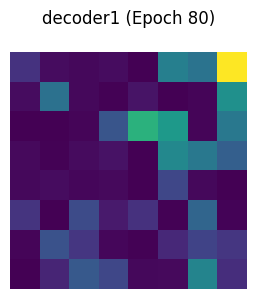

decoder2: torch.Size([3, 32, 8, 8])


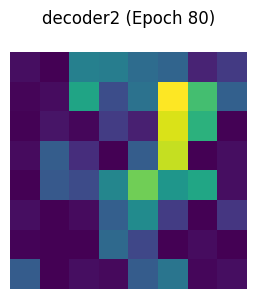

decoder3: torch.Size([3, 24, 16, 16])


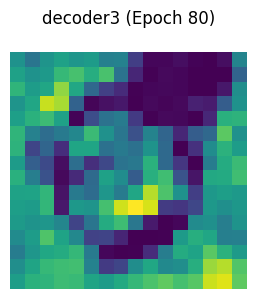

decoder4: torch.Size([3, 16, 32, 32])


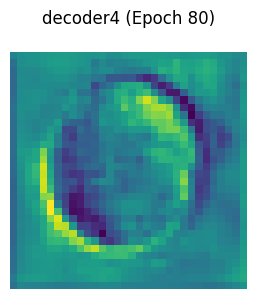

decoder5: torch.Size([3, 8, 64, 64])


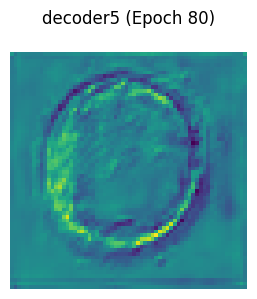

Epoch 80: Loss = 95.7747, Val Dice = 0.7713, Val mIoU = 0.6293, Val Accuracy = 0.9508, Val Sensitivity = 0.7618, Val Specificity = 0.9739


Epoch 81/100: 100%|██████████| 125/125 [02:13<00:00,  1.07s/it]


[Epoch 81] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


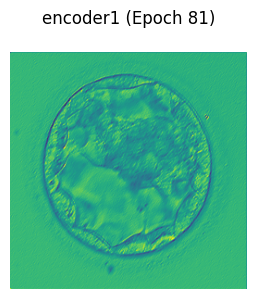

encoder2: torch.Size([3, 16, 128, 128])


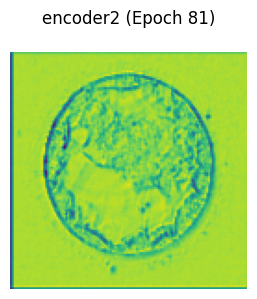

encoder3: torch.Size([3, 24, 64, 64])


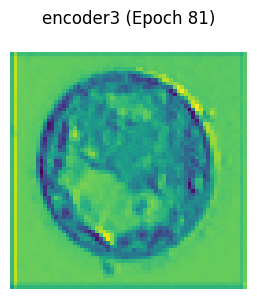

encoder4: torch.Size([3, 32, 32, 32])


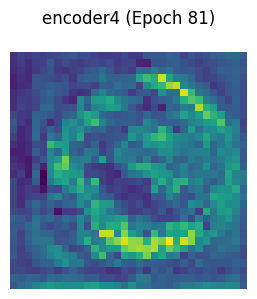

encoder5: torch.Size([3, 48, 16, 16])


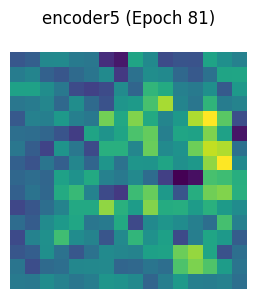

encoder6: torch.Size([3, 64, 8, 8])


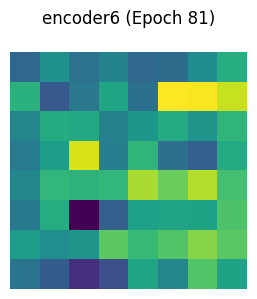

decoder1: torch.Size([3, 48, 8, 8])


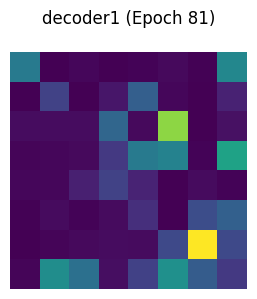

decoder2: torch.Size([3, 32, 8, 8])


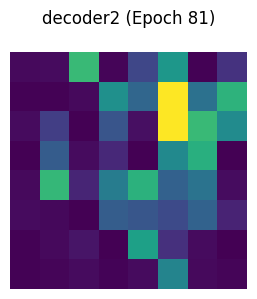

decoder3: torch.Size([3, 24, 16, 16])


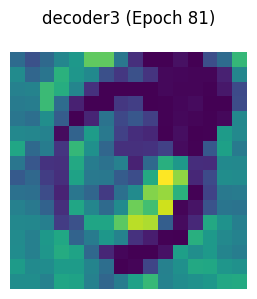

decoder4: torch.Size([3, 16, 32, 32])


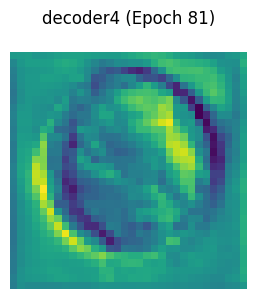

decoder5: torch.Size([3, 8, 64, 64])


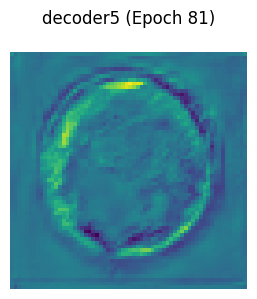

Epoch 81: Loss = 95.8553, Val Dice = 0.7848, Val mIoU = 0.6465, Val Accuracy = 0.9537, Val Sensitivity = 0.7823, Val Specificity = 0.9746


Epoch 82/100: 100%|██████████| 125/125 [02:13<00:00,  1.07s/it]


[Epoch 82] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


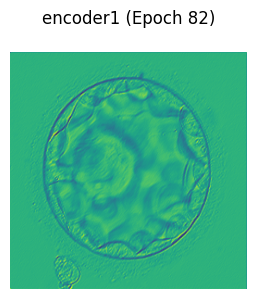

encoder2: torch.Size([3, 16, 128, 128])


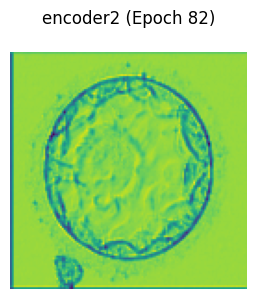

encoder3: torch.Size([3, 24, 64, 64])


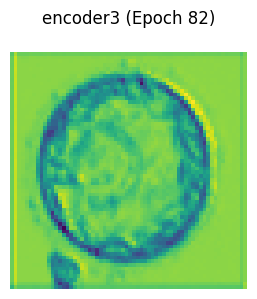

encoder4: torch.Size([3, 32, 32, 32])


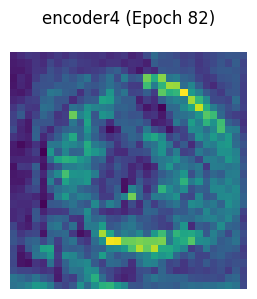

encoder5: torch.Size([3, 48, 16, 16])


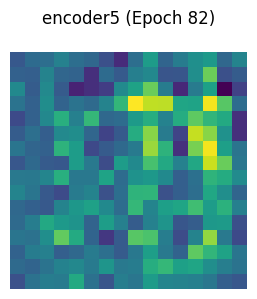

encoder6: torch.Size([3, 64, 8, 8])


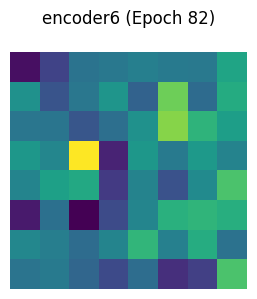

decoder1: torch.Size([3, 48, 8, 8])


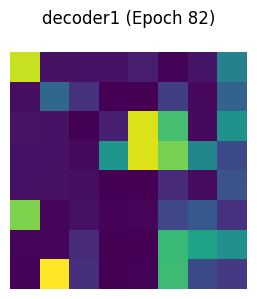

decoder2: torch.Size([3, 32, 8, 8])


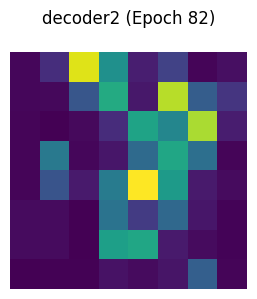

decoder3: torch.Size([3, 24, 16, 16])


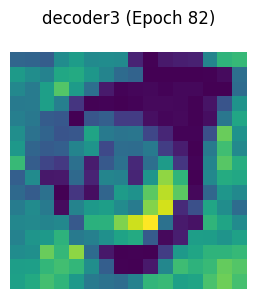

decoder4: torch.Size([3, 16, 32, 32])


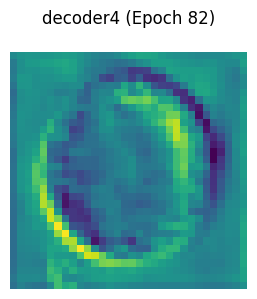

decoder5: torch.Size([3, 8, 64, 64])


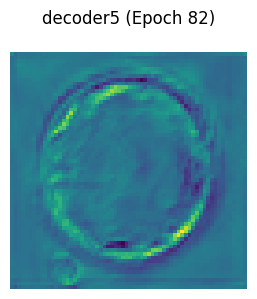

Epoch 82: Loss = 95.9107, Val Dice = 0.7754, Val mIoU = 0.6339, Val Accuracy = 0.9524, Val Sensitivity = 0.7581, Val Specificity = 0.9761


Epoch 83/100: 100%|██████████| 125/125 [02:14<00:00,  1.08s/it]


[Epoch 83] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


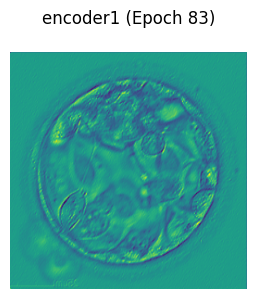

encoder2: torch.Size([3, 16, 128, 128])


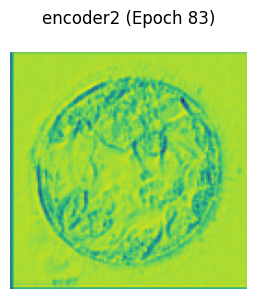

encoder3: torch.Size([3, 24, 64, 64])


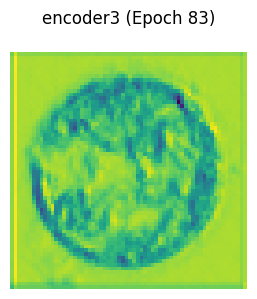

encoder4: torch.Size([3, 32, 32, 32])


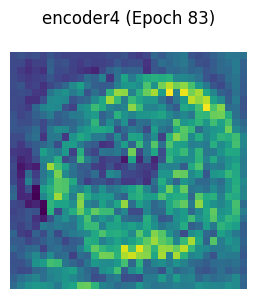

encoder5: torch.Size([3, 48, 16, 16])


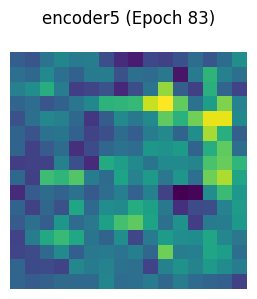

encoder6: torch.Size([3, 64, 8, 8])


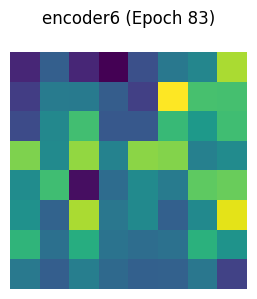

decoder1: torch.Size([3, 48, 8, 8])


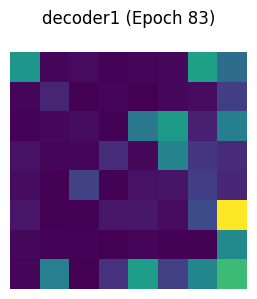

decoder2: torch.Size([3, 32, 8, 8])


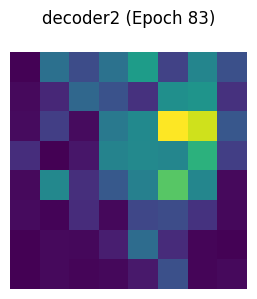

decoder3: torch.Size([3, 24, 16, 16])


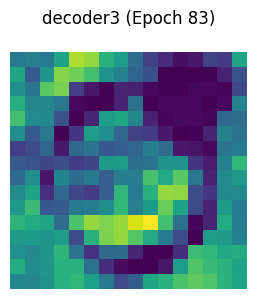

decoder4: torch.Size([3, 16, 32, 32])


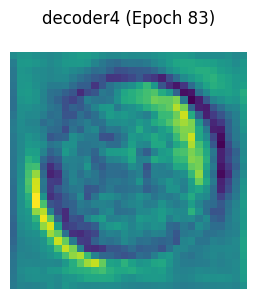

decoder5: torch.Size([3, 8, 64, 64])


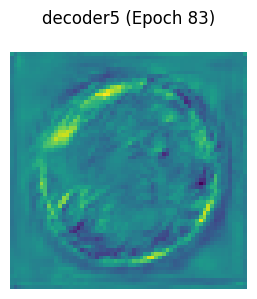

Epoch 83: Loss = 95.9857, Val Dice = 0.7838, Val mIoU = 0.6455, Val Accuracy = 0.9525, Val Sensitivity = 0.7956, Val Specificity = 0.9719


Epoch 84/100: 100%|██████████| 125/125 [02:15<00:00,  1.08s/it]


[Epoch 84] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


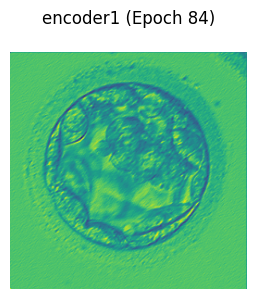

encoder2: torch.Size([3, 16, 128, 128])


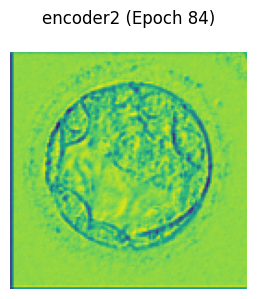

encoder3: torch.Size([3, 24, 64, 64])


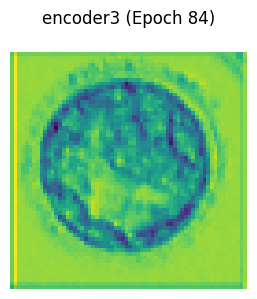

encoder4: torch.Size([3, 32, 32, 32])


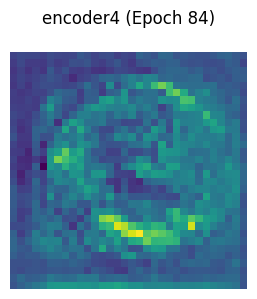

encoder5: torch.Size([3, 48, 16, 16])


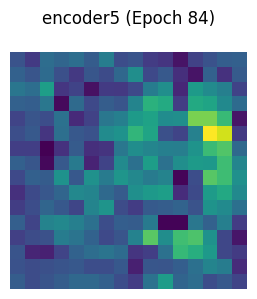

encoder6: torch.Size([3, 64, 8, 8])


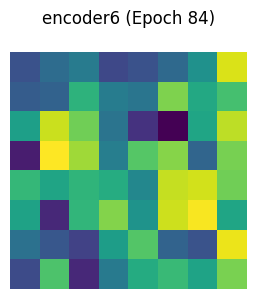

decoder1: torch.Size([3, 48, 8, 8])


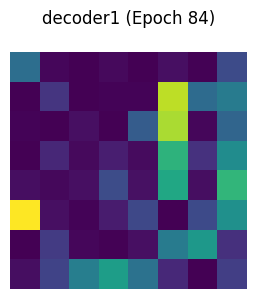

decoder2: torch.Size([3, 32, 8, 8])


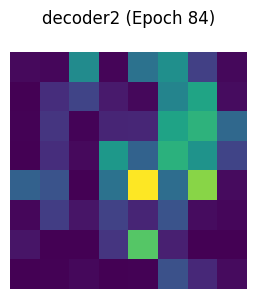

decoder3: torch.Size([3, 24, 16, 16])


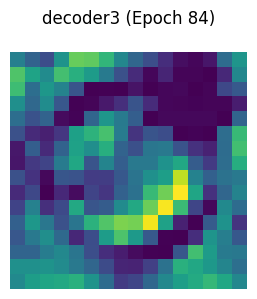

decoder4: torch.Size([3, 16, 32, 32])


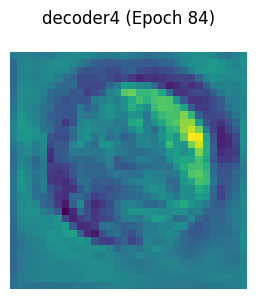

decoder5: torch.Size([3, 8, 64, 64])


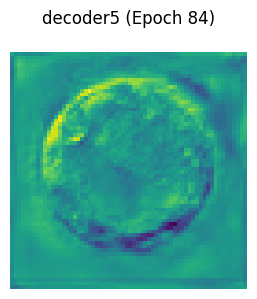

Epoch 84: Loss = 96.0875, Val Dice = 0.7844, Val mIoU = 0.6466, Val Accuracy = 0.9518, Val Sensitivity = 0.8059, Val Specificity = 0.9699


Epoch 85/100: 100%|██████████| 125/125 [02:15<00:00,  1.08s/it]


[Epoch 85] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


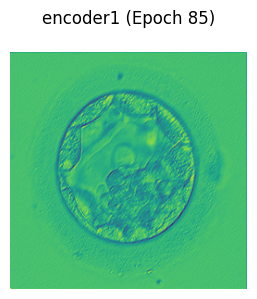

encoder2: torch.Size([3, 16, 128, 128])


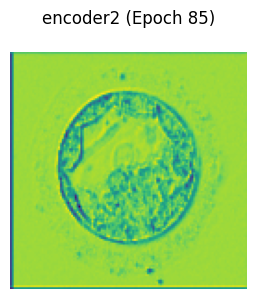

encoder3: torch.Size([3, 24, 64, 64])


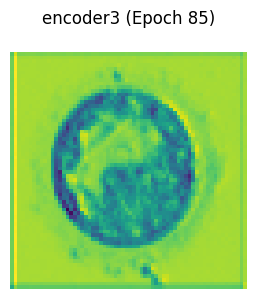

encoder4: torch.Size([3, 32, 32, 32])


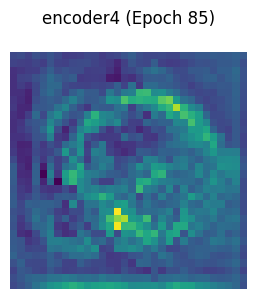

encoder5: torch.Size([3, 48, 16, 16])


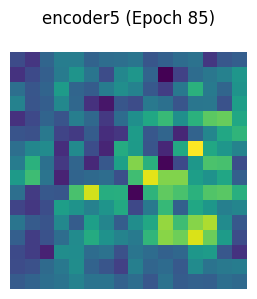

encoder6: torch.Size([3, 64, 8, 8])


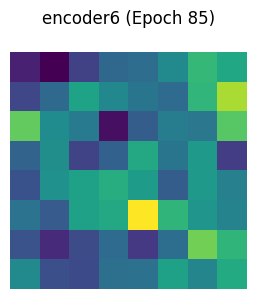

decoder1: torch.Size([3, 48, 8, 8])


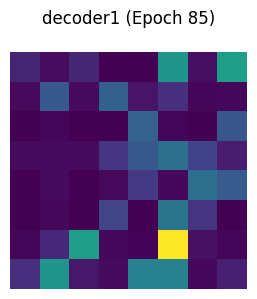

decoder2: torch.Size([3, 32, 8, 8])


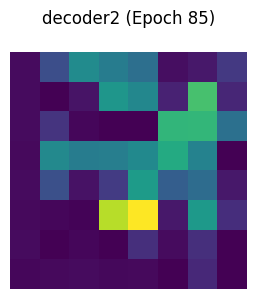

decoder3: torch.Size([3, 24, 16, 16])


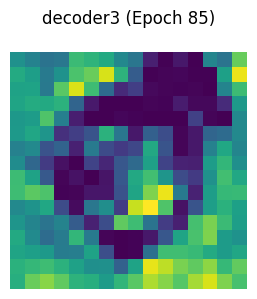

decoder4: torch.Size([3, 16, 32, 32])


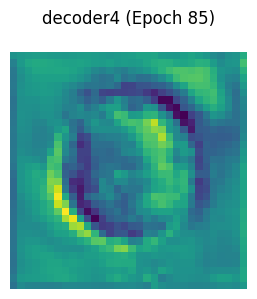

decoder5: torch.Size([3, 8, 64, 64])


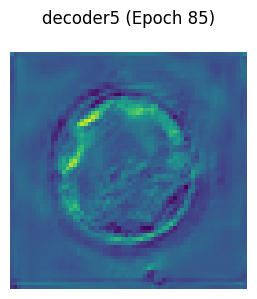

Epoch 85: Loss = 96.8082, Val Dice = 0.7713, Val mIoU = 0.6282, Val Accuracy = 0.9512, Val Sensitivity = 0.7605, Val Specificity = 0.9745


Epoch 86/100: 100%|██████████| 125/125 [02:14<00:00,  1.07s/it]


[Epoch 86] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


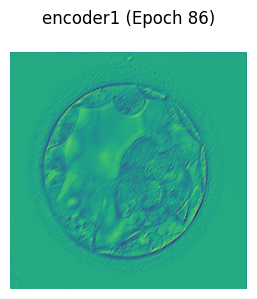

encoder2: torch.Size([3, 16, 128, 128])


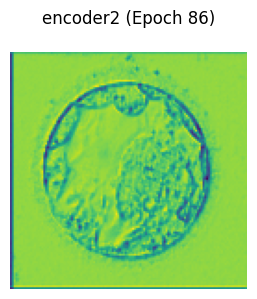

encoder3: torch.Size([3, 24, 64, 64])


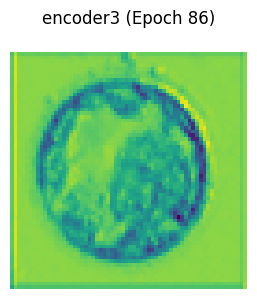

encoder4: torch.Size([3, 32, 32, 32])


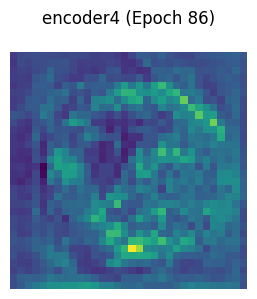

encoder5: torch.Size([3, 48, 16, 16])


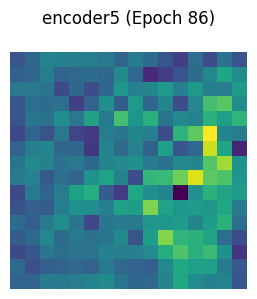

encoder6: torch.Size([3, 64, 8, 8])


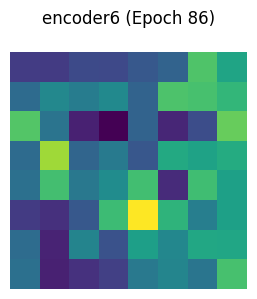

decoder1: torch.Size([3, 48, 8, 8])


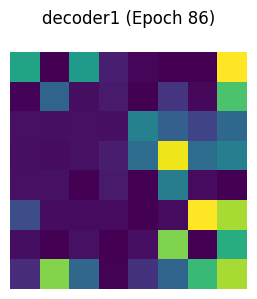

decoder2: torch.Size([3, 32, 8, 8])


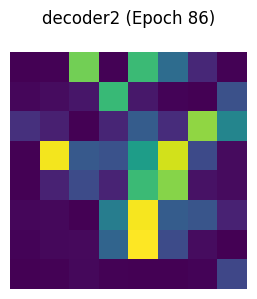

decoder3: torch.Size([3, 24, 16, 16])


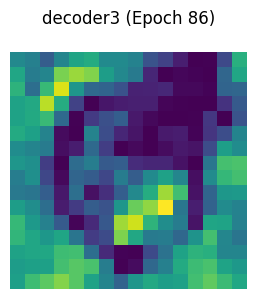

decoder4: torch.Size([3, 16, 32, 32])


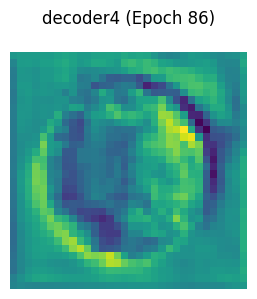

decoder5: torch.Size([3, 8, 64, 64])


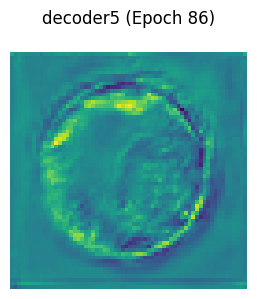

Epoch 86: Loss = 96.3493, Val Dice = 0.7698, Val mIoU = 0.6268, Val Accuracy = 0.9510, Val Sensitivity = 0.7546, Val Specificity = 0.9751


Epoch 87/100: 100%|██████████| 125/125 [02:16<00:00,  1.09s/it]


[Epoch 87] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


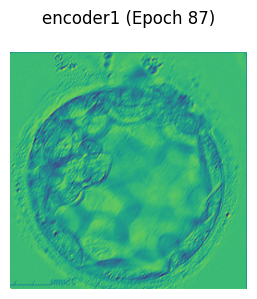

encoder2: torch.Size([3, 16, 128, 128])


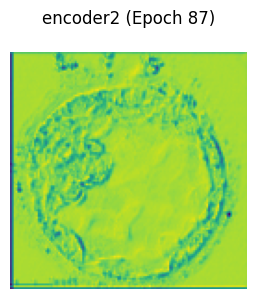

encoder3: torch.Size([3, 24, 64, 64])


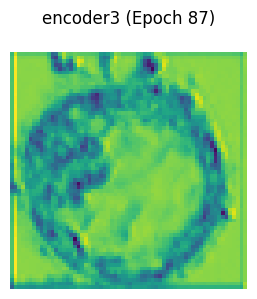

encoder4: torch.Size([3, 32, 32, 32])


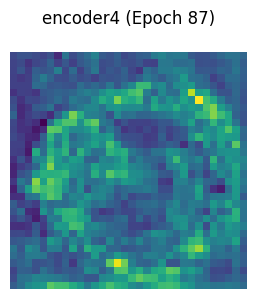

encoder5: torch.Size([3, 48, 16, 16])


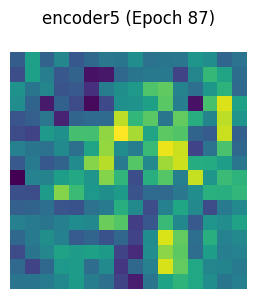

encoder6: torch.Size([3, 64, 8, 8])


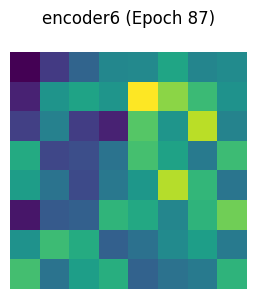

decoder1: torch.Size([3, 48, 8, 8])


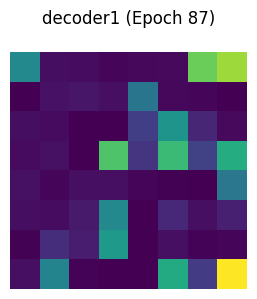

decoder2: torch.Size([3, 32, 8, 8])


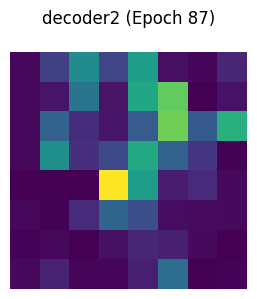

decoder3: torch.Size([3, 24, 16, 16])


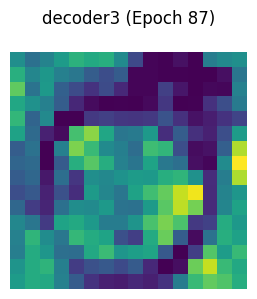

decoder4: torch.Size([3, 16, 32, 32])


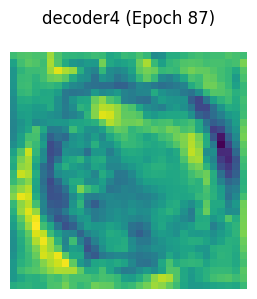

decoder5: torch.Size([3, 8, 64, 64])


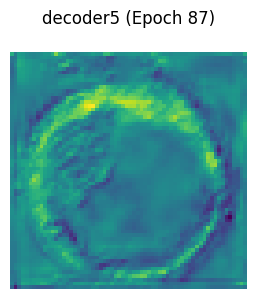

Epoch 87: Loss = 96.2880, Val Dice = 0.7819, Val mIoU = 0.6427, Val Accuracy = 0.9525, Val Sensitivity = 0.7843, Val Specificity = 0.9732


Epoch 88/100: 100%|██████████| 125/125 [02:16<00:00,  1.09s/it]


[Epoch 88] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


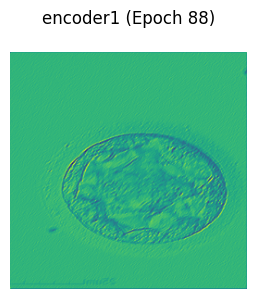

encoder2: torch.Size([3, 16, 128, 128])


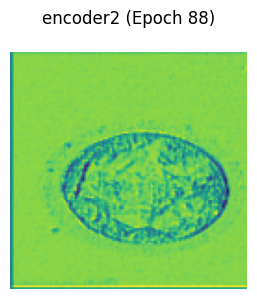

encoder3: torch.Size([3, 24, 64, 64])


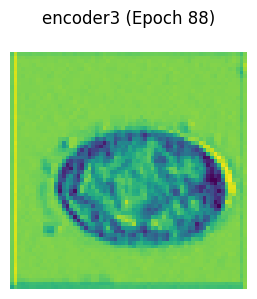

encoder4: torch.Size([3, 32, 32, 32])


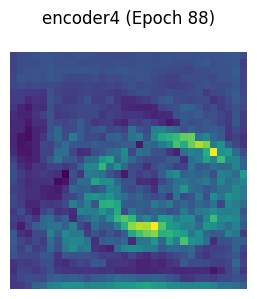

encoder5: torch.Size([3, 48, 16, 16])


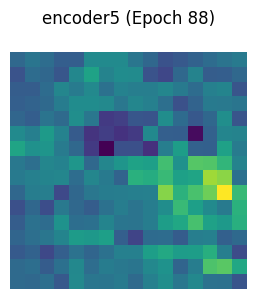

encoder6: torch.Size([3, 64, 8, 8])


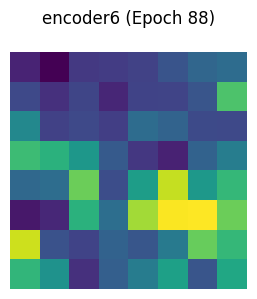

decoder1: torch.Size([3, 48, 8, 8])


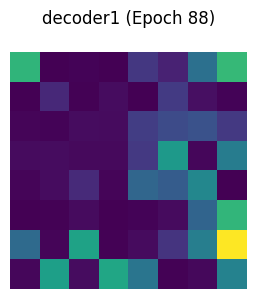

decoder2: torch.Size([3, 32, 8, 8])


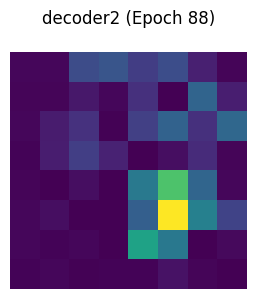

decoder3: torch.Size([3, 24, 16, 16])


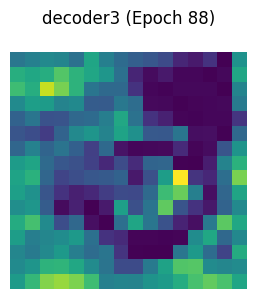

decoder4: torch.Size([3, 16, 32, 32])


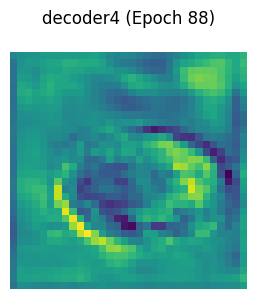

decoder5: torch.Size([3, 8, 64, 64])


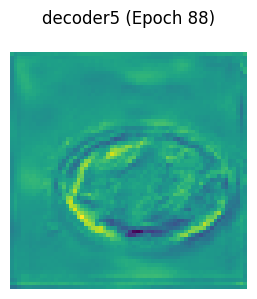

Epoch 88: Loss = 96.4130, Val Dice = 0.7798, Val mIoU = 0.6397, Val Accuracy = 0.9527, Val Sensitivity = 0.7715, Val Specificity = 0.9749


Epoch 89/100: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


[Epoch 89] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


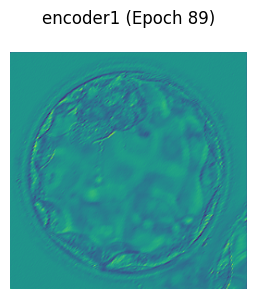

encoder2: torch.Size([3, 16, 128, 128])


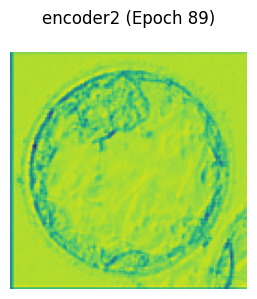

encoder3: torch.Size([3, 24, 64, 64])


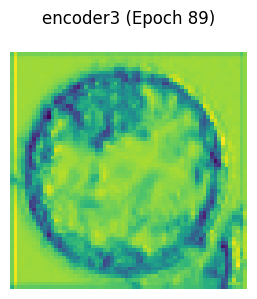

encoder4: torch.Size([3, 32, 32, 32])


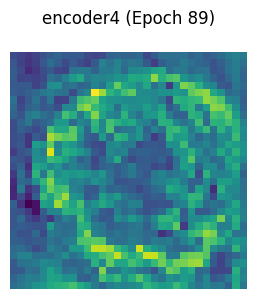

encoder5: torch.Size([3, 48, 16, 16])


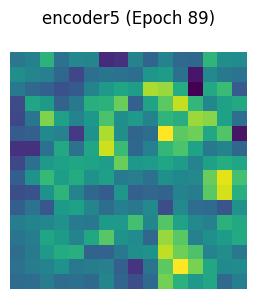

encoder6: torch.Size([3, 64, 8, 8])


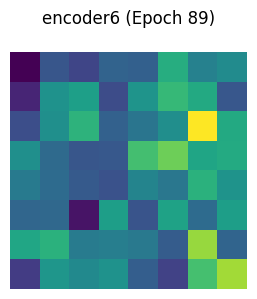

decoder1: torch.Size([3, 48, 8, 8])


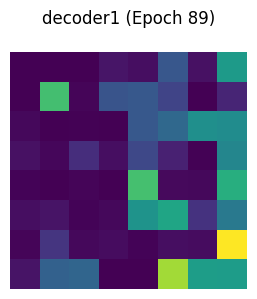

decoder2: torch.Size([3, 32, 8, 8])


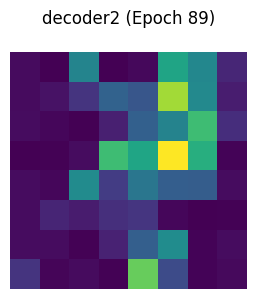

decoder3: torch.Size([3, 24, 16, 16])


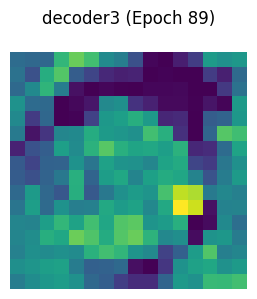

decoder4: torch.Size([3, 16, 32, 32])


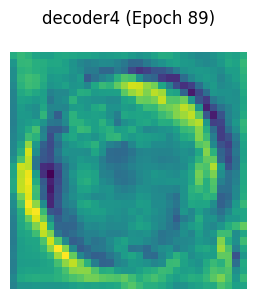

decoder5: torch.Size([3, 8, 64, 64])


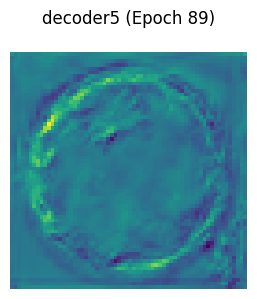

Epoch 89: Loss = 96.5457, Val Dice = 0.7781, Val mIoU = 0.6378, Val Accuracy = 0.9523, Val Sensitivity = 0.7710, Val Specificity = 0.9746


Epoch 90/100: 100%|██████████| 125/125 [02:16<00:00,  1.10s/it]


[Epoch 90] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


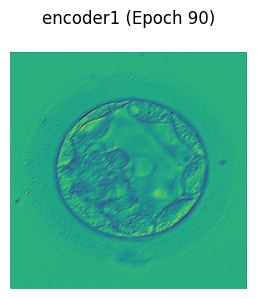

encoder2: torch.Size([3, 16, 128, 128])


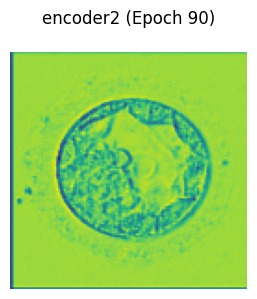

encoder3: torch.Size([3, 24, 64, 64])


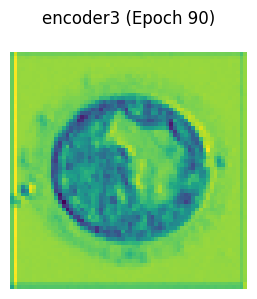

encoder4: torch.Size([3, 32, 32, 32])


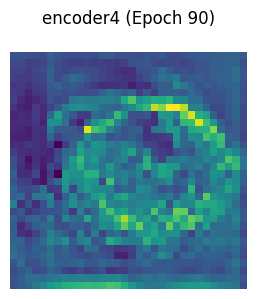

encoder5: torch.Size([3, 48, 16, 16])


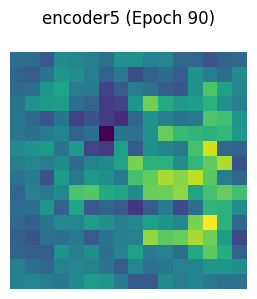

encoder6: torch.Size([3, 64, 8, 8])


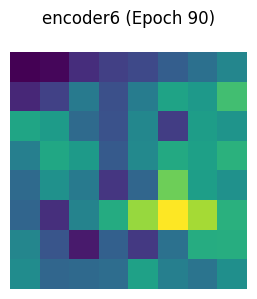

decoder1: torch.Size([3, 48, 8, 8])


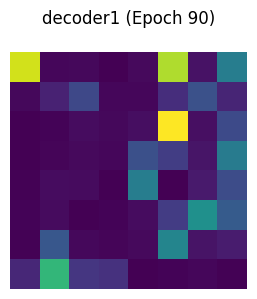

decoder2: torch.Size([3, 32, 8, 8])


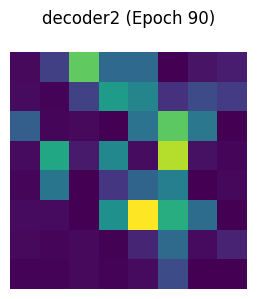

decoder3: torch.Size([3, 24, 16, 16])


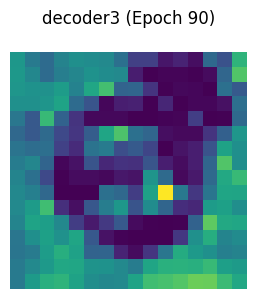

decoder4: torch.Size([3, 16, 32, 32])


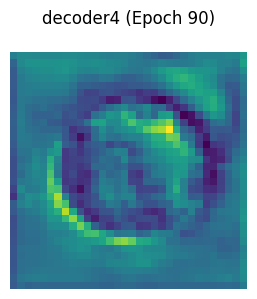

decoder5: torch.Size([3, 8, 64, 64])


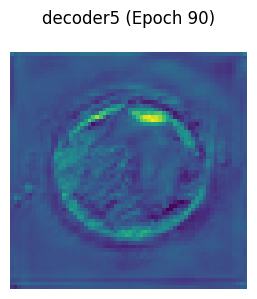

Epoch 90: Loss = 96.3734, Val Dice = 0.7679, Val mIoU = 0.6243, Val Accuracy = 0.9511, Val Sensitivity = 0.7450, Val Specificity = 0.9764


Epoch 91/100: 100%|██████████| 125/125 [02:19<00:00,  1.12s/it]


[Epoch 91] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


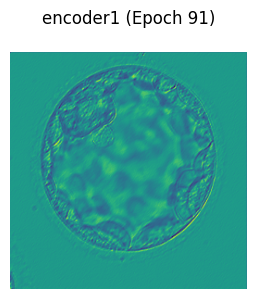

encoder2: torch.Size([3, 16, 128, 128])


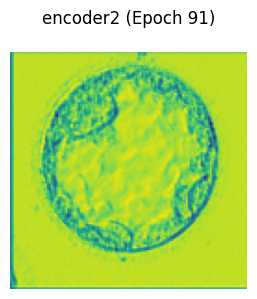

encoder3: torch.Size([3, 24, 64, 64])


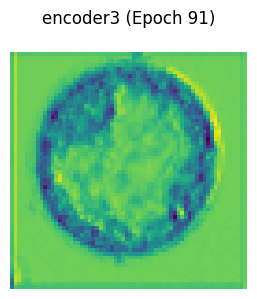

encoder4: torch.Size([3, 32, 32, 32])


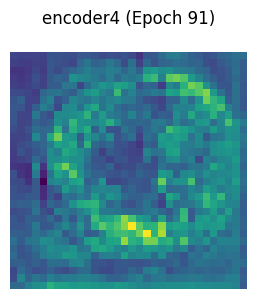

encoder5: torch.Size([3, 48, 16, 16])


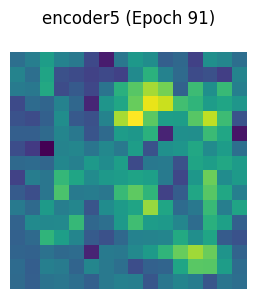

encoder6: torch.Size([3, 64, 8, 8])


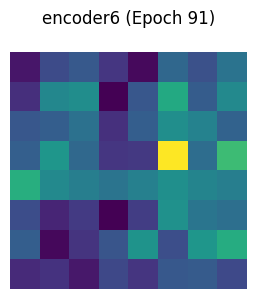

decoder1: torch.Size([3, 48, 8, 8])


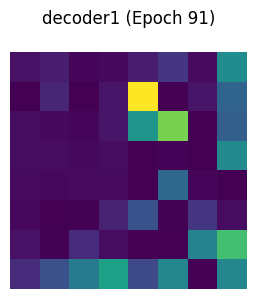

decoder2: torch.Size([3, 32, 8, 8])


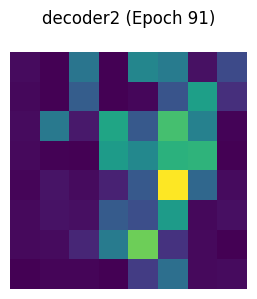

decoder3: torch.Size([3, 24, 16, 16])


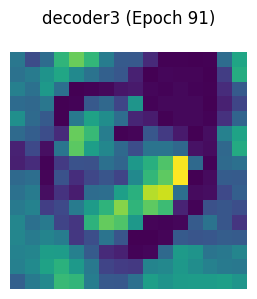

decoder4: torch.Size([3, 16, 32, 32])


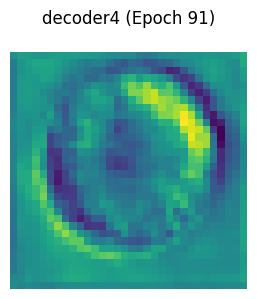

decoder5: torch.Size([3, 8, 64, 64])


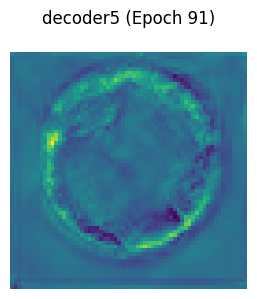

Epoch 91: Loss = 96.2066, Val Dice = 0.7819, Val mIoU = 0.6424, Val Accuracy = 0.9528, Val Sensitivity = 0.7845, Val Specificity = 0.9734


Epoch 92/100: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


[Epoch 92] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


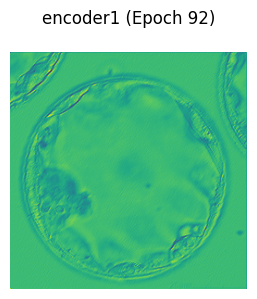

encoder2: torch.Size([3, 16, 128, 128])


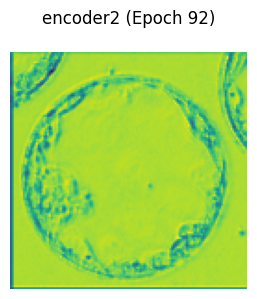

encoder3: torch.Size([3, 24, 64, 64])


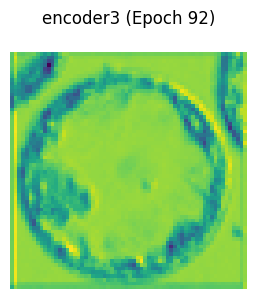

encoder4: torch.Size([3, 32, 32, 32])


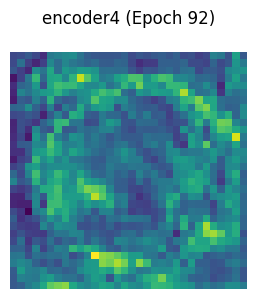

encoder5: torch.Size([3, 48, 16, 16])


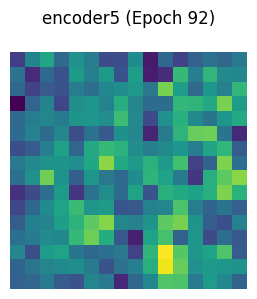

encoder6: torch.Size([3, 64, 8, 8])


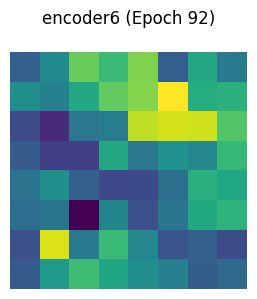

decoder1: torch.Size([3, 48, 8, 8])


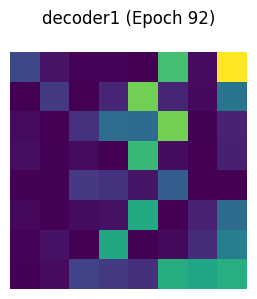

decoder2: torch.Size([3, 32, 8, 8])


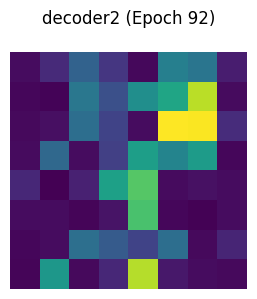

decoder3: torch.Size([3, 24, 16, 16])


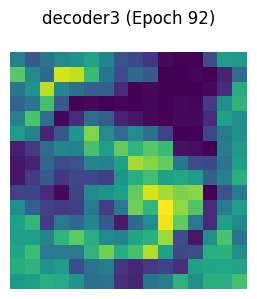

decoder4: torch.Size([3, 16, 32, 32])


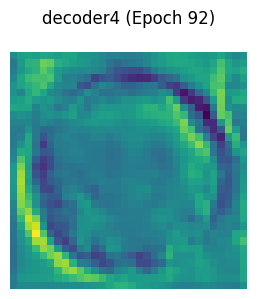

decoder5: torch.Size([3, 8, 64, 64])


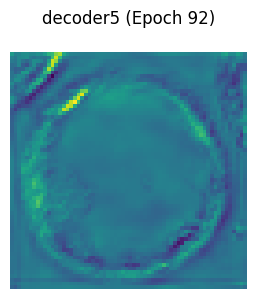

Epoch 92: Loss = 96.1785, Val Dice = 0.7778, Val mIoU = 0.6369, Val Accuracy = 0.9522, Val Sensitivity = 0.7749, Val Specificity = 0.9738


Epoch 93/100: 100%|██████████| 125/125 [02:20<00:00,  1.12s/it]


[Epoch 93] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


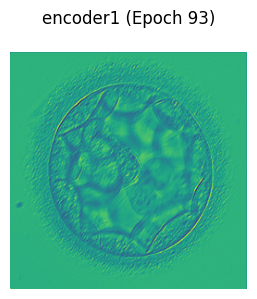

encoder2: torch.Size([3, 16, 128, 128])


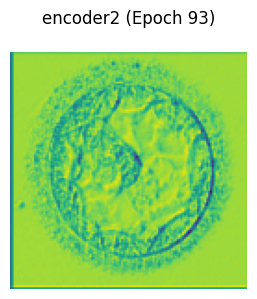

encoder3: torch.Size([3, 24, 64, 64])


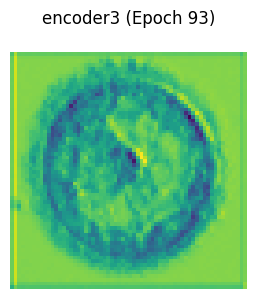

encoder4: torch.Size([3, 32, 32, 32])


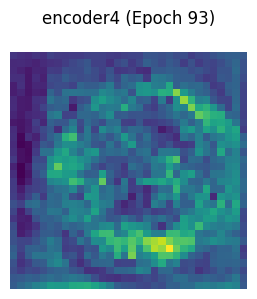

encoder5: torch.Size([3, 48, 16, 16])


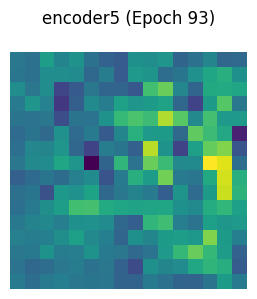

encoder6: torch.Size([3, 64, 8, 8])


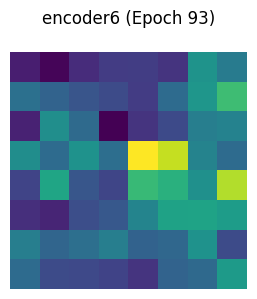

decoder1: torch.Size([3, 48, 8, 8])


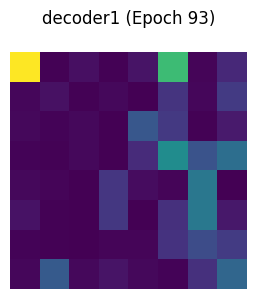

decoder2: torch.Size([3, 32, 8, 8])


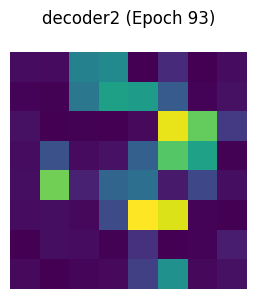

decoder3: torch.Size([3, 24, 16, 16])


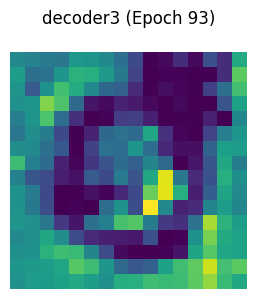

decoder4: torch.Size([3, 16, 32, 32])


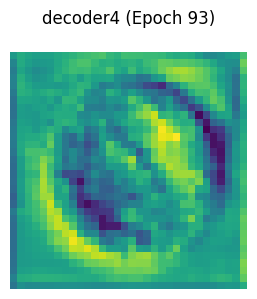

decoder5: torch.Size([3, 8, 64, 64])


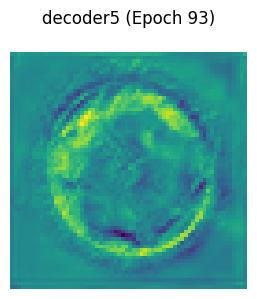

Epoch 93: Loss = 96.2898, Val Dice = 0.7853, Val mIoU = 0.6468, Val Accuracy = 0.9524, Val Sensitivity = 0.8062, Val Specificity = 0.9701


Epoch 94/100: 100%|██████████| 125/125 [02:18<00:00,  1.11s/it]


[Epoch 94] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


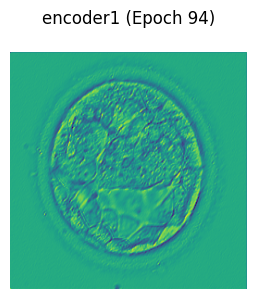

encoder2: torch.Size([3, 16, 128, 128])


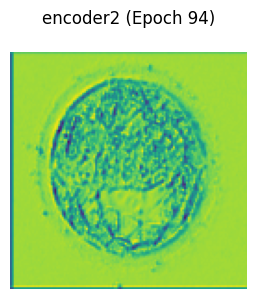

encoder3: torch.Size([3, 24, 64, 64])


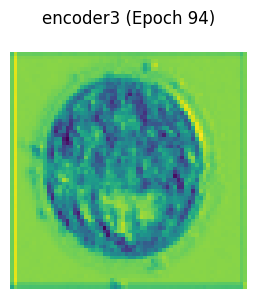

encoder4: torch.Size([3, 32, 32, 32])


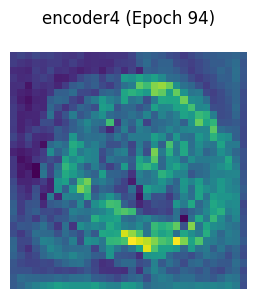

encoder5: torch.Size([3, 48, 16, 16])


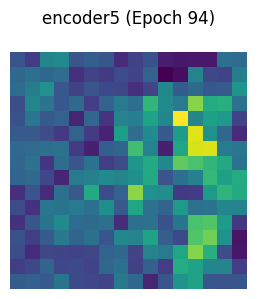

encoder6: torch.Size([3, 64, 8, 8])


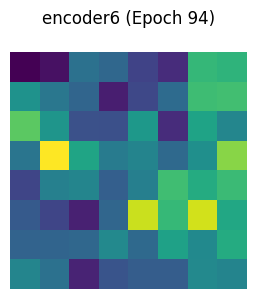

decoder1: torch.Size([3, 48, 8, 8])


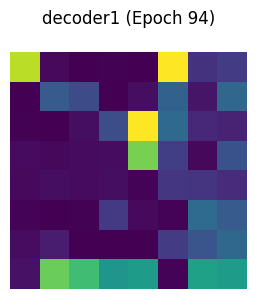

decoder2: torch.Size([3, 32, 8, 8])


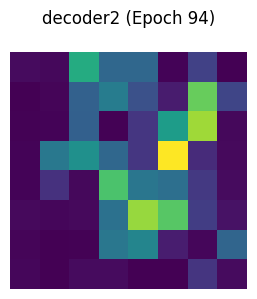

decoder3: torch.Size([3, 24, 16, 16])


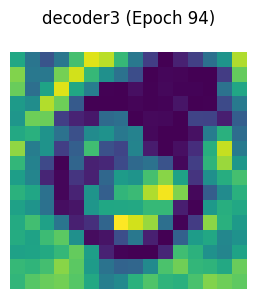

decoder4: torch.Size([3, 16, 32, 32])


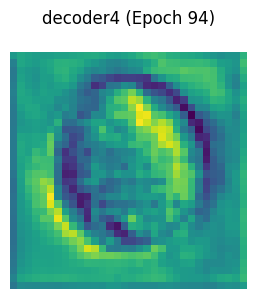

decoder5: torch.Size([3, 8, 64, 64])


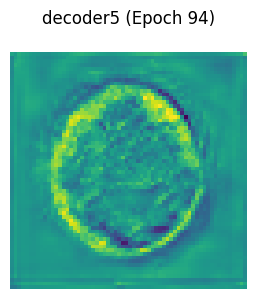

Epoch 94: Loss = 96.4688, Val Dice = 0.7879, Val mIoU = 0.6506, Val Accuracy = 0.9540, Val Sensitivity = 0.7900, Val Specificity = 0.9741


Epoch 95/100: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


[Epoch 95] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


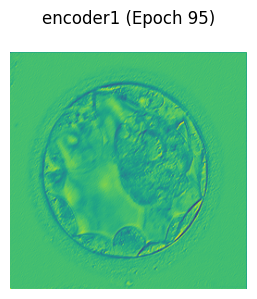

encoder2: torch.Size([3, 16, 128, 128])


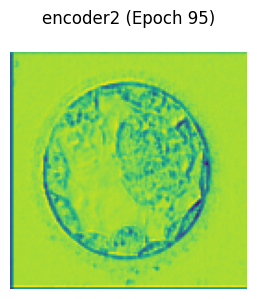

encoder3: torch.Size([3, 24, 64, 64])


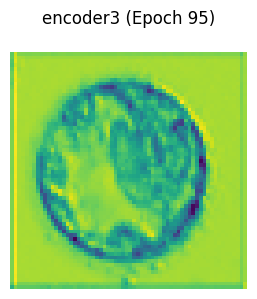

encoder4: torch.Size([3, 32, 32, 32])


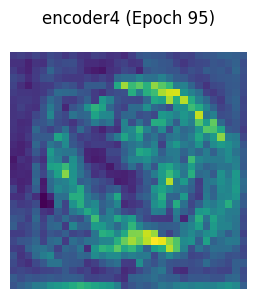

encoder5: torch.Size([3, 48, 16, 16])


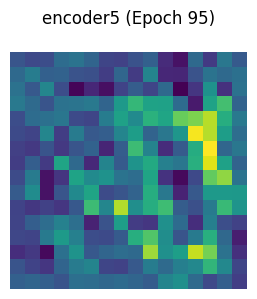

encoder6: torch.Size([3, 64, 8, 8])


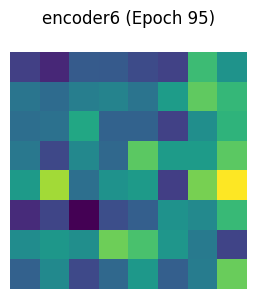

decoder1: torch.Size([3, 48, 8, 8])


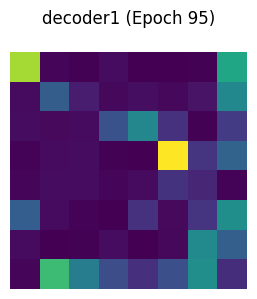

decoder2: torch.Size([3, 32, 8, 8])


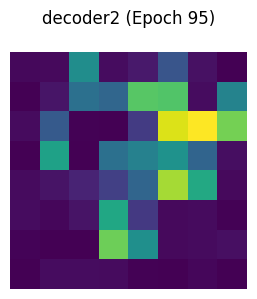

decoder3: torch.Size([3, 24, 16, 16])


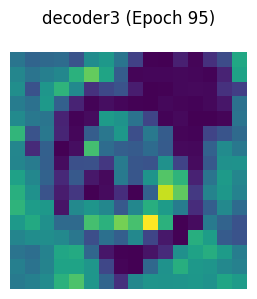

decoder4: torch.Size([3, 16, 32, 32])


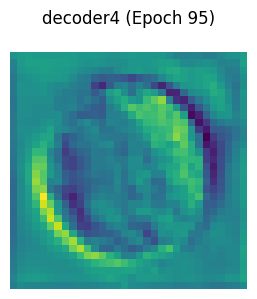

decoder5: torch.Size([3, 8, 64, 64])


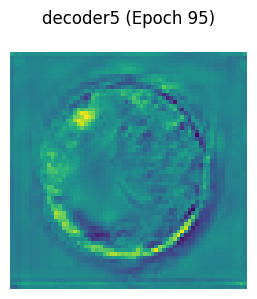

Epoch 95: Loss = 96.3497, Val Dice = 0.7752, Val mIoU = 0.6331, Val Accuracy = 0.9521, Val Sensitivity = 0.7627, Val Specificity = 0.9751


Epoch 96/100: 100%|██████████| 125/125 [02:16<00:00,  1.09s/it]


[Epoch 96] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


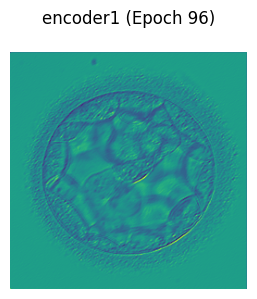

encoder2: torch.Size([3, 16, 128, 128])


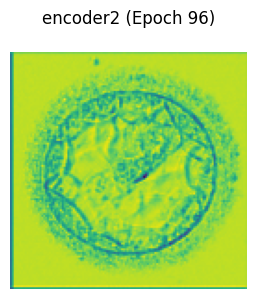

encoder3: torch.Size([3, 24, 64, 64])


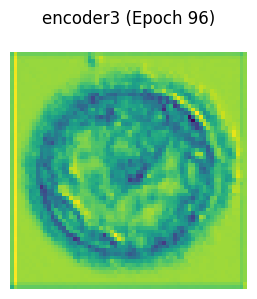

encoder4: torch.Size([3, 32, 32, 32])


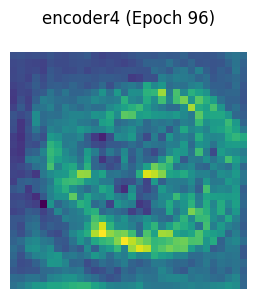

encoder5: torch.Size([3, 48, 16, 16])


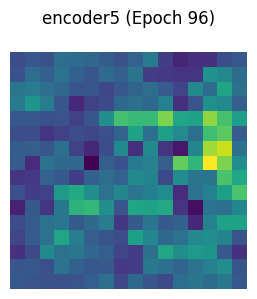

encoder6: torch.Size([3, 64, 8, 8])


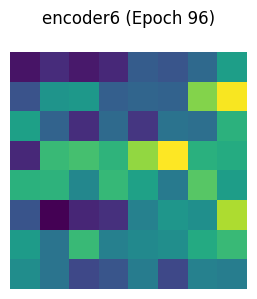

decoder1: torch.Size([3, 48, 8, 8])


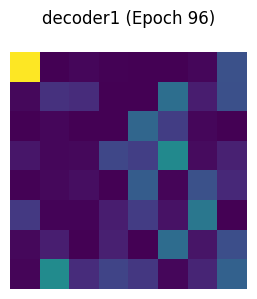

decoder2: torch.Size([3, 32, 8, 8])


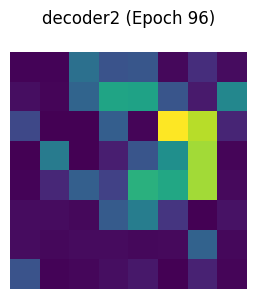

decoder3: torch.Size([3, 24, 16, 16])


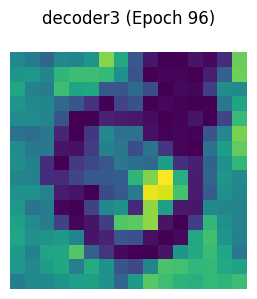

decoder4: torch.Size([3, 16, 32, 32])


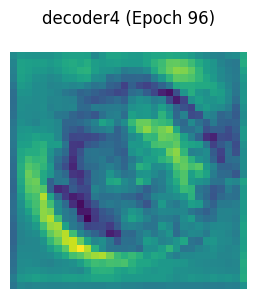

decoder5: torch.Size([3, 8, 64, 64])


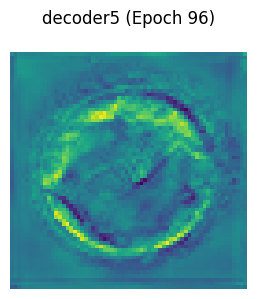

Epoch 96: Loss = 96.6876, Val Dice = 0.7689, Val mIoU = 0.6247, Val Accuracy = 0.9527, Val Sensitivity = 0.7315, Val Specificity = 0.9795


Epoch 97/100: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


[Epoch 97] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


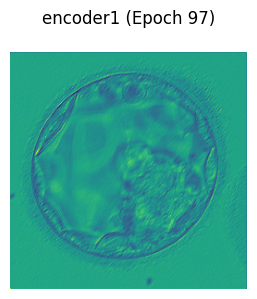

encoder2: torch.Size([3, 16, 128, 128])


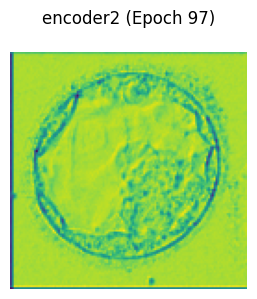

encoder3: torch.Size([3, 24, 64, 64])


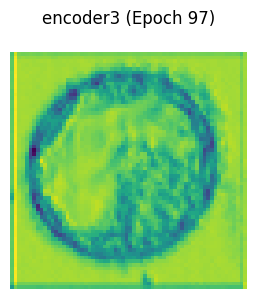

encoder4: torch.Size([3, 32, 32, 32])


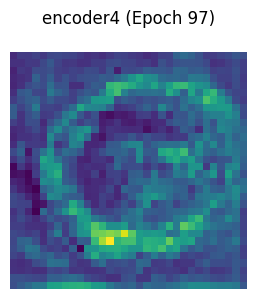

encoder5: torch.Size([3, 48, 16, 16])


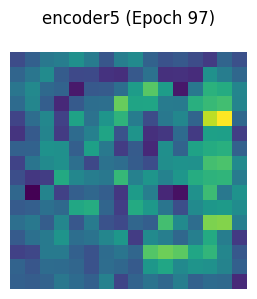

encoder6: torch.Size([3, 64, 8, 8])


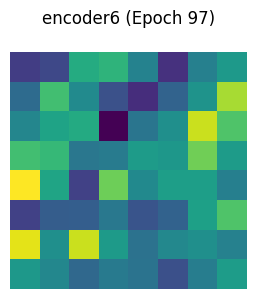

decoder1: torch.Size([3, 48, 8, 8])


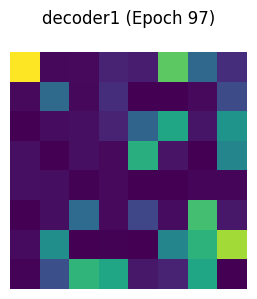

decoder2: torch.Size([3, 32, 8, 8])


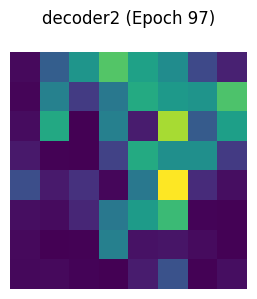

decoder3: torch.Size([3, 24, 16, 16])


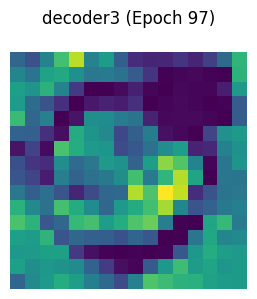

decoder4: torch.Size([3, 16, 32, 32])


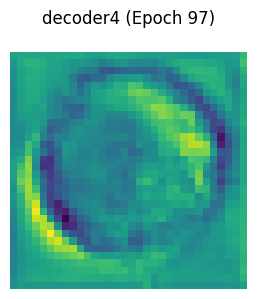

decoder5: torch.Size([3, 8, 64, 64])


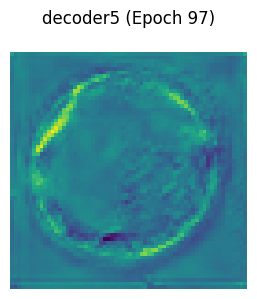

Epoch 97: Loss = 96.4587, Val Dice = 0.7816, Val mIoU = 0.6417, Val Accuracy = 0.9519, Val Sensitivity = 0.7971, Val Specificity = 0.9708


Epoch 98/100: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


[Epoch 98] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


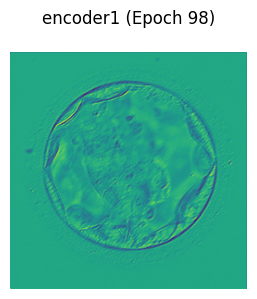

encoder2: torch.Size([3, 16, 128, 128])


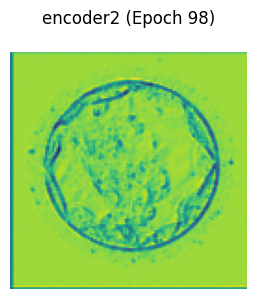

encoder3: torch.Size([3, 24, 64, 64])


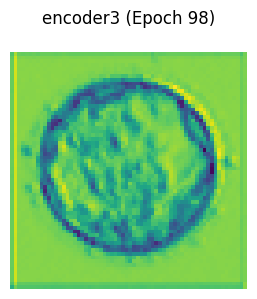

encoder4: torch.Size([3, 32, 32, 32])


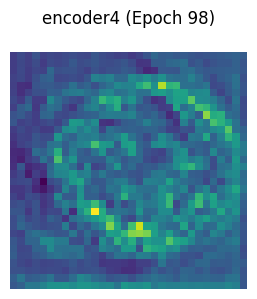

encoder5: torch.Size([3, 48, 16, 16])


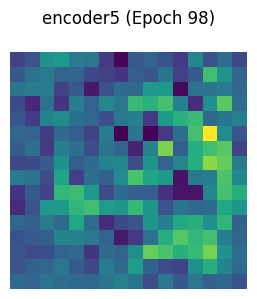

encoder6: torch.Size([3, 64, 8, 8])


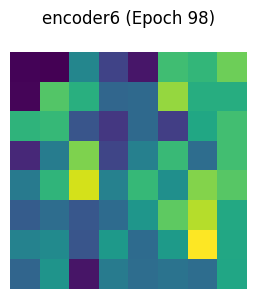

decoder1: torch.Size([3, 48, 8, 8])


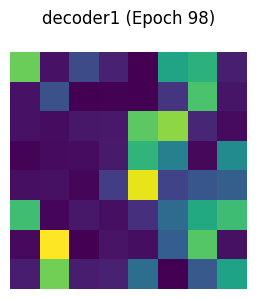

decoder2: torch.Size([3, 32, 8, 8])


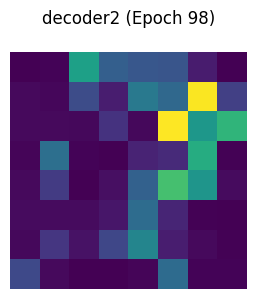

decoder3: torch.Size([3, 24, 16, 16])


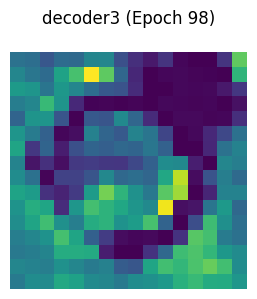

decoder4: torch.Size([3, 16, 32, 32])


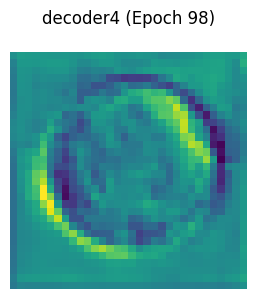

decoder5: torch.Size([3, 8, 64, 64])


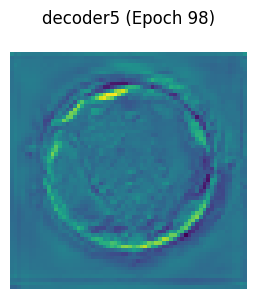

Epoch 98: Loss = 96.3767, Val Dice = 0.7803, Val mIoU = 0.6401, Val Accuracy = 0.9534, Val Sensitivity = 0.7691, Val Specificity = 0.9757


Epoch 99/100: 100%|██████████| 125/125 [02:17<00:00,  1.10s/it]


[Epoch 99] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


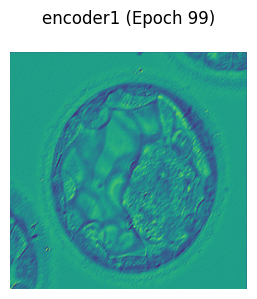

encoder2: torch.Size([3, 16, 128, 128])


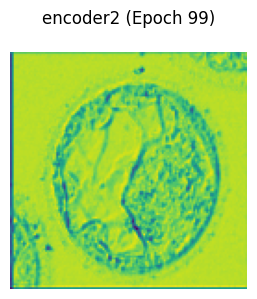

encoder3: torch.Size([3, 24, 64, 64])


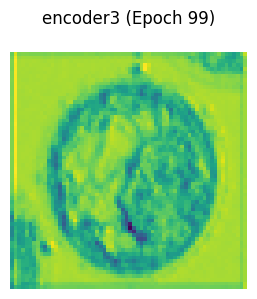

encoder4: torch.Size([3, 32, 32, 32])


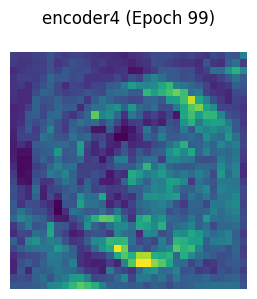

encoder5: torch.Size([3, 48, 16, 16])


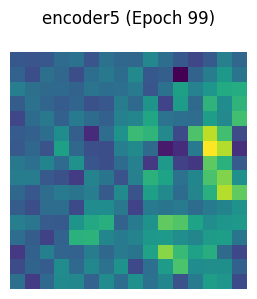

encoder6: torch.Size([3, 64, 8, 8])


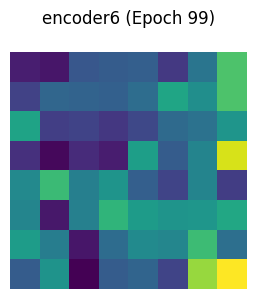

decoder1: torch.Size([3, 48, 8, 8])


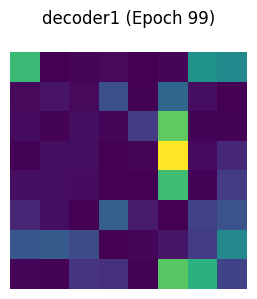

decoder2: torch.Size([3, 32, 8, 8])


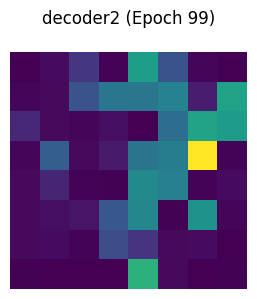

decoder3: torch.Size([3, 24, 16, 16])


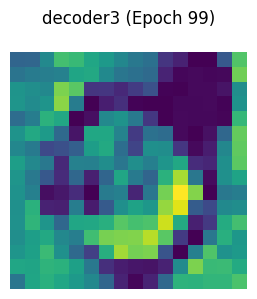

decoder4: torch.Size([3, 16, 32, 32])


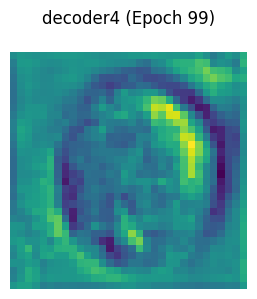

decoder5: torch.Size([3, 8, 64, 64])


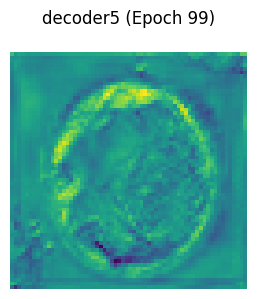

Epoch 99: Loss = 96.0774, Val Dice = 0.7890, Val mIoU = 0.6522, Val Accuracy = 0.9545, Val Sensitivity = 0.7863, Val Specificity = 0.9751


Epoch 100/100: 100%|██████████| 125/125 [02:19<00:00,  1.12s/it]


[Epoch 100] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


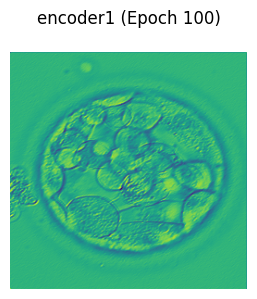

encoder2: torch.Size([3, 16, 128, 128])


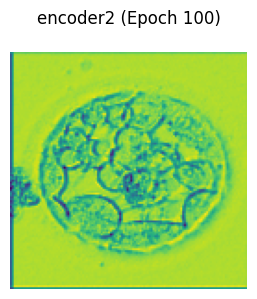

encoder3: torch.Size([3, 24, 64, 64])


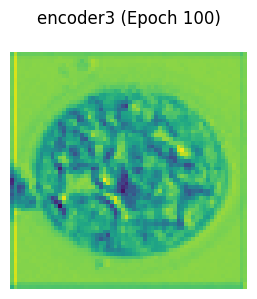

encoder4: torch.Size([3, 32, 32, 32])


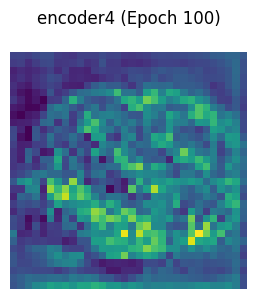

encoder5: torch.Size([3, 48, 16, 16])


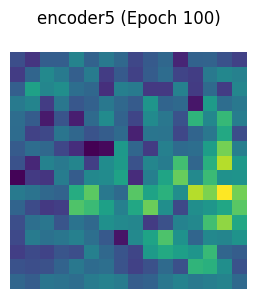

encoder6: torch.Size([3, 64, 8, 8])


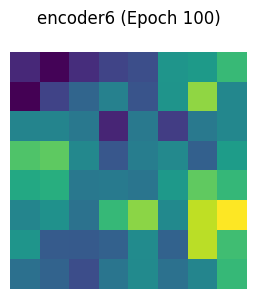

decoder1: torch.Size([3, 48, 8, 8])


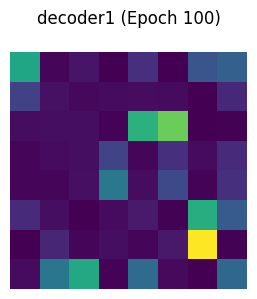

decoder2: torch.Size([3, 32, 8, 8])


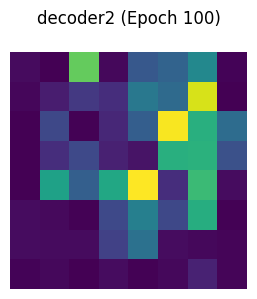

decoder3: torch.Size([3, 24, 16, 16])


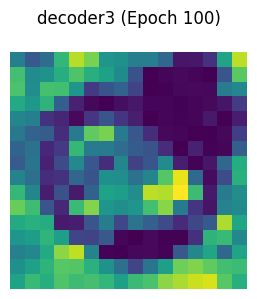

decoder4: torch.Size([3, 16, 32, 32])


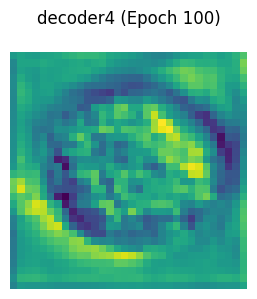

decoder5: torch.Size([3, 8, 64, 64])


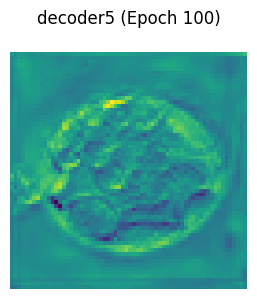

Epoch 100: Loss = 95.8165, Val Dice = 0.7774, Val mIoU = 0.6363, Val Accuracy = 0.9531, Val Sensitivity = 0.7568, Val Specificity = 0.9770


In [16]:
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np

# === Feature map visualization ===
def visualize_feature_maps(feature_maps, title, n_maps=5):
    num_maps = min(n_maps, feature_maps.shape[1])
    plt.figure(figsize=(3 * num_maps, 3))  # Wider layout for horizontal arrangement
    plt.suptitle(title)

    for i in range(num_maps):
        plt.subplot(1, num_maps, i + 1)
        fmap = feature_maps[0, i].cpu().detach().numpy()
        plt.imshow(fmap, cmap='viridis')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# === Register forward hooks on specific layers ===
def register_hooks(model, layer_names):
    feature_maps = {}

    def get_hook(name):
        def hook(module, input, output):
            feature_maps[name] = output
        return hook

    handles = []
    for name, module in model.named_modules():
        if name in layer_names:
            handles.append(module.register_forward_hook(get_hook(name)))

    return feature_maps, handles

# === CONFIGURATION ===
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
EPOCHS = 100

# === MODEL ===
model = MALUNet().to(DEVICE)
optimizer = optim.AdamW(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=50, eta_min=0.00001)

# === LAYERS TO TRACK ===
tracked_layers = [
    'encoder1', 'encoder2', 'encoder3', 'encoder4', 'encoder5', 'encoder6',
    'decoder1', 'decoder2', 'decoder3', 'decoder4', 'decoder5',
]

# === TRAINING LOOP ===
for epoch in range(EPOCHS):
    model.train()
    total_loss = 0

    # Register hooks
    feature_maps, handles = register_hooks(model, tracked_layers)
    last_batch_images = None

    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
        images, masks = images.to(DEVICE), masks.to(DEVICE)
        last_batch_images = images  # Save last batch for visualization

        optimizer.zero_grad()
        preds = model(images)
        loss = BCEDiceLoss()(preds, masks)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    scheduler.step()

    # === Visualize Feature Maps ===
    if feature_maps:
        print(f"\n[Epoch {epoch + 1}] Feature maps:")
        for name, fmap in feature_maps.items():
            print(f"{name}: {fmap.shape}")
            visualize_feature_maps(fmap, f"{name} (Epoch {epoch+1})", n_maps=1)
    else:
        print(f"\n[Epoch {epoch + 1}] No feature maps captured.")

    # Remove hooks after each epoch
    for h in handles:
        h.remove()

    # === VALIDATION ===
    model.eval()
    with torch.no_grad():
        val_dice, val_miou, val_accuracy, val_sensitivity, val_specificity = [], [], [], [], []

        for images, masks in valid_loader:
            images, masks = images.to(DEVICE), masks.to(DEVICE)
            preds = model(images)

            TP, TN, FP, FN = get_confusion(masks, preds)
            val_dice.append(dice_score(masks, preds).item())
            val_miou.append(mean_iou(masks, preds).item())
            val_accuracy.append(accuracy(masks, preds).item())
            val_sensitivity.append(sensitivity(masks, preds).item())
            val_specificity.append(specificity(masks, preds).item())

        print(f"Epoch {epoch+1}: Loss = {total_loss:.4f}, "
              f"Val Dice = {np.mean(val_dice):.4f}, "
              f"Val mIoU = {np.mean(val_miou):.4f}, "
              f"Val Accuracy = {np.mean(val_accuracy):.4f}, "
              f"Val Sensitivity = {np.mean(val_sensitivity):.4f}, "
              f"Val Specificity = {np.mean(val_specificity):.4f}")
